# Task Description

## Requirements

Please use the data in  
Sep/2018 or **Nov/2018**  
and compare with data in  
**Mar/2019**  
for the following platforms in the deployment time period.

**Not sure if we have eliminated the early arrivals in the previous analysis.**

Dwell Time Calculation Method:  
* IF Actual Arrival < Planned Arrival,  Dwell = Dwell_Depart_Calc_Time – Planned Arrival
* IF Actual arrival > Planned Arrival, Dwell = Dwell_Depart_Calc_Time – Dwell_Arrival_Calc_Time

OCP-enhanced dwell management

| Station        | Platform | Deployment         | Year (Quarter) commenced |
|----------------|----------|--------------------|--------------------------|
| Wolli Creek    | 1        | 07:00 to 09:00 hrs | Early 2019               |
| International  | 1        | 07:00 to 09:00 hrs | Early 2019               |
| Domestic       | 1        | 07:00 to 09:00 hrs | Early 2019               |
| Mascot         | 1        | 07:00 to 09:00 hrs | Early 2019               |
| Green Square   | 1        | 07:00 to 09:00 hrs | Early 2019               |
| Chatswood (AM) | 1        | 06:30 to 09:00 hrs | Q2 2019 (15 Apr)         |

# Initiliazation

## Load Package

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats

## Utility Functions

In [123]:
# time, platform
def perform_analysis_door_open_close(data1, data2, ledgen1, ledgen2, title):

    station_name_union_list = np.intersect1d(data1['platform'].unique(),
                                             data2['platform'].unique())

    inc_significant_station = []
    dec_significant_station = []
    not_significant_station = []

    for station_name in np.sort(station_name_union_list):
        print()
        print('Platform Name', station_name)
        data1_by_station = data1.loc[data1.platform == station_name, 'time']
        data1_by_station = data1_by_station.loc[~data1_by_station.isnull()]
        data1_by_station = data1_by_station.loc[data1_by_station >=10]
        data1_by_station = data1_by_station.loc[data1_by_station <=120]
        data2_by_station = data2.loc[data2.platform == station_name, 'time']
        data2_by_station = data2_by_station.loc[~data2_by_station.isnull()]
        data2_by_station = data2_by_station.loc[data2_by_station >=10]
        data2_by_station = data2_by_station.loc[data2_by_station <=120]
        num_sample = np.min(
            [data1_by_station.shape[0], data2_by_station.shape[0]])
        num_bins = 20

        random_idx_data1 = np.random.permutation(
            data1_by_station.shape[0])[:num_sample]
        random_idx_data2 = np.random.permutation(
            data2_by_station.shape[0])[:num_sample]

        if num_sample <= 30:
            pass
        else:
            h, p = stats.ks_2samp(data1_by_station.values[random_idx_data1],
                                  data2_by_station.values[random_idx_data2])

            print('Dwell time selected by:')
            print('=' * 15, 'Statistics'.center(10), '=' * 15)
            print(ledgen1 + ' dwell median in (sec)')
            print(data1_by_station.iloc[random_idx_data1].describe())
            print(ledgen2 + ' dwell median in (sec)')
            print(data2_by_station.iloc[random_idx_data2].describe())
            print('KS two-sample test pValue', p)
            if p < 0.05:
                if data1_by_station.iloc[random_idx_data1].median(
                ) > data2_by_station.iloc[random_idx_data2].median():
                    inc_significant_station.append(station_name)
                    print('Dwell Time Increase IS Signficiant')
                else:
                    dec_significant_station.append(station_name)
                    print('Dwell Time Decrease IS Signficiant')
            else:
                not_significant_station.append(station_name)
                if data1_by_station.iloc[random_idx_data1].median(
                ) > data2_by_station.iloc[random_idx_data2].median():
                    print('Dwell Time Increase NOT Signficiant')
                else:
                    print('Dwell Time Decrease NOT Signficiant')

            data1_by_station.iloc[random_idx_data1].hist(bins=num_bins,
                                                         density=True,
                                                         alpha=0.5)
            data2_by_station.iloc[random_idx_data2].hist(bins=num_bins,
                                                         density=True,
                                                         alpha=0.5)
            plt.legend(
                [ledgen1 + ' ' + station_name, ledgen2 + ' ' + station_name])
            plt.title(station_name + ', ' + ledgen1 + ' - ' + ledgen2 +
                      ' Dwell Time Histogram by Density\n' + 'MedianDiff ' +
                      '{:.2f}'.format(
                          data1_by_station.iloc[random_idx_data1].median() -
                          data2_by_station.iloc[random_idx_data2].median()))
            plt.xlabel('Dwell Time (s)')
            plt.ylabel('Density (%)')
            plt.show()

            dwell_sec_data1_sorted = data1_by_station.iloc[
                random_idx_data1].sort_values().reset_index(drop=True)
            dwell_sec_data1_sorted.plot()
            dwell_sec_data2_sorted = data2_by_station.iloc[
                random_idx_data2].sort_values().reset_index(drop=True)
            dwell_sec_data2_sorted.plot()
            plt.legend(
                [ledgen1 + ' ' + station_name, ledgen2 + ' ' + station_name])
            plt.title(ledgen1 + ' - ' + ledgen2)
            plt.xlabel('Order')
            plt.ylabel('Dwell Time (s)')
            plt.show()

    print()
    print()
    print('Num Significant Increase', len(inc_significant_station))
    print('Num Significant Decrease', len(dec_significant_station))
    print('Num Not Significant', len(not_significant_station))
    print('=' * 10 + 'Inc_Platform'.center(10) + '=' * 10)
    print(inc_significant_station)
    print('=' * 10 + 'Dec_Platform'.center(10) + '=' * 10)
    print(dec_significant_station)
    print('=' * 10 + 'Not_Platform'.center(10) + '=' * 10)
    print(not_significant_station)

    #avg_inv = np.array([avg[1], avg[0]])
    explode = (0, 0.1, 0)
    plt.pie([
        len(inc_significant_station),
        len(dec_significant_station),
        len(not_significant_station)
    ],
            explode=explode,
            labels=['Inc', 'Dec', 'Not'],
            autopct='%1.1f%%',
            shadow=True,
            wedgeprops=dict(width=0.7),
            startangle=90)
    plt.title(title)
    plt.show()

In [14]:
# ===== Nov2018 VS. Nov2019 ===== #
ledgen1 = 'Nov 2018'
ledgen2 = 'Nov 2019'
data1 = pd.read_csv('Data/2018-11.csv')
data2 = pd.read_csv('Data/Dart/Dart_Nov.csv')

data1 = data1.loc[~(data1['PERIODS']=='Weekend')]
data2 = data2.loc[~(data2['PERIODS']=='Weekend')]

data1['door_open_last_time'.upper()] = pd.to_datetime(
        data1['door_open_last_time'.upper()])
data1['door_close_last_time'.upper()] = pd.to_datetime(
        data1['door_close_last_time'.upper()])
data2['door_open_last_time'.upper()] = pd.to_datetime(
        data1['door_open_last_time'.upper()])
data2['door_close_last_time'.upper()] = pd.to_datetime(
        data1['door_close_last_time'.upper()])

In [70]:
data2[['door_open_last_time'.upper(),'door_close_last_time'.upper(), 't4_door_opn_2_door_cld_sec'.upper()]]

,DOOR_OPEN_LAST_TIME,DOOR_CLOSE_LAST_TIME,T4_DOOR_OPN_2_DOOR_CLD_SEC
0,2018-11-03 09:54:48,2018-11-03 09:55:10,51.0
1,2018-11-03 10:15:11,2018-11-03 10:15:50,31.0
2,2018-11-03 09:48:14,2018-11-03 09:48:33,26.0
3,2018-11-03 11:09:34,2018-11-03 11:09:51,36.0
4,2018-11-03 11:39:51,2018-11-03 11:40:27,53.0
...,...,...,...
519433,2018-11-30 20:25:43,2018-11-30 20:26:14,30.0
519434,2018-11-30 19:46:10,2018-11-30 19:46:49,30.0
519435,2018-11-30 20:05:51,2018-11-30 20:06:14,57.0
519436,NaT,NaT,50.0


In [24]:
data1_am_up_idx = (data1['door_open_last_time'.upper()].dt.hour >=
                   6) & (data1['door_open_last_time'.upper()].dt.hour <=
                         10) & (data1['segment_direction_name'.upper()] == 'Up')
data2_am_up_idx = (data2['door_open_last_time'.upper()].dt.hour >=
                   6) & (data2['door_open_last_time'.upper()].dt.hour <=
                         10) & (data2['segment_direction_name'.upper()] == 'Up')
data1_pm_down_idx= (data1['door_open_last_time'.upper()].dt.hour >=
                   15) & (data1['door_open_last_time'.upper()].dt.hour <=
                         19) & (data1['segment_direction_name'.upper()] == 'Down')
data2_pm_down_idx= (data2['door_open_last_time'.upper()].dt.hour >=
                   15) & (data2['door_open_last_time'.upper()].dt.hour <=
                         19) & (data2['segment_direction_name'.upper()] == 'Down')

data1_offpeak_idx= (~data1_am_up_idx) & (~data1_pm_down_idx)
data2_offpeak_idx= (~data2_am_up_idx) & (~data2_pm_down_idx)

In [68]:
min_sec = 10
max_sec = 2*60

data1_am_up_sec = (data1.loc[data1_am_up_idx, 'door_close_last_time'.upper()] -
     data1.loc[data1_am_up_idx, 'door_open_last_time'.upper()]
     ).dt.total_seconds()
data1_am_up_sec = data1_am_up_sec.loc[data1_am_up_sec >= min_sec]
data1_am_up_sec = data1_am_up_sec.loc[data1_am_up_sec <= max_sec]
a = data1_am_up_sec.describe()

data2_am_up_sec = (data2.loc[data2_am_up_idx, 'door_close_last_time'.upper()] -
     data2.loc[data2_am_up_idx, 'door_open_last_time'.upper()]
     ).dt.total_seconds()
data2_am_up_sec = data2_am_up_sec.loc[data2_am_up_sec >= min_sec]
data2_am_up_sec = data2_am_up_sec.loc[data2_am_up_sec <= max_sec]
b = data2_am_up_sec.describe()

data1_pm_down_sec = (data1.loc[data1_pm_down_idx, 'door_close_last_time'.upper()] -
     data1.loc[data1_pm_down_idx, 'door_open_last_time'.upper()]
     ).dt.total_seconds()
data1_pm_down_sec = data1_pm_down_sec.loc[data1_pm_down_sec >= min_sec]
data1_pm_down_sec = data1_pm_down_sec.loc[data1_pm_down_sec <= max_sec]
c = data1_pm_down_sec.describe()

data2_pm_down_sec = (data2.loc[data2_pm_down_idx, 'door_close_last_time'.upper()] -
     data2.loc[data2_pm_down_idx, 'door_open_last_time'.upper()]
     ).dt.total_seconds()
data2_pm_down_sec = data2_pm_down_sec.loc[data2_pm_down_sec >= min_sec]
data2_pm_down_sec = data2_pm_down_sec.loc[data2_pm_down_sec <= max_sec]
d = data2_pm_down_sec.describe()

data1_offpeak_sec = (data1.loc[data1_offpeak_idx, 'door_close_last_time'.upper()] -
     data1.loc[data1_offpeak_idx, 'door_open_last_time'.upper()]
     ).dt.total_seconds()
data1_offpeak_sec = data1_offpeak_sec.loc[data1_offpeak_sec >= min_sec]
data1_offpeak_sec = data1_offpeak_sec.loc[data1_offpeak_sec <= max_sec]
e = data1_offpeak_sec.describe()

data2_offpeak_sec = (data2.loc[data2_offpeak_idx, 'door_close_last_time'.upper()] -
     data2.loc[data2_offpeak_idx, 'door_open_last_time'.upper()]
     ).dt.total_seconds()
data2_offpeak_sec = data2_offpeak_sec.loc[data2_offpeak_sec >= min_sec]
data2_offpeak_sec = data2_offpeak_sec.loc[data2_offpeak_sec <= max_sec]
f = data2_offpeak_sec.describe()

In [69]:
result = pd.concat([a,b,c,d,e,f], axis=1)
result.columns = [
    'Nov2018_AM_UP', 'Nov2019_AM_UP', 'Nov2018_PM_DOWN', 'Nov2019_PM_DOWN',
    'Nov2018_OFFPEAK', 'Nov2019_OFFPEAK'
]
result.to_csv('Dwell_by_Door_Open_Close.csv')
result

,Nov2018_AM_UP,Nov2019_AM_UP,Nov2018_PM_DOWN,Nov2019_PM_DOWN,Nov2018_OFFPEAK,Nov2019_OFFPEAK
count,48099.000000,44130.000000,49414.000000,44678.000000,268100.000000,247414.000000
mean,33.341213,32.992205,34.231432,33.415104,31.661358,32.173200
std,17.502929,19.020727,17.704468,18.474722,19.530907,19.596177
min,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
25%,21.000000,20.000000,23.000000,21.000000,19.000000,19.000000
50%,28.000000,26.000000,28.000000,27.000000,24.000000,25.000000
75%,40.000000,40.000000,39.000000,39.000000,37.000000,38.000000
max,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000


In [73]:
min_sec = 0
max_sec = 2*60

data1_am_up_sec = data1.loc[data1_am_up_idx, 't4_door_opn_2_door_cld_sec'.upper()]
data1_am_up_sec = data1_am_up_sec.loc[data1_am_up_sec >= min_sec]
data1_am_up_sec = data1_am_up_sec.loc[data1_am_up_sec <= max_sec]
a = data1_am_up_sec.describe()

data2_am_up_sec = data2.loc[data2_am_up_idx, 't4_door_opn_2_door_cld_sec'.upper()]
data2_am_up_sec = data2_am_up_sec.loc[data2_am_up_sec >= min_sec]
data2_am_up_sec = data2_am_up_sec.loc[data2_am_up_sec <= max_sec]
b = data2_am_up_sec.describe()

data1_pm_down_sec = data1.loc[data1_pm_down_idx, 't4_door_opn_2_door_cld_sec'.upper()]
data1_pm_down_sec = data1_pm_down_sec.loc[data1_pm_down_sec >= min_sec]
data1_pm_down_sec = data1_pm_down_sec.loc[data1_pm_down_sec <= max_sec]
c = data1_pm_down_sec.describe()

data2_pm_down_sec = data2.loc[data2_pm_down_idx, 't4_door_opn_2_door_cld_sec'.upper()]
data2_pm_down_sec = data2_pm_down_sec.loc[data2_pm_down_sec >= min_sec]
data2_pm_down_sec = data2_pm_down_sec.loc[data2_pm_down_sec <= max_sec]
d = data2_pm_down_sec.describe()

data1_offpeak_sec = data1.loc[data1_offpeak_idx, 't4_door_opn_2_door_cld_sec'.upper()]
data1_offpeak_sec = data1_offpeak_sec.loc[data1_offpeak_sec >= min_sec]
data1_offpeak_sec = data1_offpeak_sec.loc[data1_offpeak_sec <= max_sec]
e = data1_offpeak_sec.describe()

data2_offpeak_sec = data2.loc[data2_offpeak_idx, 't4_door_opn_2_door_cld_sec'.upper()]
data2_offpeak_sec = data2_offpeak_sec.loc[data2_offpeak_sec >= min_sec]
data2_offpeak_sec = data2_offpeak_sec.loc[data2_offpeak_sec <= max_sec]
f = data2_offpeak_sec.describe()

result_t4openclose = pd.concat([a,b,c,d,e,f], axis=1)
result.columns = [
    'Nov2018_AM_UP', 'Nov2019_AM_UP', 'Nov2018_PM_DOWN', 'Nov2019_PM_DOWN',
    'Nov2018_OFFPEAK', 'Nov2019_OFFPEAK'
]
result_t4openclose.to_csv('Dwell_by_Door_t4openclose.csv')
result_t4openclose

,T4_DOOR_OPN_2_DOOR_CLD_SEC,T4_DOOR_OPN_2_DOOR_CLD_SEC,T4_DOOR_OPN_2_DOOR_CLD_SEC,T4_DOOR_OPN_2_DOOR_CLD_SEC,T4_DOOR_OPN_2_DOOR_CLD_SEC,T4_DOOR_OPN_2_DOOR_CLD_SEC
count,48106.000000,43816.000000,49399.000000,44268.000000,268134.000000,255064.000000
mean,33.466823,33.191985,34.306889,33.159506,31.793786,33.078537
std,17.602072,20.190544,17.765725,18.675677,19.663741,19.439942
min,11.000000,1.000000,11.000000,11.000000,0.000000,1.000000
25%,21.000000,20.000000,23.000000,20.000000,19.000000,20.000000
50%,28.000000,26.000000,28.000000,26.000000,24.000000,26.000000
75%,40.000000,40.000000,39.000000,40.000000,37.000000,39.000000
max,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000


In [114]:
data1_am_up_sec = data1.loc[data1_am_up_idx, [
    't4_door_opn_2_door_cld_sec'.upper(), 'actual_arrival_platform'.upper()
]]
data2_am_up_sec = data2.loc[data2_am_up_idx, [
    't4_door_opn_2_door_cld_sec'.upper(), 'actual_arrival_platform'.upper()
]]
data1_am_up_sec.columns = ['time', 'platform']
data2_am_up_sec.columns = ['time', 'platform']

data1_pm_down_sec = data1.loc[data1_pm_down_idx, [
    't4_door_opn_2_door_cld_sec'.upper(), 'actual_arrival_platform'.upper()
]]
data2_pm_down_sec = data2.loc[data2_pm_down_idx, [
    't4_door_opn_2_door_cld_sec'.upper(), 'actual_arrival_platform'.upper()
]]
data1_pm_down_sec.columns = ['time', 'platform']
data2_pm_down_sec.columns = ['time', 'platform']

data1_offpeak_sec = data1.loc[data1_offpeak_idx, [
    't4_door_opn_2_door_cld_sec'.upper(), 'actual_arrival_platform'.upper()
]]
data2_offpeak_sec = data2.loc[data2_offpeak_idx, [
    't4_door_opn_2_door_cld_sec'.upper(), 'actual_arrival_platform'.upper()
]]
data1_offpeak_sec.columns = ['time', 'platform']
data2_offpeak_sec.columns = ['time', 'platform']

# t4_door_opn_2_door_cld_sec

## AM UP


Platform Name ART1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    693.000000
mean      22.528139
std        4.754174
min       12.000000
25%       20.000000
50%       22.000000
75%       24.000000
max       50.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    693.000000
mean      21.101010
std        5.405645
min       11.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 3.457446529201316e-09
Dwell Time Increase IS Signficiant


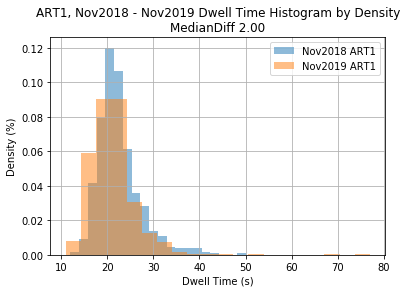

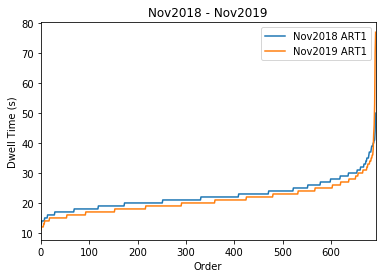


Platform Name ASH3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    280.000000
mean      28.896429
std        6.748422
min       18.000000
25%       24.000000
50%       28.000000
75%       32.000000
max       69.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    280.000000
mean      26.771429
std        5.778892
min       16.000000
25%       23.000000
50%       26.000000
75%       30.000000
max       69.000000
Name: time, dtype: float64
KS two-sample test pValue 0.001954944888109347
Dwell Time Increase IS Signficiant


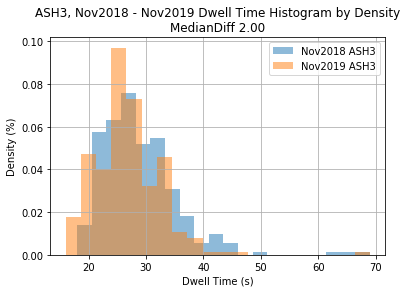

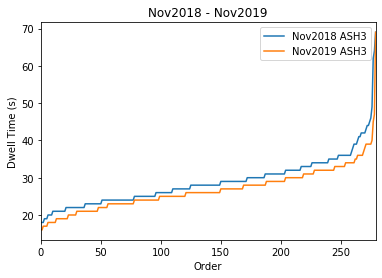


Platform Name ASQ1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    155.000000
mean      26.819355
std       10.980189
min       15.000000
25%       20.000000
50%       23.000000
75%       29.000000
max      104.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    155.000000
mean      22.709677
std       10.060833
min       13.000000
25%       17.000000
50%       20.000000
75%       25.000000
max      105.000000
Name: time, dtype: float64
KS two-sample test pValue 3.550009334067207e-05
Dwell Time Increase IS Signficiant


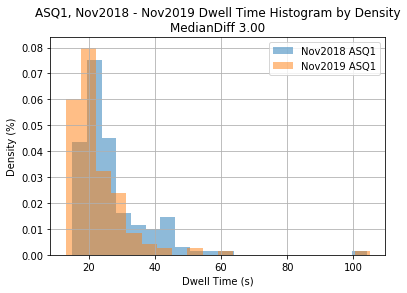

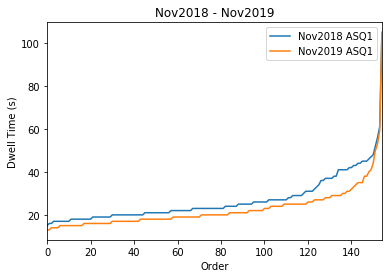


Platform Name AUB3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    253.000000
mean      37.359684
std       11.137358
min       19.000000
25%       28.000000
50%       36.000000
75%       45.000000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    253.000000
mean      35.177866
std       11.685528
min       14.000000
25%       27.000000
50%       33.000000
75%       42.000000
max       87.000000
Name: time, dtype: float64
KS two-sample test pValue 0.07195462349557993
Dwell Time Increase NOT Signficiant


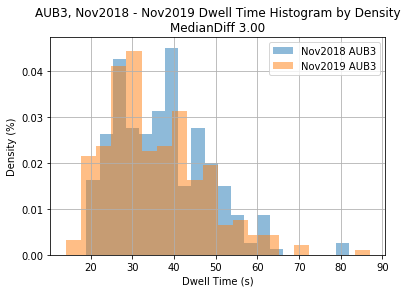

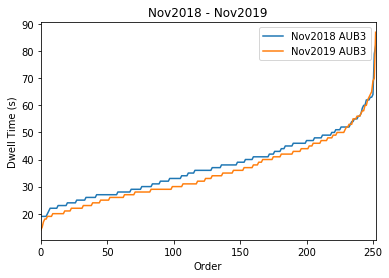


Platform Name BCR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    301.000000
mean      31.232558
std       13.140487
min       12.000000
25%       21.000000
50%       26.000000
75%       41.000000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    301.000000
mean      26.893688
std       12.619376
min       11.000000
25%       18.000000
50%       22.000000
75%       32.000000
max       70.000000
Name: time, dtype: float64
KS two-sample test pValue 1.4692935658194772e-06
Dwell Time Increase IS Signficiant


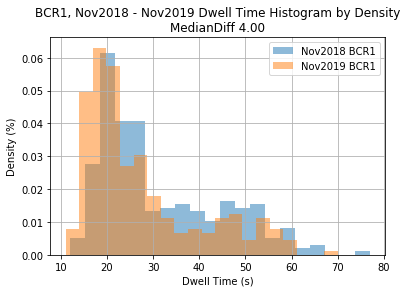

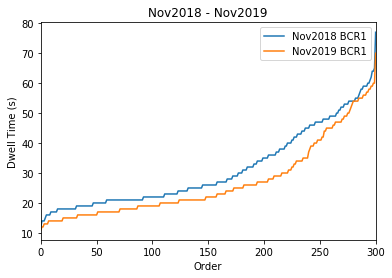


Platform Name BDP1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    152.00000
mean      22.00000
std        3.49645
min       15.00000
25%       20.00000
50%       21.00000
75%       24.00000
max       35.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    152.000000
mean      20.776316
std        4.306467
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       52.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0023071388908237934
Dwell Time Increase IS Signficiant


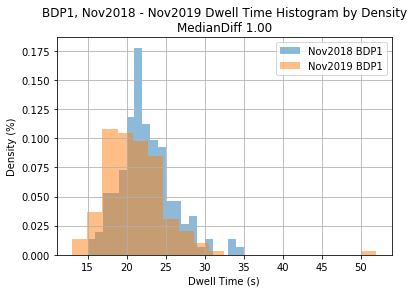

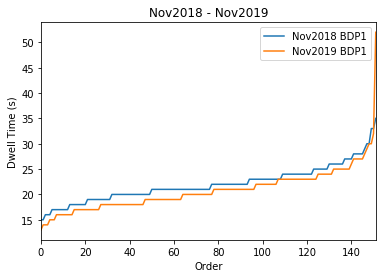


Platform Name BER2

Platform Name BIR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    141.000000
mean      19.780142
std        5.044222
min       13.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       42.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    141.000000
mean      20.744681
std        5.577255
min       14.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       42.000000
Name: time, dtype: float64
KS two-sample test pValue 0.2576341214017462
Dwell Time Decrease NOT Signficiant


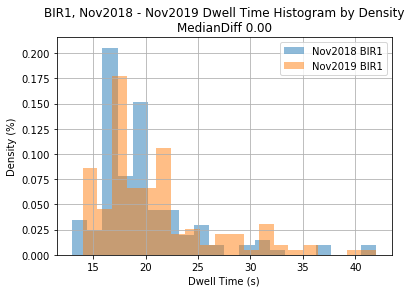

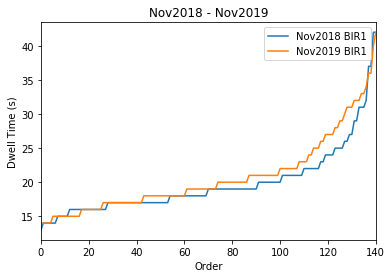


Platform Name BMO1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    122.000000
mean      27.213115
std       14.957919
min       15.000000
25%       20.000000
50%       22.000000
75%       25.000000
max       88.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    122.000000
mean      21.737705
std        5.977649
min       12.000000
25%       18.000000
50%       21.500000
75%       24.000000
max       66.000000
Name: time, dtype: float64
KS two-sample test pValue 0.004956858477573172
Dwell Time Increase IS Signficiant


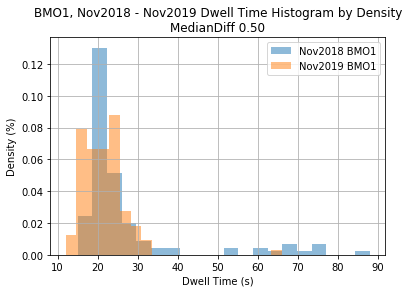

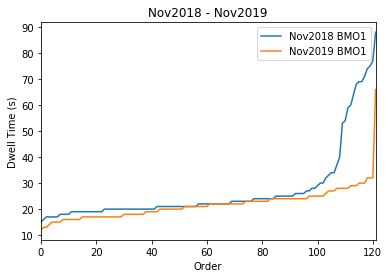


Platform Name BNK1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     72.000000
mean      42.430556
std       24.423970
min       17.000000
25%       27.000000
50%       34.000000
75%       53.250000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     72.000000
mean      55.875000
std       29.778969
min       17.000000
25%       26.250000
50%       59.000000
75%       80.250000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0003014475941855695
Dwell Time Decrease IS Signficiant


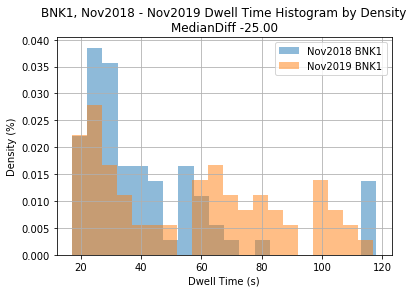

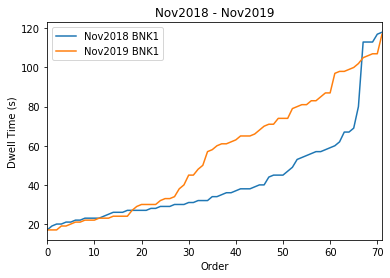


Platform Name BRL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    163.000000
mean      23.245399
std        5.493084
min       14.000000
25%       20.000000
50%       23.000000
75%       26.000000
max       67.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    163.000000
mean      23.024540
std        9.224866
min       13.000000
25%       19.000000
50%       22.000000
75%       25.000000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.10267287968898414
Dwell Time Increase NOT Signficiant


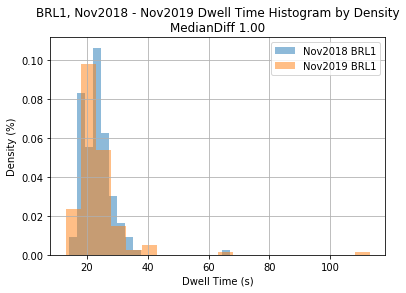

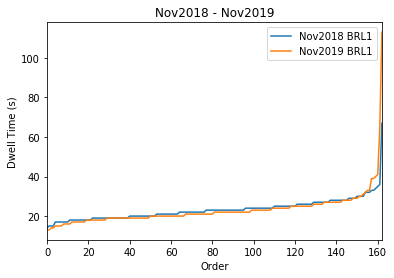


Platform Name BTN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    209.000000
mean      58.583732
std       17.930794
min       17.000000
25%       45.000000
50%       57.000000
75%       71.000000
max      105.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    209.000000
mean      59.354067
std       21.178704
min       25.000000
25%       44.000000
50%       55.000000
75%       74.000000
max      116.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7377282629168782
Dwell Time Increase NOT Signficiant


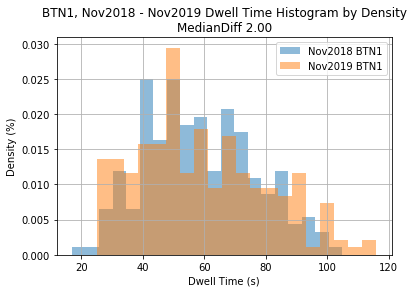

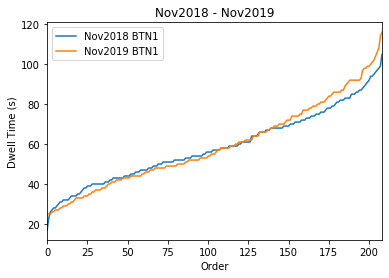


Platform Name BTN3

Platform Name BTN4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    218.000000
mean      41.325688
std       14.093806
min       19.000000
25%       29.250000
50%       39.000000
75%       49.000000
max      105.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    218.000000
mean      43.316514
std       15.996711
min       15.000000
25%       32.000000
50%       42.000000
75%       52.000000
max      109.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3185269571559827
Dwell Time Decrease NOT Signficiant


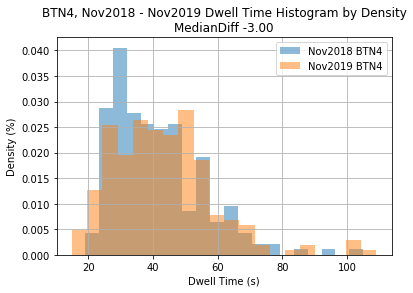

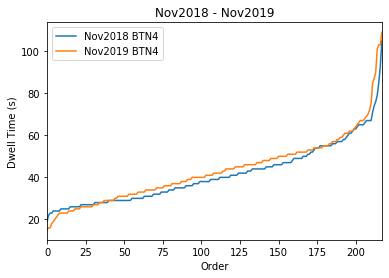


Platform Name BTN5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    103.000000
mean      40.592233
std       15.008780
min       21.000000
25%       30.000000
50%       35.000000
75%       47.000000
max       90.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    103.000000
mean      45.436893
std       18.649854
min       18.000000
25%       30.000000
50%       43.000000
75%       53.500000
max      110.000000
Name: time, dtype: float64
KS two-sample test pValue 0.007277244650236622
Dwell Time Decrease IS Signficiant


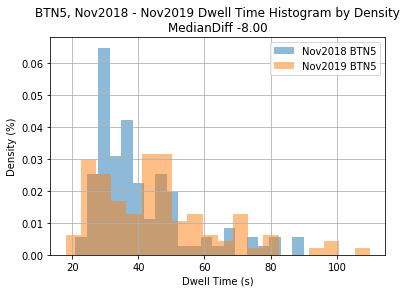

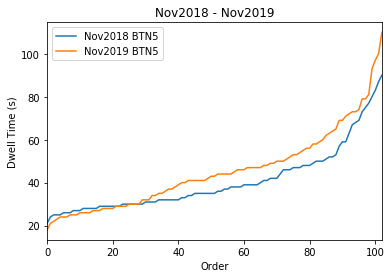


Platform Name BTN6

Platform Name BVH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    166.000000
mean      25.656627
std        6.541906
min       14.000000
25%       21.000000
50%       24.000000
75%       29.000000
max       48.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    166.000000
mean      22.391566
std        5.827598
min       13.000000
25%       18.000000
50%       21.000000
75%       25.000000
max       41.000000
Name: time, dtype: float64
KS two-sample test pValue 7.429193509512394e-05
Dwell Time Increase IS Signficiant


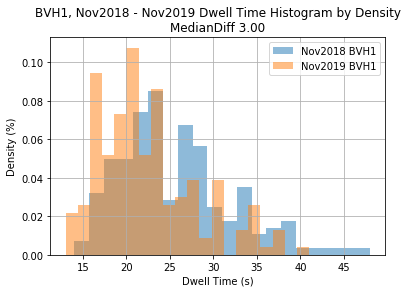

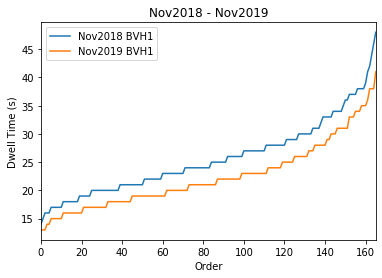


Platform Name BWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    81.000000
mean     33.271605
std       7.456561
min      18.000000
25%      29.000000
50%      32.000000
75%      38.000000
max      54.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    81.000000
mean     30.382716
std      10.091541
min      17.000000
25%      23.000000
50%      27.000000
75%      36.000000
max      61.000000
Name: time, dtype: float64
KS two-sample test pValue 2.4579316743790904e-05
Dwell Time Increase IS Signficiant


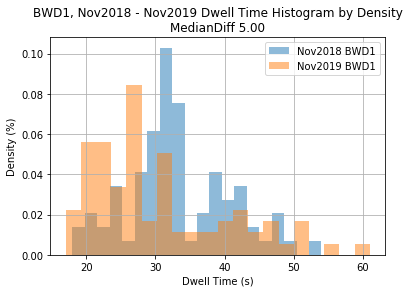

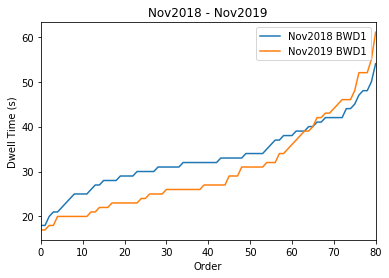


Platform Name BWD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    247.000000
mean      27.295547
std        4.865435
min       18.000000
25%       24.000000
50%       27.000000
75%       30.000000
max       52.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    247.000000
mean      24.344130
std        5.925606
min       14.000000
25%       20.000000
50%       24.000000
75%       28.000000
max       59.000000
Name: time, dtype: float64
KS two-sample test pValue 1.2075331044745184e-08
Dwell Time Increase IS Signficiant


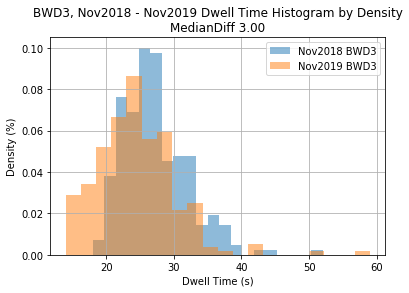

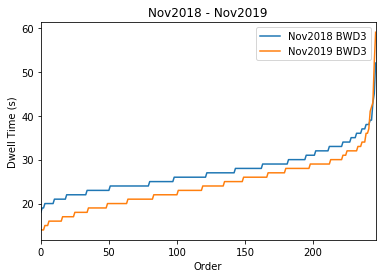


Platform Name BWD5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    295.000000
mean      31.213559
std        9.368776
min       16.000000
25%       25.000000
50%       29.000000
75%       34.000000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    295.000000
mean      34.515254
std       14.941118
min       13.000000
25%       25.000000
50%       29.000000
75%       39.500000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 0.014890388021014226
Dwell Time Decrease IS Signficiant


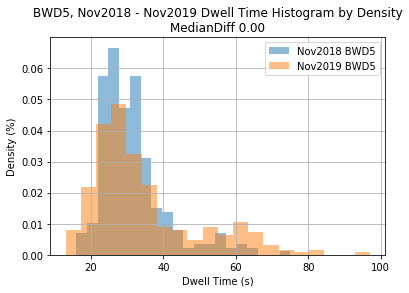

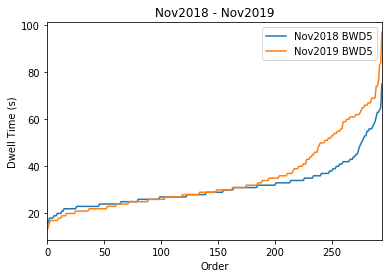


Platform Name BXN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    166.000000
mean      21.518072
std        4.294779
min       14.000000
25%       19.000000
50%       21.000000
75%       23.000000
max       42.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    166.000000
mean      20.831325
std        5.949931
min       14.000000
25%       18.000000
50%       20.000000
75%       22.000000
max       61.000000
Name: time, dtype: float64
KS two-sample test pValue 0.012478575325567585
Dwell Time Increase IS Signficiant


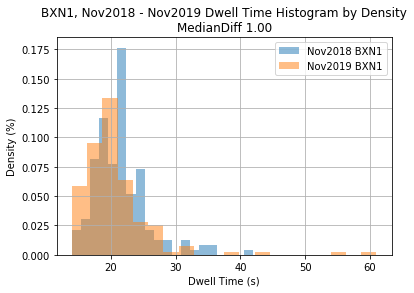

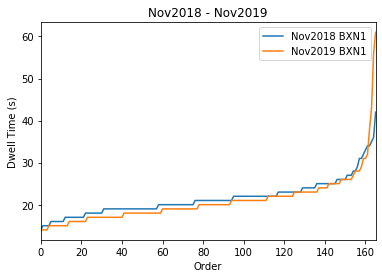


Platform Name CAB1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    274.000000
mean      40.397810
std       14.923448
min       16.000000
25%       28.000000
50%       40.000000
75%       50.000000
max       86.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    274.000000
mean      39.437956
std       15.222819
min       14.000000
25%       26.000000
50%       39.500000
75%       52.000000
max       84.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4594180209959802
Dwell Time Increase NOT Signficiant


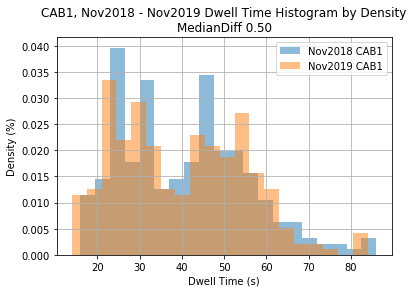

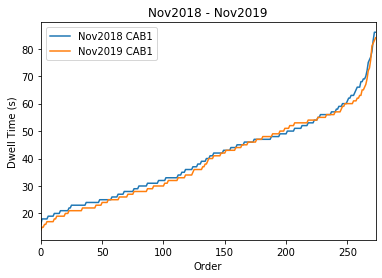


Platform Name CAS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    208.000000
mean      28.375000
std       17.707057
min       12.000000
25%       17.000000
50%       19.500000
75%       36.000000
max       81.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    208.000000
mean      29.625000
std       19.604144
min       11.000000
25%       17.000000
50%       20.000000
75%       32.750000
max      106.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5707426359858688
Dwell Time Decrease NOT Signficiant


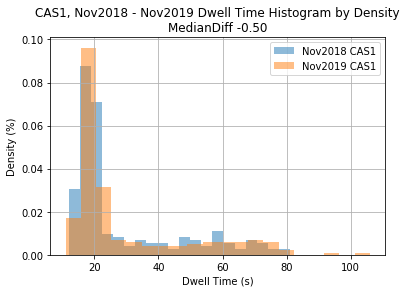

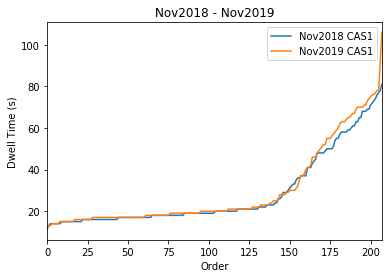


Platform Name CBY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    104.000000
mean      22.201923
std        4.785455
min       15.000000
25%       19.000000
50%       21.000000
75%       23.000000
max       40.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    104.000000
mean      19.413462
std        3.443329
min       13.000000
25%       17.000000
50%       19.000000
75%       21.250000
max       31.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00017639009429892897
Dwell Time Increase IS Signficiant


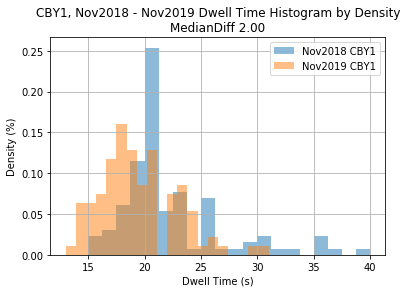

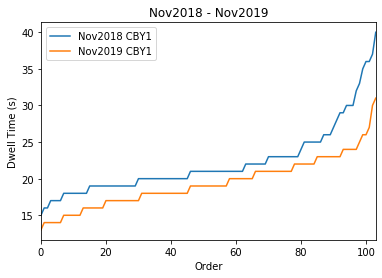


Platform Name CCQ2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    451.000000
mean      40.126386
std       14.376199
min       20.000000
25%       30.000000
50%       36.000000
75%       48.000000
max      104.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    451.000000
mean      46.745011
std       18.108173
min       18.000000
25%       29.500000
50%       46.000000
75%       62.000000
max      116.000000
Name: time, dtype: float64
KS two-sample test pValue 2.4641620803863056e-11
Dwell Time Decrease IS Signficiant


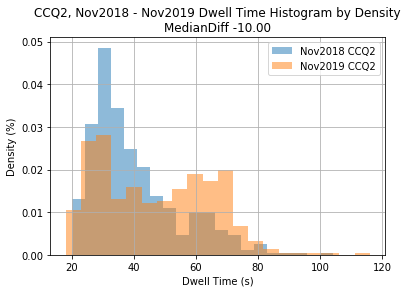

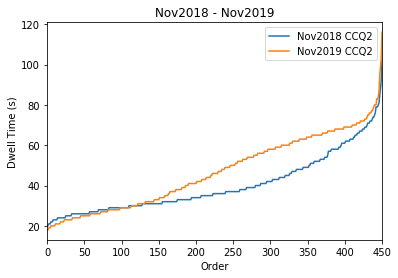


Platform Name CDN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    116.000000
mean      61.077586
std       36.574914
min       13.000000
25%       24.750000
50%       53.000000
75%       95.250000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    116.000000
mean      72.801724
std       36.895203
min       12.000000
25%       31.000000
50%       83.500000
75%      104.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.003618918245555292
Dwell Time Decrease IS Signficiant


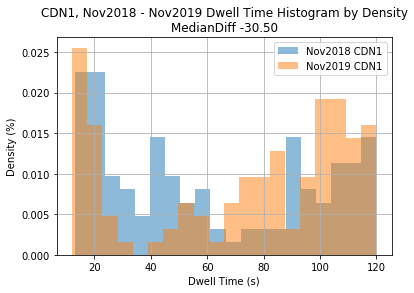

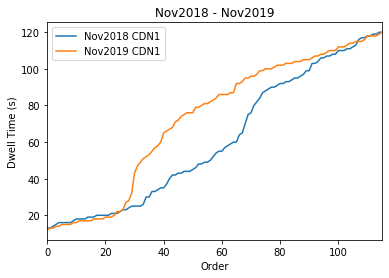


Platform Name CE16
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    715.000000
mean      51.800000
std       12.956099
min       22.000000
25%       42.000000
50%       51.000000
75%       59.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    715.000000
mean      47.380420
std       17.253365
min       17.000000
25%       35.000000
50%       44.000000
75%       56.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 6.203384074719089e-15
Dwell Time Increase IS Signficiant


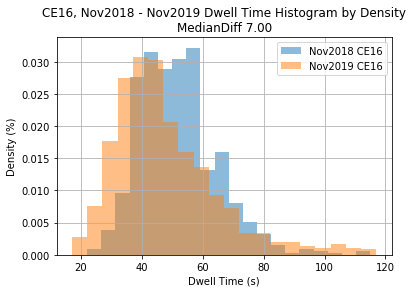

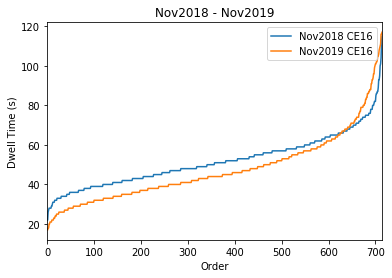


Platform Name CE17
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    961.000000
mean      46.262227
std       13.064181
min       24.000000
25%       37.000000
50%       44.000000
75%       53.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    961.000000
mean      43.981270
std       13.810159
min       16.000000
25%       34.000000
50%       42.000000
75%       51.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 9.026343502288947e-05
Dwell Time Increase IS Signficiant


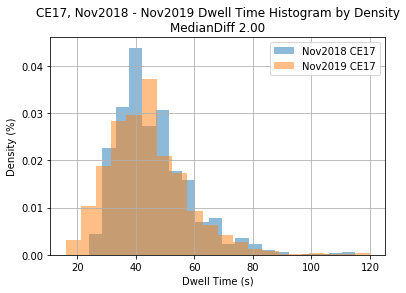

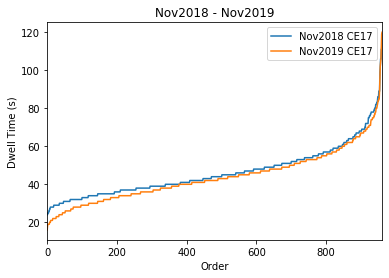


Platform Name CE18
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    632.000000
mean      58.031646
std       19.490148
min       21.000000
25%       41.750000
50%       60.000000
75%       72.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    632.000000
mean      61.672468
std       17.676939
min       21.000000
25%       48.000000
50%       63.000000
75%       74.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0005417576022457007
Dwell Time Decrease IS Signficiant


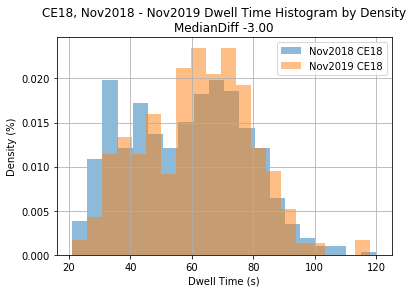

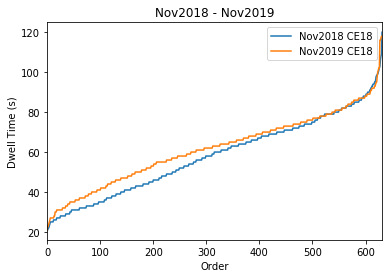


Platform Name CE20

Platform Name CE21
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    254.000000
mean      60.783465
std       16.533245
min       31.000000
25%       47.000000
50%       57.500000
75%       73.000000
max      108.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    254.000000
mean      65.767717
std       19.055079
min       25.000000
25%       49.500000
50%       65.000000
75%       80.000000
max      116.000000
Name: time, dtype: float64
KS two-sample test pValue 0.006724562671731752
Dwell Time Decrease IS Signficiant


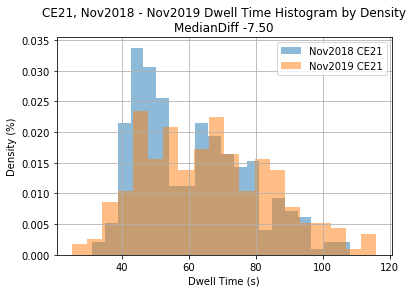

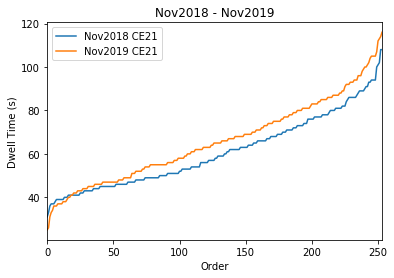


Platform Name CHH1

Platform Name CHT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    300.000000
mean      20.143333
std        4.207350
min       13.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       38.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    300.000000
mean      19.883333
std        8.720659
min       11.000000
25%       16.000000
50%       18.000000
75%       20.000000
max       83.000000
Name: time, dtype: float64
KS two-sample test pValue 5.522790313356146e-05
Dwell Time Increase IS Signficiant


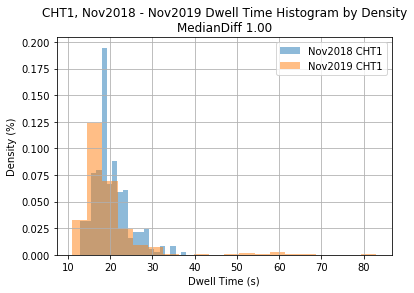

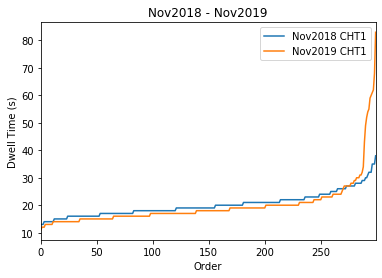


Platform Name CLJ4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    224.000000
mean      28.455357
std       11.970358
min       13.000000
25%       19.000000
50%       23.500000
75%       36.000000
max       69.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    224.000000
mean      26.330357
std       13.694546
min       12.000000
25%       17.000000
50%       20.000000
75%       31.000000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0010735555735247144
Dwell Time Increase IS Signficiant


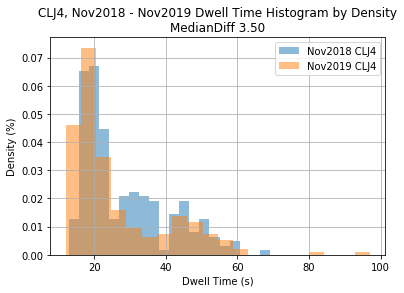

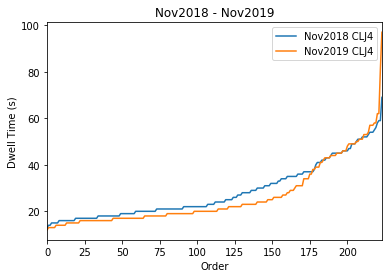


Platform Name CMP1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    108.000000
mean      32.018519
std       10.025185
min       17.000000
25%       25.000000
50%       30.000000
75%       36.250000
max       76.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    108.000000
mean      30.694444
std        9.300245
min       17.000000
25%       24.000000
50%       29.000000
75%       34.250000
max       59.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9302249148738234
Dwell Time Increase NOT Signficiant


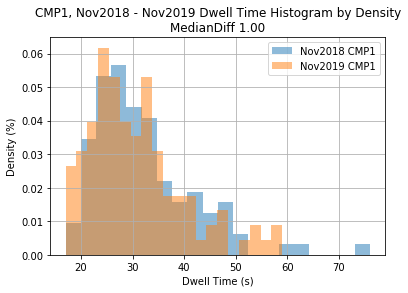

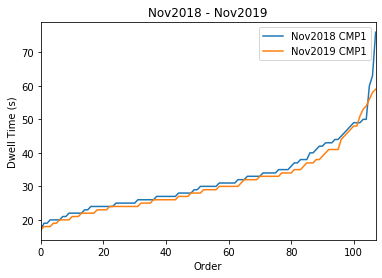


Platform Name CNV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    177.000000
mean      33.683616
std       20.389709
min       15.000000
25%       24.000000
50%       28.000000
75%       34.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    177.000000
mean      28.627119
std       15.818105
min       11.000000
25%       20.000000
50%       27.000000
75%       31.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00605110184718513
Dwell Time Increase IS Signficiant


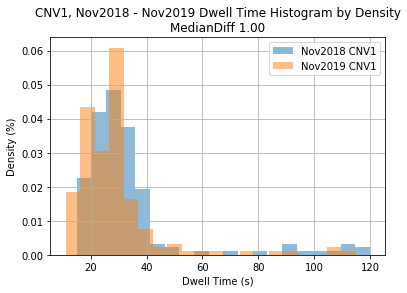

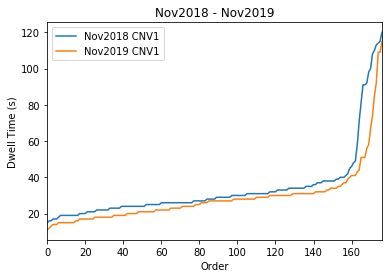


Platform Name CRD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    275.000000
mean      20.938182
std        5.625784
min       14.000000
25%       18.000000
50%       20.000000
75%       22.000000
max       67.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    275.000000
mean      19.981818
std        6.182418
min       12.000000
25%       16.000000
50%       18.000000
75%       22.000000
max       51.000000
Name: time, dtype: float64
KS two-sample test pValue 2.4344981572835868e-06
Dwell Time Increase IS Signficiant


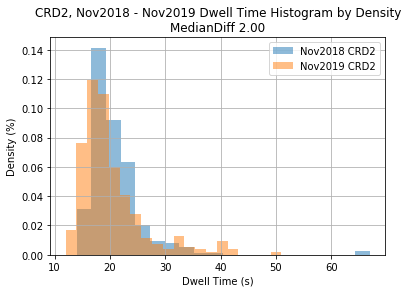

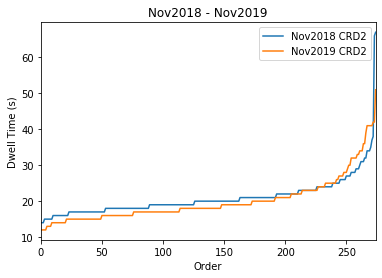


Platform Name CRR1

Platform Name CTN1

Platform Name CTN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    162.000000
mean      74.641975
std       18.769149
min       22.000000
25%       65.000000
50%       75.000000
75%       86.000000
max      114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    162.00000
mean      81.41358
std       18.81411
min       12.00000
25%       74.00000
50%       84.00000
75%       92.00000
max      120.00000
Name: time, dtype: float64
KS two-sample test pValue 5.747949393352126e-05
Dwell Time Decrease IS Signficiant


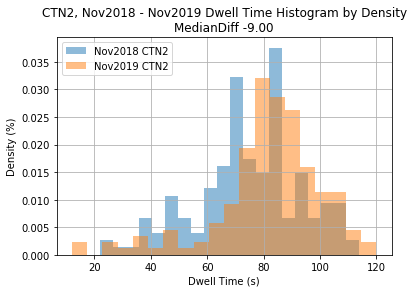

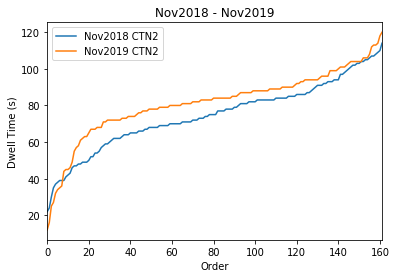


Platform Name CTN3

Platform Name CWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    831.000000
mean      41.409146
std       20.892003
min       16.000000
25%       27.000000
50%       33.000000
75%       50.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    831.000000
mean      58.006017
std       25.352193
min       16.000000
25%       36.000000
50%       56.000000
75%       77.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 4.940920846805691e-44
Dwell Time Decrease IS Signficiant


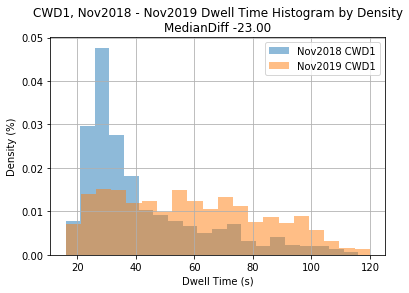

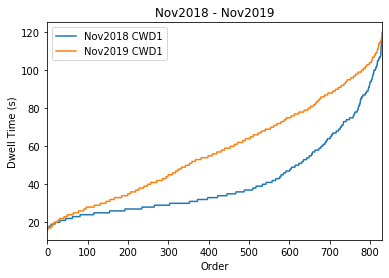


Platform Name CYD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    153.000000
mean      23.091503
std        5.218085
min       15.000000
25%       20.000000
50%       22.000000
75%       25.000000
max       49.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    153.000000
mean      21.326797
std        4.719542
min       12.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       46.000000
Name: time, dtype: float64
KS two-sample test pValue 0.08450992465742502
Dwell Time Increase NOT Signficiant


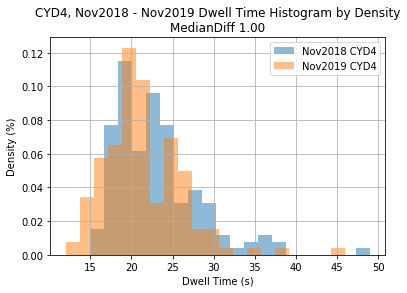

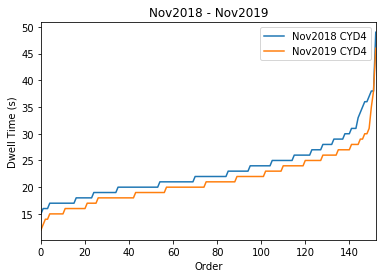


Platform Name DHL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    122.00000
mean      33.52459
std       20.47220
min       16.00000
25%       23.00000
50%       27.00000
75%       33.00000
max      116.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    122.000000
mean      26.942623
std       10.947130
min       13.000000
25%       22.000000
50%       27.000000
75%       29.750000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.037651844441024464
Dwell Time Decrease IS Signficiant


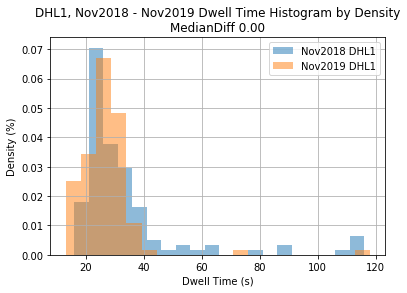

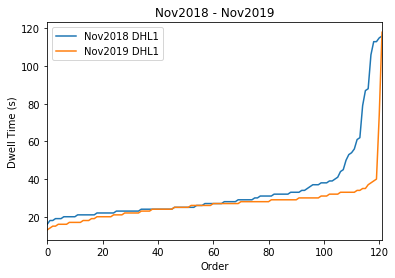


Platform Name DNS1

Platform Name DNS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    266.000000
mean      54.454887
std       20.471606
min       12.000000
25%       39.000000
50%       59.500000
75%       70.000000
max      107.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    266.000000
mean      51.191729
std       23.127801
min       11.000000
25%       24.250000
50%       61.000000
75%       70.000000
max       88.000000
Name: time, dtype: float64
KS two-sample test pValue 0.02582518623178712
Dwell Time Decrease IS Signficiant


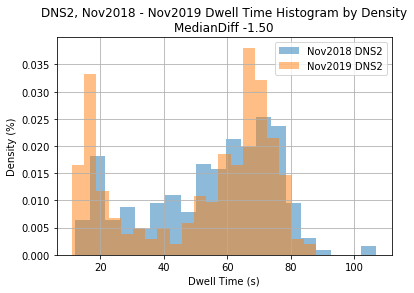

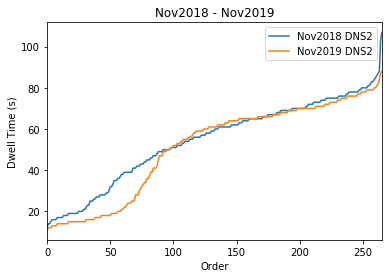


Platform Name DOO1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    208.000000
mean      27.298077
std        9.448952
min       15.000000
25%       20.000000
50%       24.000000
75%       33.000000
max       53.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    208.000000
mean      25.721154
std       12.660530
min       12.000000
25%       18.000000
50%       20.000000
75%       31.250000
max       91.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00011212388809571621
Dwell Time Increase IS Signficiant


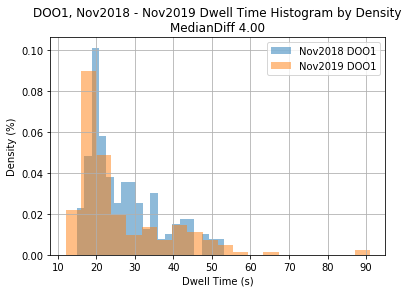

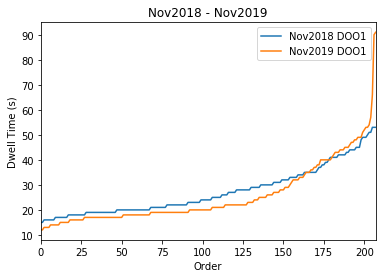


Platform Name DOO2

Platform Name EDP1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    212.000000
mean      20.589623
std        6.099995
min       12.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       64.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    212.000000
mean      20.561321
std        6.279510
min       11.000000
25%       16.000000
50%       19.000000
75%       24.000000
max       55.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3628115035750516
Dwell Time Decrease NOT Signficiant


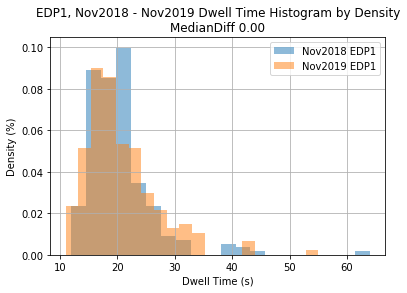

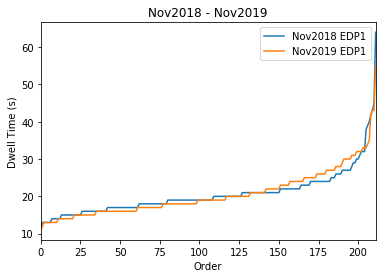


Platform Name EHL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    166.000000
mean      60.000000
std       19.517203
min       14.000000
25%       48.250000
50%       62.500000
75%       74.000000
max      102.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    166.000000
mean      59.174699
std       21.356417
min       13.000000
25%       44.250000
50%       63.500000
75%       75.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8608542375763469
Dwell Time Decrease NOT Signficiant


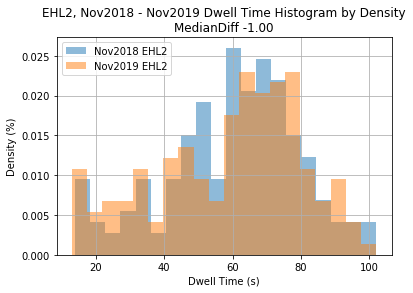

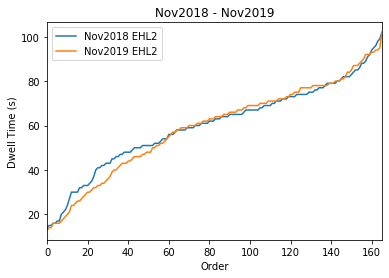


Platform Name EPG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    223.000000
mean      58.573991
std       22.596194
min       21.000000
25%       35.000000
50%       61.000000
75%       78.000000
max      108.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    223.000000
mean      61.390135
std       23.725633
min       16.000000
25%       41.000000
50%       65.000000
75%       79.500000
max      105.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4626545708336164
Dwell Time Decrease NOT Signficiant


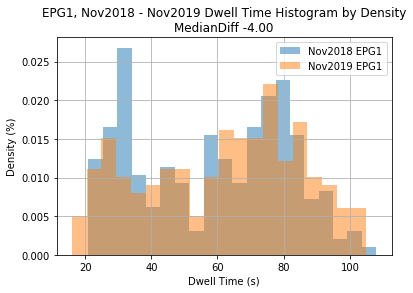

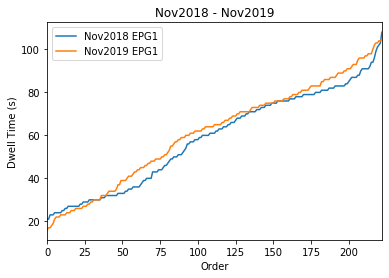


Platform Name EPG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     69.000000
mean      80.405797
std       30.648059
min       21.000000
25%       56.000000
50%       90.000000
75%      106.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     69.000000
mean      47.753623
std       25.244339
min       14.000000
25%       29.000000
50%       42.000000
75%       63.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 5.806942316212983e-10
Dwell Time Increase IS Signficiant


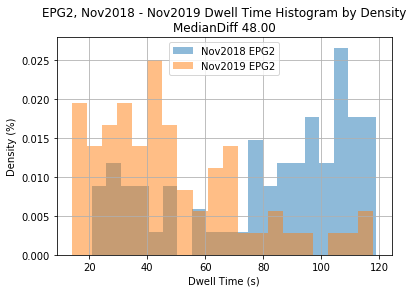

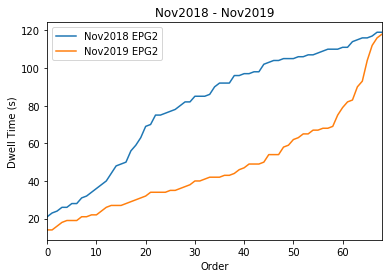


Platform Name EPL1

Platform Name ERC1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    163.000000
mean      20.625767
std        5.902590
min       12.000000
25%       17.000000
50%       19.000000
75%       23.000000
max       46.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    163.000000
mean      17.165644
std        4.305127
min       11.000000
25%       15.000000
50%       16.000000
75%       18.000000
max       42.000000
Name: time, dtype: float64
KS two-sample test pValue 2.5593415916036234e-08
Dwell Time Increase IS Signficiant


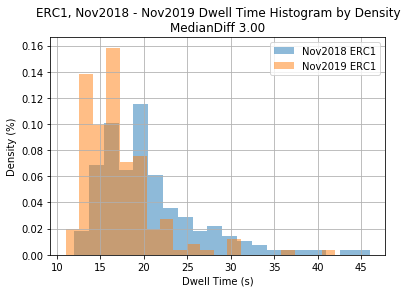

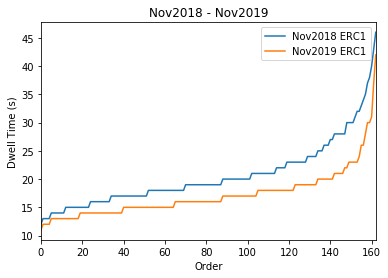


Platform Name ERS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    100.000000
mean      29.880000
std        9.513712
min       16.000000
25%       25.000000
50%       28.000000
75%       33.250000
max       97.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    100.00000
mean      29.16000
std        7.57017
min       14.00000
25%       24.00000
50%       30.00000
75%       34.00000
max       57.00000
Name: time, dtype: float64
KS two-sample test pValue 0.21117008625127576
Dwell Time Decrease NOT Signficiant


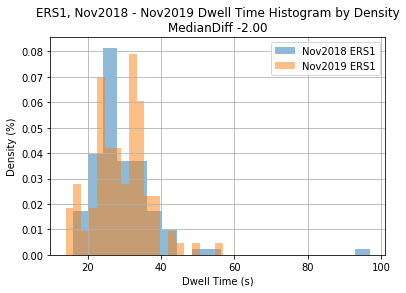

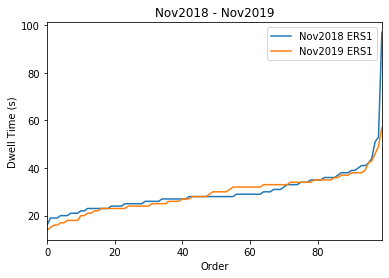


Platform Name EWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    51.000000
mean     27.431373
std      10.556997
min      19.000000
25%      23.000000
50%      24.000000
75%      29.500000
max      94.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    51.000000
mean     28.705882
std      10.074312
min      19.000000
25%      23.000000
50%      26.000000
75%      32.000000
max      88.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5615639086437574
Dwell Time Decrease NOT Signficiant


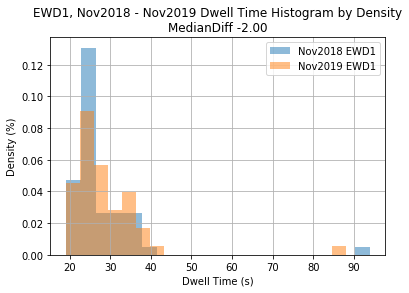

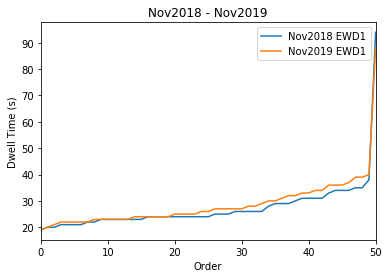


Platform Name EWD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    269.000000
mean      48.037175
std       25.531195
min       18.000000
25%       24.000000
50%       35.000000
75%       74.000000
max       99.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    269.000000
mean      50.635688
std       25.001365
min       12.000000
25%       24.000000
50%       57.000000
75%       74.000000
max      100.000000
Name: time, dtype: float64
KS two-sample test pValue 0.009252936874118826
Dwell Time Decrease IS Signficiant


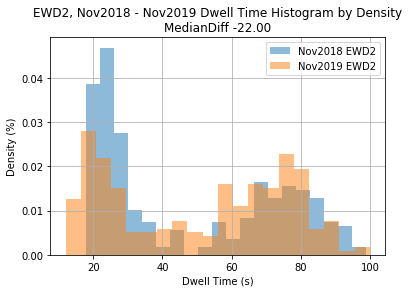

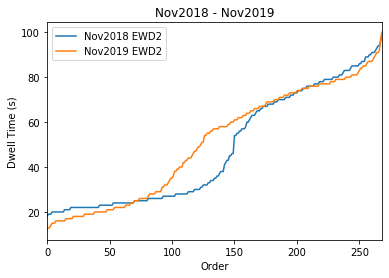


Platform Name FLD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    197.000000
mean      32.121827
std       11.430597
min       20.000000
25%       26.000000
50%       29.000000
75%       34.000000
max       88.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    197.000000
mean      30.350254
std        9.513372
min       14.000000
25%       23.000000
50%       28.000000
75%       35.000000
max       68.000000
Name: time, dtype: float64
KS two-sample test pValue 0.015103258536506785
Dwell Time Increase IS Signficiant


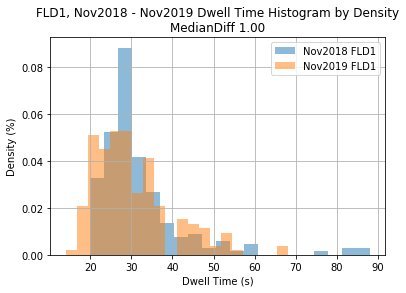

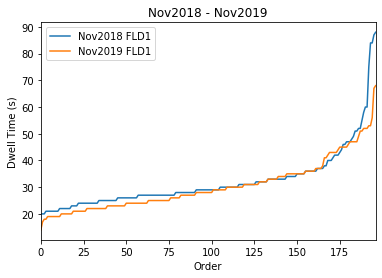


Platform Name FLM3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    228.000000
mean      24.539474
std        8.196014
min       14.000000
25%       20.000000
50%       23.500000
75%       26.250000
max      104.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    228.00000
mean      21.22807
std        4.79911
min       13.00000
25%       18.00000
50%       20.00000
75%       23.00000
max       44.00000
Name: time, dtype: float64
KS two-sample test pValue 7.993691256372618e-09
Dwell Time Increase IS Signficiant


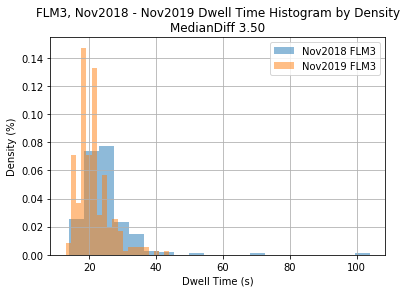

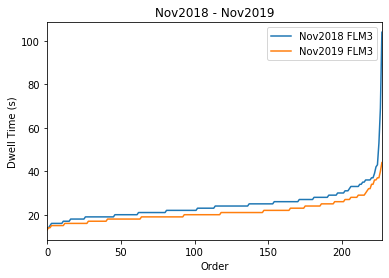


Platform Name GFD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     66.000000
mean      77.181818
std       30.798056
min       33.000000
25%       44.750000
50%       89.500000
75%      104.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     66.000000
mean      89.757576
std       26.260272
min       15.000000
25%       82.250000
50%       99.000000
75%      106.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.004445364034573936
Dwell Time Decrease IS Signficiant


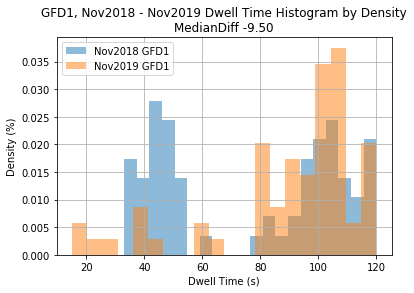

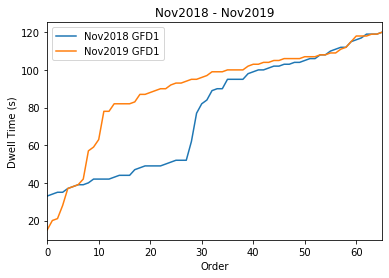


Platform Name GFD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    106.000000
mean      55.150943
std       33.940506
min       20.000000
25%       29.000000
50%       35.500000
75%       87.750000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    106.000000
mean      42.792453
std       28.770261
min       12.000000
25%       24.000000
50%       32.000000
75%       47.750000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.013389281881676518
Dwell Time Increase IS Signficiant


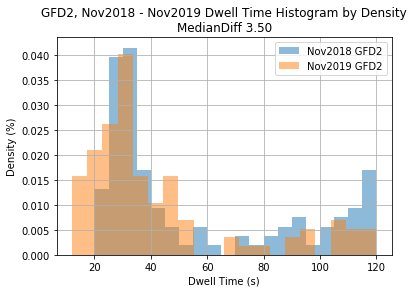

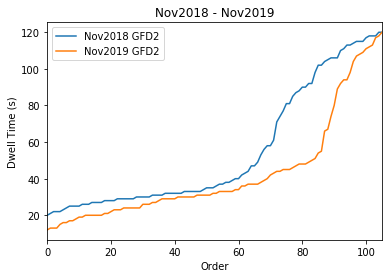


Platform Name GLD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    200.00000
mean      41.38500
std       16.21578
min       16.00000
25%       27.00000
50%       39.50000
75%       55.00000
max       94.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    200.0000
mean      34.1250
std       17.7905
min       12.0000
25%       20.7500
50%       28.0000
75%       44.2500
max      115.0000
Name: time, dtype: float64
KS two-sample test pValue 1.1150402145378719e-05
Dwell Time Increase IS Signficiant


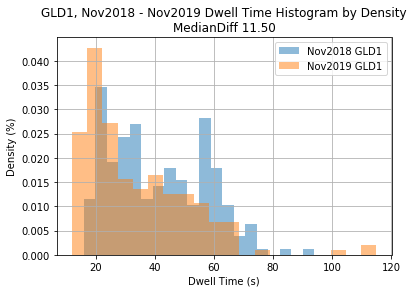

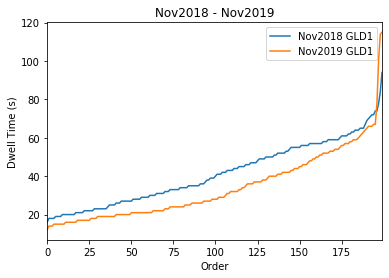


Platform Name GQU1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    296.000000
mean      30.523649
std        9.253462
min       17.000000
25%       25.000000
50%       28.000000
75%       33.000000
max       87.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    296.000000
mean      25.959459
std        5.729943
min       16.000000
25%       22.000000
50%       24.000000
75%       29.000000
max       48.000000
Name: time, dtype: float64
KS two-sample test pValue 2.044533604725078e-11
Dwell Time Increase IS Signficiant


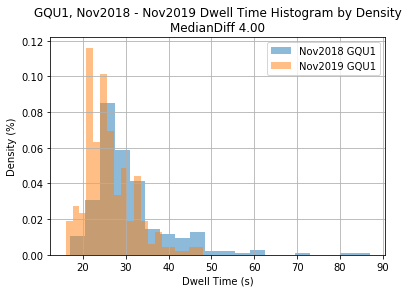

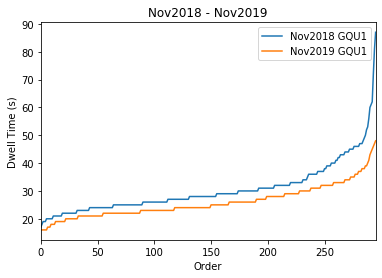


Platform Name GRD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    414.000000
mean      27.635266
std        9.950230
min       16.000000
25%       22.000000
50%       25.000000
75%       30.000000
max      114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    414.000000
mean      29.589372
std       11.192590
min       12.000000
25%       22.000000
50%       27.000000
75%       36.000000
max      111.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00018126206629063958
Dwell Time Decrease IS Signficiant


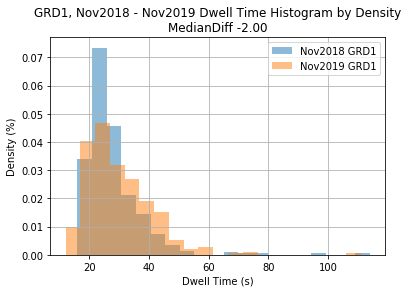

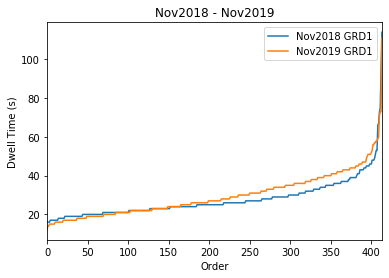


Platform Name GRD2

Platform Name GVL3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    249.000000
mean      28.409639
std        9.458359
min       17.000000
25%       23.000000
50%       26.000000
75%       30.000000
max       83.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    249.000000
mean      25.542169
std        8.040675
min       14.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       85.000000
Name: time, dtype: float64
KS two-sample test pValue 0.014510289418632576
Dwell Time Increase IS Signficiant


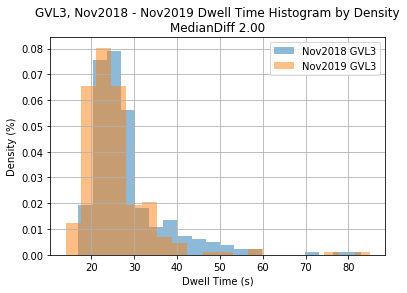

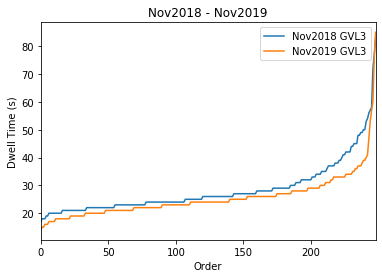


Platform Name HBY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    227.000000
mean      48.462555
std       18.093957
min       17.000000
25%       36.000000
50%       45.000000
75%       54.000000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    227.000000
mean      53.488987
std       24.009836
min       15.000000
25%       35.000000
50%       50.000000
75%       68.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0017010659818840837
Dwell Time Decrease IS Signficiant


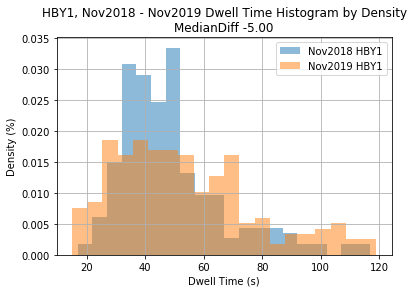

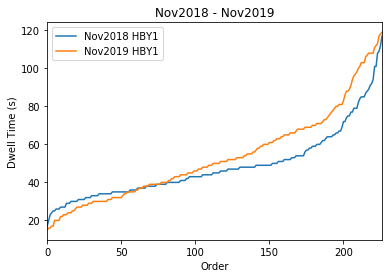


Platform Name HBY2

Platform Name HBY3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     40.000000
mean      37.375000
std       16.708185
min       15.000000
25%       27.000000
50%       35.500000
75%       44.250000
max      114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     40.00000
mean      61.37500
std       28.88322
min       16.00000
25%       40.75000
50%       58.50000
75%       84.25000
max      117.00000
Name: time, dtype: float64
KS two-sample test pValue 0.00018791118070078278
Dwell Time Decrease IS Signficiant


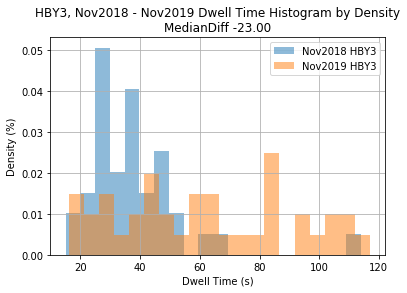

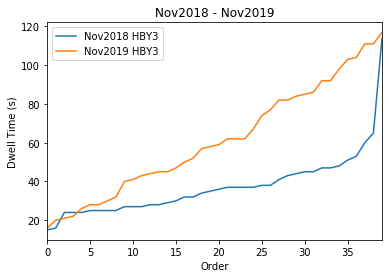


Platform Name HBY4

Platform Name HLW1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    186.000000
mean      24.037634
std        4.689688
min       14.000000
25%       21.000000
50%       23.000000
75%       27.000000
max       41.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    186.000000
mean      21.940860
std        8.405387
min       13.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       95.000000
Name: time, dtype: float64
KS two-sample test pValue 4.100367192670467e-08
Dwell Time Increase IS Signficiant


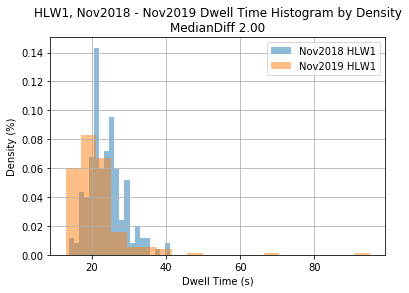

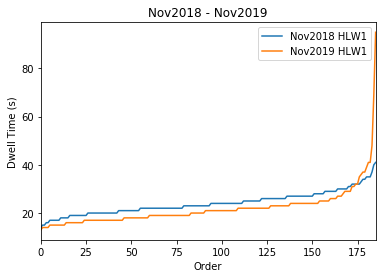


Platform Name HOM4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    98.000000
mean     22.673469
std       4.641310
min      16.000000
25%      19.250000
50%      21.500000
75%      25.000000
max      41.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    98.000000
mean     22.193878
std       8.552636
min      14.000000
25%      19.000000
50%      21.000000
75%      23.000000
max      98.000000
Name: time, dtype: float64
KS two-sample test pValue 0.20170895996299748
Dwell Time Increase NOT Signficiant


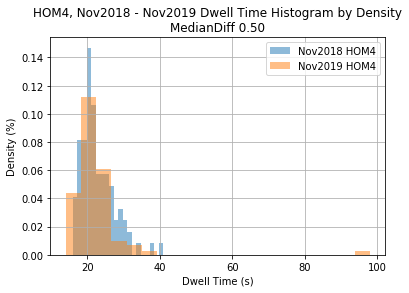

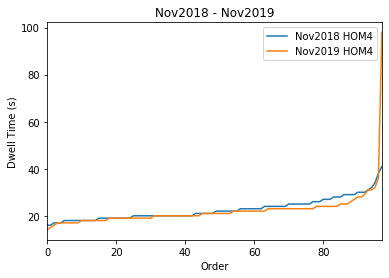


Platform Name HOM6

Platform Name HPK3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    115.000000
mean      23.304348
std        8.064623
min       14.000000
25%       19.000000
50%       21.000000
75%       26.000000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    115.000000
mean      21.773913
std        7.097147
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       66.000000
Name: time, dtype: float64
KS two-sample test pValue 0.28278421004779297
Dwell Time Increase NOT Signficiant


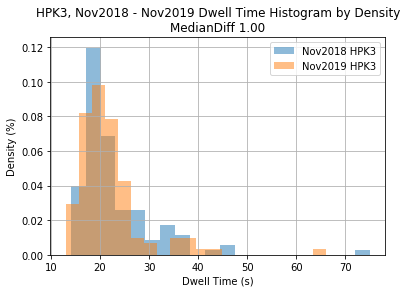

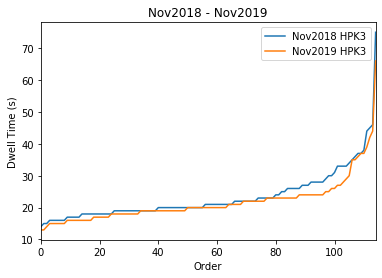


Platform Name HRL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    104.000000
mean      29.298077
std       11.196289
min       13.000000
25%       19.000000
50%       26.000000
75%       38.000000
max       61.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    104.000000
mean      32.480769
std       13.425075
min       14.000000
25%       21.000000
50%       31.500000
75%       41.000000
max       88.000000
Name: time, dtype: float64
KS two-sample test pValue 0.2302019435910574
Dwell Time Decrease NOT Signficiant


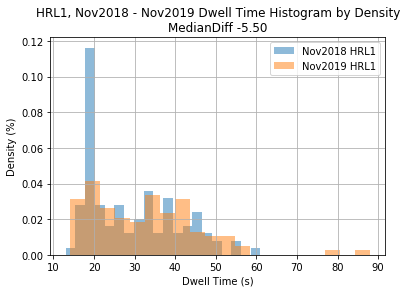

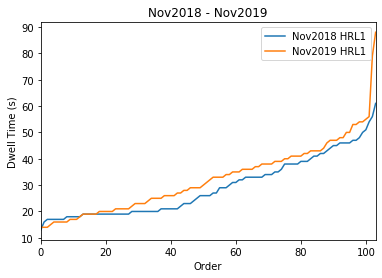


Platform Name ING1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    168.000000
mean      35.946429
std       10.435005
min       16.000000
25%       28.000000
50%       35.000000
75%       43.000000
max       68.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    168.000000
mean      35.357143
std       11.188256
min       15.000000
25%       27.000000
50%       34.500000
75%       43.000000
max       72.000000
Name: time, dtype: float64
KS two-sample test pValue 0.865632536743346
Dwell Time Increase NOT Signficiant


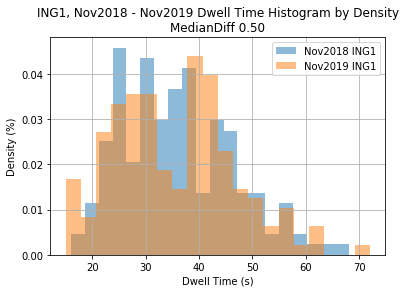

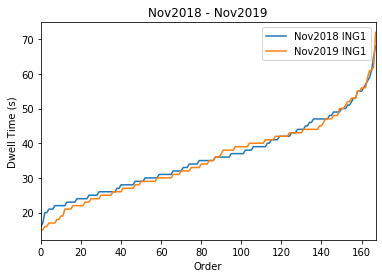


Platform Name KGR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    161.000000
mean      38.031056
std       11.803825
min       18.000000
25%       29.000000
50%       39.000000
75%       48.000000
max       76.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    161.000000
mean      38.913043
std       11.349775
min       12.000000
25%       31.000000
50%       40.000000
75%       48.000000
max       66.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5781591344517654
Dwell Time Decrease NOT Signficiant


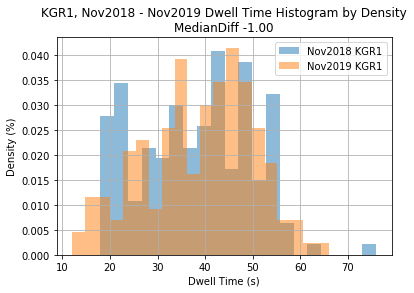

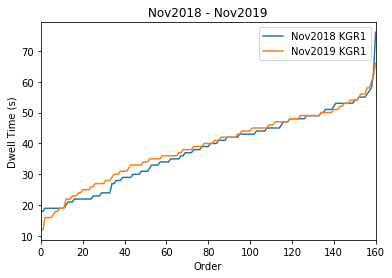


Platform Name KLR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    585.000000
mean      20.058120
std        5.929671
min       12.000000
25%       17.000000
50%       19.000000
75%       22.000000
max      102.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    585.000000
mean      18.808547
std        4.645766
min       11.000000
25%       16.000000
50%       18.000000
75%       20.000000
max       75.000000
Name: time, dtype: float64
KS two-sample test pValue 1.4923256571414104e-05
Dwell Time Increase IS Signficiant


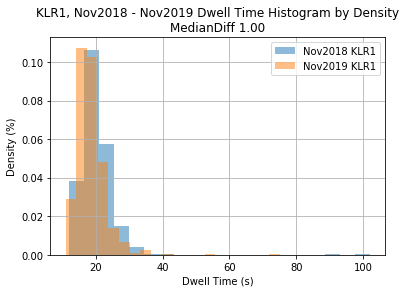

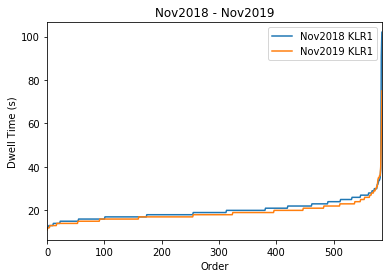


Platform Name KWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    330.000000
mean      21.203030
std        5.152801
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       51.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    330.000000
mean      22.251515
std        8.264643
min       12.000000
25%       17.250000
50%       20.000000
75%       24.000000
max       85.000000
Name: time, dtype: float64
KS two-sample test pValue 0.2575737272163401
Dwell Time Decrease NOT Signficiant


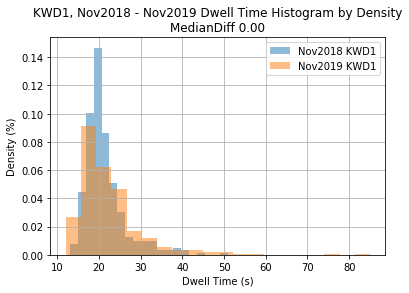

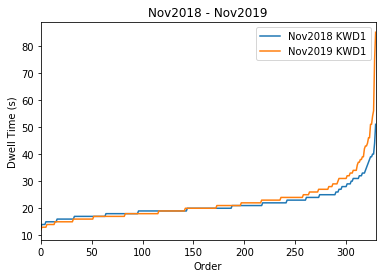


Platform Name LAK1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    126.000000
mean      28.896825
std        8.021800
min       15.000000
25%       23.000000
50%       28.000000
75%       34.000000
max       59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    126.000000
mean      31.777778
std       11.571613
min       15.000000
25%       24.250000
50%       31.000000
75%       37.000000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.20203751995293098
Dwell Time Decrease NOT Signficiant


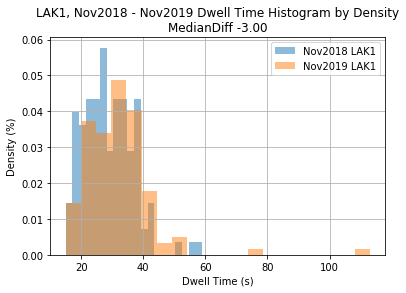

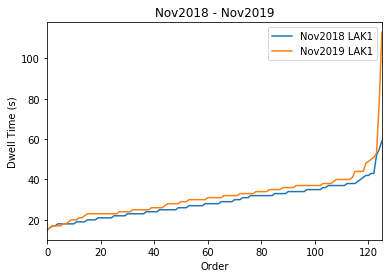


Platform Name LCE1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    193.000000
mean      31.979275
std        9.941474
min       18.000000
25%       26.000000
50%       30.000000
75%       34.000000
max       78.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    193.000000
mean      29.606218
std        8.536708
min       16.000000
25%       24.000000
50%       29.000000
75%       33.000000
max       81.000000
Name: time, dtype: float64
KS two-sample test pValue 0.06014494916311312
Dwell Time Increase NOT Signficiant


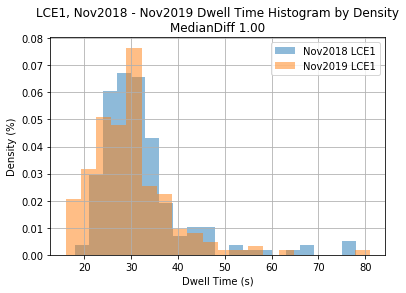

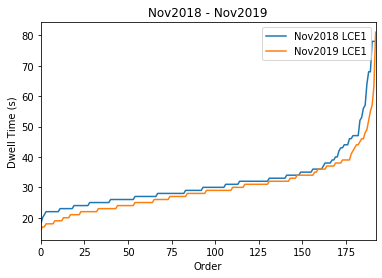


Platform Name LCE3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    256.000000
mean      39.625000
std       11.057071
min       19.000000
25%       33.000000
50%       38.000000
75%       45.000000
max       99.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    256.000000
mean      37.117188
std       14.499288
min       16.000000
25%       27.000000
50%       36.000000
75%       43.000000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0014307302331222763
Dwell Time Increase IS Signficiant


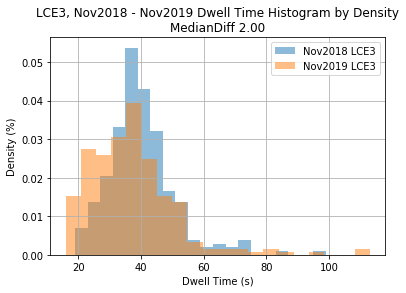

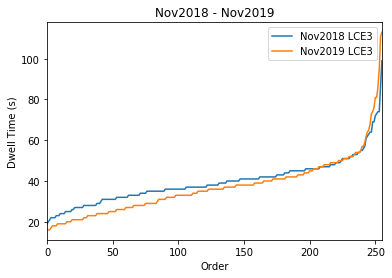


Platform Name LCE5

Platform Name LDF1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    602.000000
mean      21.847176
std        5.096725
min       13.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       56.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    602.000000
mean      20.521595
std        5.024105
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       68.000000
Name: time, dtype: float64
KS two-sample test pValue 5.000085823825688e-06
Dwell Time Increase IS Signficiant


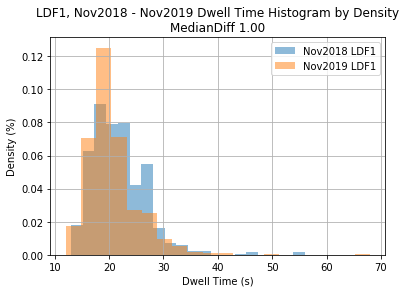

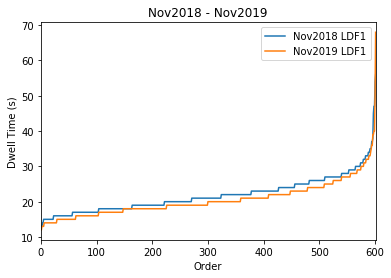


Platform Name LDF2

Platform Name LEP1

Platform Name LEP2

Platform Name LEP3

Platform Name LEP4

Platform Name LEW1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    162.000000
mean      23.228395
std        6.967783
min       14.000000
25%       19.000000
50%       21.500000
75%       25.000000
max       63.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    162.000000
mean      21.796296
std        7.054481
min       13.000000
25%       18.000000
50%       20.500000
75%       24.000000
max       79.000000
Name: time, dtype: float64
KS two-sample test pValue 0.04207423927003851
Dwell Time Increase IS Signficiant


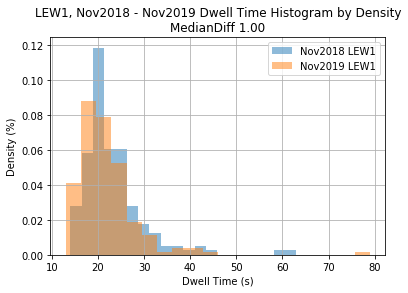

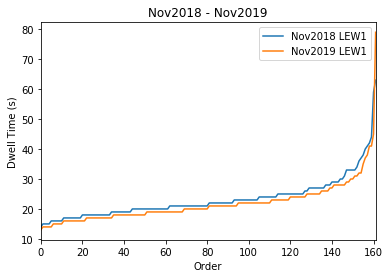


Platform Name LIV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    201.000000
mean      50.338308
std       14.509134
min       19.000000
25%       39.000000
50%       51.000000
75%       60.000000
max       87.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    201.000000
mean      49.870647
std       17.702632
min       14.000000
25%       37.000000
50%       49.000000
75%       63.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.715477445536973
Dwell Time Increase NOT Signficiant


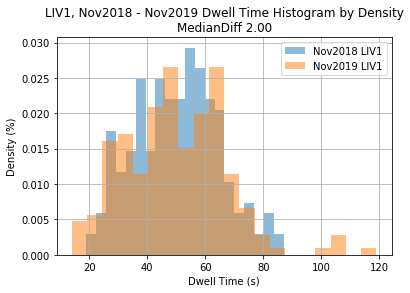

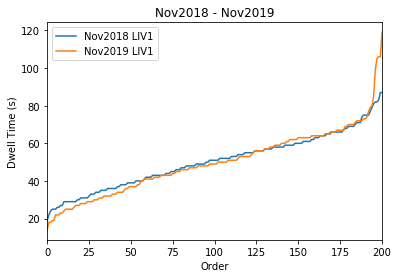


Platform Name LIV2

Platform Name LIV3

Platform Name LTN1

Platform Name LUH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    167.000000
mean      41.443114
std       11.976184
min       18.000000
25%       32.000000
50%       42.000000
75%       49.000000
max       79.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    167.000000
mean      35.491018
std       14.958122
min       12.000000
25%       21.000000
50%       38.000000
75%       46.500000
max       91.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0003343784133924094
Dwell Time Increase IS Signficiant


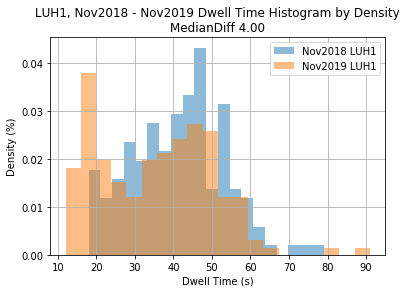

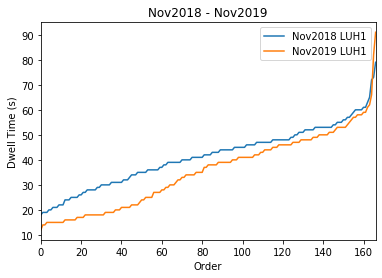


Platform Name MCA1

Platform Name MCA2

Platform Name MCA3

Platform Name MCO1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    294.000000
mean      36.000000
std       10.067011
min       20.000000
25%       29.000000
50%       34.000000
75%       41.000000
max       74.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    294.000000
mean      31.350340
std        8.196585
min       17.000000
25%       26.000000
50%       30.000000
75%       35.000000
max       64.000000
Name: time, dtype: float64
KS two-sample test pValue 2.5265922180960345e-06
Dwell Time Increase IS Signficiant


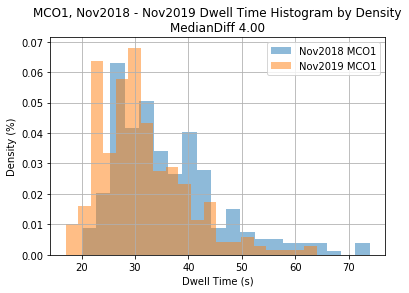

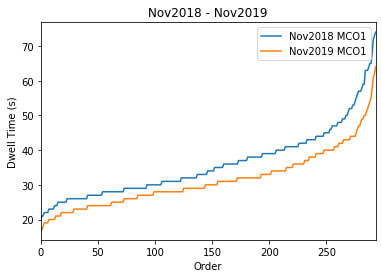


Platform Name MCT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    116.000000
mean      20.603448
std        4.946460
min       15.000000
25%       18.000000
50%       19.000000
75%       22.000000
max       41.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    116.000000
mean      19.491379
std        4.286472
min       12.000000
25%       16.750000
50%       19.000000
75%       22.000000
max       43.000000
Name: time, dtype: float64
KS two-sample test pValue 0.22036783695464207
Dwell Time Decrease NOT Signficiant


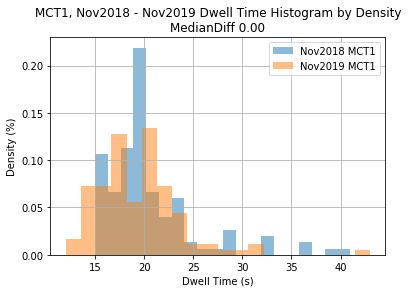

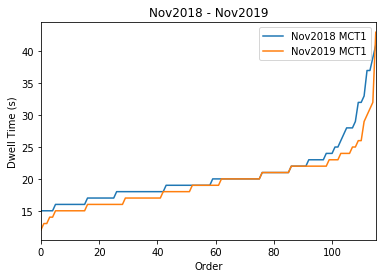


Platform Name MDB1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    298.000000
mean      23.855705
std        4.662623
min       16.000000
25%       21.000000
50%       23.000000
75%       26.000000
max       48.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    298.000000
mean      23.627517
std        7.827185
min       11.000000
25%       19.000000
50%       22.500000
75%       26.000000
max       84.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0016222347750282202
Dwell Time Increase IS Signficiant


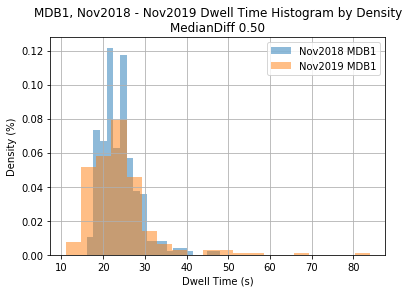

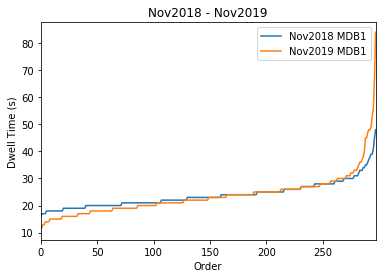


Platform Name MDT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    210.000000
mean      39.638095
std       18.244550
min       18.000000
25%       27.000000
50%       34.000000
75%       45.000000
max      107.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    210.000000
mean      33.514286
std       18.513729
min       13.000000
25%       22.250000
50%       27.000000
75%       37.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 2.772009083227636e-06
Dwell Time Increase IS Signficiant


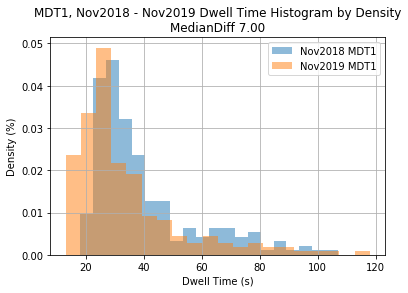

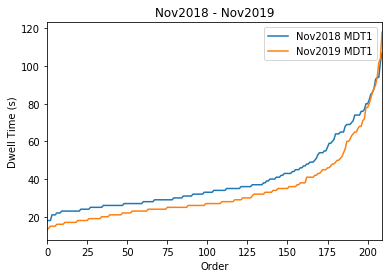


Platform Name MDT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    115.000000
mean      33.339130
std       10.832769
min       18.000000
25%       26.000000
50%       31.000000
75%       38.000000
max       81.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    115.000000
mean      30.939130
std       12.891781
min       15.000000
25%       22.500000
50%       28.000000
75%       34.000000
max       95.000000
Name: time, dtype: float64
KS two-sample test pValue 0.04300935722524225
Dwell Time Increase IS Signficiant


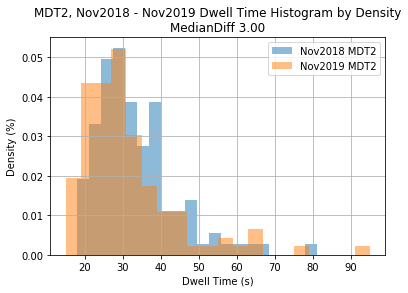

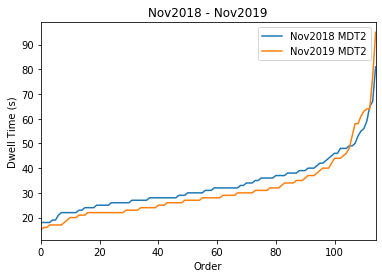


Platform Name MIN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    166.000000
mean      25.813253
std        6.921732
min       17.000000
25%       22.000000
50%       24.500000
75%       27.750000
max       76.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    166.000000
mean      26.548193
std       10.274745
min       13.000000
25%       20.000000
50%       23.000000
75%       29.000000
max       65.000000
Name: time, dtype: float64
KS two-sample test pValue 0.10834743608700652
Dwell Time Increase NOT Signficiant


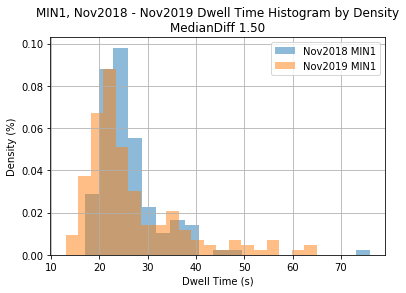

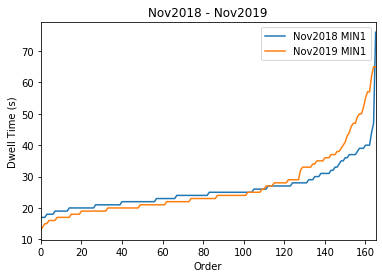


Platform Name MKG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    155.000000
mean      17.741935
std        3.233025
min       13.000000
25%       16.000000
50%       17.000000
75%       19.000000
max       39.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    155.000000
mean      18.109677
std        4.486007
min       12.000000
25%       16.000000
50%       17.000000
75%       19.000000
max       48.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9573586653688047
Dwell Time Decrease NOT Signficiant


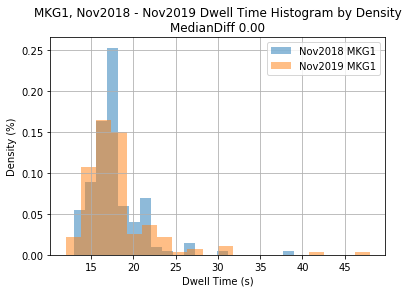

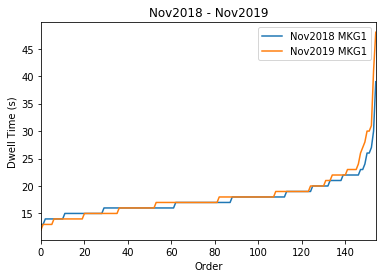


Platform Name MKV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    126.000000
mean      30.960317
std       15.831816
min       16.000000
25%       22.000000
50%       25.000000
75%       31.000000
max       87.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    126.000000
mean      23.563492
std       10.357989
min       12.000000
25%       18.000000
50%       20.500000
75%       26.000000
max       74.000000
Name: time, dtype: float64
KS two-sample test pValue 1.5643428983172553e-07
Dwell Time Increase IS Signficiant


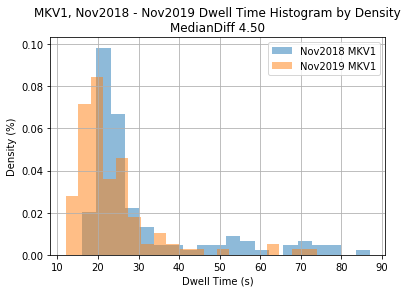

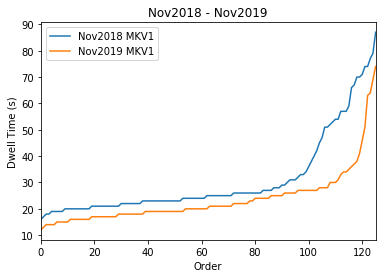


Platform Name MPT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    844.000000
mean      22.190758
std        5.636297
min       11.000000
25%       19.000000
50%       21.000000
75%       25.000000
max       80.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    844.000000
mean      24.207346
std        8.845364
min       12.000000
25%       20.000000
50%       23.000000
75%       26.000000
max      112.000000
Name: time, dtype: float64
KS two-sample test pValue 2.4968174073350647e-06
Dwell Time Decrease IS Signficiant


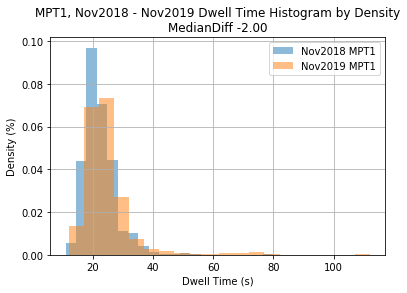

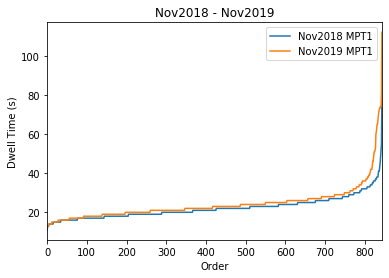


Platform Name MQF1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    188.000000
mean      48.265957
std       14.388554
min       15.000000
25%       40.000000
50%       51.000000
75%       58.000000
max       84.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    188.000000
mean      48.090426
std       15.734676
min       13.000000
25%       37.000000
50%       52.000000
75%       59.250000
max       84.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9538613171379497
Dwell Time Decrease NOT Signficiant


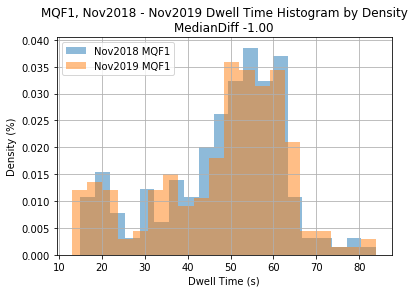

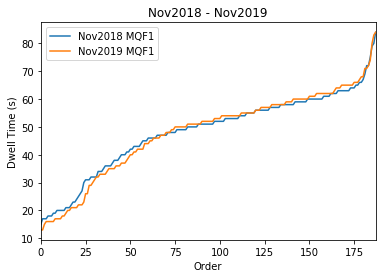


Platform Name MSM2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    459.000000
mean      23.483660
std        5.876202
min       15.000000
25%       19.000000
50%       22.000000
75%       26.000000
max       48.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    459.000000
mean      25.915033
std        8.835183
min       14.000000
25%       20.000000
50%       24.000000
75%       29.000000
max      100.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0010043345435903261
Dwell Time Decrease IS Signficiant


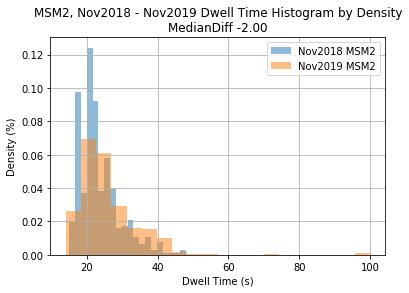

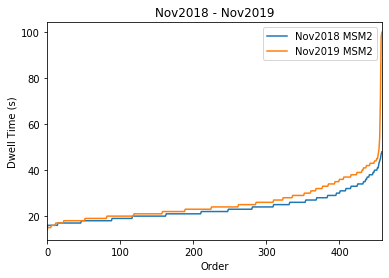


Platform Name MTC1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    156.000000
mean      21.179487
std        5.295753
min       13.000000
25%       17.000000
50%       20.000000
75%       24.000000
max       37.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    156.000000
mean      19.083333
std        4.651685
min       12.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       37.000000
Name: time, dtype: float64
KS two-sample test pValue 0.008988404430772461
Dwell Time Increase IS Signficiant


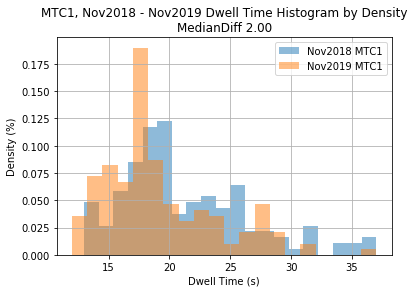

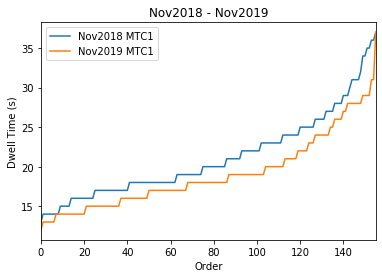


Platform Name MUL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    166.000000
mean      25.289157
std       12.320006
min       13.000000
25%       18.000000
50%       21.500000
75%       29.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    166.000000
mean      23.897590
std       13.998108
min       12.000000
25%       16.000000
50%       19.000000
75%       24.000000
max       99.000000
Name: time, dtype: float64
KS two-sample test pValue 0.017632763461367253
Dwell Time Increase IS Signficiant


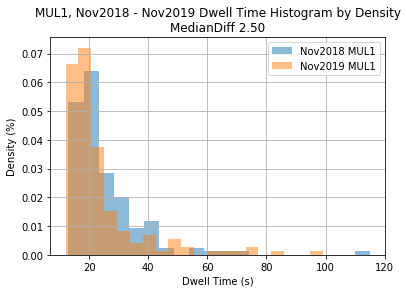

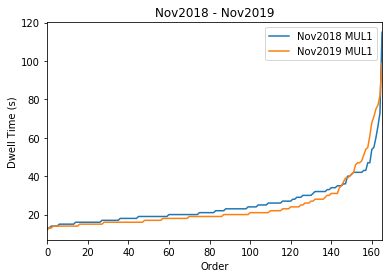


Platform Name MYG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    226.000000
mean      20.641593
std        5.961345
min       13.000000
25%       18.000000
50%       19.000000
75%       22.000000
max       70.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    226.000000
mean      20.092920
std        7.524493
min       12.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       82.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0011482170622006379
Dwell Time Increase IS Signficiant


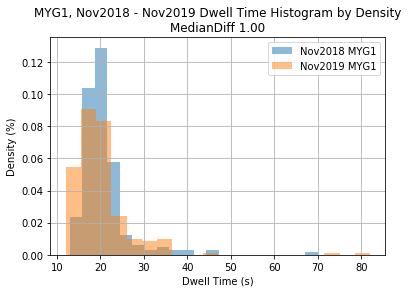

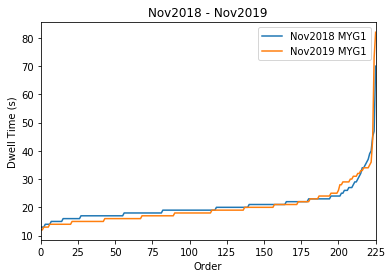


Platform Name MYL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    215.000000
mean      32.734884
std        9.213939
min       19.000000
25%       28.000000
50%       31.000000
75%       35.000000
max       92.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    215.000000
mean      34.725581
std       14.236128
min       15.000000
25%       26.000000
50%       31.000000
75%       38.000000
max      100.000000
Name: time, dtype: float64
KS two-sample test pValue 0.08616718975487236
Dwell Time Decrease NOT Signficiant


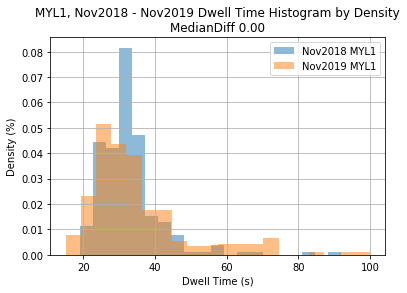

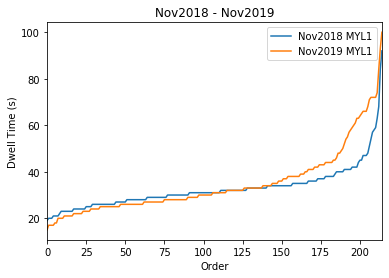


Platform Name NMH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    299.000000
mean      21.167224
std        5.754379
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       48.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    299.000000
mean      20.277592
std        6.486424
min       10.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       96.000000
Name: time, dtype: float64
KS two-sample test pValue 0.17467008047226412
Dwell Time Increase NOT Signficiant


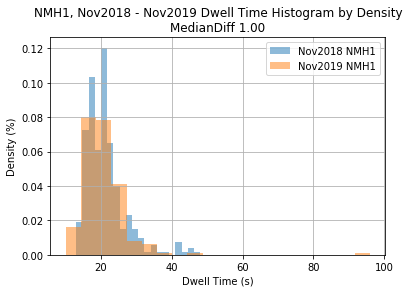

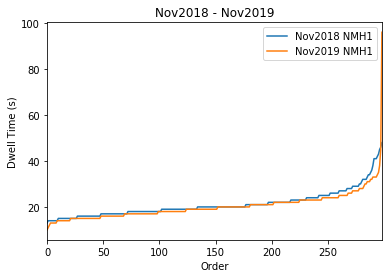


Platform Name NRW1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    158.000000
mean      34.987342
std       11.827307
min       15.000000
25%       26.000000
50%       34.000000
75%       42.000000
max       73.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    158.000000
mean      36.784810
std       13.399468
min       13.000000
25%       25.000000
50%       35.500000
75%       47.000000
max       66.000000
Name: time, dtype: float64
KS two-sample test pValue 0.39364245229755496
Dwell Time Decrease NOT Signficiant


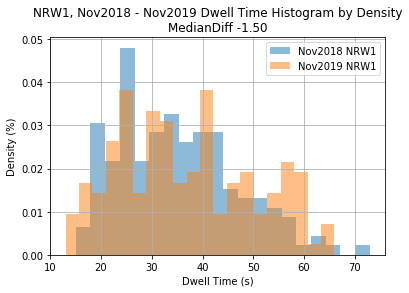

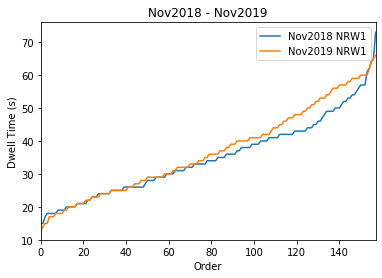


Platform Name NST1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    91.000000
mean     21.868132
std       6.615149
min      14.000000
25%      18.000000
50%      20.000000
75%      23.000000
max      58.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    91.000000
mean     20.098901
std       4.176801
min      13.000000
25%      17.000000
50%      19.000000
75%      22.000000
max      34.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6447378723088867
Dwell Time Increase NOT Signficiant


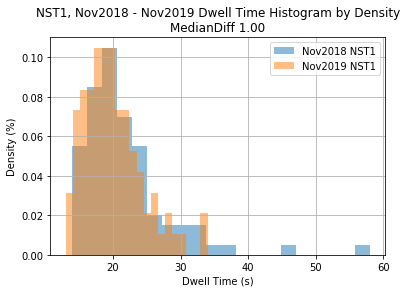

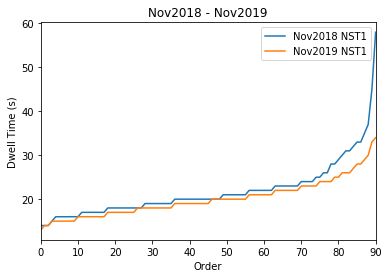


Platform Name NSY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    770.000000
mean      35.315584
std       13.384108
min       15.000000
25%       26.000000
50%       32.000000
75%       40.000000
max       92.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    770.000000
mean      64.464935
std       28.673117
min       16.000000
25%       39.000000
50%       60.000000
75%       91.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 4.37237329046527e-84
Dwell Time Decrease IS Signficiant


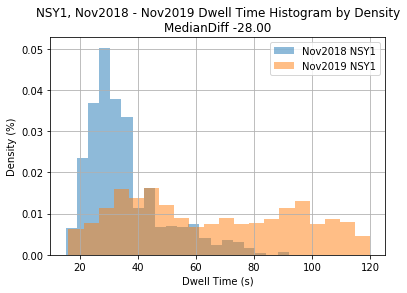

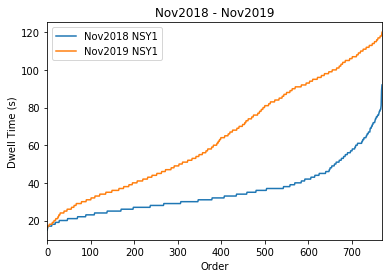


Platform Name NSY2

Platform Name NSY3

Platform Name NTN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    286.000000
mean      26.748252
std        9.369206
min       16.000000
25%       22.000000
50%       24.000000
75%       29.750000
max       94.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    286.000000
mean      25.433566
std        9.469107
min       14.000000
25%       21.000000
50%       23.000000
75%       27.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.313774200507523
Dwell Time Increase NOT Signficiant


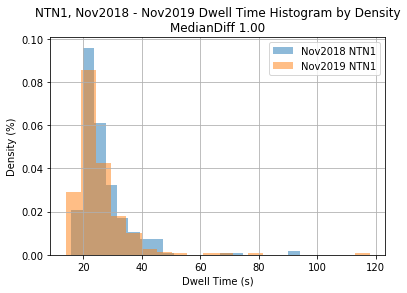

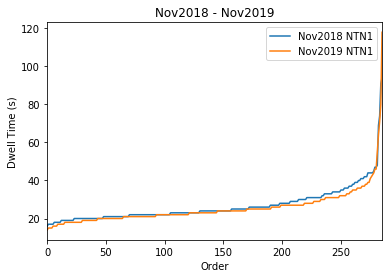


Platform Name PAD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    150.000000
mean      40.033333
std       18.505728
min       15.000000
25%       24.000000
50%       37.000000
75%       53.750000
max       99.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    150.000000
mean      35.033333
std       15.856071
min       13.000000
25%       19.250000
50%       33.500000
75%       49.000000
max       73.000000
Name: time, dtype: float64
KS two-sample test pValue 0.07930977331891072
Dwell Time Increase NOT Signficiant


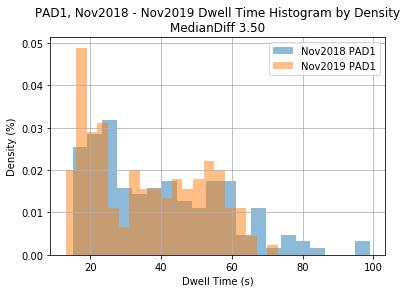

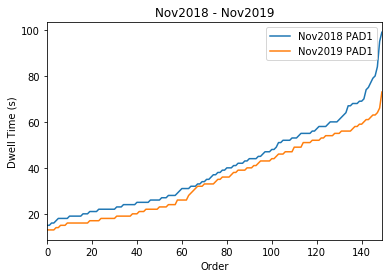


Platform Name PAN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    159.000000
mean      21.415094
std        4.727113
min       14.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       42.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    159.000000
mean      19.968553
std        4.851493
min       12.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       45.000000
Name: time, dtype: float64
KS two-sample test pValue 0.009961732827413737
Dwell Time Increase IS Signficiant


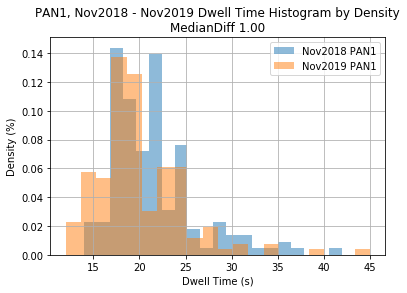

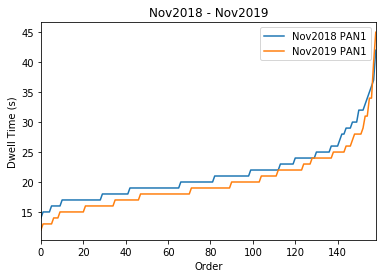


Platform Name PDH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    221.000000
mean      23.950226
std        5.673083
min       15.000000
25%       20.000000
50%       23.000000
75%       25.000000
max       48.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    221.000000
mean      22.212670
std        5.100359
min       14.000000
25%       19.000000
50%       22.000000
75%       24.000000
max       55.000000
Name: time, dtype: float64
KS two-sample test pValue 0.014383486644241576
Dwell Time Increase IS Signficiant


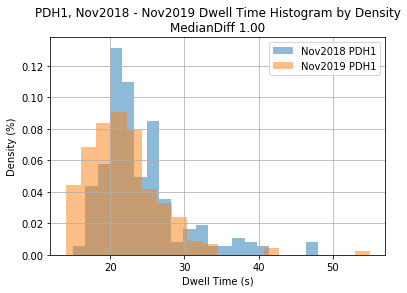

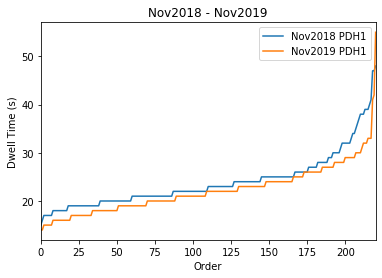


Platform Name PDH2

Platform Name PEN1

Platform Name PEN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    55.000000
mean     46.400000
std      19.410383
min      17.000000
25%      31.000000
50%      44.000000
75%      63.500000
max      91.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     55.000000
mean      53.563636
std       22.842264
min       16.000000
25%       32.000000
50%       52.000000
75%       75.500000
max      112.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3255178214811779
Dwell Time Decrease NOT Signficiant


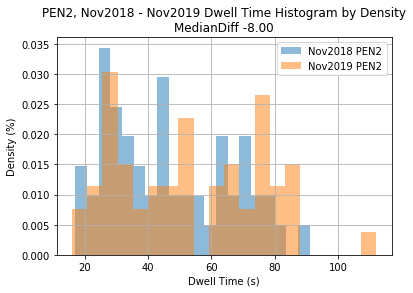

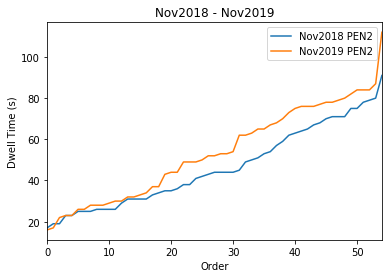


Platform Name PEN3

Platform Name PET1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    142.000000
mean      29.725352
std        8.679596
min       16.000000
25%       23.000000
50%       27.500000
75%       34.000000
max       64.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    142.000000
mean      32.274648
std       10.534068
min       15.000000
25%       23.250000
50%       31.500000
75%       42.750000
max       53.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00787119976252994
Dwell Time Decrease IS Signficiant


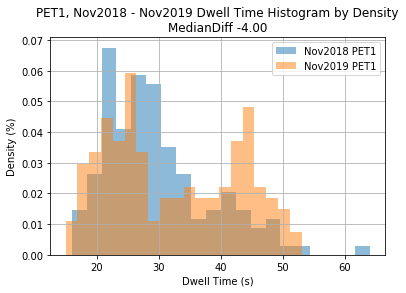

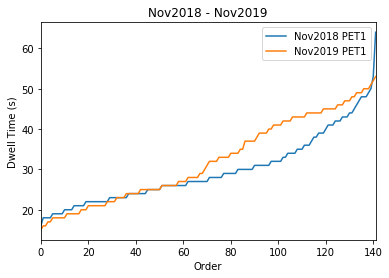


Platform Name PNT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    279.000000
mean      23.921147
std        7.292024
min       14.000000
25%       19.000000
50%       22.000000
75%       27.000000
max       60.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    279.000000
mean      19.870968
std        6.179379
min       10.000000
25%       16.000000
50%       19.000000
75%       22.000000
max       67.000000
Name: time, dtype: float64
KS two-sample test pValue 9.2935501212952e-10
Dwell Time Increase IS Signficiant


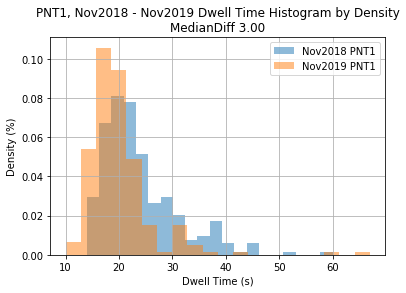

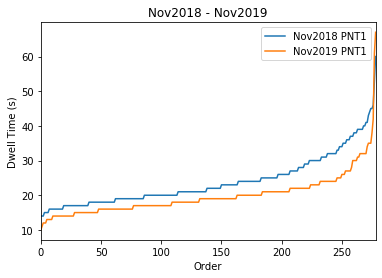


Platform Name PTA1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    541.000000
mean      49.863216
std       17.499835
min       22.000000
25%       38.000000
50%       44.000000
75%       56.000000
max      113.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    541.000000
mean      48.861368
std       19.995953
min       16.000000
25%       34.000000
50%       43.000000
75%       59.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 7.859413358255975e-05
Dwell Time Increase IS Signficiant


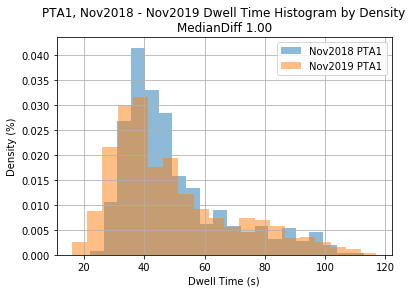

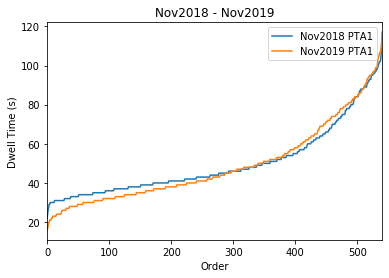


Platform Name PTA3

Platform Name PTA4

Platform Name PUN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    124.000000
mean      24.540323
std        5.617046
min       14.000000
25%       20.000000
50%       23.500000
75%       27.000000
max       46.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    124.000000
mean      25.508065
std        5.837217
min       14.000000
25%       22.000000
50%       25.000000
75%       28.000000
max       56.000000
Name: time, dtype: float64
KS two-sample test pValue 0.14679114089728007
Dwell Time Decrease NOT Signficiant


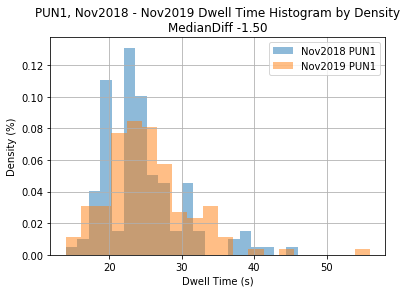

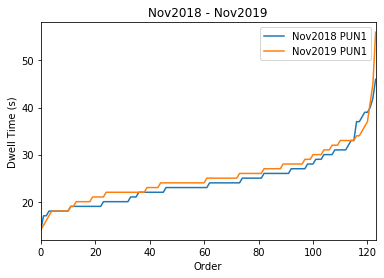


Platform Name PYM1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    385.000000
mean      24.942857
std        8.551733
min       14.000000
25%       20.000000
50%       22.000000
75%       29.000000
max      102.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    385.000000
mean      25.361039
std        8.881573
min       12.000000
25%       19.000000
50%       23.000000
75%       29.000000
max       70.000000
Name: time, dtype: float64
KS two-sample test pValue 0.09930387043417685
Dwell Time Decrease NOT Signficiant


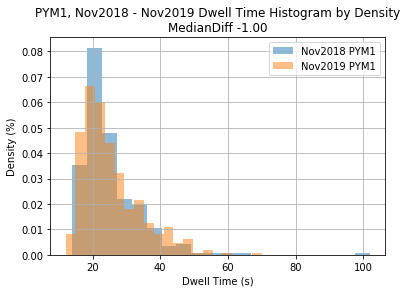

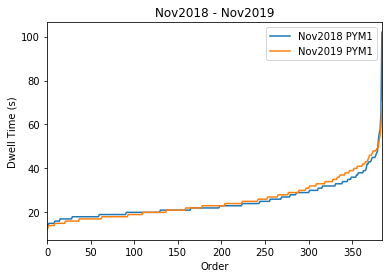


Platform Name QKH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    216.000000
mean      26.592593
std        6.261045
min       15.000000
25%       22.000000
50%       26.000000
75%       30.000000
max       46.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    216.000000
mean      25.106481
std       12.453551
min       13.000000
25%       19.000000
50%       22.000000
75%       26.000000
max       98.000000
Name: time, dtype: float64
KS two-sample test pValue 1.6948248440268713e-07
Dwell Time Increase IS Signficiant


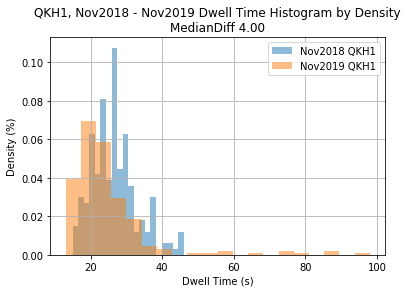

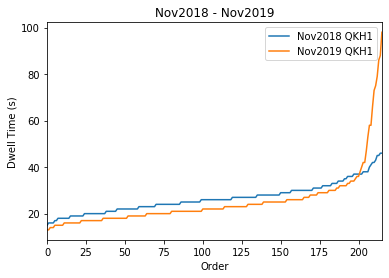


Platform Name RD01

Platform Name RD03
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    844.000000
mean      38.067536
std       15.359247
min       17.000000
25%       28.000000
50%       33.000000
75%       43.000000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    844.000000
mean      34.786730
std       16.370039
min       15.000000
25%       24.000000
50%       29.000000
75%       38.000000
max      109.000000
Name: time, dtype: float64
KS two-sample test pValue 3.5557723495960314e-13
Dwell Time Increase IS Signficiant


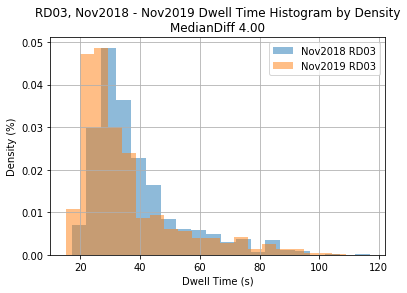

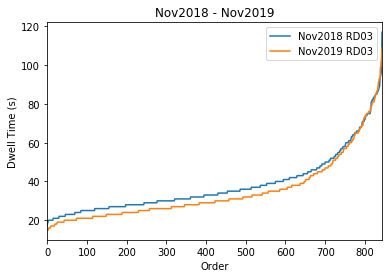


Platform Name RD05
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    290.000000
mean      36.251724
std       14.747309
min       16.000000
25%       25.000000
50%       31.000000
75%       43.750000
max      104.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    290.000000
mean      41.506897
std       17.329344
min       14.000000
25%       26.250000
50%       37.000000
75%       57.000000
max       81.000000
Name: time, dtype: float64
KS two-sample test pValue 3.8306309475526717e-05
Dwell Time Decrease IS Signficiant


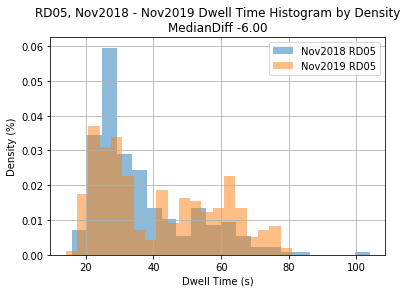

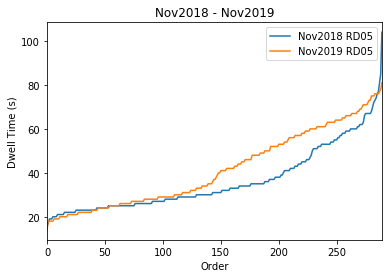


Platform Name RD07
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    103.000000
mean      30.747573
std        9.314461
min       17.000000
25%       25.000000
50%       28.000000
75%       33.000000
max       58.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    103.000000
mean      24.854369
std        8.757526
min       14.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       83.000000
Name: time, dtype: float64
KS two-sample test pValue 2.6765210749834253e-06
Dwell Time Increase IS Signficiant


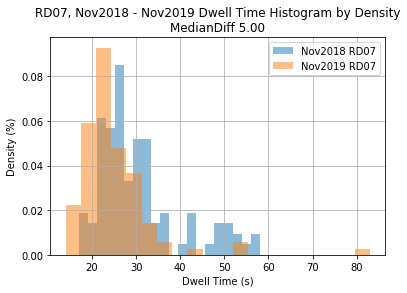

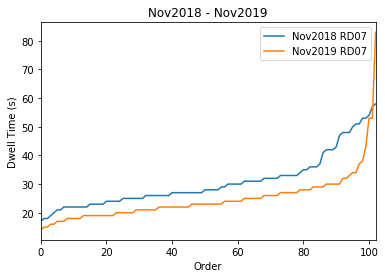


Platform Name RD09

Platform Name RDS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    330.000000
mean      31.154545
std        9.531442
min       17.000000
25%       25.000000
50%       29.000000
75%       34.750000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    330.000000
mean      28.930303
std       12.289244
min       12.000000
25%       21.000000
50%       26.000000
75%       33.750000
max       88.000000
Name: time, dtype: float64
KS two-sample test pValue 1.5178936207373994e-06
Dwell Time Increase IS Signficiant


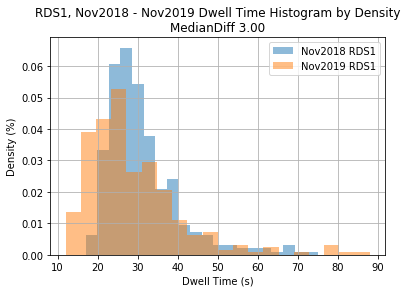

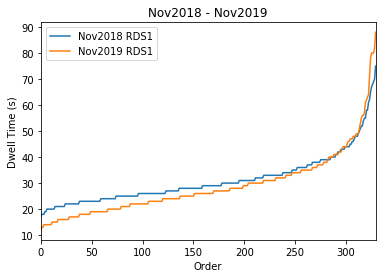


Platform Name RIC2

Platform Name RIV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    117.000000
mean      48.076923
std       27.093120
min       14.000000
25%       25.000000
50%       40.000000
75%       64.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    117.000000
mean      63.128205
std       32.392671
min       15.000000
25%       36.000000
50%       63.000000
75%       90.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.001446295894186644
Dwell Time Decrease IS Signficiant


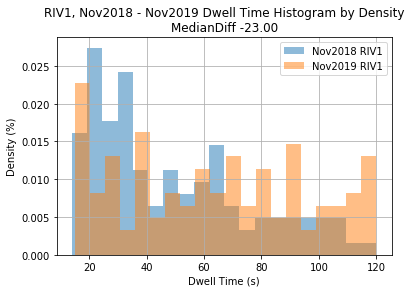

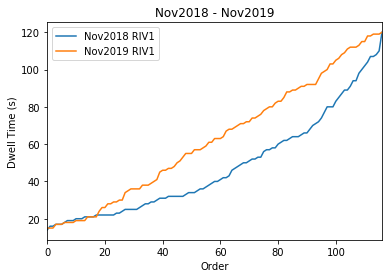


Platform Name RPK1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    129.000000
mean      50.108527
std       32.811307
min       13.000000
25%       22.000000
50%       38.000000
75%       73.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    129.000000
mean      66.875969
std       32.723035
min       16.000000
25%       35.000000
50%       70.000000
75%       95.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 2.4345311396724942e-05
Dwell Time Decrease IS Signficiant


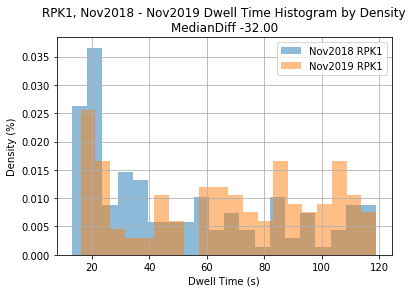

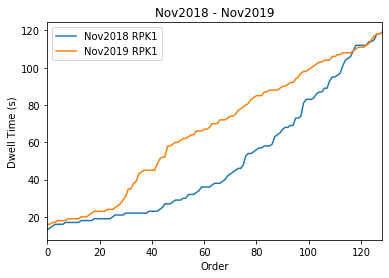


Platform Name RSV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    630.000000
mean      22.060317
std        6.960222
min       12.000000
25%       18.000000
50%       20.000000
75%       24.000000
max       81.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    630.000000
mean      19.106349
std        4.789010
min       11.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       73.000000
Name: time, dtype: float64
KS two-sample test pValue 2.8848887802207536e-13
Dwell Time Increase IS Signficiant


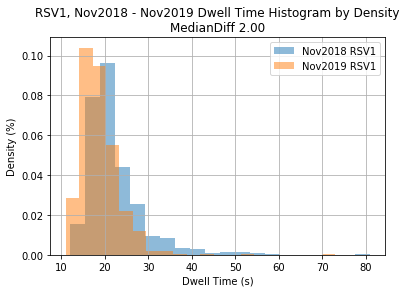

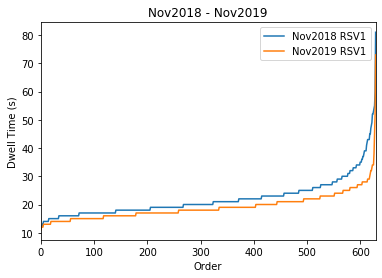


Platform Name RTY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    205.000000
mean      31.409756
std       11.103254
min       14.000000
25%       24.000000
50%       30.000000
75%       36.000000
max      104.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    205.000000
mean      25.024390
std        9.462226
min       12.000000
25%       18.000000
50%       22.000000
75%       31.000000
max       82.000000
Name: time, dtype: float64
KS two-sample test pValue 2.659880909822743e-11
Dwell Time Increase IS Signficiant


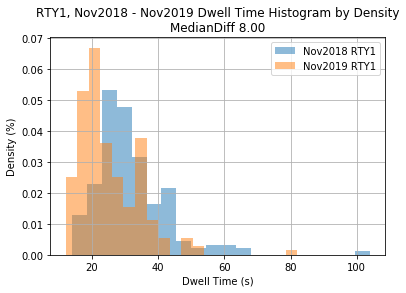

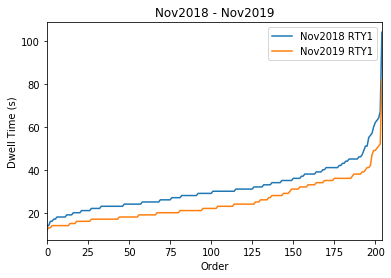


Platform Name RTY2

Platform Name RVS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    119.000000
mean      51.411765
std       14.597081
min       20.000000
25%       40.500000
50%       52.000000
75%       63.000000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    119.000000
mean      51.327731
std       13.208311
min       17.000000
25%       44.000000
50%       52.000000
75%       60.000000
max       92.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6916996724992124
Dwell Time Decrease NOT Signficiant


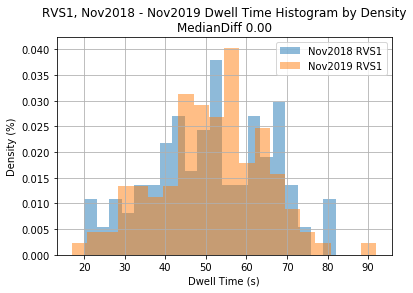

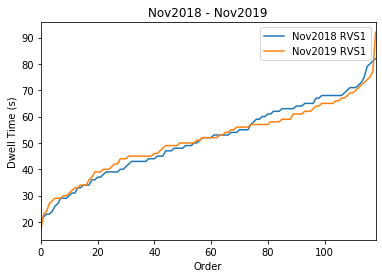


Platform Name RVS2

Platform Name RVS3

Platform Name RWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    177.000000
mean      24.350282
std        5.963088
min       17.000000
25%       21.000000
50%       24.000000
75%       26.000000
max       74.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    177.000000
mean      26.005650
std       10.032049
min       13.000000
25%       20.000000
50%       23.000000
75%       28.000000
max       70.000000
Name: time, dtype: float64
KS two-sample test pValue 0.10069711639203938
Dwell Time Increase NOT Signficiant


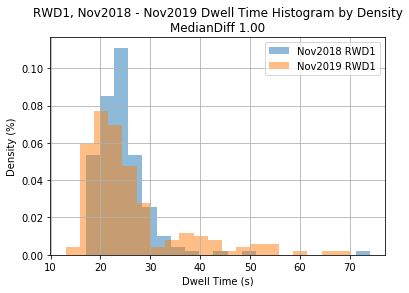

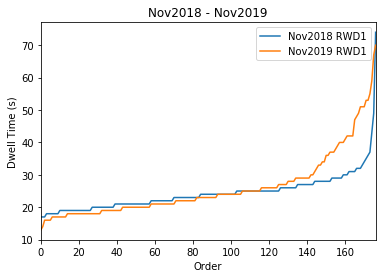


Platform Name SCO1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    106.000000
mean      38.264151
std       25.906536
min       13.000000
25%       19.000000
50%       24.000000
75%       63.750000
max      106.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    106.000000
mean      25.198113
std       15.754316
min       13.000000
25%       17.000000
50%       20.000000
75%       26.000000
max      106.000000
Name: time, dtype: float64
KS two-sample test pValue 0.001164411232676064
Dwell Time Increase IS Signficiant


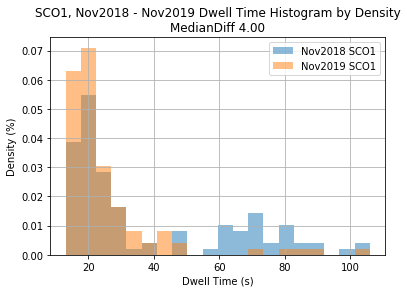

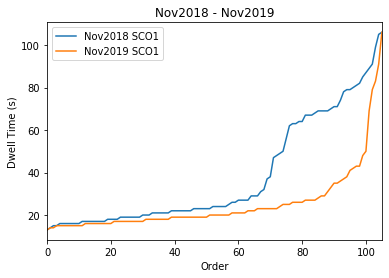


Platform Name SCO2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    33.000000
mean     39.484848
std      20.599031
min      19.000000
25%      24.000000
50%      29.000000
75%      51.000000
max      94.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    33.000000
mean     37.696970
std      26.573583
min      15.000000
25%      17.000000
50%      26.000000
75%      49.000000
max      94.000000
Name: time, dtype: float64
KS two-sample test pValue 0.05046994940501517
Dwell Time Increase NOT Signficiant


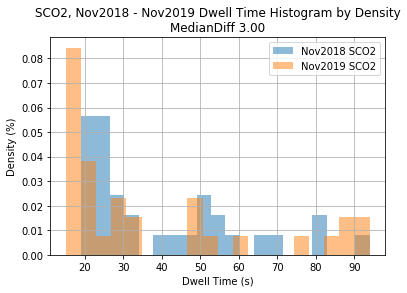

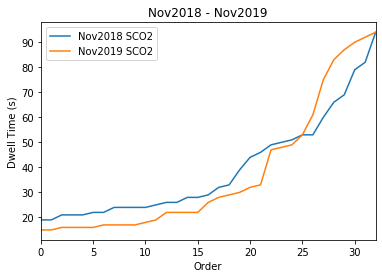


Platform Name SD08

Platform Name SD10

Platform Name SD12

Platform Name SDT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    274.000000
mean      32.000000
std        8.788104
min       17.000000
25%       26.000000
50%       31.000000
75%       37.000000
max       72.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    274.000000
mean      29.682482
std        9.054450
min       15.000000
25%       24.000000
50%       28.000000
75%       33.000000
max       70.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0023099001874010215
Dwell Time Increase IS Signficiant


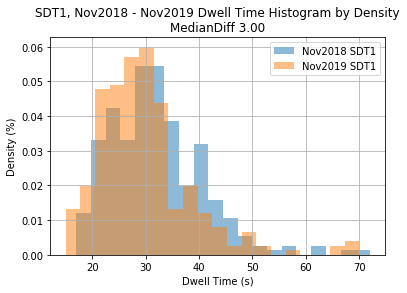

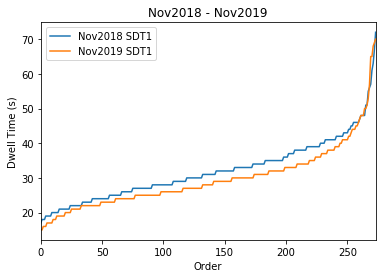


Platform Name SFT1

Platform Name SIT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    303.000000
mean      29.917492
std        7.903168
min       16.000000
25%       25.000000
50%       28.000000
75%       34.500000
max       65.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    303.000000
mean      24.498350
std        6.369877
min       14.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       54.000000
Name: time, dtype: float64
KS two-sample test pValue 1.7337820675231125e-17
Dwell Time Increase IS Signficiant


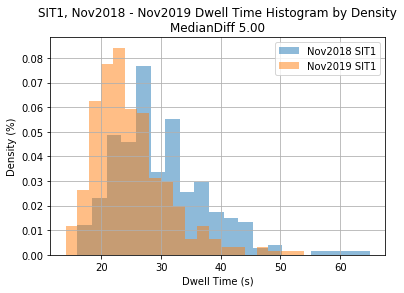

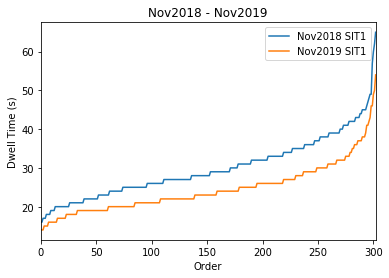


Platform Name SMH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    156.000000
mean      24.500000
std        6.117663
min       15.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       45.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    156.000000
mean      21.365385
std        6.761453
min       12.000000
25%       17.000000
50%       20.000000
75%       23.000000
max       65.000000
Name: time, dtype: float64
KS two-sample test pValue 2.2148650759847094e-05
Dwell Time Increase IS Signficiant


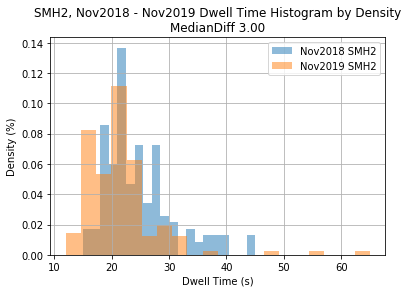

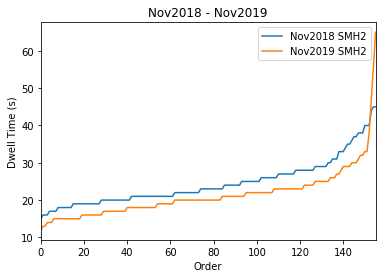


Platform Name SMR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    163.000000
mean      28.042945
std        7.634675
min       15.000000
25%       22.000000
50%       26.000000
75%       33.500000
max       46.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    163.000000
mean      27.282209
std        8.220352
min       13.000000
25%       21.000000
50%       26.000000
75%       34.500000
max       47.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4131596881195867
Dwell Time Decrease NOT Signficiant


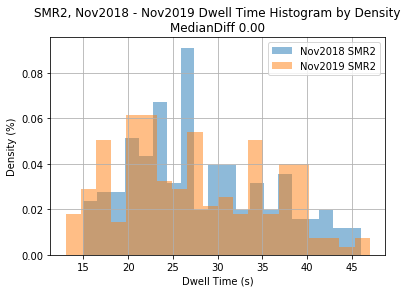

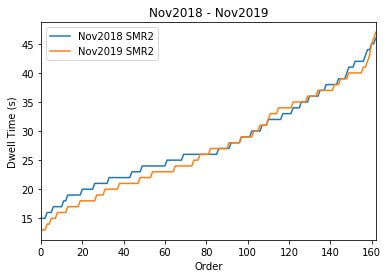


Platform Name STJ2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    457.000000
mean      21.363239
std        5.991533
min       14.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       88.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    457.000000
mean      22.518600
std        5.161874
min       13.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       60.000000
Name: time, dtype: float64
KS two-sample test pValue 6.201608105914455e-06
Dwell Time Decrease IS Signficiant


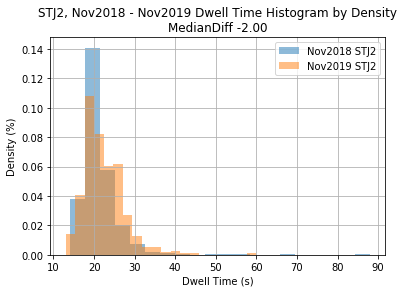

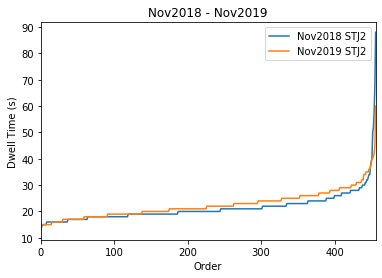


Platform Name STL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    820.000000
mean      24.450000
std        6.655389
min       14.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       73.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    820.000000
mean      29.603659
std        9.274421
min       12.000000
25%       23.000000
50%       28.000000
75%       35.000000
max       86.000000
Name: time, dtype: float64
KS two-sample test pValue 3.1795050205489914e-33
Dwell Time Decrease IS Signficiant


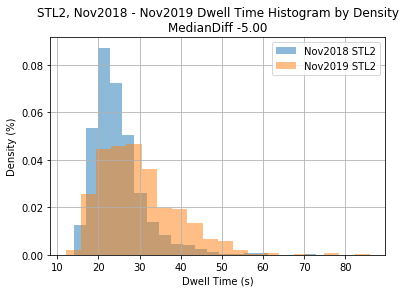

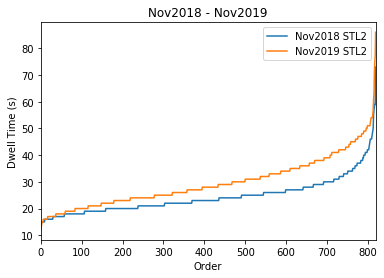


Platform Name STM1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    226.000000
mean      34.407080
std       16.303312
min       17.000000
25%       24.000000
50%       30.000000
75%       39.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    226.000000
mean      26.986726
std       11.159642
min       12.000000
25%       20.000000
50%       25.000000
75%       30.000000
max       78.000000
Name: time, dtype: float64
KS two-sample test pValue 6.848274207461388e-08
Dwell Time Increase IS Signficiant


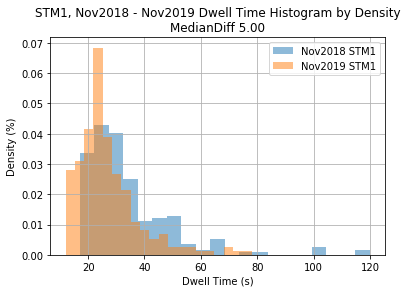

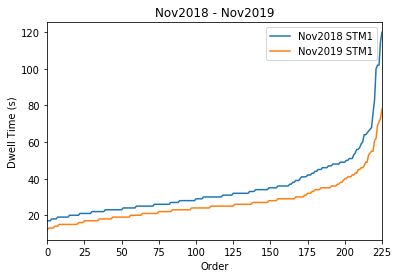


Platform Name STM2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    65.000000
mean     29.061538
std       6.670544
min      20.000000
25%      25.000000
50%      28.000000
75%      32.000000
max      54.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    65.000000
mean     26.800000
std       9.861858
min      15.000000
25%      21.000000
50%      25.000000
75%      29.000000
max      66.000000
Name: time, dtype: float64
KS two-sample test pValue 0.007459965710941828
Dwell Time Increase IS Signficiant


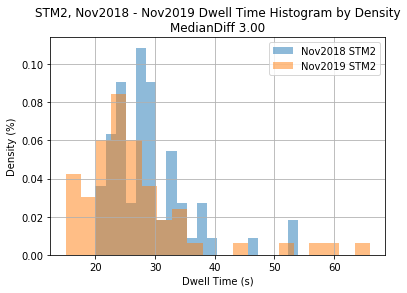

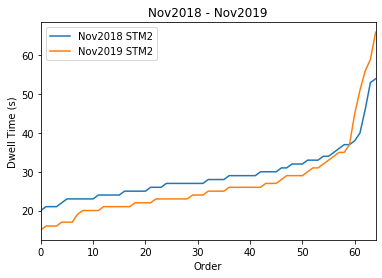


Platform Name STP1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    61.000000
mean     25.147541
std       6.536656
min      17.000000
25%      21.000000
50%      23.000000
75%      27.000000
max      48.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    61.000000
mean     24.016393
std       6.601747
min      13.000000
25%      19.000000
50%      23.000000
75%      28.000000
max      48.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5237934776681328
Dwell Time Decrease NOT Signficiant


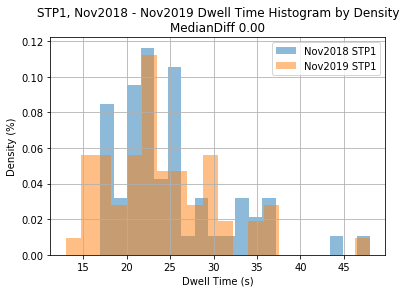

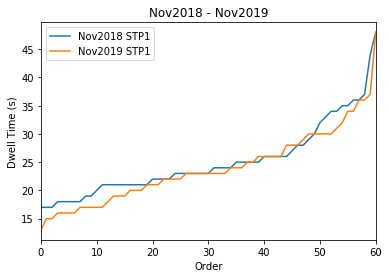


Platform Name STR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     74.000000
mean      39.459459
std       18.178106
min       23.000000
25%       29.250000
50%       35.000000
75%       40.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     74.000000
mean      58.081081
std       25.459480
min       24.000000
25%       37.250000
50%       49.500000
75%       75.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 5.333684049222269e-07
Dwell Time Decrease IS Signficiant


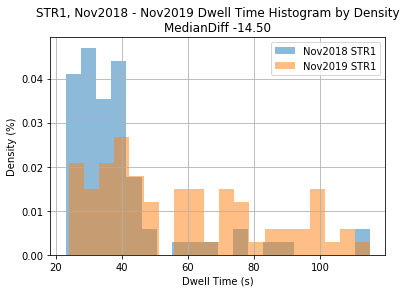

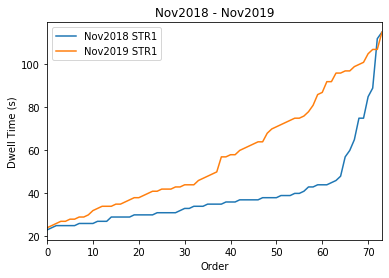


Platform Name STR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     68.000000
mean      41.117647
std       17.239775
min       20.000000
25%       30.000000
50%       36.000000
75%       44.250000
max      107.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     68.000000
mean      34.941176
std       17.740991
min       16.000000
25%       24.000000
50%       30.000000
75%       39.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 3.55973331852073e-05
Dwell Time Increase IS Signficiant


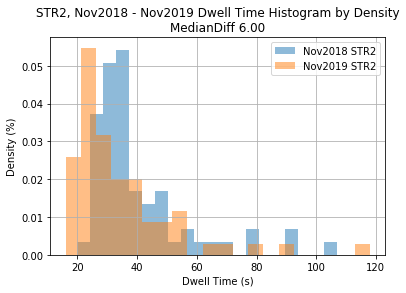

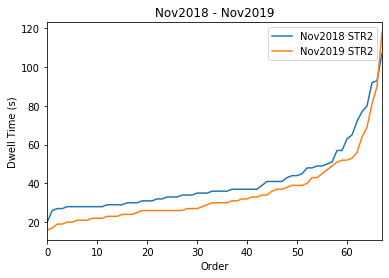


Platform Name STR4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    492.000000
mean      41.711382
std       17.025859
min       18.000000
25%       30.000000
50%       36.000000
75%       49.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    492.000000
mean      34.327236
std       16.843010
min       16.000000
25%       24.000000
50%       28.000000
75%       39.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 1.384982503386557e-20
Dwell Time Increase IS Signficiant


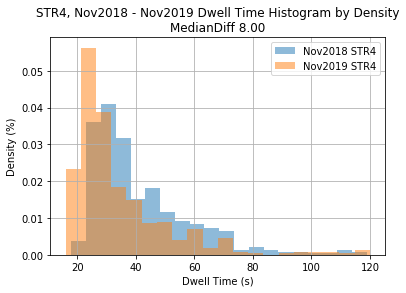

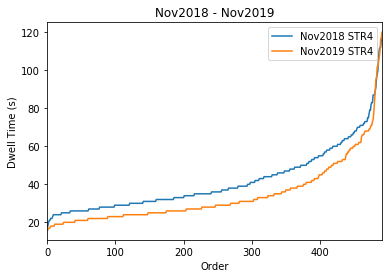


Platform Name STR5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    223.000000
mean      64.313901
std       25.800868
min       20.000000
25%       43.000000
50%       63.000000
75%       84.500000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    223.000000
mean      64.264574
std       29.323252
min       21.000000
25%       37.000000
50%       61.000000
75%       90.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3317223562178838
Dwell Time Increase NOT Signficiant


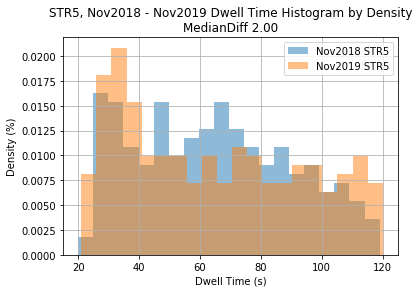

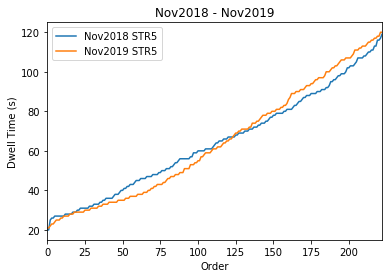


Platform Name STR7
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    275.000000
mean      35.840000
std       11.212115
min       19.000000
25%       29.000000
50%       33.000000
75%       40.500000
max       93.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    275.000000
mean      34.138182
std       14.154614
min       15.000000
25%       26.000000
50%       30.000000
75%       37.000000
max       98.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0003132696967438667
Dwell Time Increase IS Signficiant


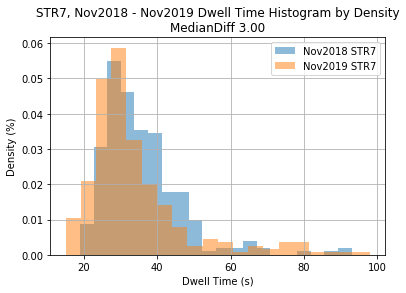

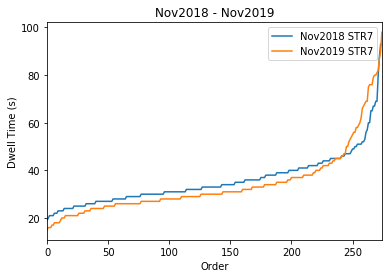


Platform Name SVH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    379.000000
mean      31.741425
std       11.741558
min       17.000000
25%       23.000000
50%       28.000000
75%       38.000000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    379.000000
mean      26.907652
std       11.556368
min       14.000000
25%       20.000000
50%       24.000000
75%       30.000000
max      106.000000
Name: time, dtype: float64
KS two-sample test pValue 1.4170287453805286e-09
Dwell Time Increase IS Signficiant


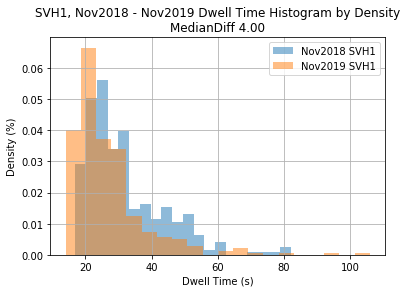

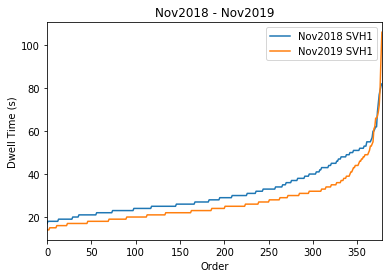


Platform Name SVH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    158.000000
mean      34.120253
std        8.384363
min       17.000000
25%       29.000000
50%       32.000000
75%       38.750000
max       66.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    158.000000
mean      29.139241
std       10.287874
min       13.000000
25%       22.000000
50%       27.000000
75%       33.750000
max       72.000000
Name: time, dtype: float64
KS two-sample test pValue 1.570906970274915e-09
Dwell Time Increase IS Signficiant


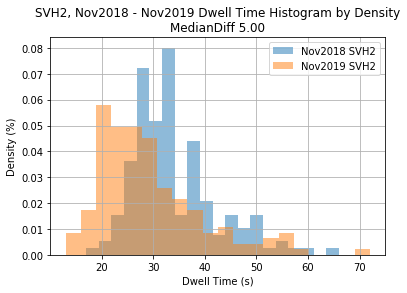

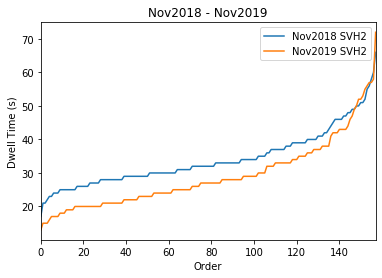


Platform Name SYD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    106.000000
mean      34.660377
std       12.319467
min       17.000000
25%       27.000000
50%       32.000000
75%       40.000000
max       99.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    106.000000
mean      31.584906
std        9.352227
min       15.000000
25%       25.000000
50%       30.000000
75%       37.750000
max       69.000000
Name: time, dtype: float64
KS two-sample test pValue 0.23975409302115847
Dwell Time Increase NOT Signficiant


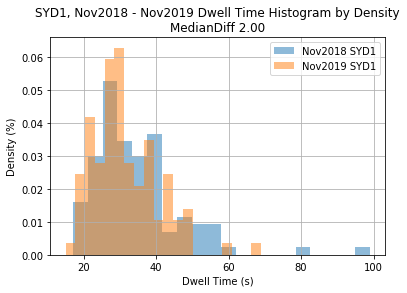

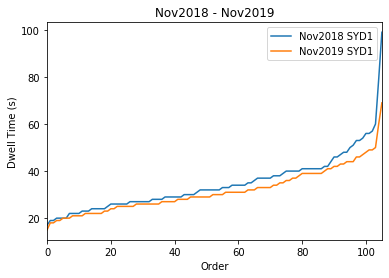


Platform Name TGB1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    229.000000
mean      33.611354
std       11.845202
min       16.000000
25%       23.000000
50%       31.000000
75%       43.000000
max       65.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    229.000000
mean      29.991266
std       12.257826
min       12.000000
25%       20.000000
50%       25.000000
75%       41.000000
max       63.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0025630304711151794
Dwell Time Increase IS Signficiant


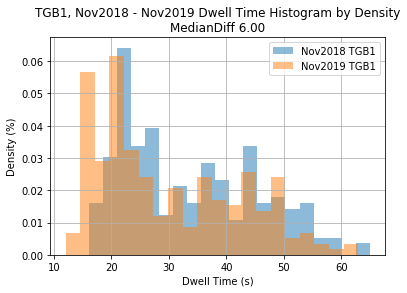

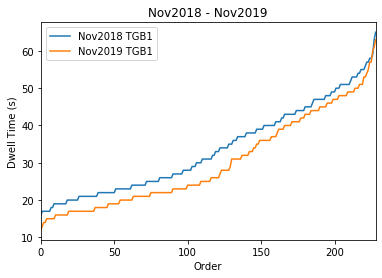


Platform Name TGB2

Platform Name THL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    665.000000
mean      57.433083
std       29.600077
min       16.000000
25%       36.000000
50%       44.000000
75%       74.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    665.000000
mean      73.769925
std       27.316689
min       18.000000
25%       50.000000
50%       72.000000
75%       98.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 3.268594621319091e-33
Dwell Time Decrease IS Signficiant


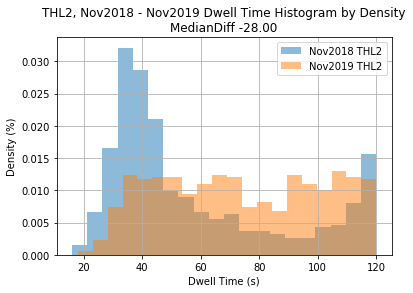

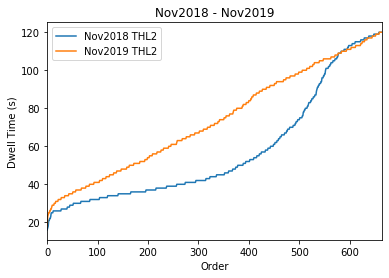


Platform Name THL6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    496.000000
mean      43.270161
std       12.204304
min       23.000000
25%       35.000000
50%       41.000000
75%       50.000000
max      112.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    496.000000
mean      31.243952
std       11.879996
min       14.000000
25%       23.000000
50%       28.000000
75%       36.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 1.2859894209830533e-51
Dwell Time Increase IS Signficiant


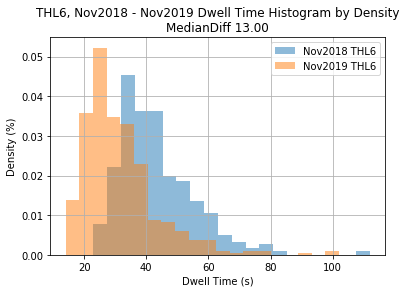

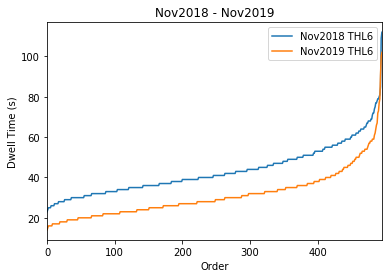


Platform Name THR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    276.000000
mean      20.601449
std        6.426694
min       13.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       63.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    276.000000
mean      18.579710
std        4.611151
min       11.000000
25%       16.000000
50%       18.000000
75%       20.000000
max       46.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0002252348505822896
Dwell Time Increase IS Signficiant


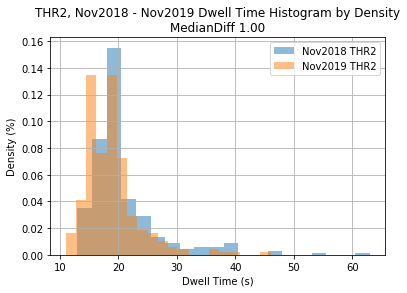

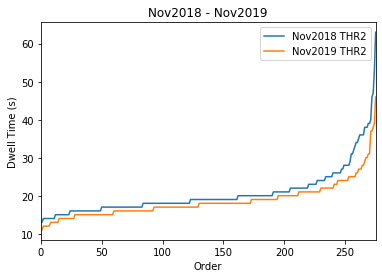


Platform Name TRL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    174.000000
mean      54.011494
std       18.216422
min       15.000000
25%       45.000000
50%       59.000000
75%       69.000000
max       79.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    174.000000
mean      52.241379
std       16.428486
min       12.000000
25%       43.000000
50%       56.000000
75%       65.000000
max       91.000000
Name: time, dtype: float64
KS two-sample test pValue 0.07293169810429369
Dwell Time Increase NOT Signficiant


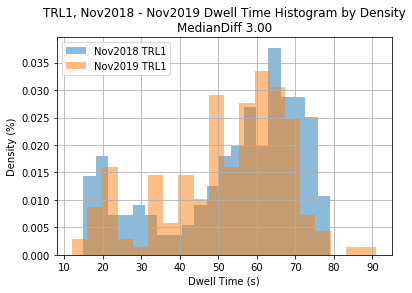

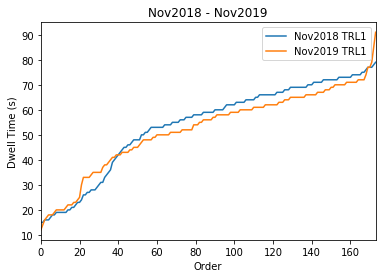


Platform Name TUR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    419.000000
mean      27.742243
std       11.686307
min       14.000000
25%       21.000000
50%       25.000000
75%       30.000000
max       97.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    419.000000
mean      23.069212
std        8.024930
min       11.000000
25%       18.000000
50%       21.000000
75%       26.000000
max       74.000000
Name: time, dtype: float64
KS two-sample test pValue 4.647469356920735e-16
Dwell Time Increase IS Signficiant


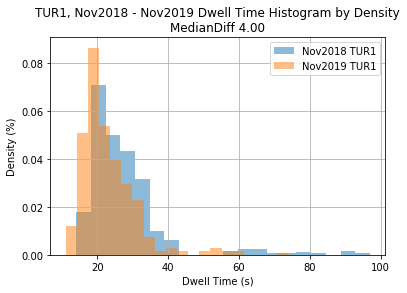

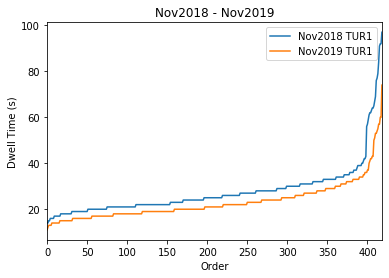


Platform Name VLW1

Platform Name VNY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    161.000000
mean      17.608696
std        3.546431
min       12.000000
25%       15.000000
50%       17.000000
75%       19.000000
max       38.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    161.000000
mean      17.093168
std        3.637996
min       12.000000
25%       15.000000
50%       16.000000
75%       18.000000
max       38.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4053949242786339
Dwell Time Increase NOT Signficiant


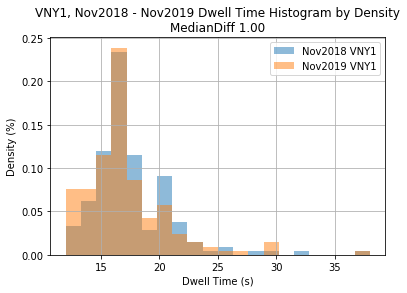

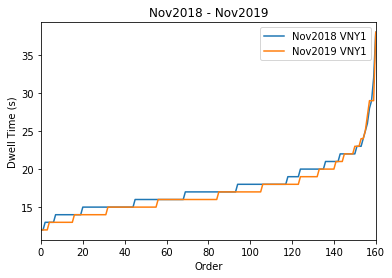


Platform Name WAH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    377.000000
mean      22.217507
std        8.024922
min       11.000000
25%       17.000000
50%       20.000000
75%       24.000000
max       63.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    377.000000
mean      18.647215
std        4.160375
min       11.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       42.000000
Name: time, dtype: float64
KS two-sample test pValue 1.7824966996805777e-07
Dwell Time Increase IS Signficiant


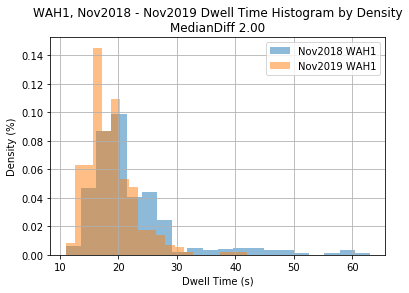

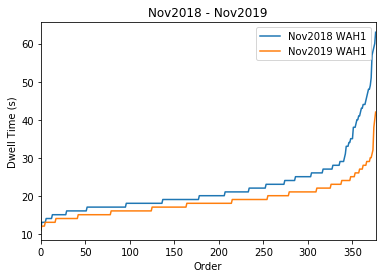


Platform Name WAI1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    400.000000
mean      26.145000
std       10.298744
min       13.000000
25%       20.000000
50%       23.000000
75%       29.000000
max       76.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    400.000000
mean      20.832500
std        8.107328
min       11.000000
25%       17.000000
50%       19.000000
75%       22.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 3.2024272501633618e-18
Dwell Time Increase IS Signficiant


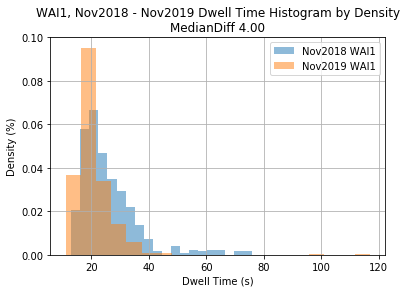

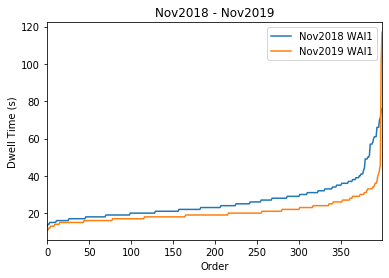


Platform Name WAV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    688.000000
mean      19.725291
std        5.720705
min       11.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       98.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    688.000000
mean      18.609012
std        3.929848
min       12.000000
25%       16.000000
50%       18.000000
75%       20.000000
max       36.000000
Name: time, dtype: float64
KS two-sample test pValue 3.890508038284298e-06
Dwell Time Increase IS Signficiant


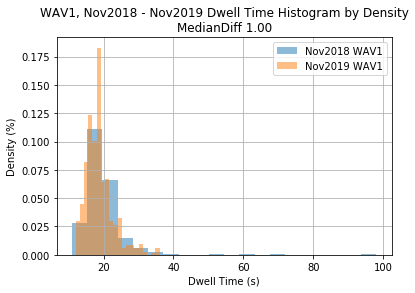

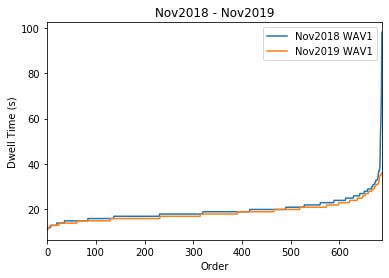


Platform Name WCI1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    285.000000
mean      38.603509
std       15.373083
min       17.000000
25%       28.000000
50%       33.000000
75%       45.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    285.000000
mean      33.442105
std       15.411526
min       14.000000
25%       23.000000
50%       29.000000
75%       39.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 8.462907888587393e-10
Dwell Time Increase IS Signficiant


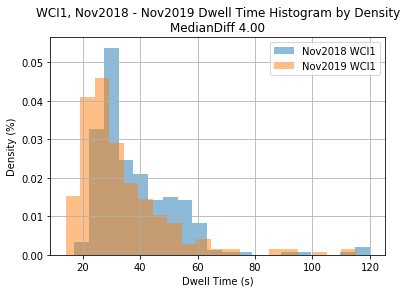

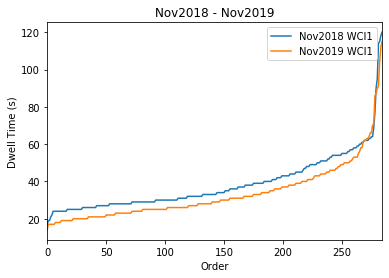


Platform Name WIN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    178.000000
mean      29.466292
std        8.610957
min       17.000000
25%       24.000000
50%       28.000000
75%       32.000000
max       60.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    178.000000
mean      27.511236
std       12.552821
min       13.000000
25%       21.000000
50%       25.000000
75%       30.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00023711109374995574
Dwell Time Increase IS Signficiant


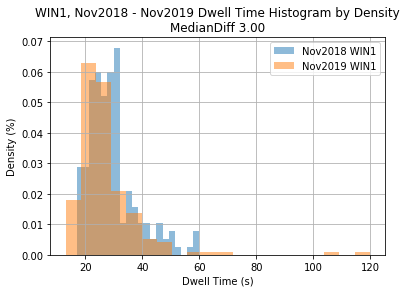

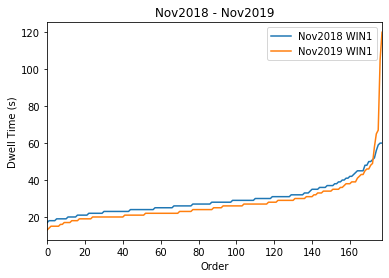


Platform Name WKF1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    247.000000
mean      34.647773
std       17.379125
min       15.000000
25%       19.000000
50%       27.000000
75%       50.500000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    247.000000
mean      34.566802
std       20.418652
min       12.000000
25%       18.000000
50%       23.000000
75%       53.500000
max      112.000000
Name: time, dtype: float64
KS two-sample test pValue 0.05222548922801242
Dwell Time Increase NOT Signficiant


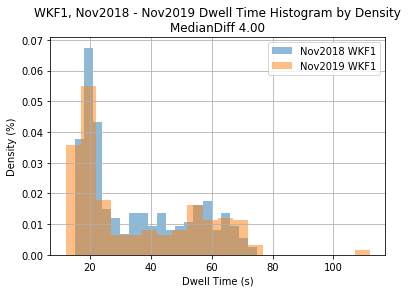

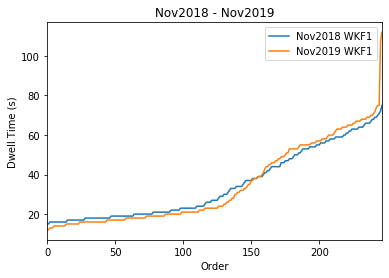


Platform Name WLS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    756.000000
mean      20.678571
std        4.495309
min       12.000000
25%       18.000000
50%       20.000000
75%       22.000000
max       66.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    756.000000
mean      19.161376
std        3.619358
min       12.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       55.000000
Name: time, dtype: float64
KS two-sample test pValue 9.635260871488926e-12
Dwell Time Increase IS Signficiant


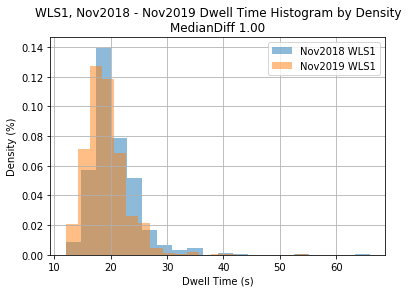

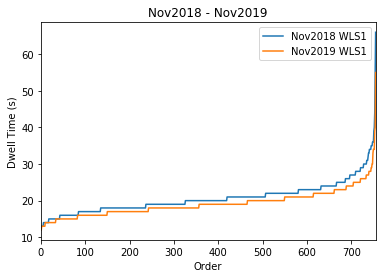


Platform Name WLY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    123.000000
mean      23.552846
std        6.639676
min       14.000000
25%       19.000000
50%       22.000000
75%       27.000000
max       63.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    123.000000
mean      23.056911
std        5.402338
min       13.000000
25%       19.000000
50%       22.000000
75%       27.000000
max       38.000000
Name: time, dtype: float64
KS two-sample test pValue 0.99870276993465
Dwell Time Decrease NOT Signficiant


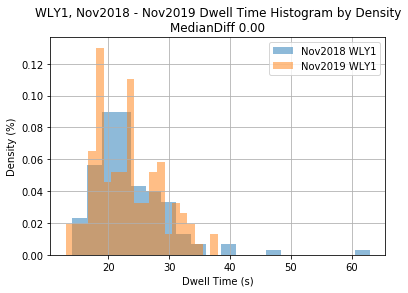

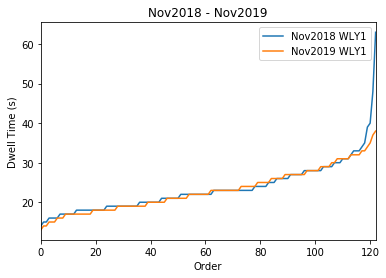


Platform Name WMD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    385.000000
mean      32.296104
std       15.019106
min       17.000000
25%       24.000000
50%       28.000000
75%       34.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    385.000000
mean      27.119481
std       15.193072
min       13.000000
25%       20.000000
50%       23.000000
75%       29.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 8.023700181537834e-16
Dwell Time Increase IS Signficiant


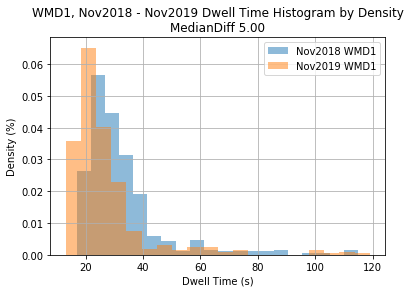

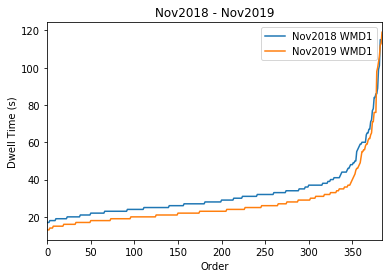


Platform Name WMD2

Platform Name WRD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    55.000000
mean     23.727273
std       5.806939
min      16.000000
25%      20.000000
50%      23.000000
75%      27.000000
max      46.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    55.000000
mean     24.309091
std       4.871963
min      18.000000
25%      21.000000
50%      23.000000
75%      26.000000
max      45.000000
Name: time, dtype: float64
KS two-sample test pValue 0.1462734997339796
Dwell Time Decrease NOT Signficiant


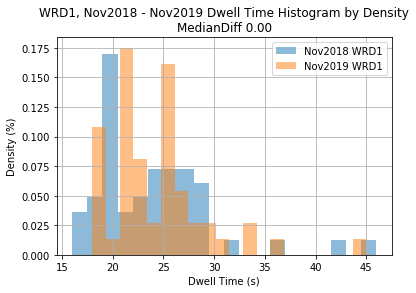

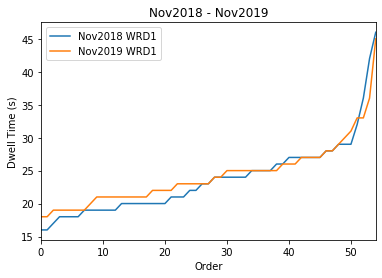


Platform Name WRD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    259.000000
mean      31.131274
std       12.240094
min       17.000000
25%       23.000000
50%       28.000000
75%       35.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    259.000000
mean      28.822394
std       13.234883
min       13.000000
25%       21.000000
50%       25.000000
75%       32.000000
max      114.000000
Name: time, dtype: float64
KS two-sample test pValue 0.002166753328244602
Dwell Time Increase IS Signficiant


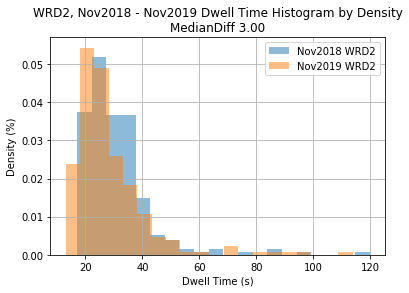

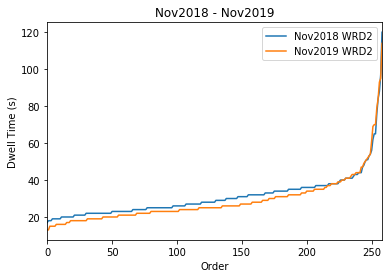


Platform Name WRG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    331.000000
mean      27.628399
std       13.993428
min       13.000000
25%       18.000000
50%       22.000000
75%       30.000000
max       97.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    331.000000
mean      28.045317
std       16.533192
min       12.000000
25%       17.000000
50%       20.000000
75%       34.500000
max       96.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0024961540643351652
Dwell Time Increase IS Signficiant


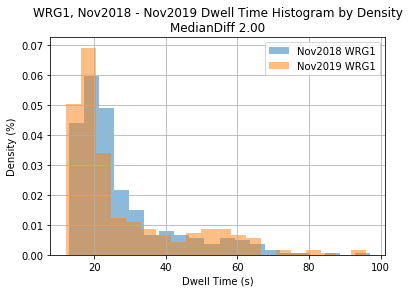

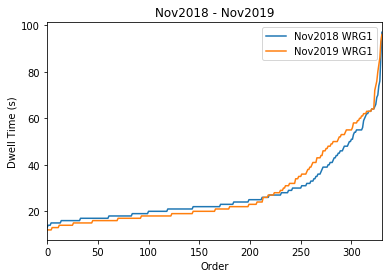


Platform Name WRW1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    377.000000
mean      20.952255
std        7.312031
min       12.000000
25%       16.000000
50%       19.000000
75%       23.000000
max       55.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    377.000000
mean      18.206897
std        4.378946
min       12.000000
25%       16.000000
50%       17.000000
75%       20.000000
max       47.000000
Name: time, dtype: float64
KS two-sample test pValue 1.835817768048352e-05
Dwell Time Increase IS Signficiant


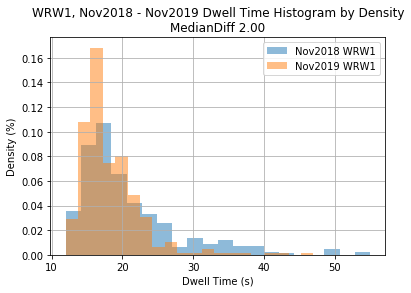

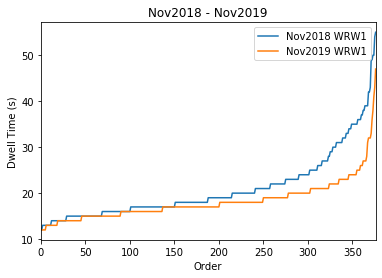


Platform Name WVL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    220.000000
mean      35.250000
std       11.962126
min       17.000000
25%       26.000000
50%       33.000000
75%       43.000000
max       86.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    220.000000
mean      32.759091
std       14.707224
min       13.000000
25%       20.750000
50%       30.000000
75%       43.000000
max       94.000000
Name: time, dtype: float64
KS two-sample test pValue 5.3280280825033134e-05
Dwell Time Increase IS Signficiant


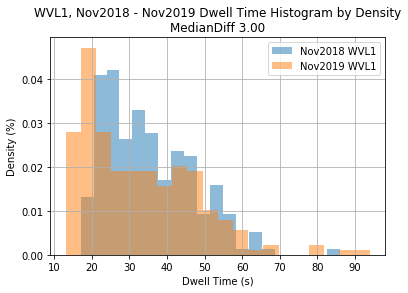

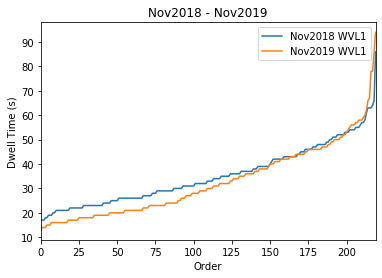


Platform Name WVL2

Platform Name WYN3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    840.000000
mean      49.197619
std       17.487036
min       15.000000
25%       36.000000
50%       47.000000
75%       61.000000
max      106.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    840.000000
mean      34.486905
std       11.246923
min       15.000000
25%       27.000000
50%       33.000000
75%       41.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 1.3408535574560079e-58
Dwell Time Increase IS Signficiant


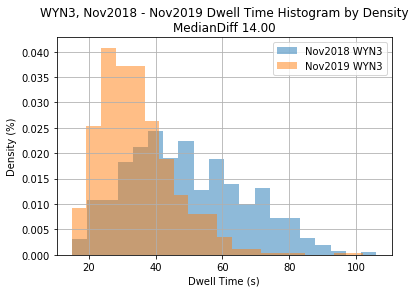

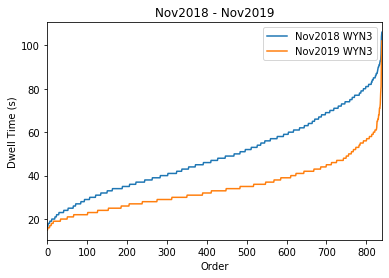


Platform Name WYN6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    491.000000
mean      40.419552
std       11.434782
min       19.000000
25%       32.000000
50%       38.000000
75%       47.500000
max      101.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    491.000000
mean      37.399185
std       13.509616
min       16.000000
25%       27.000000
50%       34.000000
75%       46.000000
max       78.000000
Name: time, dtype: float64
KS two-sample test pValue 5.995948028711138e-08
Dwell Time Increase IS Signficiant


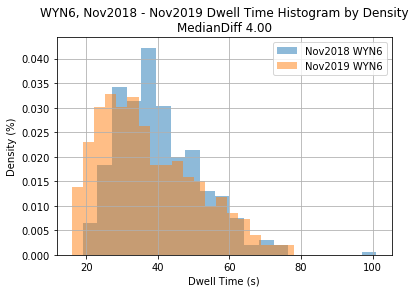

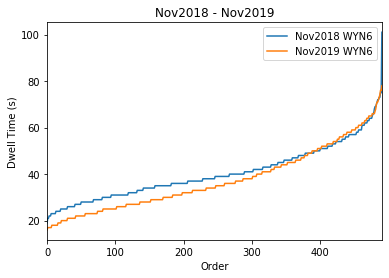


Platform Name YAG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    124.000000
mean      18.798387
std        4.764332
min       12.000000
25%       16.000000
50%       18.000000
75%       20.000000
max       56.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    124.000000
mean      19.580645
std        7.221351
min       13.000000
25%       17.000000
50%       18.000000
75%       20.250000
max       86.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8169812931669315
Dwell Time Decrease NOT Signficiant


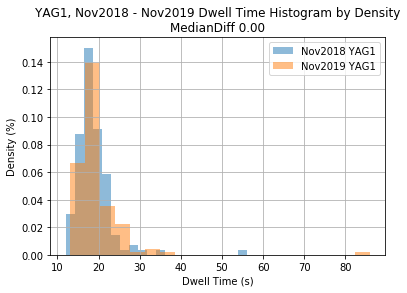

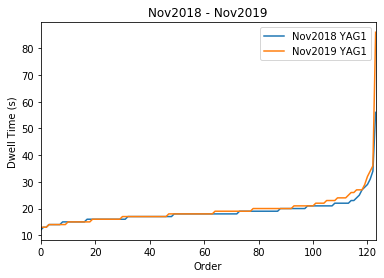


Platform Name YNN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    188.000000
mean      22.638298
std       10.436312
min       12.000000
25%       16.000000
50%       18.500000
75%       22.000000
max       59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    188.000000
mean      23.265957
std       10.790841
min       13.000000
25%       17.000000
50%       19.000000
75%       24.000000
max       65.000000
Name: time, dtype: float64
KS two-sample test pValue 0.588967089836213
Dwell Time Decrease NOT Signficiant


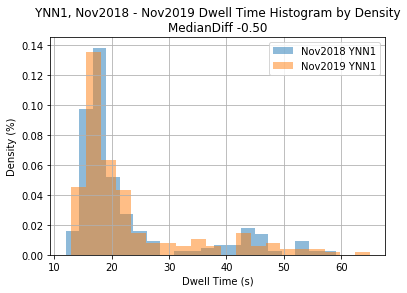

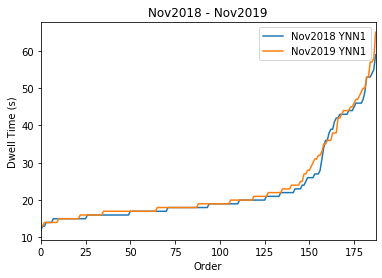



Num Significant Increase 78
Num Significant Decrease 27
Num Not Significant 50
==========Inc_Platform==========
['ART1', 'ASH3', 'ASQ1', 'BCR1', 'BDP1', 'BMO1', 'BVH1', 'BWD1', 'BWD3', 'BXN1', 'CBY1', 'CE16', 'CE17', 'CHT1', 'CLJ4', 'CNV1', 'CRD2', 'DOO1', 'EPG2', 'ERC1', 'FLD1', 'FLM3', 'GFD2', 'GLD1', 'GQU1', 'GVL3', 'HLW1', 'KLR1', 'LCE3', 'LDF1', 'LEW1', 'LUH1', 'MCO1', 'MDB1', 'MDT1', 'MDT2', 'MKV1', 'MTC1', 'MUL1', 'MYG1', 'PAN1', 'PDH1', 'PNT1', 'PTA1', 'QKH1', 'RD03', 'RD07', 'RDS1', 'RSV1', 'RTY1', 'SCO1', 'SDT1', 'SIT1', 'SMH2', 'STM1', 'STM2', 'STR2', 'STR4', 'STR7', 'SVH1', 'SVH2', 'TGB1', 'THL6', 'THR2', 'TUR1', 'WAH1', 'WAI1', 'WAV1', 'WCI1', 'WIN1', 'WLS1', 'WMD1', 'WRD2', 'WRG1', 'WRW1', 'WVL1', 'WYN3', 'WYN6']
==========Dec_Platform==========
['BNK1', 'BTN5', 'BWD5', 'CCQ2', 'CDN1', 'CE18', 'CE21', 'CTN2', 'CWD1', 'DHL1', 'DNS2', 'EWD2', 'GFD1', 'GRD1', 'HBY1', 'HBY3', 'MPT1', 'MSM2', 'NSY1', 'PET1', 'RD05', 'RIV1', 'RPK1', 'STJ2', 'STL2', 'STR1', 'THL2']
==========N

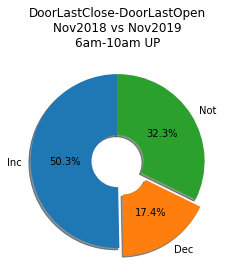

In [128]:
perform_analysis_door_open_close(data1_am_up_sec, data2_am_up_sec,'Nov2018', 'Nov2019', 'DoorLastClose-DoorLastOpen\nNov2018 vs Nov2019\n6am-10am UP')

## PM DOWN


Platform Name ART2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    714.000000
mean      24.375350
std        5.983311
min       15.000000
25%       21.000000
50%       23.000000
75%       27.000000
max       72.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    714.000000
mean      30.889356
std       12.469444
min       13.000000
25%       21.000000
50%       26.000000
75%       41.000000
max       71.000000
Name: time, dtype: float64
KS two-sample test pValue 1.9152368273863556e-31
Dwell Time Decrease IS Signficiant


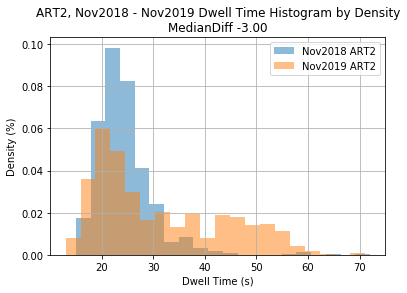

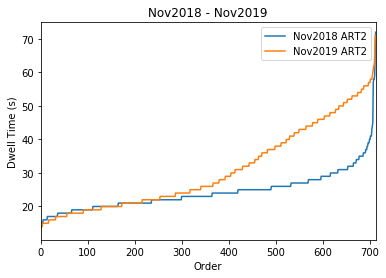


Platform Name ASH5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    319.000000
mean      32.990596
std       10.723361
min       19.000000
25%       27.000000
50%       30.000000
75%       35.500000
max       95.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    319.000000
mean      28.247649
std        8.967347
min       15.000000
25%       23.000000
50%       27.000000
75%       30.000000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 1.3813986272377107e-11
Dwell Time Increase IS Signficiant


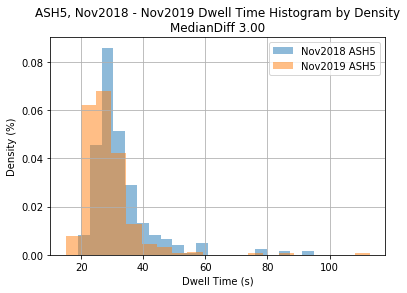

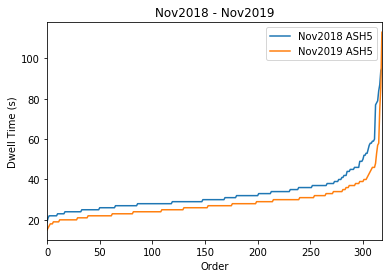


Platform Name ASQ2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    133.000000
mean      23.533835
std        8.224639
min       15.000000
25%       20.000000
50%       22.000000
75%       26.000000
max      101.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    133.000000
mean      21.751880
std        4.686224
min       14.000000
25%       18.000000
50%       22.000000
75%       24.000000
max       34.000000
Name: time, dtype: float64
KS two-sample test pValue 0.037282739276223296
Dwell Time Decrease IS Signficiant


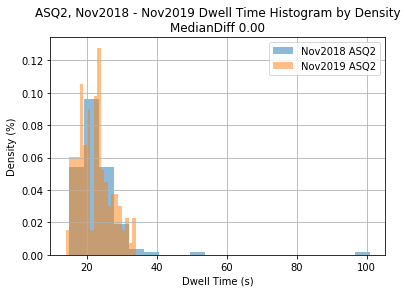

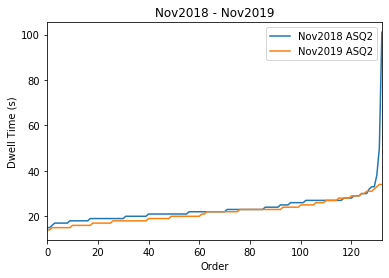


Platform Name AUB2

Platform Name AUB4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    279.000000
mean      30.530466
std        7.679622
min       19.000000
25%       26.000000
50%       29.000000
75%       34.000000
max       85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    279.000000
mean      28.494624
std        8.101368
min       16.000000
25%       23.000000
50%       27.000000
75%       31.000000
max       64.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00017250472211322536
Dwell Time Increase IS Signficiant


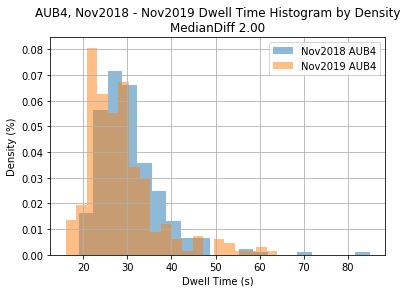

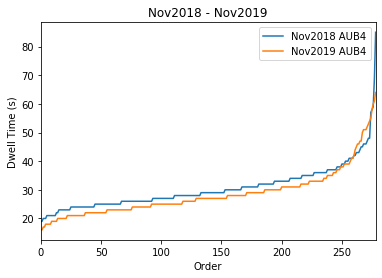


Platform Name BCR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    242.000000
mean      28.342975
std       12.740391
min       15.000000
25%       22.000000
50%       24.000000
75%       28.000000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    242.000000
mean      21.805785
std        7.131798
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       64.000000
Name: time, dtype: float64
KS two-sample test pValue 1.1334380091508382e-16
Dwell Time Increase IS Signficiant


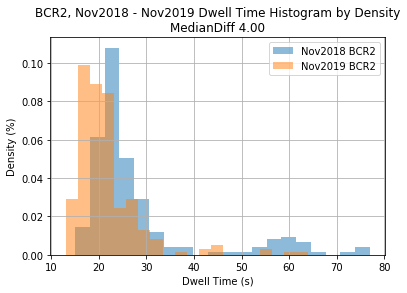

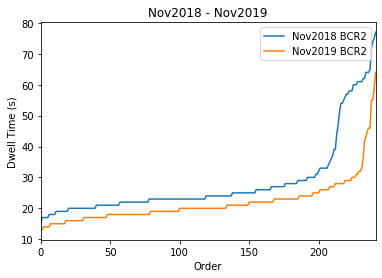


Platform Name BDP2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    151.000000
mean      40.278146
std       16.020054
min       16.000000
25%       25.000000
50%       39.000000
75%       53.500000
max       71.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    151.000000
mean      41.317881
std       16.149869
min       15.000000
25%       26.000000
50%       46.000000
75%       54.000000
max       83.000000
Name: time, dtype: float64
KS two-sample test pValue 0.23409368319305937
Dwell Time Decrease NOT Signficiant


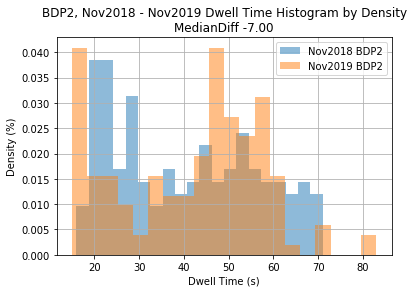

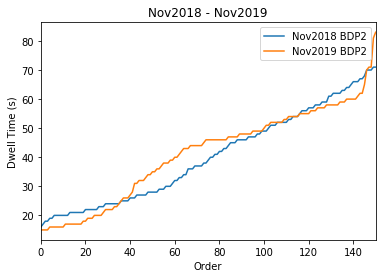


Platform Name BER2

Platform Name BIR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    198.00000
mean      24.20202
std       13.40958
min       14.00000
25%       18.00000
50%       21.00000
75%       24.00000
max      108.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    198.000000
mean      24.378788
std       15.211969
min       12.000000
25%       18.000000
50%       20.000000
75%       25.000000
max      116.000000
Name: time, dtype: float64
KS two-sample test pValue 0.17364053173928742
Dwell Time Increase NOT Signficiant


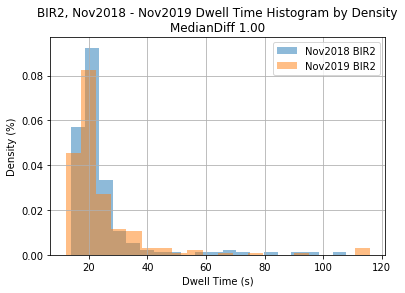

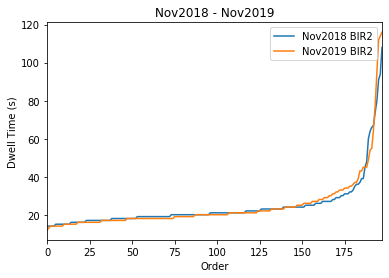


Platform Name BMO2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    189.000000
mean      28.089947
std        6.956350
min       18.000000
25%       25.000000
50%       27.000000
75%       30.000000
max       85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    189.000000
mean      24.629630
std       10.814213
min       14.000000
25%       20.000000
50%       22.000000
75%       27.000000
max      105.000000
Name: time, dtype: float64
KS two-sample test pValue 1.4572336769787161e-15
Dwell Time Increase IS Signficiant


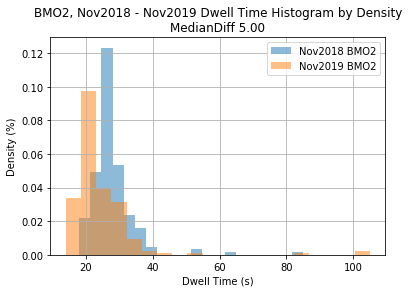

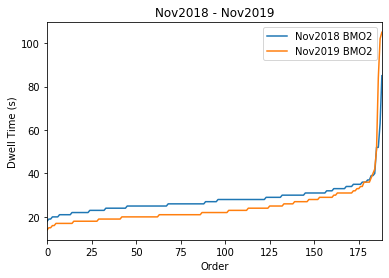


Platform Name BNK2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    117.000000
mean      54.273504
std       24.687573
min       21.000000
25%       34.000000
50%       46.000000
75%       75.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    117.000000
mean      58.119658
std       26.561627
min       21.000000
25%       33.000000
50%       59.000000
75%       81.000000
max      110.000000
Name: time, dtype: float64
KS two-sample test pValue 0.37335310739395544
Dwell Time Decrease NOT Signficiant


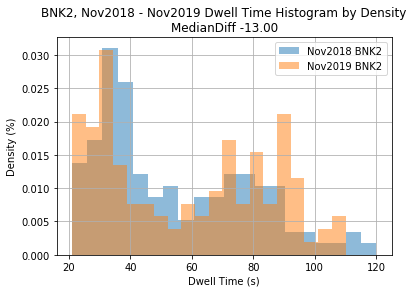

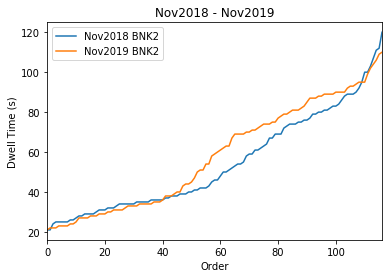


Platform Name BRL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    125.000000
mean      25.336000
std        4.257714
min       16.000000
25%       22.000000
50%       25.000000
75%       28.000000
max       43.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    125.00000
mean      23.43200
std        7.38933
min       13.00000
25%       19.00000
50%       22.00000
75%       26.00000
max       77.00000
Name: time, dtype: float64
KS two-sample test pValue 5.657262282659655e-05
Dwell Time Increase IS Signficiant


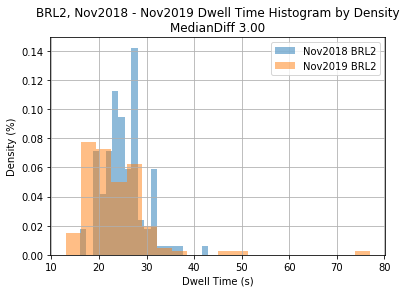

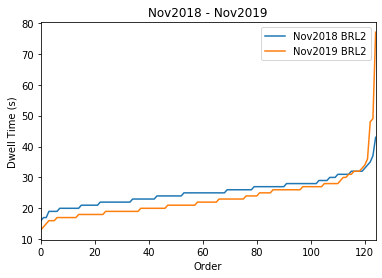


Platform Name BTN1

Platform Name BTN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    222.000000
mean      43.207207
std       15.233101
min       22.000000
25%       33.000000
50%       42.000000
75%       49.750000
max      105.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    222.000000
mean      45.837838
std       15.397914
min       21.000000
25%       36.000000
50%       42.500000
75%       51.750000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.14941187931198377
Dwell Time Decrease NOT Signficiant


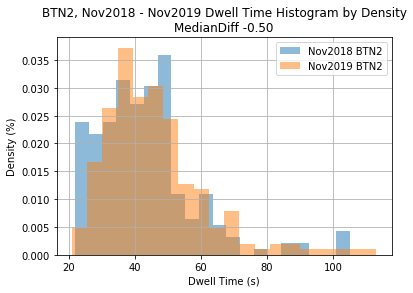

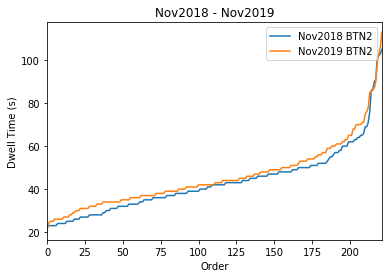


Platform Name BTN3

Platform Name BTN5

Platform Name BTN6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     75.000000
mean      39.160000
std       11.966214
min       24.000000
25%       32.000000
50%       36.000000
75%       43.000000
max      101.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    75.000000
mean     40.080000
std      18.468205
min      15.000000
25%      25.000000
50%      38.000000
75%      48.500000
max      86.000000
Name: time, dtype: float64
KS two-sample test pValue 0.009385843245702059
Dwell Time Decrease IS Signficiant


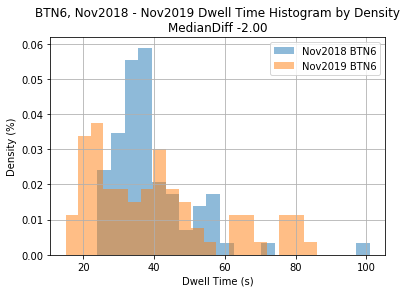

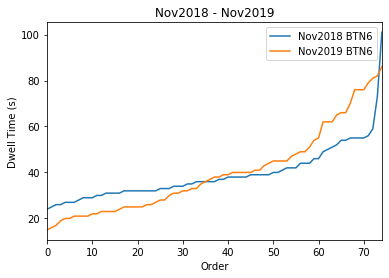


Platform Name BTN7
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    291.000000
mean      45.855670
std       17.010944
min       16.000000
25%       33.000000
50%       44.000000
75%       55.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    291.000000
mean      48.948454
std       18.000788
min       19.000000
25%       34.000000
50%       47.000000
75%       61.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.11115082449570211
Dwell Time Decrease NOT Signficiant


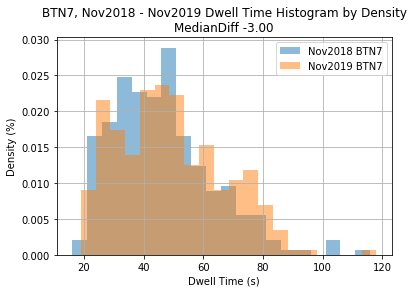

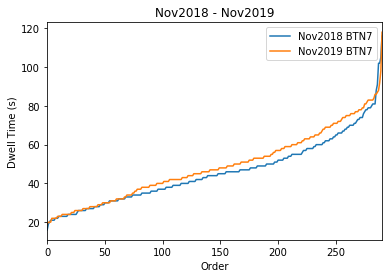


Platform Name BVH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    135.000000
mean      36.985185
std       10.735619
min       17.000000
25%       28.000000
50%       36.000000
75%       44.000000
max       72.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    135.000000
mean      33.837037
std       11.663956
min       14.000000
25%       25.000000
50%       33.000000
75%       43.500000
max       63.000000
Name: time, dtype: float64
KS two-sample test pValue 0.019333612584625445
Dwell Time Increase IS Signficiant


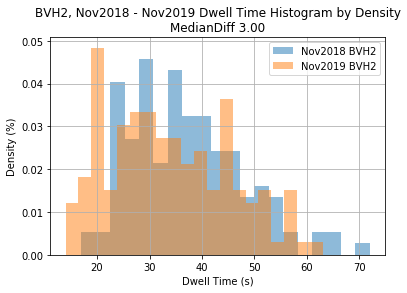

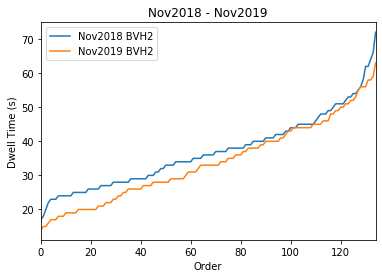


Platform Name BWD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     61.000000
mean      35.327869
std       16.276487
min       19.000000
25%       26.000000
50%       30.000000
75%       35.000000
max      102.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     61.000000
mean      43.704918
std       22.851947
min       17.000000
25%       26.000000
50%       35.000000
75%       57.000000
max      105.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0803046418896368
Dwell Time Decrease NOT Signficiant


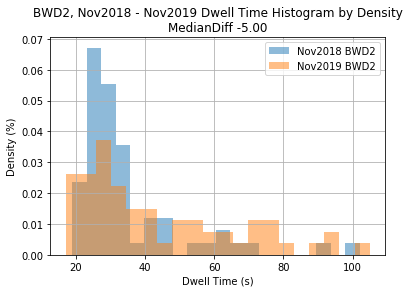

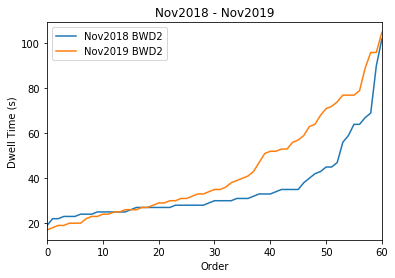


Platform Name BWD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    155.000000
mean      36.064516
std        8.441300
min       20.000000
25%       31.000000
50%       35.000000
75%       40.000000
max      100.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    155.000000
mean      28.141935
std        9.104329
min       16.000000
25%       23.000000
50%       26.000000
75%       32.000000
max      107.000000
Name: time, dtype: float64
KS two-sample test pValue 2.860969452854212e-17
Dwell Time Increase IS Signficiant


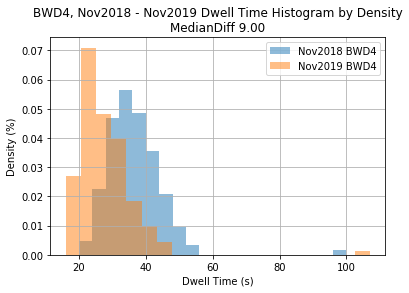

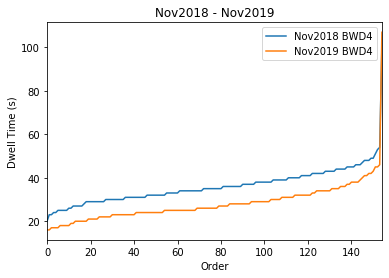


Platform Name BWD6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    326.000000
mean      31.932515
std        7.575368
min       17.000000
25%       27.000000
50%       31.000000
75%       35.000000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    326.000000
mean      30.006135
std        9.655288
min       14.000000
25%       24.000000
50%       28.000000
75%       34.000000
max       70.000000
Name: time, dtype: float64
KS two-sample test pValue 1.4346648478555362e-05
Dwell Time Increase IS Signficiant


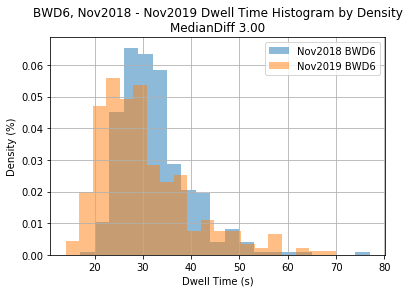

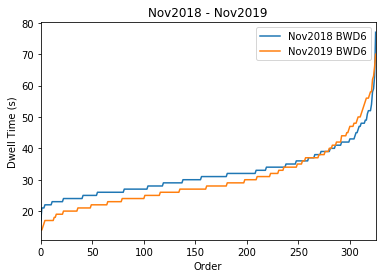


Platform Name BXN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    152.000000
mean      25.467105
std        7.751879
min       15.000000
25%       21.000000
50%       24.000000
75%       27.000000
max       76.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    152.000000
mean      23.460526
std        8.955284
min       13.000000
25%       19.000000
50%       21.000000
75%       25.000000
max       86.000000
Name: time, dtype: float64
KS two-sample test pValue 2.8473150616448248e-05
Dwell Time Increase IS Signficiant


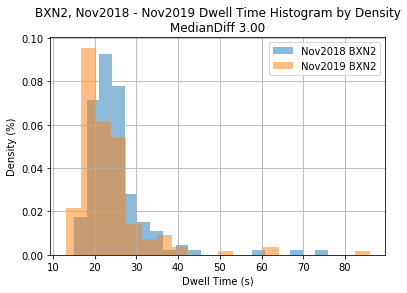

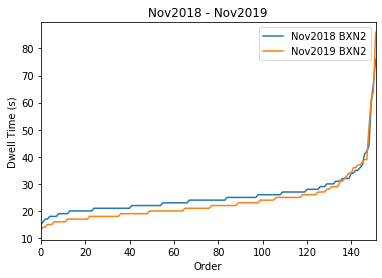


Platform Name CAB2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    284.000000
mean      29.728873
std        6.515034
min       16.000000
25%       25.000000
50%       29.000000
75%       34.000000
max       61.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    284.000000
mean      27.471831
std        9.690033
min       15.000000
25%       22.000000
50%       26.000000
75%       31.000000
max       98.000000
Name: time, dtype: float64
KS two-sample test pValue 6.225603592858809e-07
Dwell Time Increase IS Signficiant


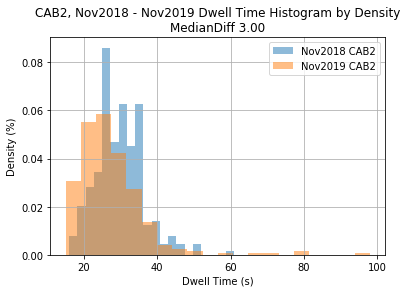

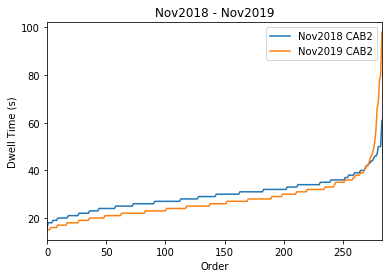


Platform Name CAS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    238.000000
mean      21.705882
std       10.195021
min       11.000000
25%       16.000000
50%       18.000000
75%       22.000000
max       65.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    238.000000
mean      25.466387
std       15.449828
min       12.000000
25%       16.000000
50%       19.000000
75%       25.000000
max       83.000000
Name: time, dtype: float64
KS two-sample test pValue 0.11682744837354102
Dwell Time Decrease NOT Signficiant


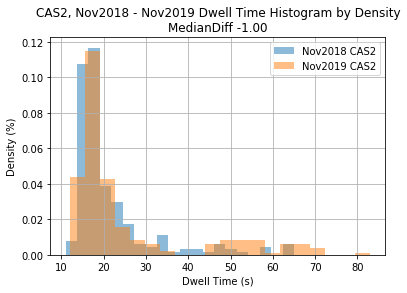

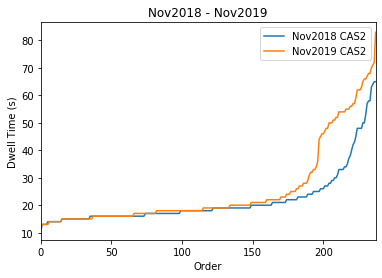


Platform Name CBY2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    181.000000
mean      30.491713
std        5.865737
min       19.000000
25%       27.000000
50%       30.000000
75%       33.000000
max       55.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    181.000000
mean      25.127072
std        8.655145
min       15.000000
25%       20.000000
50%       23.000000
75%       28.000000
max       75.000000
Name: time, dtype: float64
KS two-sample test pValue 9.264750626194418e-20
Dwell Time Increase IS Signficiant


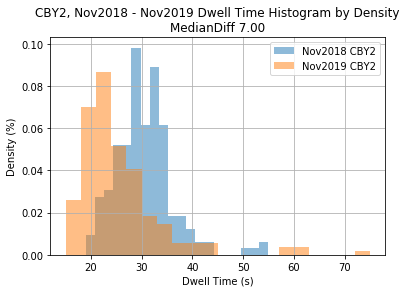

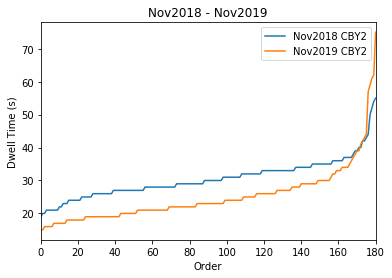


Platform Name CCQ1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    213.000000
mean      48.549296
std       26.949528
min       20.000000
25%       28.000000
50%       35.000000
75%       75.000000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    213.000000
mean      35.638498
std       20.388117
min       12.000000
25%       25.000000
50%       29.000000
75%       35.000000
max      114.000000
Name: time, dtype: float64
KS two-sample test pValue 9.092252269954049e-06
Dwell Time Increase IS Signficiant


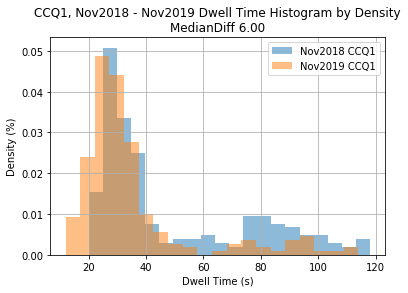

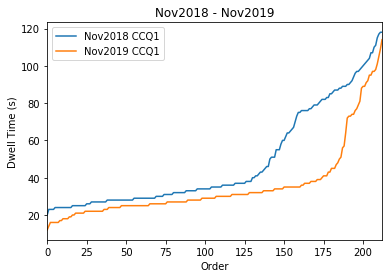


Platform Name CDN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    152.000000
mean      43.953947
std       27.952026
min       14.000000
25%       19.000000
50%       33.500000
75%       72.000000
max      111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    152.000000
mean      44.881579
std       30.903382
min       13.000000
25%       17.000000
50%       39.500000
75%       64.250000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.2984732333017617
Dwell Time Decrease NOT Signficiant


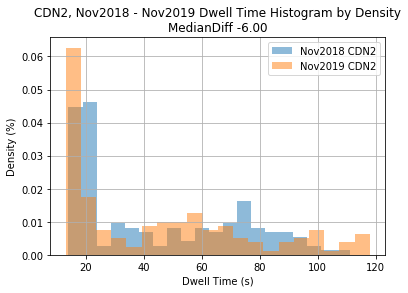

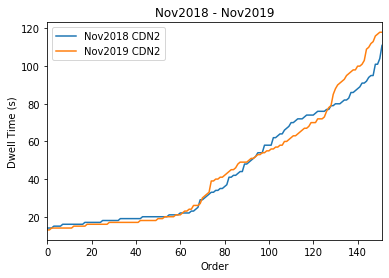


Platform Name CE16
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    808.000000
mean      49.349010
std       18.426033
min       20.000000
25%       35.000000
50%       46.000000
75%       59.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    808.000000
mean      47.028465
std       16.684043
min       17.000000
25%       36.000000
50%       44.000000
75%       55.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.019968891882356076
Dwell Time Increase IS Signficiant


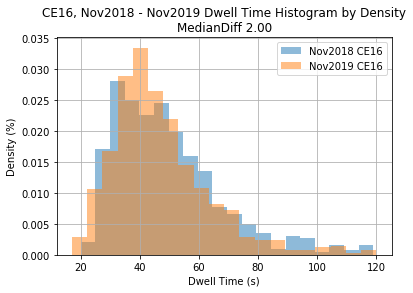

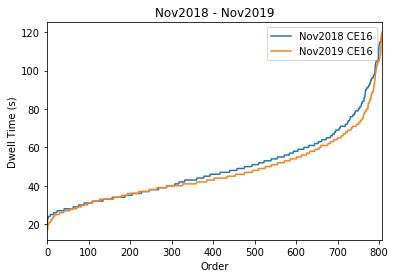


Platform Name CE18
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    734.000000
mean      57.017711
std       16.902932
min       16.000000
25%       43.000000
50%       55.000000
75%       69.000000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    734.000000
mean      61.234332
std       17.537475
min       21.000000
25%       47.000000
50%       63.000000
75%       73.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 5.601763045390219e-09
Dwell Time Decrease IS Signficiant


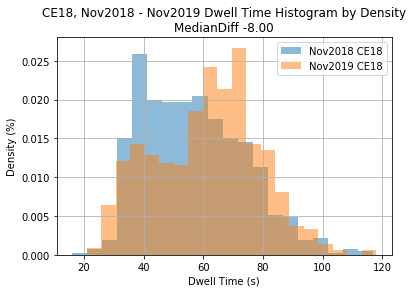

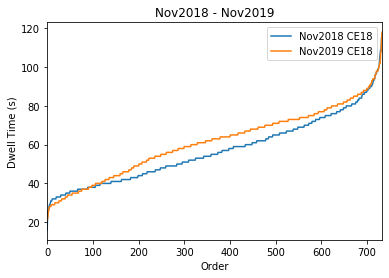


Platform Name CE19
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    340.000000
mean      60.108824
std       18.273647
min       22.000000
25%       44.750000
50%       61.000000
75%       73.250000
max      111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    340.000000
mean      60.700000
std       16.741607
min       17.000000
25%       48.000000
50%       64.000000
75%       74.000000
max      109.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4755798152584874
Dwell Time Decrease NOT Signficiant


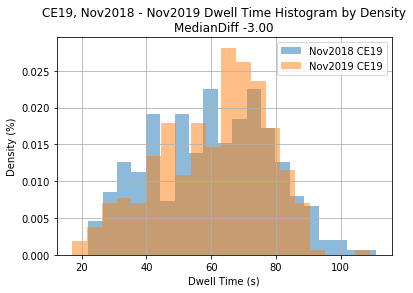

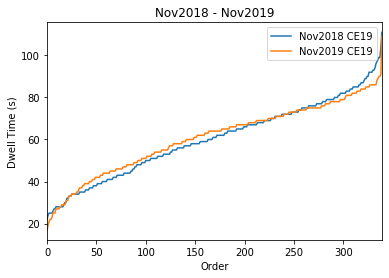


Platform Name CE20

Platform Name CE21
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    243.000000
mean      65.518519
std       18.677855
min       35.000000
25%       50.000000
50%       65.000000
75%       79.500000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    243.000000
mean      65.094650
std       19.445072
min       30.000000
25%       48.500000
50%       63.000000
75%       80.500000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8786237968699205
Dwell Time Increase NOT Signficiant


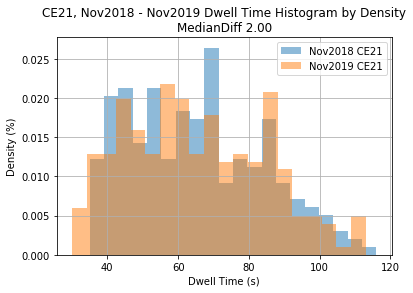

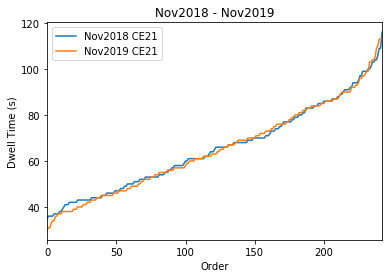


Platform Name CE22
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    190.000000
mean      68.200000
std       27.744335
min       19.000000
25%       43.250000
50%       65.500000
75%       95.500000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    190.000000
mean      67.994737
std       28.830190
min       20.000000
25%       42.000000
50%       69.000000
75%       94.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.84435278498327
Dwell Time Decrease NOT Signficiant


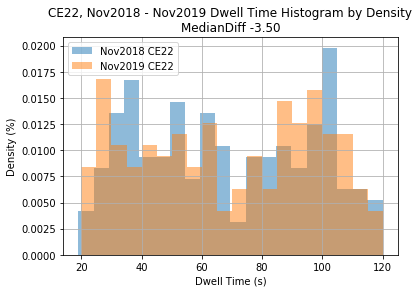

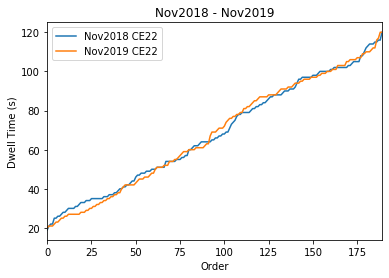


Platform Name CE23
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    287.000000
mean      71.247387
std       23.560919
min       22.000000
25%       49.000000
50%       77.000000
75%       90.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    287.000000
mean      69.379791
std       25.494796
min       20.000000
25%       46.000000
50%       73.000000
75%       91.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.48942935171484936
Dwell Time Increase NOT Signficiant


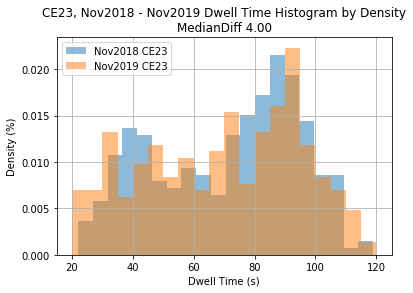

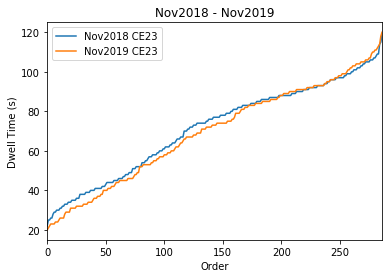


Platform Name CHH2

Platform Name CHT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    262.000000
mean      22.797710
std        5.696769
min       13.000000
25%       19.000000
50%       21.000000
75%       24.000000
max       47.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    262.000000
mean      22.767176
std        7.378336
min       12.000000
25%       17.250000
50%       21.000000
75%       26.000000
max       60.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0016908931428830075
Dwell Time Decrease IS Signficiant


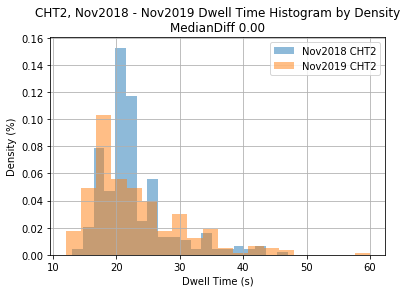

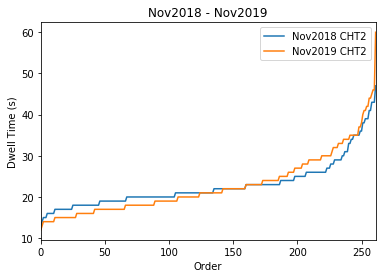


Platform Name CLJ3

Platform Name CLJ5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    264.000000
mean      21.829545
std        4.196382
min       14.000000
25%       19.000000
50%       21.000000
75%       24.000000
max       42.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    264.000000
mean      22.450758
std        6.428714
min       13.000000
25%       19.000000
50%       21.000000
75%       25.000000
max       79.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9763821389656236
Dwell Time Decrease NOT Signficiant


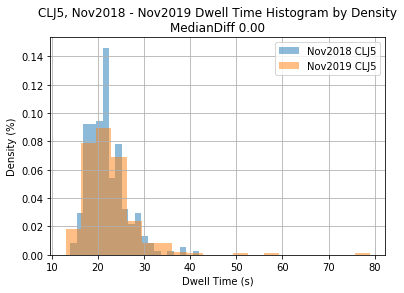

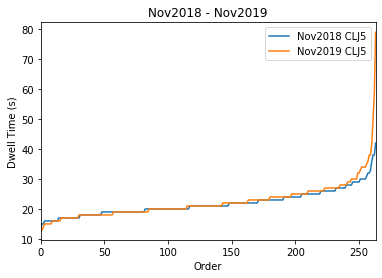


Platform Name CMP1

Platform Name CMP2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    201.000000
mean      33.099502
std        6.940465
min       21.000000
25%       28.000000
50%       32.000000
75%       37.000000
max       65.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    201.000000
mean      33.577114
std        9.619006
min       16.000000
25%       27.000000
50%       32.000000
75%       40.000000
max       81.000000
Name: time, dtype: float64
KS two-sample test pValue 0.06917655665685465
Dwell Time Decrease NOT Signficiant


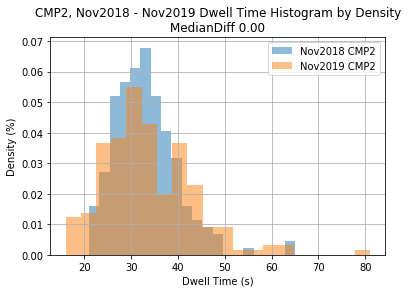

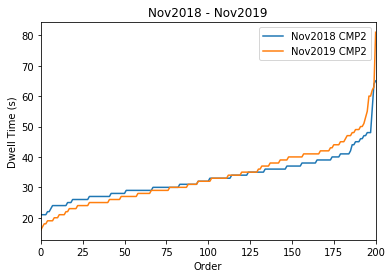


Platform Name CNV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    238.000000
mean      30.596639
std       16.300614
min       14.000000
25%       22.000000
50%       26.000000
75%       31.000000
max      108.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    238.000000
mean      26.962185
std       17.238542
min       12.000000
25%       18.000000
50%       22.000000
75%       28.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 1.7607581227525427e-09
Dwell Time Increase IS Signficiant


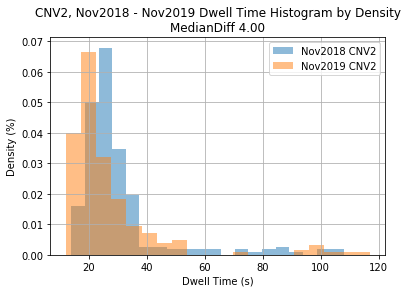

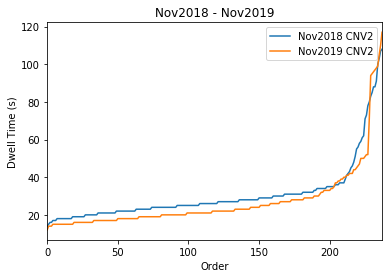


Platform Name CRD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    100.000000
mean      22.320000
std        5.899632
min       14.000000
25%       19.000000
50%       21.000000
75%       24.000000
max       59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    100.000000
mean      20.410000
std        8.091765
min       13.000000
25%       17.000000
50%       18.000000
75%       21.000000
max       83.000000
Name: time, dtype: float64
KS two-sample test pValue 3.211428734211389e-05
Dwell Time Increase IS Signficiant


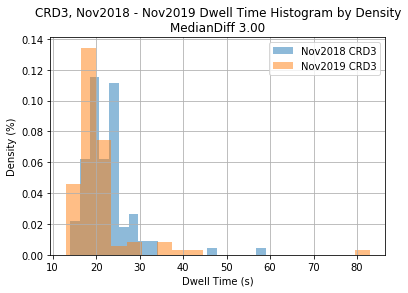

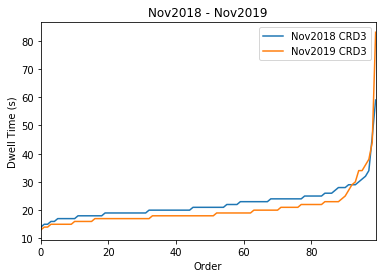


Platform Name CRD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    66.000000
mean     24.696970
std       6.981227
min      17.000000
25%      21.000000
50%      23.000000
75%      26.000000
max      57.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    66.000000
mean     21.878788
std       4.511575
min      13.000000
25%      18.250000
50%      21.000000
75%      25.750000
max      34.000000
Name: time, dtype: float64
KS two-sample test pValue 0.04098969175392333
Dwell Time Increase IS Signficiant


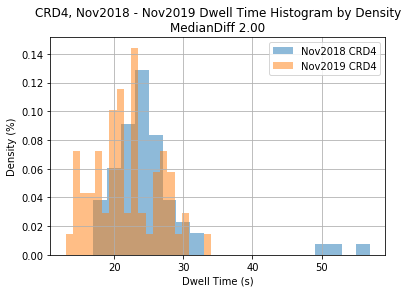

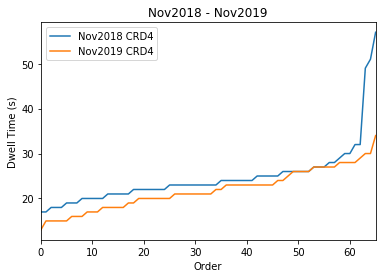


Platform Name CRR2

Platform Name CTN2

Platform Name CTN3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     70.000000
mean      66.885714
std       30.062998
min       27.000000
25%       40.250000
50%       57.000000
75%       99.500000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     70.000000
mean      81.600000
std       25.770672
min       29.000000
25%       66.750000
50%       88.500000
75%      100.250000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0004796169935404572
Dwell Time Decrease IS Signficiant


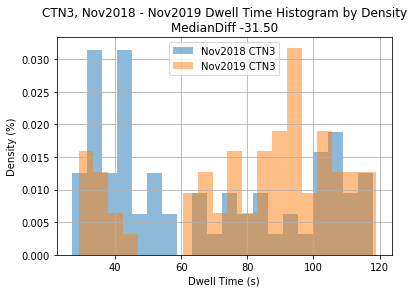

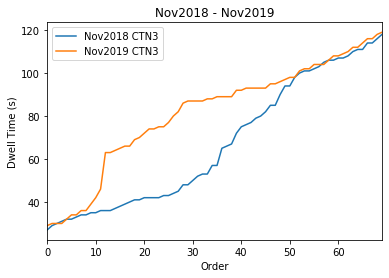


Platform Name CWD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    842.000000
mean      54.495249
std       23.645934
min       19.000000
25%       33.000000
50%       48.000000
75%       76.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    842.000000
mean      49.837292
std       18.414397
min       17.000000
25%       33.000000
50%       50.000000
75%       64.000000
max      108.000000
Name: time, dtype: float64
KS two-sample test pValue 6.2571240935470035e-12
Dwell Time Decrease IS Signficiant


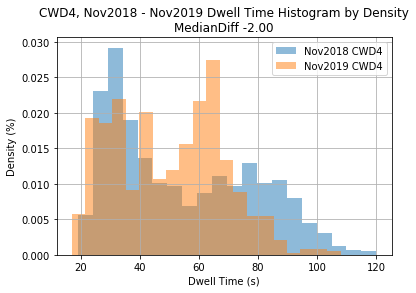

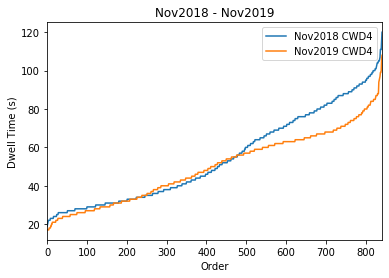


Platform Name CYD5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    99.000000
mean     28.404040
std      10.303476
min      16.000000
25%      22.000000
50%      25.000000
75%      30.000000
max      64.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    99.000000
mean     33.787879
std      13.354104
min      14.000000
25%      22.000000
50%      32.000000
75%      45.500000
max      67.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00010861410903490686
Dwell Time Decrease IS Signficiant


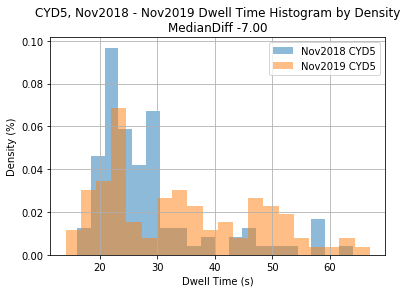

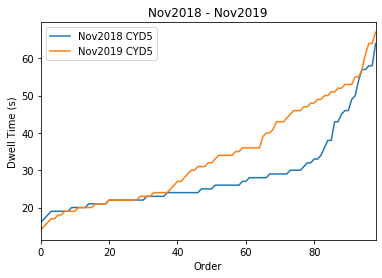


Platform Name DHL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    170.000000
mean      38.711765
std       15.155774
min       18.000000
25%       28.000000
50%       34.000000
75%       47.000000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    170.000000
mean      45.358824
std       20.596592
min       14.000000
25%       26.000000
50%       44.500000
75%       65.000000
max       86.000000
Name: time, dtype: float64
KS two-sample test pValue 2.0580374552113313e-05
Dwell Time Decrease IS Signficiant


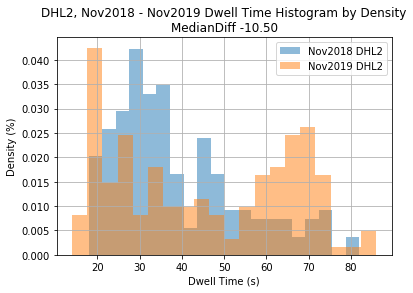

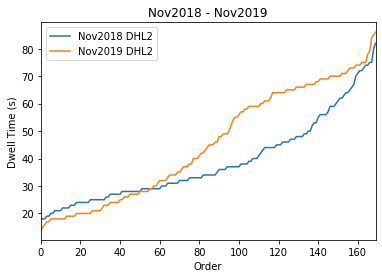


Platform Name DNS3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    252.000000
mean      20.059524
std        3.981084
min       13.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       39.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    252.000000
mean      19.488095
std        6.441574
min       11.000000
25%       16.000000
50%       17.500000
75%       20.000000
max       49.000000
Name: time, dtype: float64
KS two-sample test pValue 4.617125710599477e-06
Dwell Time Increase IS Signficiant


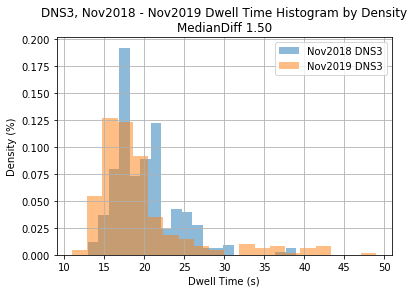

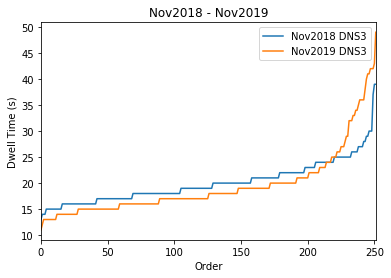


Platform Name DNS4

Platform Name DOO3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    72.000000
mean     24.069444
std       4.488879
min      16.000000
25%      21.000000
50%      24.000000
75%      26.000000
max      44.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     72.000000
mean      28.138889
std       18.288999
min       12.000000
25%       17.750000
50%       21.000000
75%       29.250000
max      107.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0022676241465572513
Dwell Time Increase IS Signficiant


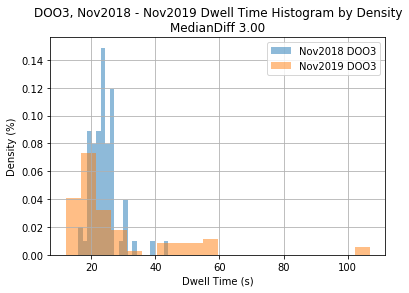

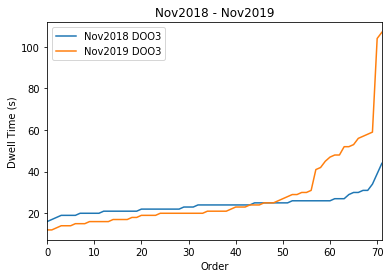


Platform Name DOO4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    281.000000
mean      30.807829
std       19.024573
min       16.000000
25%       21.000000
50%       25.000000
75%       33.000000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    281.000000
mean      34.661922
std       27.521218
min       12.000000
25%       19.000000
50%       23.000000
75%       34.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.004992984759441657
Dwell Time Increase IS Signficiant


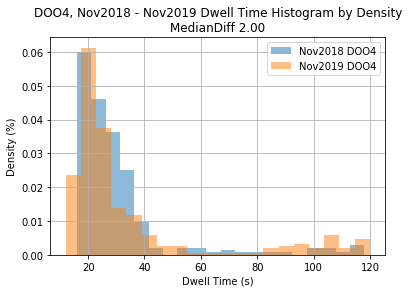

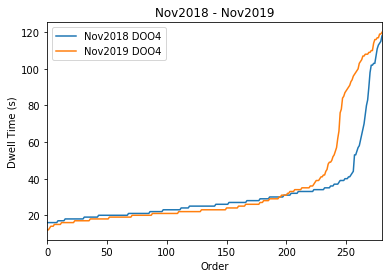


Platform Name EDP2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    222.00000
mean      24.59009
std       10.23606
min       14.00000
25%       19.00000
50%       21.00000
75%       27.00000
max       92.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    222.000000
mean      30.193694
std       18.025456
min       13.000000
25%       19.000000
50%       24.500000
75%       32.000000
max       94.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00020944618838146284
Dwell Time Decrease IS Signficiant


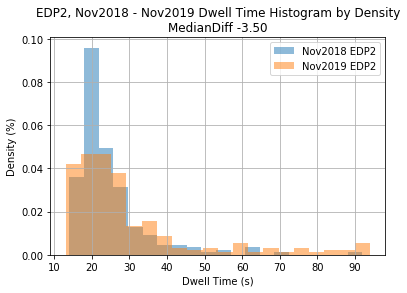

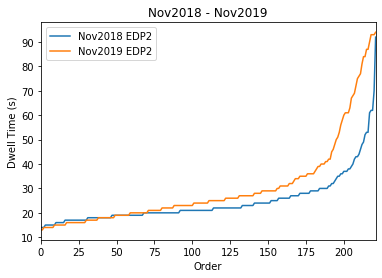


Platform Name EHL3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    119.000000
mean      23.403361
std        5.017460
min       15.000000
25%       20.000000
50%       23.000000
75%       26.000000
max       41.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    119.000000
mean      21.327731
std        5.719591
min       14.000000
25%       18.000000
50%       21.000000
75%       22.500000
max       58.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0005864871662566033
Dwell Time Increase IS Signficiant


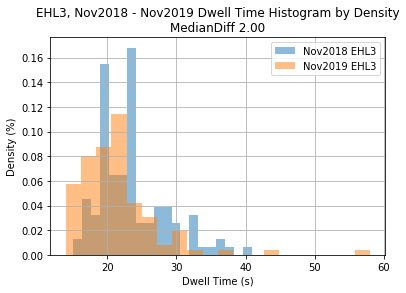

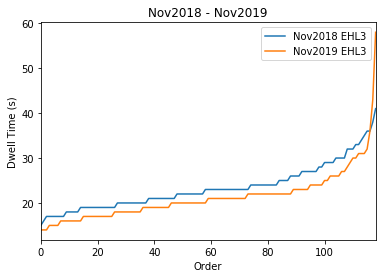


Platform Name EPG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     94.000000
mean      39.244681
std       18.584701
min       21.000000
25%       28.250000
50%       33.000000
75%       41.000000
max      109.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     94.000000
mean      48.606383
std       27.538914
min       16.000000
25%       27.000000
50%       34.500000
75%       68.000000
max      106.000000
Name: time, dtype: float64
KS two-sample test pValue 0.018085182867359644
Dwell Time Decrease IS Signficiant


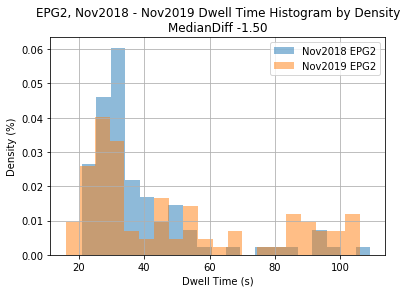

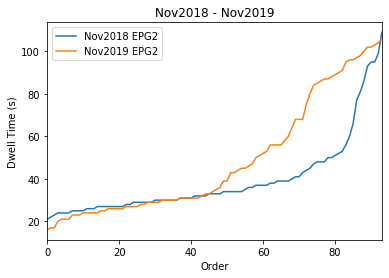


Platform Name EPG3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    90.000000
mean     36.788889
std      14.185365
min      20.000000
25%      28.000000
50%      32.000000
75%      39.000000
max      89.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    90.000000
mean     40.788889
std      14.223335
min      18.000000
25%      30.250000
50%      38.000000
75%      48.000000
max      87.000000
Name: time, dtype: float64
KS two-sample test pValue 0.023204834485530974
Dwell Time Decrease IS Signficiant


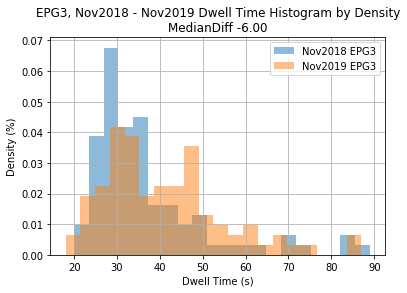

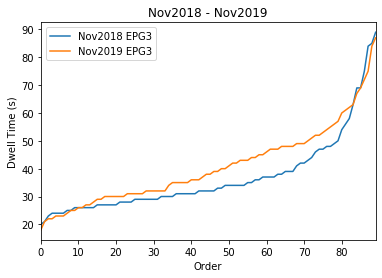


Platform Name EPL1

Platform Name EPL2

Platform Name ERC1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    156.000000
mean      21.519231
std        7.869476
min       13.000000
25%       17.750000
50%       20.000000
75%       22.000000
max       66.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    156.000000
mean      18.929487
std        7.227289
min       11.000000
25%       16.000000
50%       18.000000
75%       20.250000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 7.168817062521365e-06
Dwell Time Increase IS Signficiant


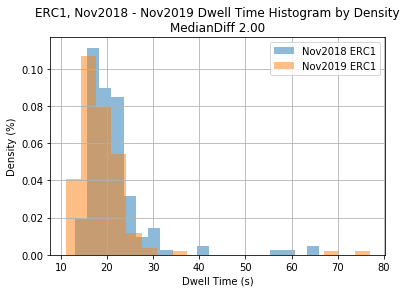

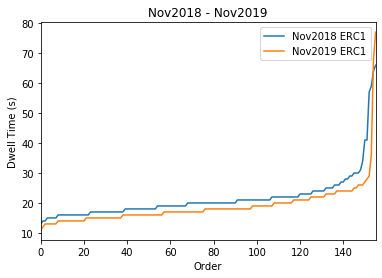


Platform Name ERS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    171.000000
mean      32.514620
std        7.255308
min       19.000000
25%       27.000000
50%       32.000000
75%       37.000000
max       62.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    171.000000
mean      22.356725
std        7.450716
min       12.000000
25%       17.000000
50%       20.000000
75%       26.000000
max       55.000000
Name: time, dtype: float64
KS two-sample test pValue 4.835829003257597e-31
Dwell Time Increase IS Signficiant


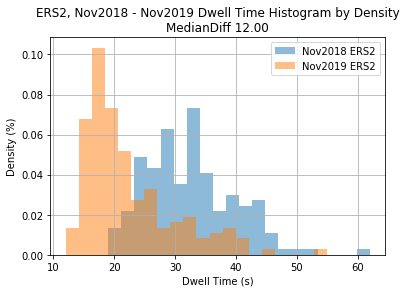

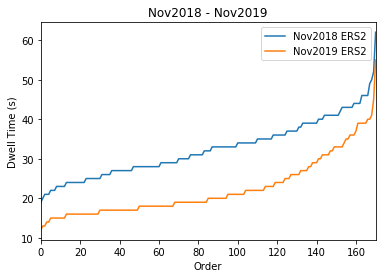


Platform Name EWD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    261.000000
mean      33.114943
std        7.723728
min       20.000000
25%       29.000000
50%       32.000000
75%       35.000000
max       88.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    261.000000
mean      27.157088
std        8.531967
min       14.000000
25%       23.000000
50%       26.000000
75%       30.000000
max      101.000000
Name: time, dtype: float64
KS two-sample test pValue 2.9279141255317467e-25
Dwell Time Increase IS Signficiant


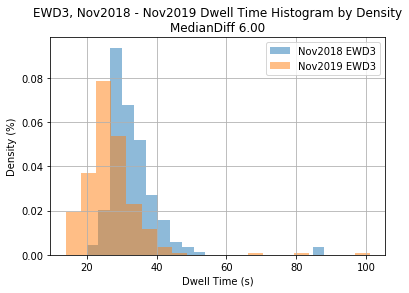

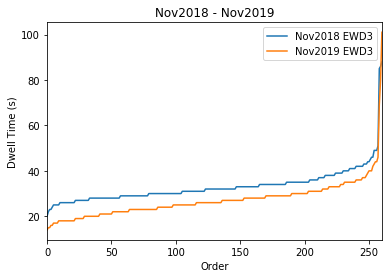


Platform Name EWD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    56.000000
mean     30.535714
std       5.396849
min      22.000000
25%      27.000000
50%      30.000000
75%      34.000000
max      48.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    56.000000
mean     29.196429
std       4.959544
min      18.000000
25%      25.750000
50%      29.000000
75%      33.000000
max      41.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7789498597918985
Dwell Time Increase NOT Signficiant


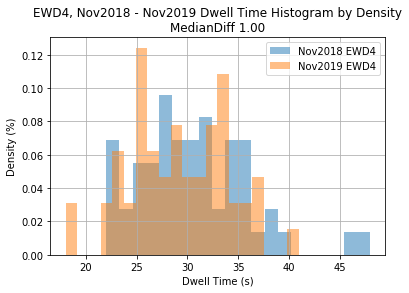

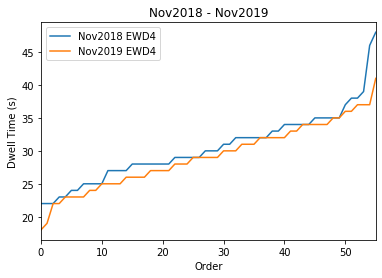


Platform Name FLD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    242.000000
mean      30.880165
std        8.454792
min       16.000000
25%       24.000000
50%       29.000000
75%       36.750000
max       58.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    242.000000
mean      28.983471
std        9.965487
min       14.000000
25%       22.000000
50%       26.000000
75%       33.000000
max       65.000000
Name: time, dtype: float64
KS two-sample test pValue 0.001336261122536826
Dwell Time Increase IS Signficiant


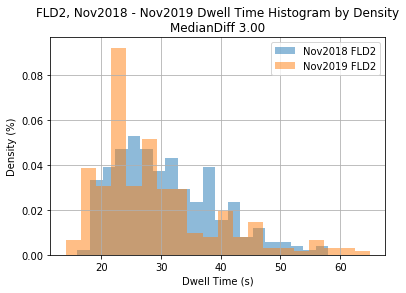

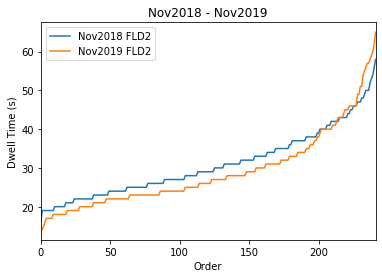


Platform Name FLM4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    216.000000
mean      23.254630
std        7.821555
min       16.000000
25%       19.000000
50%       21.000000
75%       24.000000
max       84.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    216.000000
mean      24.574074
std       11.223069
min       14.000000
25%       20.000000
50%       22.000000
75%       26.000000
max      110.000000
Name: time, dtype: float64
KS two-sample test pValue 0.11077094811154066
Dwell Time Decrease NOT Signficiant


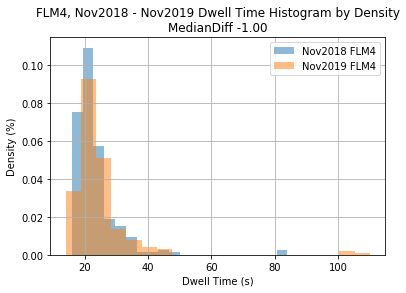

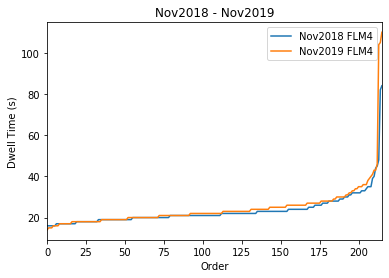


Platform Name GFD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    182.000000
mean      48.450549
std       27.024345
min       17.000000
25%       28.000000
50%       37.000000
75%       65.250000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    182.000000
mean      53.137363
std       30.907237
min       16.000000
25%       26.250000
50%       41.500000
75%       76.500000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.27498779259500833
Dwell Time Decrease NOT Signficiant


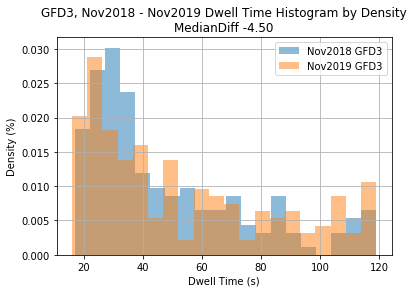

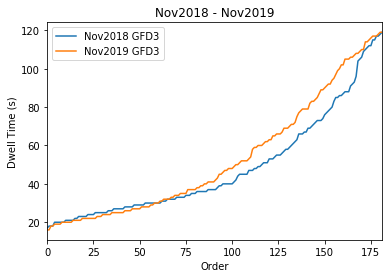


Platform Name GFD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     51.000000
mean      57.235294
std       27.245248
min       20.000000
25%       34.500000
50%       49.000000
75%       79.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     51.000000
mean      68.921569
std       34.572152
min       14.000000
25%       32.000000
50%       70.000000
75%      102.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.042388771873188597
Dwell Time Decrease IS Signficiant


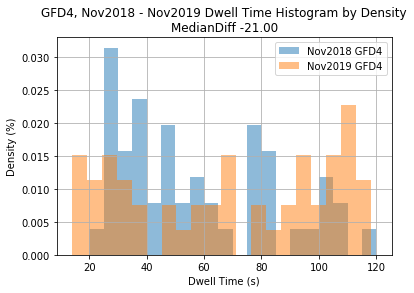

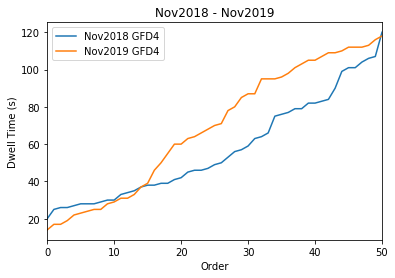


Platform Name GLD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    231.000000
mean      24.285714
std        6.629690
min       15.000000
25%       21.000000
50%       23.000000
75%       26.000000
max       90.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    231.000000
mean      22.580087
std        7.811994
min       12.000000
25%       19.000000
50%       21.000000
75%       24.000000
max      105.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00013427623194200213
Dwell Time Increase IS Signficiant


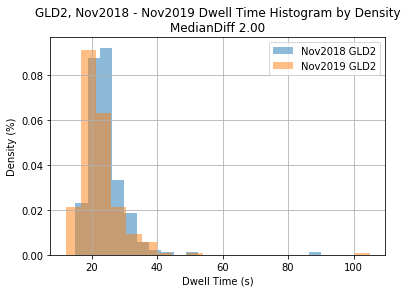

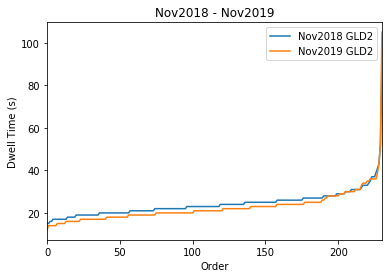


Platform Name GQU2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    279.000000
mean      28.817204
std        6.542522
min       15.000000
25%       24.000000
50%       28.000000
75%       32.000000
max       60.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    279.000000
mean      25.534050
std        6.642307
min       14.000000
25%       21.000000
50%       24.000000
75%       29.000000
max       57.000000
Name: time, dtype: float64
KS two-sample test pValue 9.2935501212952e-10
Dwell Time Increase IS Signficiant


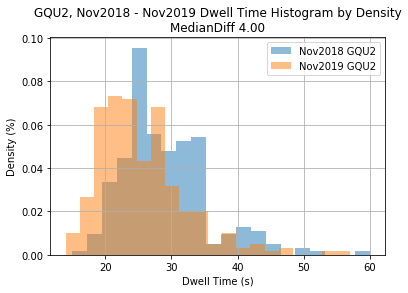

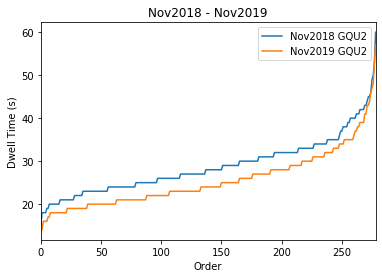


Platform Name GRD2

Platform Name GRD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    429.000000
mean      40.375291
std       18.560748
min       18.000000
25%       27.000000
50%       33.000000
75%       48.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    429.000000
mean      43.969697
std       18.539715
min       15.000000
25%       27.000000
50%       43.000000
75%       58.000000
max       96.000000
Name: time, dtype: float64
KS two-sample test pValue 5.9112606924653605e-08
Dwell Time Decrease IS Signficiant


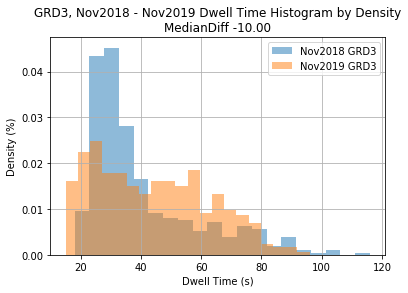

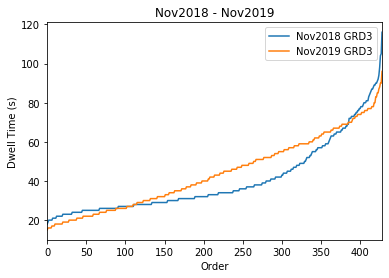


Platform Name GVL2

Platform Name GVL4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    318.000000
mean      30.254717
std       11.928331
min       18.000000
25%       24.000000
50%       27.000000
75%       32.000000
max      111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    318.000000
mean      29.327044
std       13.659213
min       13.000000
25%       22.000000
50%       26.000000
75%       30.750000
max      112.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0033928027127114206
Dwell Time Increase IS Signficiant


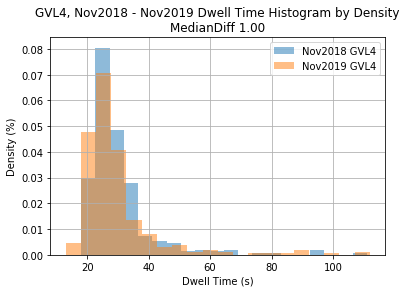

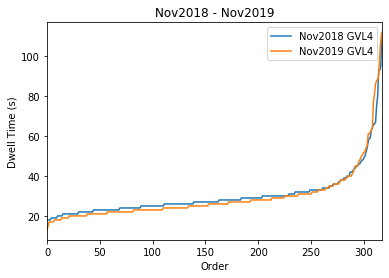


Platform Name HBY1

Platform Name HBY2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    233.000000
mean      91.437768
std       22.386047
min       22.000000
25%       88.000000
50%       97.000000
75%      105.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    233.000000
mean      72.725322
std       25.333501
min       21.000000
25%       53.000000
50%       67.000000
75%       94.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 2.0951588497662192e-23
Dwell Time Increase IS Signficiant


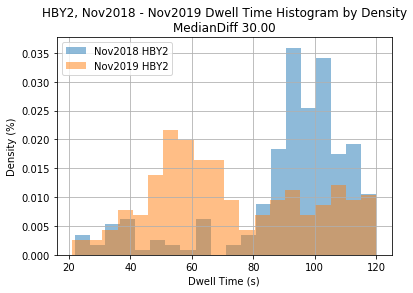

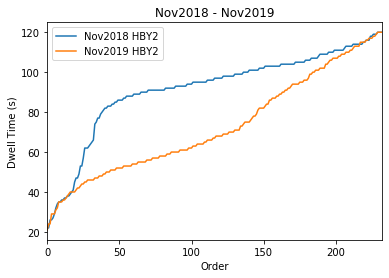


Platform Name HBY4

Platform Name HLW2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    148.000000
mean      36.594595
std       17.598252
min       20.000000
25%       28.000000
50%       31.000000
75%       35.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    148.000000
mean      26.121622
std       11.676423
min       15.000000
25%       20.000000
50%       23.000000
75%       29.250000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 6.718584353454095e-15
Dwell Time Increase IS Signficiant


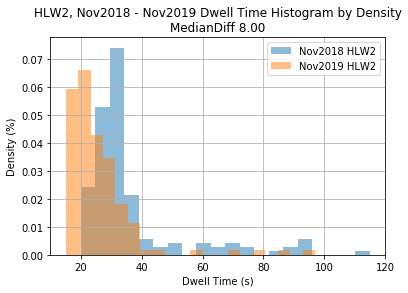

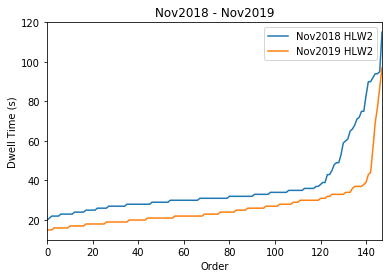


Platform Name HOM7
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    49.000000
mean     31.387755
std      11.309687
min      19.000000
25%      25.000000
50%      29.000000
75%      32.000000
max      88.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    49.000000
mean     26.020408
std       6.965659
min      17.000000
25%      22.000000
50%      25.000000
75%      29.000000
max      56.000000
Name: time, dtype: float64
KS two-sample test pValue 0.019754137896767714
Dwell Time Increase IS Signficiant


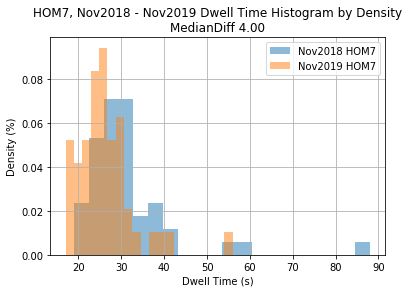

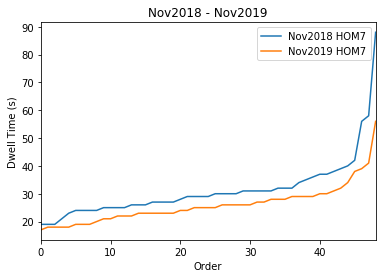


Platform Name HPK3

Platform Name HPK4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    115.000000
mean      26.886957
std       11.158165
min       16.000000
25%       19.000000
50%       23.000000
75%       30.000000
max       62.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    115.000000
mean      25.226087
std       15.725195
min       12.000000
25%       18.000000
50%       20.000000
75%       24.000000
max       98.000000
Name: time, dtype: float64
KS two-sample test pValue 0.04300935722524225
Dwell Time Increase IS Signficiant


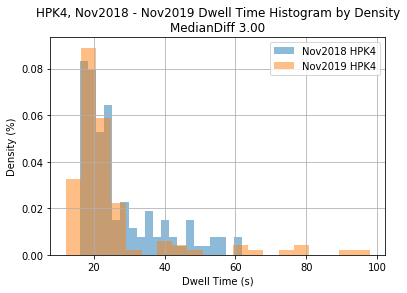

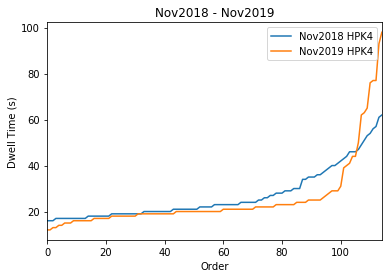


Platform Name HRL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    155.000000
mean      30.245161
std        7.121708
min       17.000000
25%       27.000000
50%       30.000000
75%       33.000000
max       86.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    155.000000
mean      28.096774
std        7.313725
min       14.000000
25%       22.500000
50%       28.000000
75%       33.000000
max       59.000000
Name: time, dtype: float64
KS two-sample test pValue 0.008677784495631101
Dwell Time Increase IS Signficiant


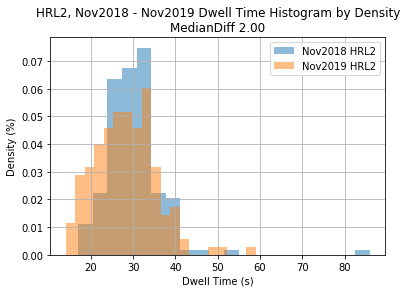

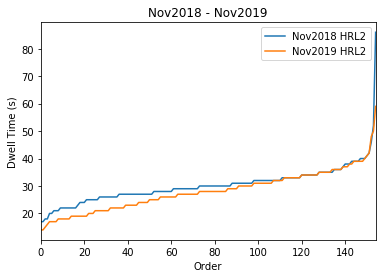


Platform Name ING2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    133.000000
mean      31.157895
std        6.875343
min       19.000000
25%       27.000000
50%       30.000000
75%       35.000000
max       60.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    133.000000
mean      26.578947
std        9.459011
min       15.000000
25%       21.000000
50%       24.000000
75%       31.000000
max       75.000000
Name: time, dtype: float64
KS two-sample test pValue 5.980779197243153e-11
Dwell Time Increase IS Signficiant


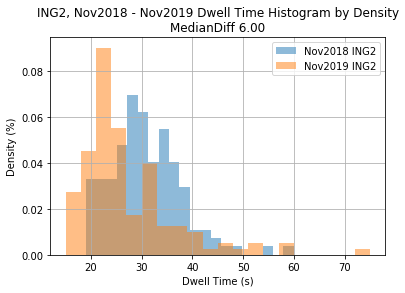

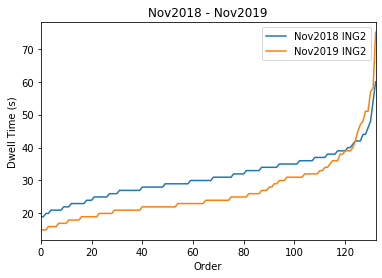


Platform Name KGR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    141.000000
mean      25.822695
std        6.141526
min       17.000000
25%       22.000000
50%       24.000000
75%       30.000000
max       52.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    141.000000
mean      21.843972
std        5.249876
min       15.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       42.000000
Name: time, dtype: float64
KS two-sample test pValue 1.2226552222016375e-07
Dwell Time Increase IS Signficiant


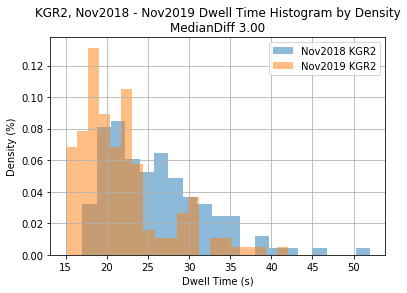

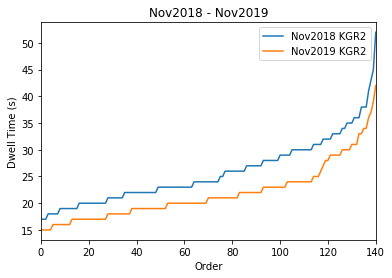


Platform Name KLR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    577.000000
mean      23.346620
std        8.180757
min       13.000000
25%       18.000000
50%       21.000000
75%       25.000000
max      103.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    577.000000
mean      19.192374
std        4.736026
min       13.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       61.000000
Name: time, dtype: float64
KS two-sample test pValue 1.9839790363028297e-20
Dwell Time Increase IS Signficiant


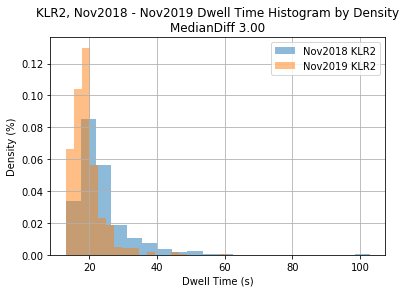

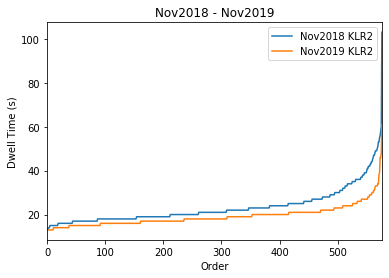


Platform Name KWD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    298.000000
mean      25.785235
std        7.652876
min       15.000000
25%       21.250000
50%       24.000000
75%       27.000000
max       68.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    298.000000
mean      30.077181
std       15.521379
min       13.000000
25%       20.000000
50%       24.000000
75%       35.750000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00015574229349400978
Dwell Time Decrease IS Signficiant


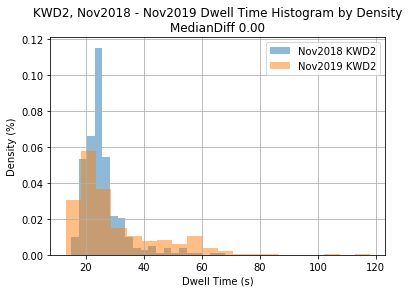

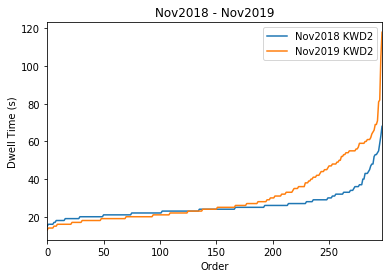


Platform Name LAK2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    188.000000
mean      26.845745
std        7.387128
min       17.000000
25%       22.000000
50%       25.000000
75%       29.000000
max       63.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    188.000000
mean      28.345745
std       11.625283
min       15.000000
25%       22.000000
50%       25.000000
75%       30.000000
max       91.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8397595140674649
Dwell Time Decrease NOT Signficiant


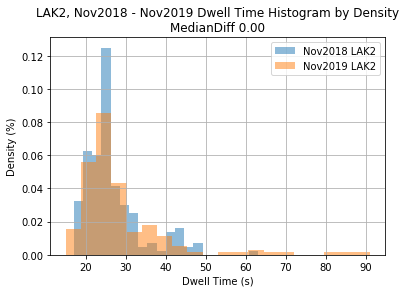

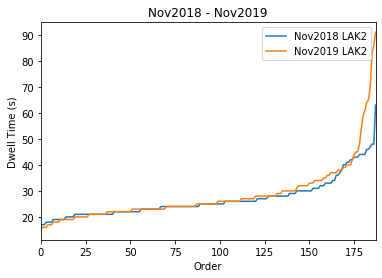


Platform Name LCE2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    119.000000
mean      37.974790
std        9.017368
min       22.000000
25%       32.000000
50%       37.000000
75%       41.000000
max       78.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    119.000000
mean      34.789916
std       11.388274
min       18.000000
25%       27.000000
50%       32.000000
75%       39.000000
max       90.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0005864871662566033
Dwell Time Increase IS Signficiant


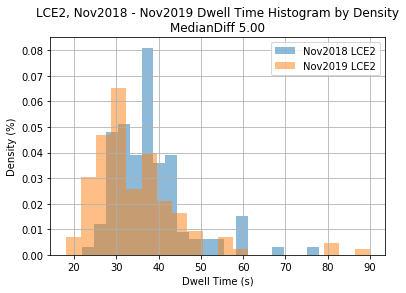

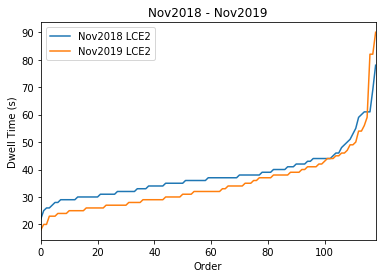


Platform Name LCE4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    275.000000
mean      40.676364
std       10.225950
min       23.000000
25%       34.500000
50%       39.000000
75%       45.000000
max      109.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    275.000000
mean      39.567273
std       11.870577
min       18.000000
25%       31.500000
50%       38.000000
75%       46.000000
max       86.000000
Name: time, dtype: float64
KS two-sample test pValue 0.029790225354443235
Dwell Time Increase IS Signficiant


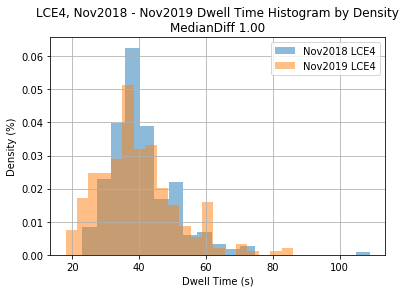

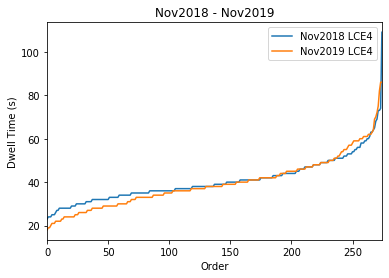


Platform Name LCE5

Platform Name LDF2

Platform Name LDF3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    655.000000
mean      23.940458
std        7.058372
min       14.000000
25%       20.000000
50%       22.000000
75%       26.000000
max       99.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    655.000000
mean      21.299237
std        7.467089
min       11.000000
25%       17.000000
50%       19.000000
75%       23.000000
max       82.000000
Name: time, dtype: float64
KS two-sample test pValue 1.153146468810402e-23
Dwell Time Increase IS Signficiant


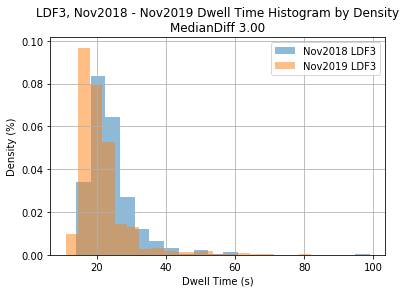

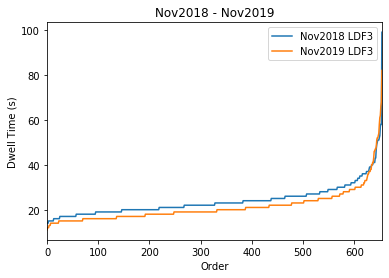


Platform Name LEP1

Platform Name LEP2

Platform Name LEP3

Platform Name LEP4

Platform Name LEW2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    144.000000
mean      24.840278
std        4.677970
min       15.000000
25%       22.000000
50%       24.000000
75%       27.000000
max       49.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    144.000000
mean      24.173611
std        6.200981
min       13.000000
25%       20.000000
50%       23.000000
75%       26.250000
max       47.000000
Name: time, dtype: float64
KS two-sample test pValue 0.018122331816097997
Dwell Time Increase IS Signficiant


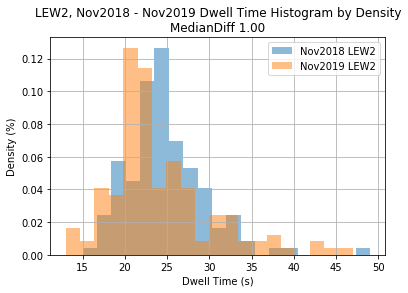

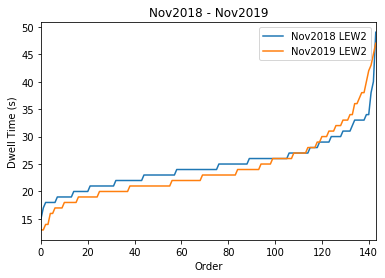


Platform Name LIV2

Platform Name LIV3

Platform Name LIV4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    228.000000
mean      34.552632
std       15.800291
min       16.000000
25%       25.000000
50%       31.000000
75%       37.000000
max      114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    228.000000
mean      38.881579
std       17.721512
min       15.000000
25%       23.000000
50%       33.000000
75%       55.000000
max       96.000000
Name: time, dtype: float64
KS two-sample test pValue 1.3074467047288922e-05
Dwell Time Decrease IS Signficiant


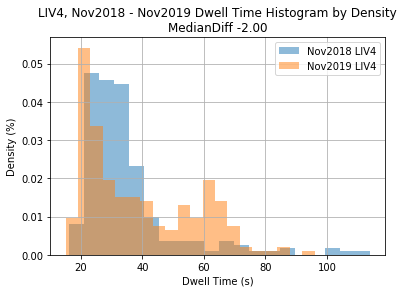

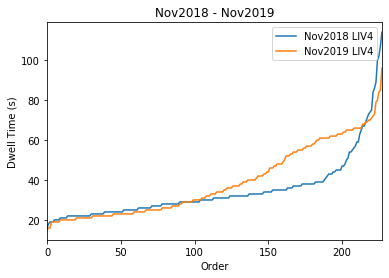


Platform Name LTN2

Platform Name LUH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    130.000000
mean      52.130769
std       20.826485
min       21.000000
25%       33.000000
50%       49.500000
75%       71.000000
max      104.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    130.000000
mean      56.038462
std       21.216274
min       16.000000
25%       37.250000
50%       60.000000
75%       73.000000
max      101.000000
Name: time, dtype: float64
KS two-sample test pValue 0.033988703231289316
Dwell Time Decrease IS Signficiant


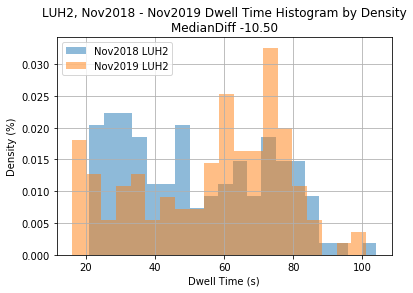

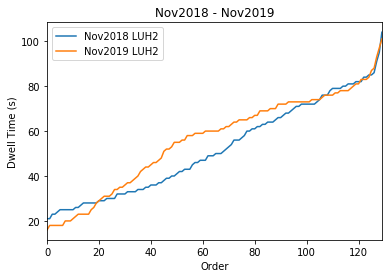


Platform Name MCA1

Platform Name MCA3

Platform Name MCO2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    290.000000
mean      30.658621
std        6.824342
min       18.000000
25%       26.000000
50%       29.000000
75%       34.000000
max       58.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    290.000000
mean      27.675862
std        6.805639
min       14.000000
25%       23.000000
50%       26.000000
75%       31.000000
max       53.000000
Name: time, dtype: float64
KS two-sample test pValue 7.998318332084108e-08
Dwell Time Increase IS Signficiant


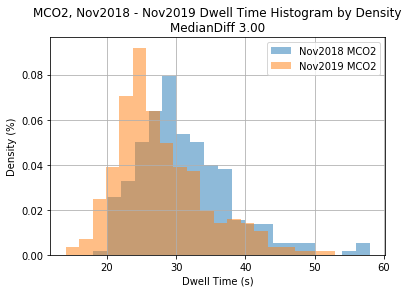

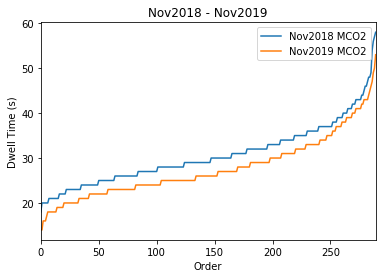


Platform Name MCT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    117.000000
mean      22.854701
std        4.690903
min       16.000000
25%       20.000000
50%       22.000000
75%       25.000000
max       37.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    117.000000
mean      22.666667
std        6.017217
min       13.000000
25%       18.000000
50%       22.000000
75%       25.000000
max       46.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4672242694023528
Dwell Time Decrease NOT Signficiant


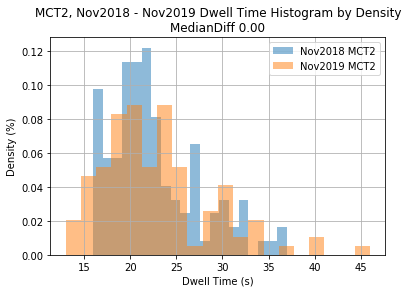

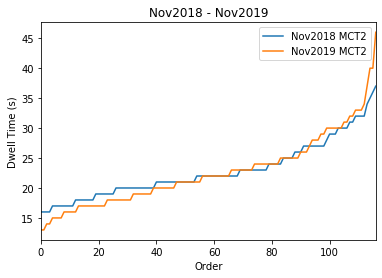


Platform Name MDB2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    332.000000
mean      24.301205
std        5.656288
min       15.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       51.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    332.000000
mean      21.948795
std        5.262341
min       13.000000
25%       18.000000
50%       21.000000
75%       25.000000
max       50.000000
Name: time, dtype: float64
KS two-sample test pValue 2.4968649085671e-06
Dwell Time Increase IS Signficiant


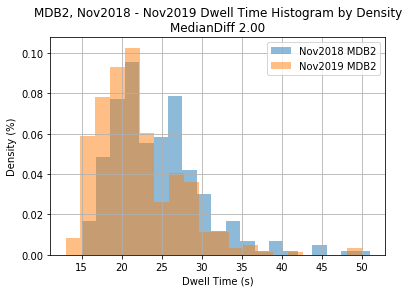

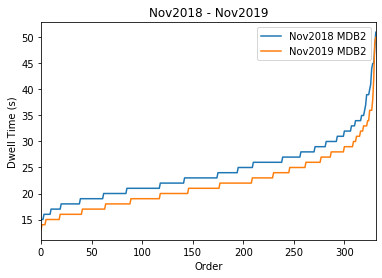


Platform Name MDT3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    70.000000
mean     29.957143
std       7.094468
min      21.000000
25%      25.000000
50%      28.500000
75%      32.750000
max      66.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    70.000000
mean     26.214286
std       7.000813
min      13.000000
25%      22.000000
50%      24.500000
75%      29.000000
max      46.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00010886043603397702
Dwell Time Increase IS Signficiant


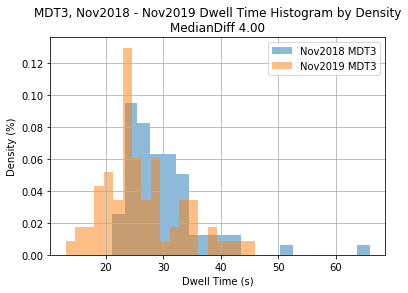

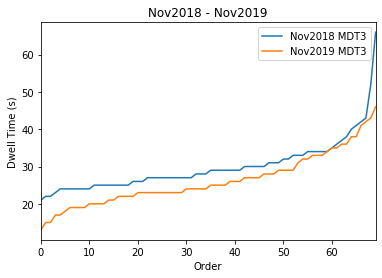


Platform Name MDT4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    296.000000
mean      34.027027
std       11.642090
min       15.000000
25%       26.000000
50%       32.500000
75%       39.000000
max       91.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    296.000000
mean      30.378378
std        9.357245
min       16.000000
25%       24.000000
50%       28.000000
75%       35.000000
max       73.000000
Name: time, dtype: float64
KS two-sample test pValue 9.803726698687912e-06
Dwell Time Increase IS Signficiant


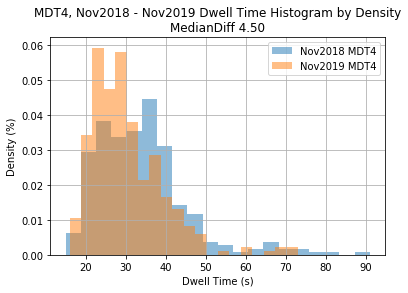

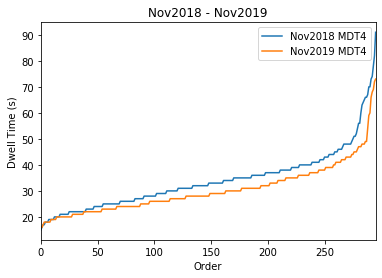


Platform Name MIN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    132.000000
mean      34.545455
std        8.982905
min       20.000000
25%       27.000000
50%       34.000000
75%       41.000000
max       60.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    132.000000
mean      32.727273
std       12.672077
min       15.000000
25%       23.750000
50%       30.000000
75%       41.000000
max       99.000000
Name: time, dtype: float64
KS two-sample test pValue 0.007848477623044255
Dwell Time Increase IS Signficiant


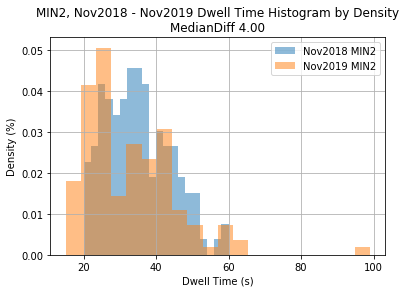

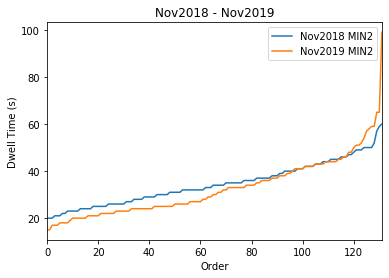


Platform Name MKG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    132.000000
mean      25.227273
std        8.303950
min       14.000000
25%       21.000000
50%       23.000000
75%       26.000000
max       76.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    132.000000
mean      21.325758
std        6.544616
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       63.000000
Name: time, dtype: float64
KS two-sample test pValue 7.954354534598326e-08
Dwell Time Increase IS Signficiant


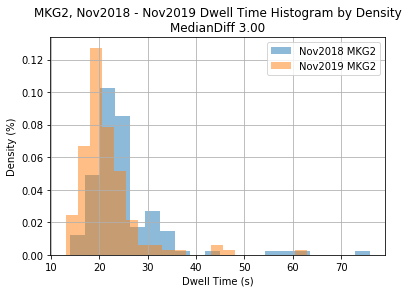

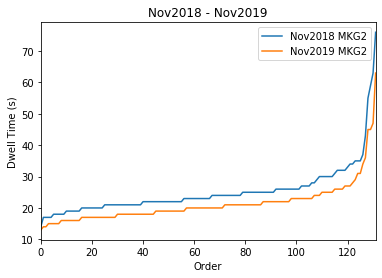


Platform Name MKV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    184.000000
mean      28.331522
std        6.129200
min       17.000000
25%       24.000000
50%       28.000000
75%       31.000000
max       59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    184.000000
mean      28.690217
std        9.059410
min       15.000000
25%       22.000000
50%       26.000000
75%       33.000000
max       56.000000
Name: time, dtype: float64
KS two-sample test pValue 0.020567044760127932
Dwell Time Increase IS Signficiant


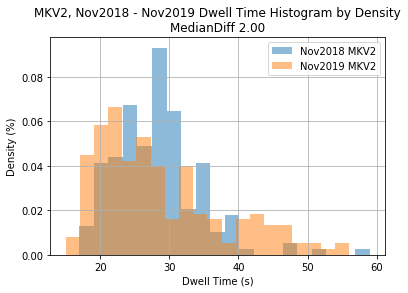

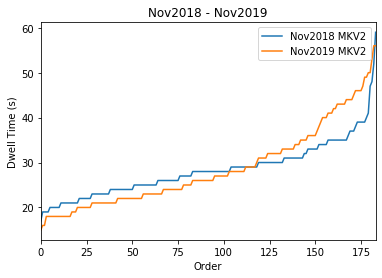


Platform Name MPT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    843.000000
mean      23.238434
std        6.399142
min       13.000000
25%       20.000000
50%       22.000000
75%       25.000000
max       89.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    843.000000
mean      27.608541
std       10.577551
min       12.000000
25%       20.000000
50%       24.000000
75%       34.000000
max       85.000000
Name: time, dtype: float64
KS two-sample test pValue 5.607293135519508e-20
Dwell Time Decrease IS Signficiant


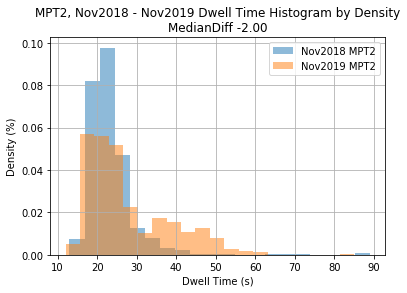

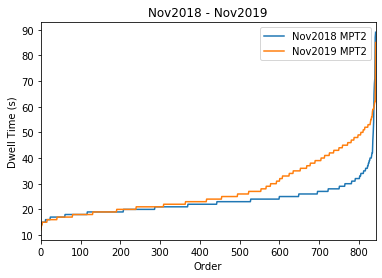


Platform Name MQF2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    152.000000
mean      22.105263
std        5.161187
min       12.000000
25%       19.000000
50%       21.000000
75%       24.000000
max       44.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    152.000000
mean      19.486842
std        5.795622
min       12.000000
25%       15.750000
50%       18.000000
75%       22.000000
max       49.000000
Name: time, dtype: float64
KS two-sample test pValue 5.841063762771944e-11
Dwell Time Increase IS Signficiant


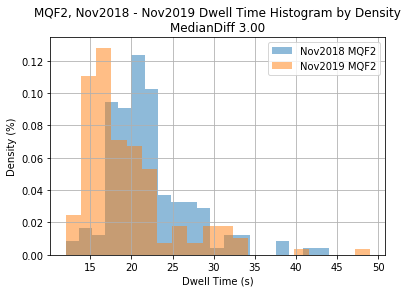

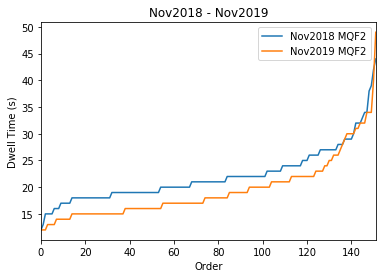


Platform Name MSM1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    334.000000
mean      35.556886
std       11.680740
min       17.000000
25%       25.250000
50%       34.000000
75%       44.000000
max       80.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    334.000000
mean      31.901198
std        9.752145
min       14.000000
25%       24.000000
50%       31.000000
75%       38.000000
max       59.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00011536481015991278
Dwell Time Increase IS Signficiant


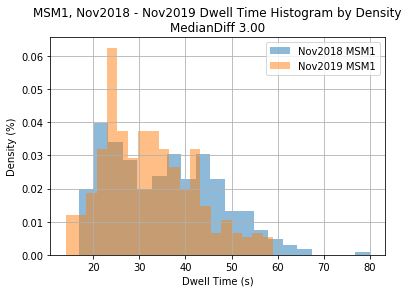

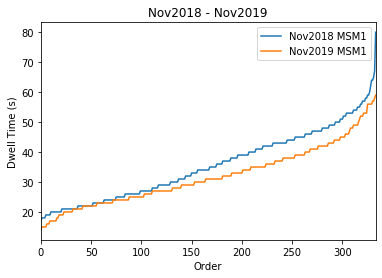


Platform Name MTC2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    133.000000
mean      33.428571
std       11.276340
min       13.000000
25%       25.000000
50%       29.000000
75%       40.000000
max       74.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    133.000000
mean      31.360902
std       13.859871
min       13.000000
25%       20.000000
50%       27.000000
75%       44.000000
max       63.000000
Name: time, dtype: float64
KS two-sample test pValue 3.450901166202566e-05
Dwell Time Increase IS Signficiant


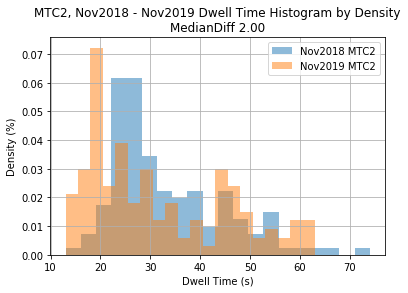

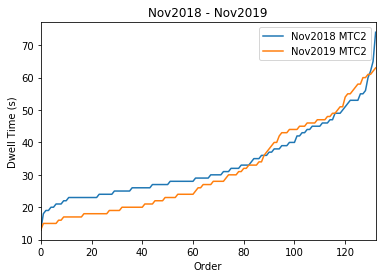


Platform Name MUL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    145.000000
mean      23.337931
std       11.248593
min       14.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       88.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    145.000000
mean      22.413793
std       13.077008
min       13.000000
25%       16.000000
50%       18.000000
75%       22.000000
max      106.000000
Name: time, dtype: float64
KS two-sample test pValue 1.433852447817779e-06
Dwell Time Increase IS Signficiant


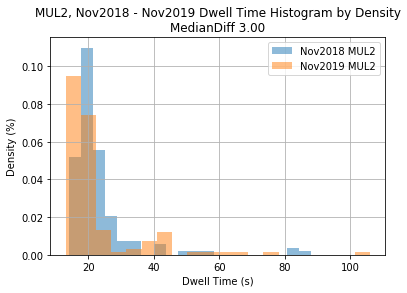

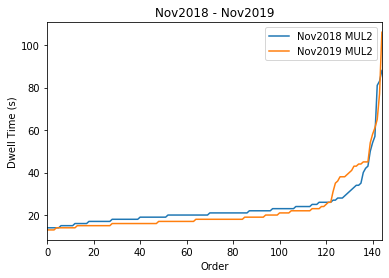


Platform Name MYG1

Platform Name MYG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    224.000000
mean      22.022321
std        6.183621
min       15.000000
25%       19.000000
50%       21.000000
75%       23.000000
max       88.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    224.000000
mean      21.348214
std        8.454266
min       12.000000
25%       18.000000
50%       20.000000
75%       22.250000
max       98.000000
Name: time, dtype: float64
KS two-sample test pValue 0.008347980913595735
Dwell Time Increase IS Signficiant


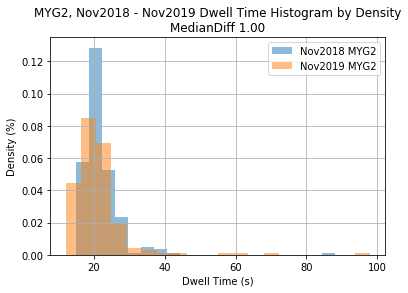

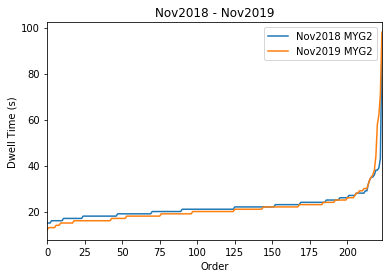


Platform Name MYL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    230.000000
mean      29.234783
std        7.064062
min       16.000000
25%       25.000000
50%       28.000000
75%       33.000000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    230.000000
mean      25.621739
std        6.713765
min       14.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       62.000000
Name: time, dtype: float64
KS two-sample test pValue 1.7042629173302435e-08
Dwell Time Increase IS Signficiant


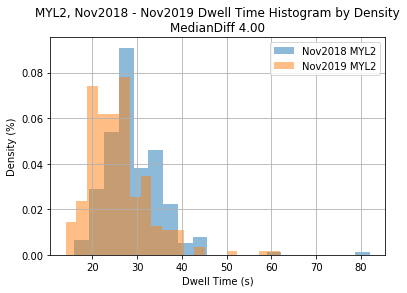

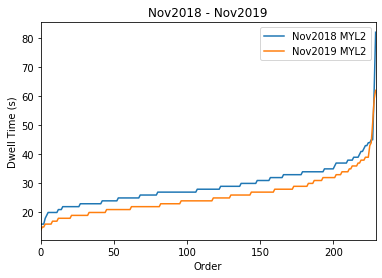


Platform Name NMH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    285.000000
mean      25.347368
std        8.422934
min       15.000000
25%       20.000000
50%       23.000000
75%       28.000000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    285.00000
mean      25.54386
std        9.35164
min       13.00000
25%       19.00000
50%       23.00000
75%       31.00000
max      100.00000
Name: time, dtype: float64
KS two-sample test pValue 0.18661778613606247
Dwell Time Decrease NOT Signficiant


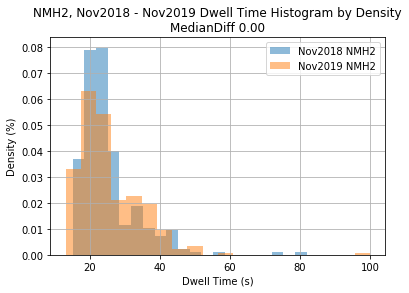

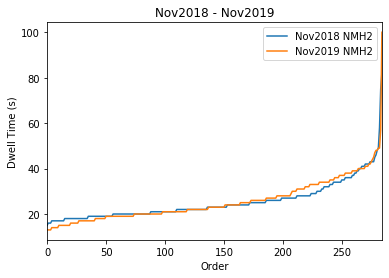


Platform Name NRW2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    151.000000
mean      29.900662
std       10.088115
min       19.000000
25%       25.000000
50%       28.000000
75%       31.000000
max      107.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    151.000000
mean      24.331126
std        7.936180
min       14.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       87.000000
Name: time, dtype: float64
KS two-sample test pValue 1.243133001540709e-09
Dwell Time Increase IS Signficiant


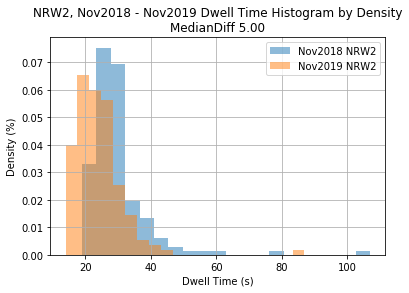

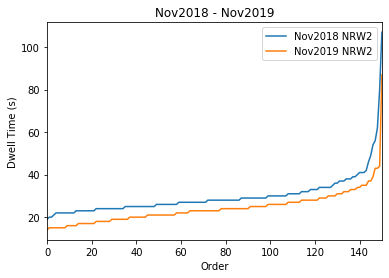


Platform Name NST2

Platform Name NST3

Platform Name NSY2

Platform Name NSY3

Platform Name NSY4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    833.000000
mean      56.896759
std       26.703300
min       17.000000
25%       32.000000
50%       53.000000
75%       77.000000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    833.000000
mean      53.013205
std       23.317954
min       15.000000
25%       31.000000
50%       49.000000
75%       76.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 1.849195087512231e-07
Dwell Time Increase IS Signficiant


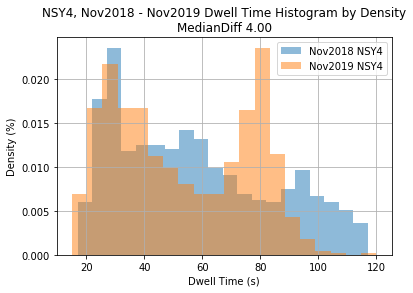

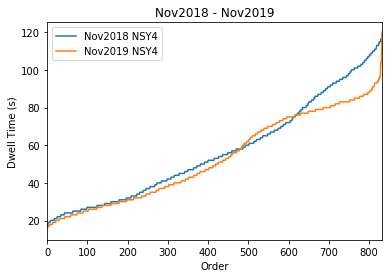


Platform Name NTN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    306.000000
mean      34.758170
std        8.591667
min       20.000000
25%       28.000000
50%       33.500000
75%       39.750000
max       69.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    306.000000
mean      33.656863
std        9.748808
min       16.000000
25%       26.000000
50%       33.000000
75%       40.750000
max       86.000000
Name: time, dtype: float64
KS two-sample test pValue 0.10560237941659006
Dwell Time Increase NOT Signficiant


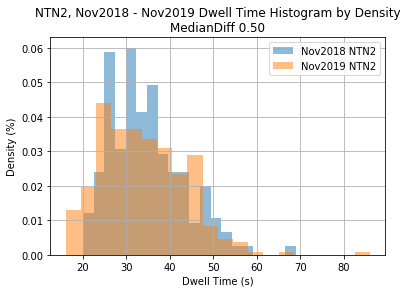

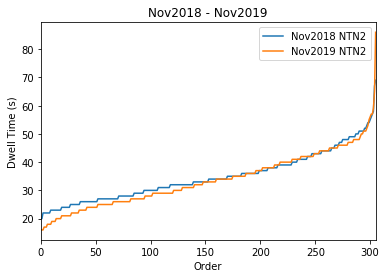


Platform Name PAD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    147.000000
mean      26.646259
std        5.546568
min       20.000000
25%       23.000000
50%       26.000000
75%       29.000000
max       64.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    147.000000
mean      22.061224
std        5.576645
min       13.000000
25%       19.000000
50%       21.000000
75%       24.500000
max       50.000000
Name: time, dtype: float64
KS two-sample test pValue 1.4376985291047326e-14
Dwell Time Increase IS Signficiant


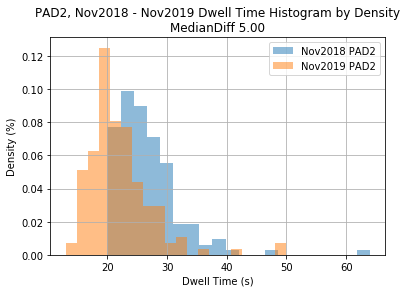

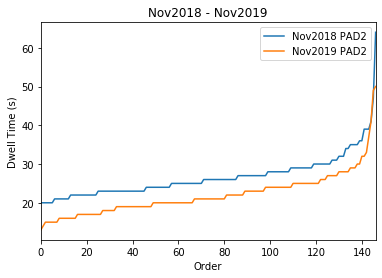


Platform Name PAN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    120.000000
mean      42.591667
std       18.752477
min       17.000000
25%       24.000000
50%       40.000000
75%       63.000000
max       73.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    120.000000
mean      45.641667
std       17.434051
min       15.000000
25%       28.750000
50%       50.000000
75%       60.000000
max       72.000000
Name: time, dtype: float64
KS two-sample test pValue 0.035223296929317895
Dwell Time Decrease IS Signficiant


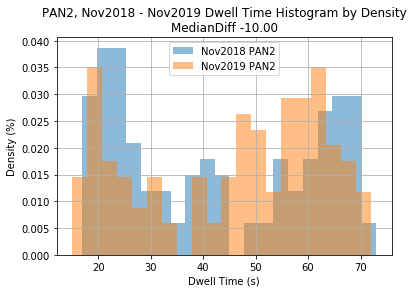

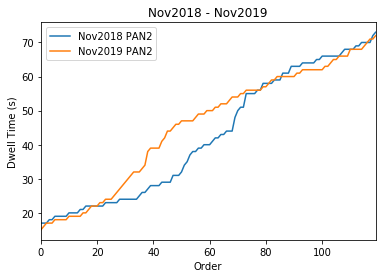


Platform Name PDH1

Platform Name PDH3

Platform Name PDH4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    219.000000
mean      28.648402
std       11.222914
min       15.000000
25%       21.000000
50%       25.000000
75%       31.500000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    219.000000
mean      28.109589
std       11.155977
min       15.000000
25%       21.000000
50%       24.000000
75%       32.000000
max       62.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3826797900596636
Dwell Time Increase NOT Signficiant


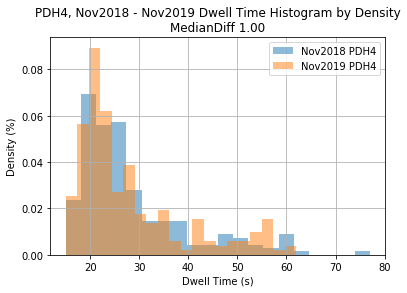

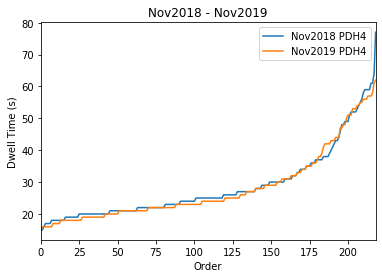


Platform Name PEN1

Platform Name PEN2

Platform Name PEN3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    131.000000
mean      50.984733
std       21.837154
min       17.000000
25%       36.000000
50%       44.000000
75%       62.500000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    131.000000
mean      62.816794
std       24.505196
min       18.000000
25%       40.500000
50%       67.000000
75%       82.500000
max      111.000000
Name: time, dtype: float64
KS two-sample test pValue 2.354577357931525e-06
Dwell Time Decrease IS Signficiant


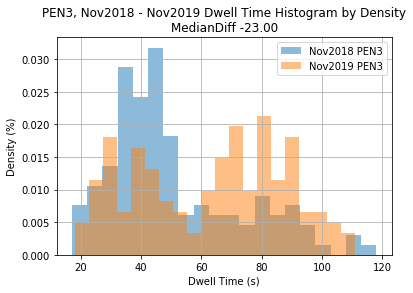

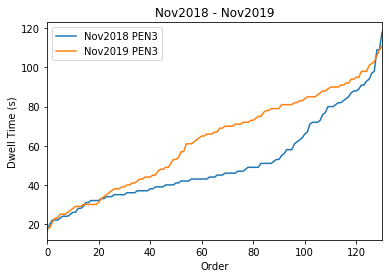


Platform Name PET2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    161.000000
mean      24.111801
std        5.432534
min       16.000000
25%       21.000000
50%       23.000000
75%       26.000000
max       52.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    161.000000
mean      21.850932
std        6.132099
min       13.000000
25%       19.000000
50%       21.000000
75%       23.000000
max       55.000000
Name: time, dtype: float64
KS two-sample test pValue 1.0678111792669436e-05
Dwell Time Increase IS Signficiant


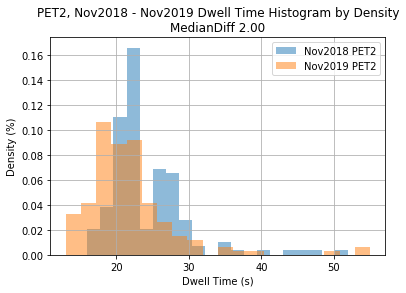

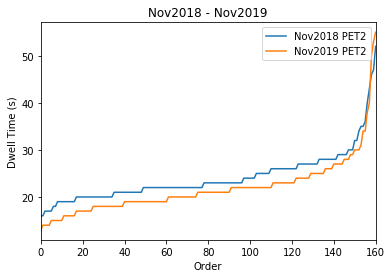


Platform Name PNT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    285.000000
mean      25.147368
std        8.376655
min       15.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    285.000000
mean      25.519298
std       10.168846
min       12.000000
25%       19.000000
50%       23.000000
75%       29.000000
max       72.000000
Name: time, dtype: float64
KS two-sample test pValue 0.002209401794975998
Dwell Time Decrease IS Signficiant


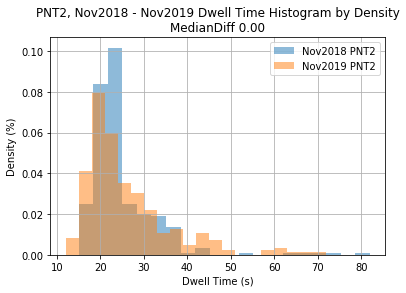

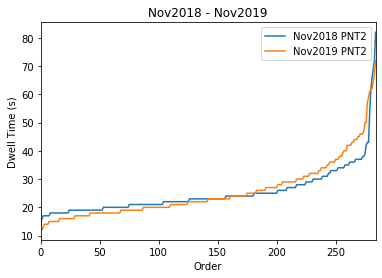


Platform Name PTA2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    469.000000
mean      48.729211
std       15.966485
min       22.000000
25%       38.000000
50%       45.000000
75%       55.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    469.000000
mean      54.402985
std       23.627669
min       18.000000
25%       37.000000
50%       47.000000
75%       67.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00010201917814066148
Dwell Time Decrease IS Signficiant


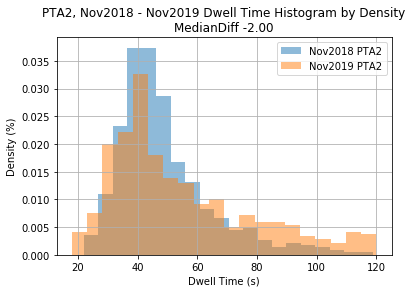

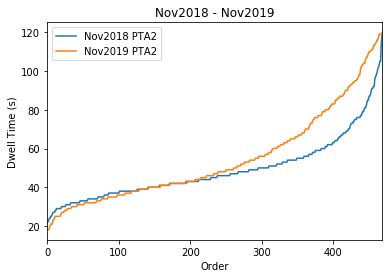


Platform Name PTA3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     45.000000
mean      48.711111
std       20.511219
min       26.000000
25%       35.000000
50%       43.000000
75%       56.000000
max      109.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    45.000000
mean     45.177778
std      18.472693
min      17.000000
25%      33.000000
50%      42.000000
75%      52.000000
max      88.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9478785088074422
Dwell Time Increase NOT Signficiant


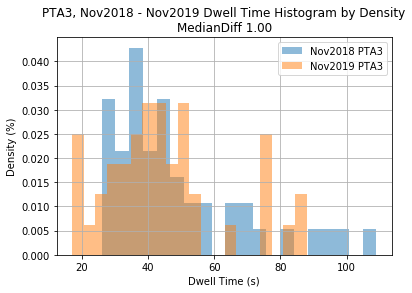

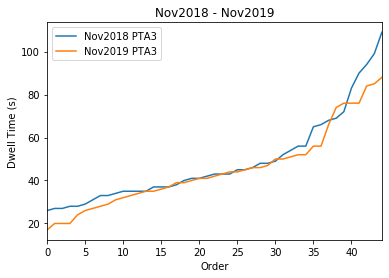


Platform Name PTA4

Platform Name PUN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    176.000000
mean      28.528409
std        6.681256
min       17.000000
25%       25.000000
50%       28.000000
75%       31.000000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    176.000000
mean      26.693182
std        7.876704
min       13.000000
25%       22.000000
50%       26.000000
75%       30.000000
max      103.000000
Name: time, dtype: float64
KS two-sample test pValue 0.016682638626527635
Dwell Time Increase IS Signficiant


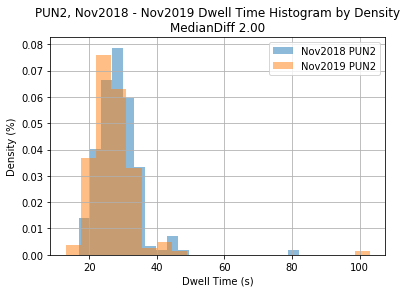

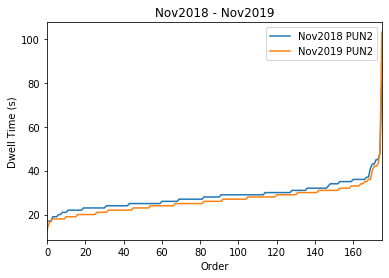


Platform Name PYM2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    367.000000
mean      30.787466
std       11.597228
min       17.000000
25%       23.000000
50%       27.000000
75%       37.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    367.000000
mean      22.092643
std        5.469950
min       11.000000
25%       18.000000
50%       21.000000
75%       25.000000
max       54.000000
Name: time, dtype: float64
KS two-sample test pValue 3.698642489398248e-21
Dwell Time Increase IS Signficiant


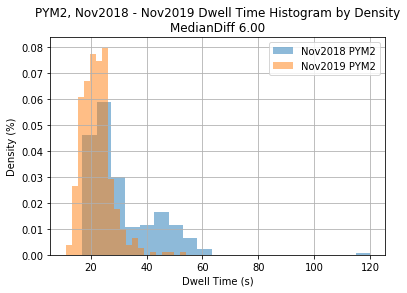

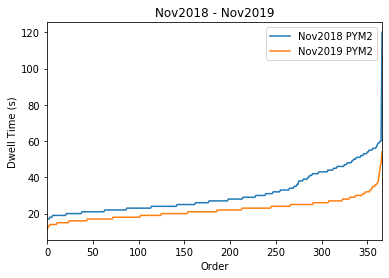


Platform Name QKH1

Platform Name QKH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    218.000000
mean      30.325688
std        9.370971
min       18.000000
25%       26.000000
50%       29.000000
75%       32.750000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    218.000000
mean      25.146789
std        8.913125
min       12.000000
25%       20.000000
50%       23.000000
75%       28.000000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 2.134636017913962e-17
Dwell Time Increase IS Signficiant


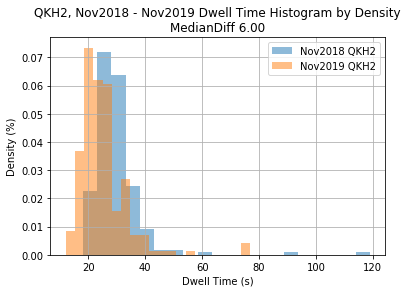

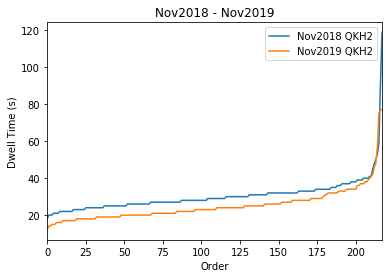


Platform Name RD02

Platform Name RD04
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    864.000000
mean      26.981481
std        6.581489
min       15.000000
25%       23.000000
50%       26.000000
75%       30.000000
max       89.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    864.000000
mean      25.164352
std        7.111157
min       15.000000
25%       22.000000
50%       24.000000
75%       27.000000
max       99.000000
Name: time, dtype: float64
KS two-sample test pValue 3.569262281034759e-10
Dwell Time Increase IS Signficiant


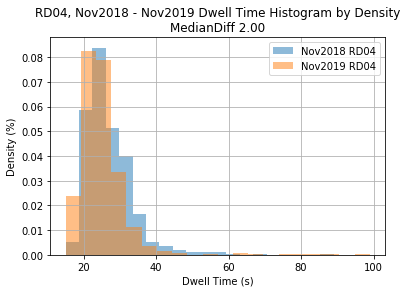

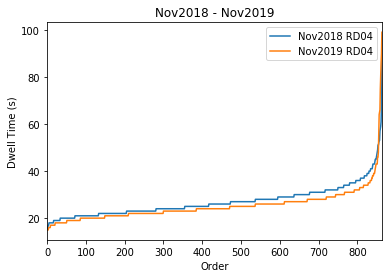


Platform Name RD06
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    315.000000
mean      28.841270
std        7.310681
min       16.000000
25%       24.000000
50%       28.000000
75%       31.000000
max       67.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    315.000000
mean      25.358730
std        6.895596
min       15.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       71.000000
Name: time, dtype: float64
KS two-sample test pValue 5.475903025229494e-12
Dwell Time Increase IS Signficiant


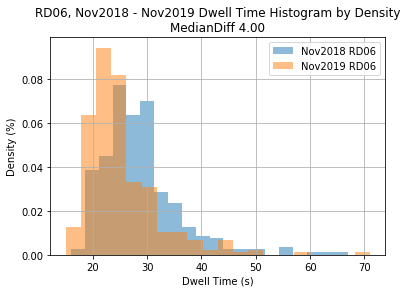

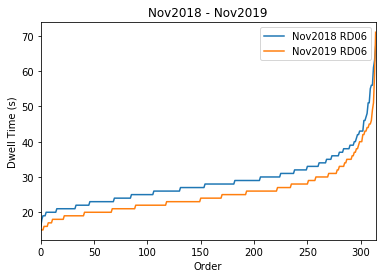


Platform Name RD08
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    177.000000
mean      34.214689
std        8.841355
min       19.000000
25%       27.000000
50%       33.000000
75%       40.000000
max       62.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    177.000000
mean      30.225989
std        9.466136
min       12.000000
25%       23.000000
50%       29.000000
75%       38.000000
max       66.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0008448458435856266
Dwell Time Increase IS Signficiant


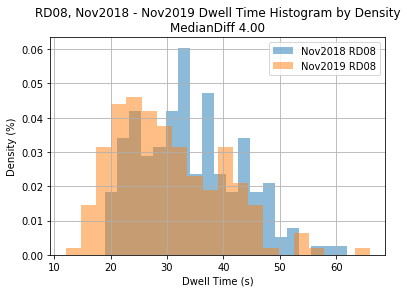

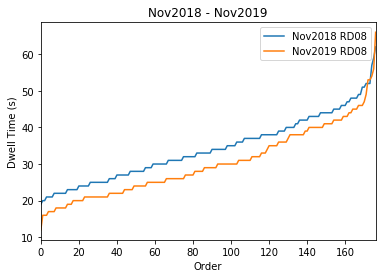


Platform Name RD10

Platform Name RDS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    259.000000
mean      27.181467
std        6.057371
min       17.000000
25%       23.000000
50%       26.000000
75%       30.000000
max       68.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    259.000000
mean      26.567568
std        7.757359
min       14.000000
25%       22.000000
50%       25.000000
75%       30.000000
max       78.000000
Name: time, dtype: float64
KS two-sample test pValue 0.061861919733130315
Dwell Time Increase NOT Signficiant


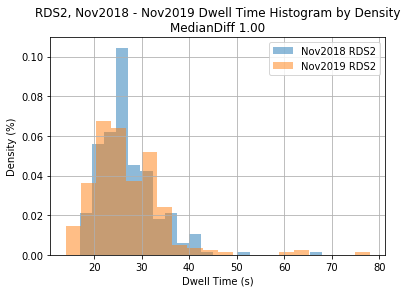

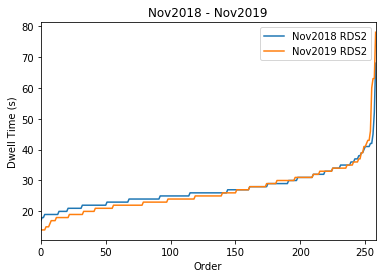


Platform Name RDS3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     41.000000
mean      38.463415
std       16.132417
min       25.000000
25%       32.000000
50%       34.000000
75%       39.000000
max      108.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     41.000000
mean      40.317073
std       18.162377
min       22.000000
25%       30.000000
50%       36.000000
75%       40.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9256519492948191
Dwell Time Decrease NOT Signficiant


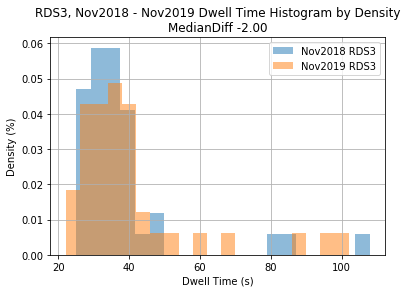

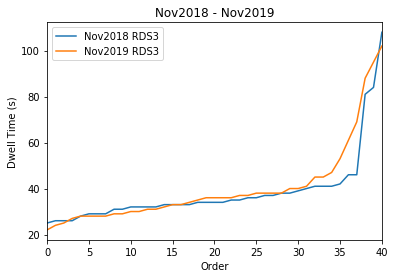


Platform Name RIC2

Platform Name RIV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    103.000000
mean      52.067961
std       26.610577
min       19.000000
25%       31.000000
50%       43.000000
75%       67.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    103.000000
mean      44.563107
std       29.893494
min       13.000000
25%       22.500000
50%       31.000000
75%       62.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0009332084653078591
Dwell Time Increase IS Signficiant


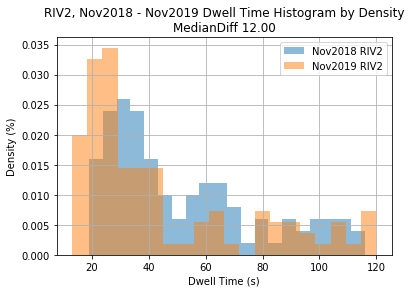

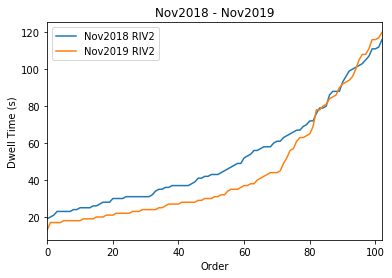


Platform Name RPK2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    104.000000
mean      30.980769
std       14.784524
min       15.000000
25%       20.000000
50%       25.000000
75%       36.250000
max       76.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    104.000000
mean      25.336538
std       11.402274
min       15.000000
25%       19.000000
50%       22.000000
75%       27.000000
max       96.000000
Name: time, dtype: float64
KS two-sample test pValue 0.02855881004453336
Dwell Time Increase IS Signficiant


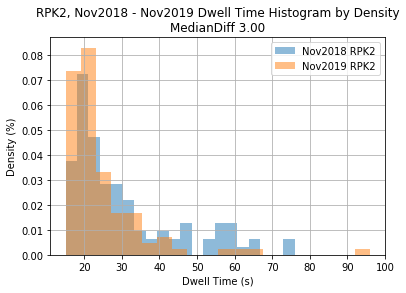

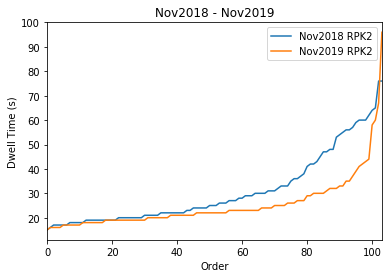


Platform Name RSV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    596.000000
mean      22.753356
std        5.306211
min       14.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       63.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    596.000000
mean      42.139262
std       18.585864
min       13.000000
25%       22.000000
50%       47.000000
75%       58.000000
max       87.000000
Name: time, dtype: float64
KS two-sample test pValue 1.328279382951424e-95
Dwell Time Decrease IS Signficiant


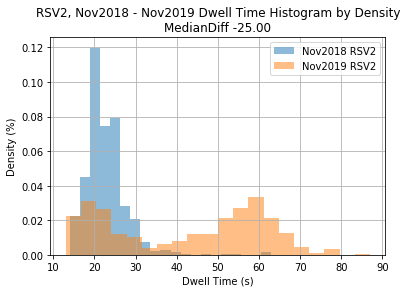

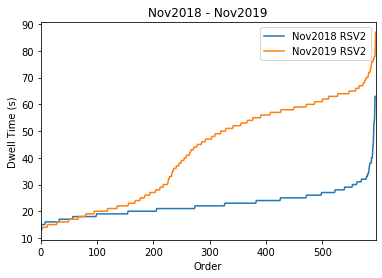


Platform Name RTY3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    69.000000
mean     26.449275
std       4.424319
min      17.000000
25%      24.000000
50%      25.000000
75%      29.000000
max      42.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    69.000000
mean     23.043478
std       6.511155
min      14.000000
25%      19.000000
50%      22.000000
75%      25.000000
max      49.000000
Name: time, dtype: float64
KS two-sample test pValue 1.1998304029155625e-06
Dwell Time Increase IS Signficiant


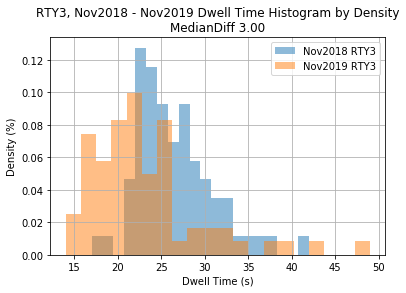

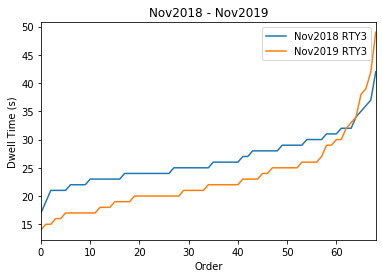


Platform Name RTY4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    291.000000
mean      29.247423
std        9.968603
min       15.000000
25%       22.500000
50%       27.000000
75%       32.500000
max       89.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    291.000000
mean      29.577320
std       11.738679
min       15.000000
25%       21.000000
50%       25.000000
75%       36.000000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 0.07354344003847704
Dwell Time Increase NOT Signficiant


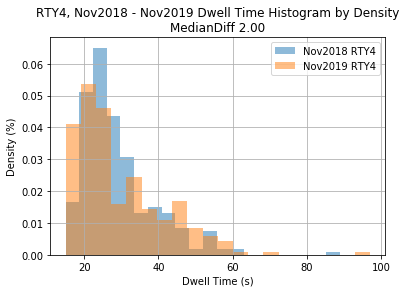

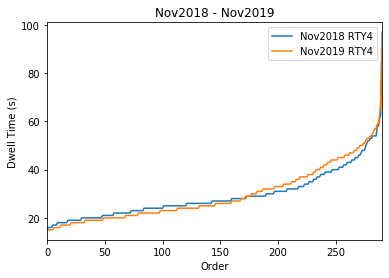


Platform Name RVS2

Platform Name RVS3

Platform Name RVS4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    124.000000
mean      38.088710
std       13.551475
min       22.000000
25%       28.750000
50%       34.500000
75%       42.250000
max       95.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    124.000000
mean      38.330645
std       15.740126
min       15.000000
25%       25.000000
50%       34.000000
75%       49.250000
max       81.000000
Name: time, dtype: float64
KS two-sample test pValue 0.01901699488491434
Dwell Time Increase IS Signficiant


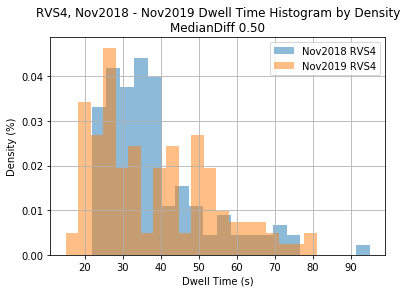

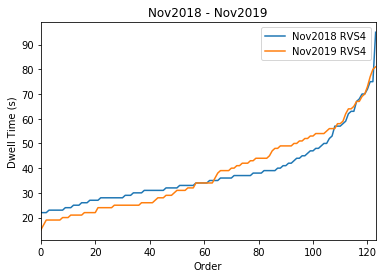


Platform Name RWD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    151.000000
mean      45.278146
std       13.803458
min       19.000000
25%       33.500000
50%       48.000000
75%       55.000000
max       88.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    151.000000
mean      43.887417
std       15.448212
min       13.000000
25%       31.500000
50%       47.000000
75%       56.000000
max       76.000000
Name: time, dtype: float64
KS two-sample test pValue 0.44678282890641
Dwell Time Increase NOT Signficiant


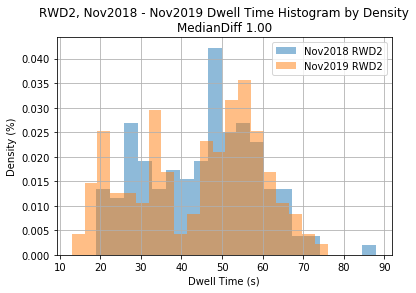

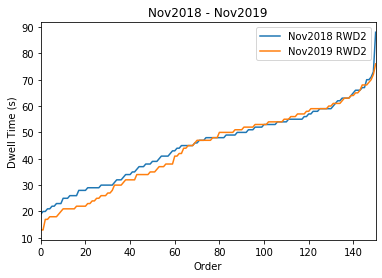


Platform Name SCO1

Platform Name SCO2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    136.000000
mean      26.904412
std        6.331437
min       16.000000
25%       23.750000
50%       26.000000
75%       28.000000
max       54.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    136.000000
mean      25.507353
std       14.118019
min       14.000000
25%       19.000000
50%       21.000000
75%       26.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 2.9971369858023867e-09
Dwell Time Increase IS Signficiant


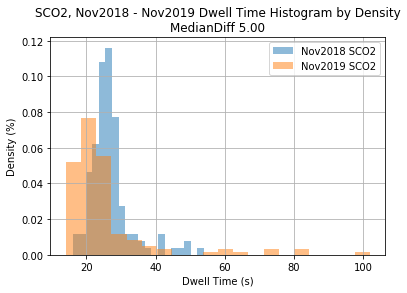

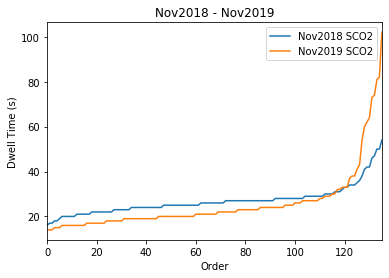


Platform Name SD08

Platform Name SD10

Platform Name SD11

Platform Name SD12

Platform Name SDT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    297.000000
mean      31.606061
std        7.634140
min       17.000000
25%       26.000000
50%       30.000000
75%       36.000000
max       63.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    297.000000
mean      30.053872
std        8.560030
min       16.000000
25%       24.000000
50%       29.000000
75%       34.000000
max       63.000000
Name: time, dtype: float64
KS two-sample test pValue 0.015391876689477644
Dwell Time Increase IS Signficiant


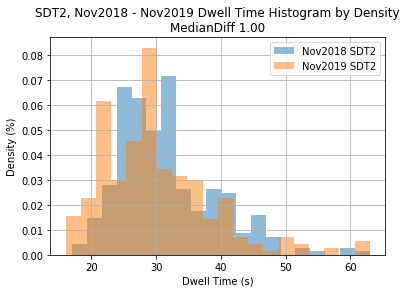

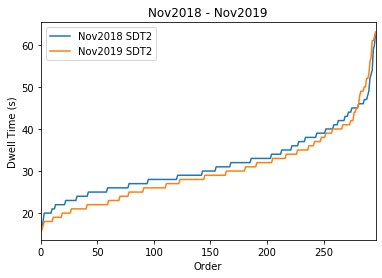


Platform Name SFT2

Platform Name SIT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    310.000000
mean      24.832258
std        4.919835
min       14.000000
25%       21.000000
50%       24.000000
75%       27.000000
max       47.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    310.000000
mean      24.154839
std        5.389240
min       14.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       43.000000
Name: time, dtype: float64
KS two-sample test pValue 0.03836909777674115
Dwell Time Increase IS Signficiant


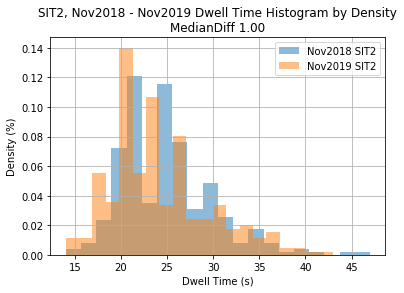

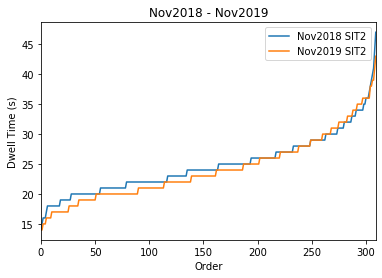


Platform Name SMH3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    155.000000
mean      29.916129
std        6.502702
min       18.000000
25%       26.000000
50%       29.000000
75%       34.000000
max       60.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    155.000000
mean      32.174194
std        9.712188
min       14.000000
25%       24.500000
50%       31.000000
75%       39.000000
max       57.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0017231858132481799
Dwell Time Decrease IS Signficiant


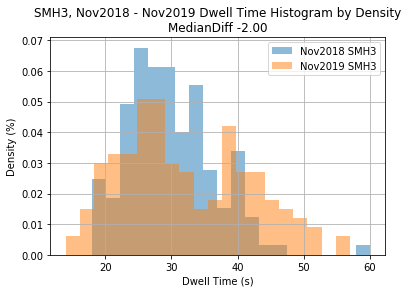

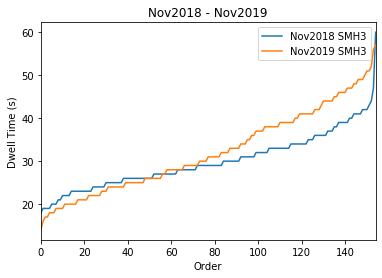


Platform Name SMR3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    160.000000
mean      26.362500
std        8.711655
min       18.000000
25%       22.750000
50%       25.000000
75%       28.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    160.000000
mean      22.712500
std        4.685569
min       14.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       45.000000
Name: time, dtype: float64
KS two-sample test pValue 1.7189042607255377e-06
Dwell Time Increase IS Signficiant


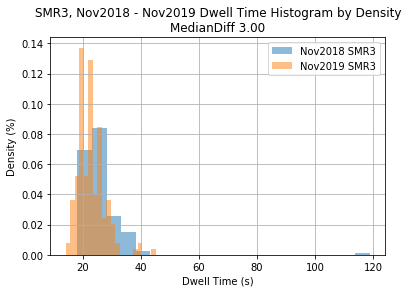

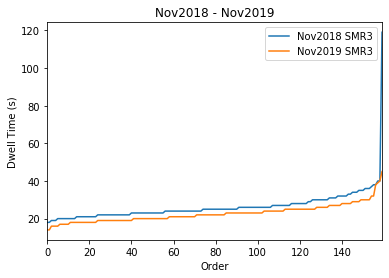


Platform Name STJ1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    336.000000
mean      34.491071
std        9.450890
min       15.000000
25%       26.000000
50%       35.000000
75%       41.250000
max       60.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    336.000000
mean      33.889881
std        9.519646
min       14.000000
25%       26.000000
50%       34.000000
75%       41.000000
max       64.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8919344183797514
Dwell Time Increase NOT Signficiant


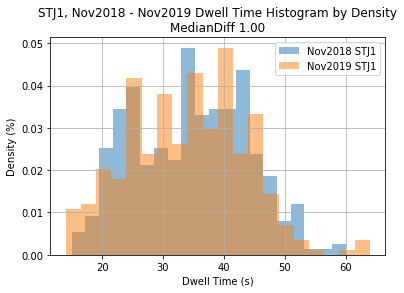

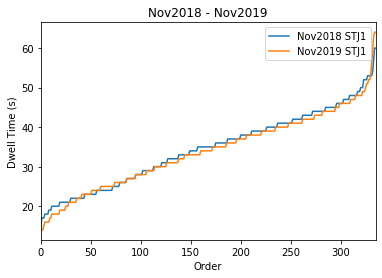


Platform Name STL3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    783.000000
mean      34.444444
std       16.817105
min       14.000000
25%       23.000000
50%       28.000000
75%       39.000000
max       94.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    783.000000
mean      29.229885
std       13.154143
min       14.000000
25%       21.000000
50%       25.000000
75%       33.000000
max       90.000000
Name: time, dtype: float64
KS two-sample test pValue 1.0402911894546708e-08
Dwell Time Increase IS Signficiant


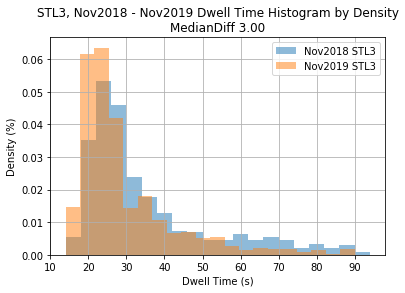

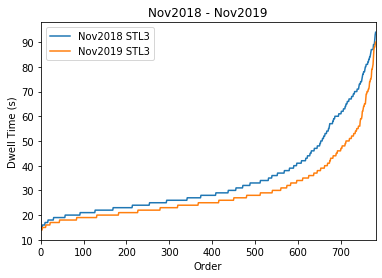


Platform Name STM3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    65.000000
mean     30.461538
std       5.615483
min      21.000000
25%      27.000000
50%      30.000000
75%      33.000000
max      51.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     65.000000
mean      29.169231
std       14.326079
min       13.000000
25%       20.000000
50%       26.000000
75%       32.000000
max      103.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0010683738044752586
Dwell Time Increase IS Signficiant


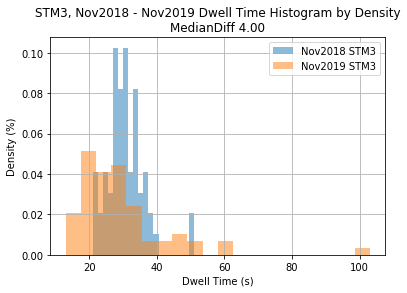

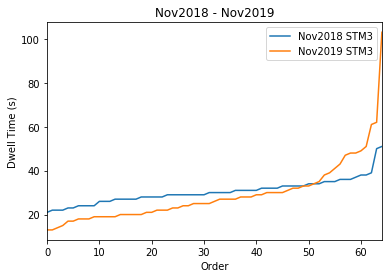


Platform Name STM4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    274.00000
mean      34.30292
std       13.22389
min       17.00000
25%       26.00000
50%       31.00000
75%       38.00000
max      114.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    274.000000
mean      33.656934
std       16.017133
min       15.000000
25%       23.000000
50%       30.000000
75%       38.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 0.007699315494184046
Dwell Time Increase IS Signficiant


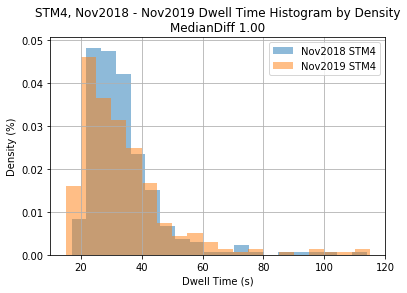

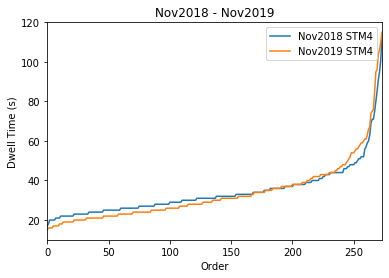


Platform Name STP2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    161.000000
mean      25.677019
std        4.673867
min       17.000000
25%       23.000000
50%       25.000000
75%       28.000000
max       52.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    161.000000
mean      21.577640
std        5.500727
min       12.000000
25%       18.000000
50%       20.000000
75%       25.000000
max       47.000000
Name: time, dtype: float64
KS two-sample test pValue 4.755787219102053e-14
Dwell Time Increase IS Signficiant


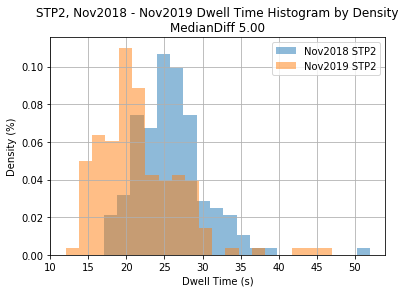

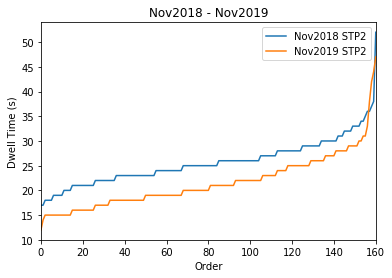


Platform Name STR1

Platform Name STR2

Platform Name STR3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     93.000000
mean      53.268817
std       25.115879
min       22.000000
25%       32.000000
50%       47.000000
75%       71.000000
max      112.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     93.000000
mean      51.569892
std       24.209412
min       20.000000
25%       29.000000
50%       45.000000
75%       70.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9565271698622467
Dwell Time Increase NOT Signficiant


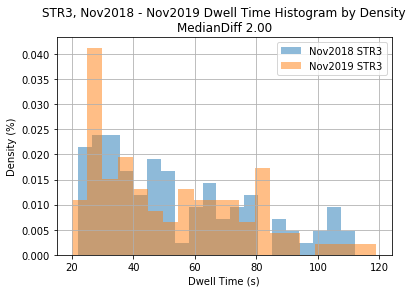

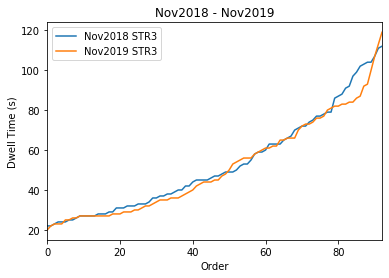


Platform Name STR6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    755.000000
mean      38.798675
std       13.928645
min       20.000000
25%       30.000000
50%       35.000000
75%       43.000000
max      105.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    755.000000
mean      38.769536
std       17.891283
min       16.000000
25%       27.000000
50%       33.000000
75%       43.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 2.5132464702606506e-08
Dwell Time Increase IS Signficiant


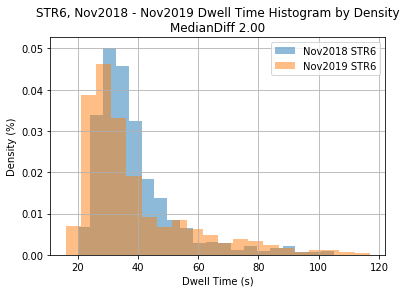

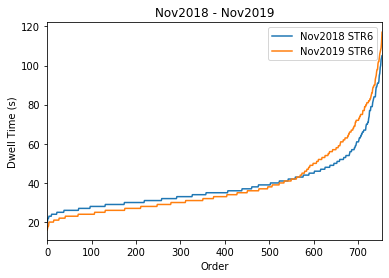


Platform Name STR8
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    298.000000
mean      41.684564
std       15.240645
min       20.000000
25%       30.000000
50%       38.000000
75%       51.750000
max      101.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    298.000000
mean      46.936242
std       16.003555
min       17.000000
25%       33.000000
50%       48.000000
75%       59.000000
max      104.000000
Name: time, dtype: float64
KS two-sample test pValue 5.175012622995872e-07
Dwell Time Decrease IS Signficiant


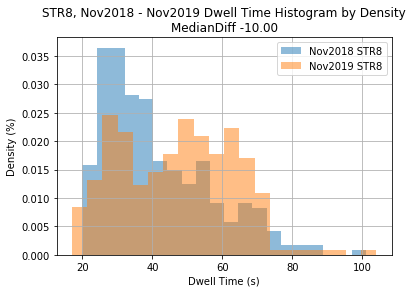

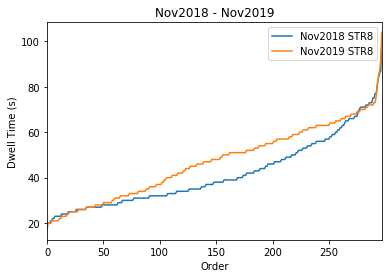


Platform Name SVH1

Platform Name SVH3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    152.000000
mean      35.967105
std       11.892130
min       19.000000
25%       27.000000
50%       34.000000
75%       40.250000
max       89.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    152.000000
mean      40.019737
std       22.934826
min       15.000000
25%       24.000000
50%       30.000000
75%       51.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.007786884123399373
Dwell Time Increase IS Signficiant


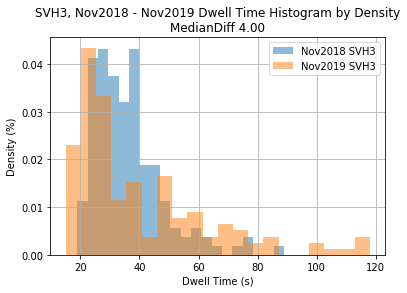

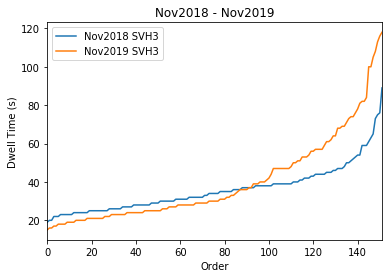


Platform Name SVH4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    420.000000
mean      32.814286
std       13.270952
min       16.000000
25%       25.000000
50%       29.000000
75%       37.000000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    420.00000
mean      35.32619
std       22.60654
min       15.00000
25%       22.00000
50%       26.00000
75%       37.00000
max      115.00000
Name: time, dtype: float64
KS two-sample test pValue 5.878015117143107e-06
Dwell Time Increase IS Signficiant


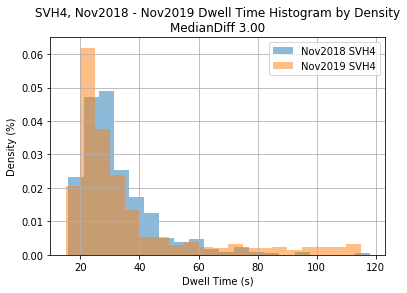

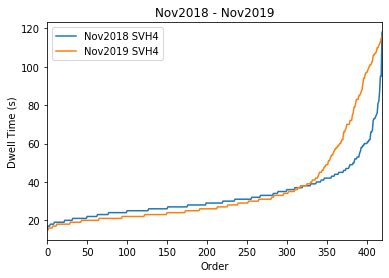


Platform Name SYD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    177.000000
mean      27.451977
std        8.009172
min       18.000000
25%       23.000000
50%       25.000000
75%       29.000000
max       64.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    177.000000
mean      24.728814
std        7.722084
min       15.000000
25%       20.000000
50%       23.000000
75%       26.000000
max       67.000000
Name: time, dtype: float64
KS two-sample test pValue 3.8641243621066776e-07
Dwell Time Increase IS Signficiant


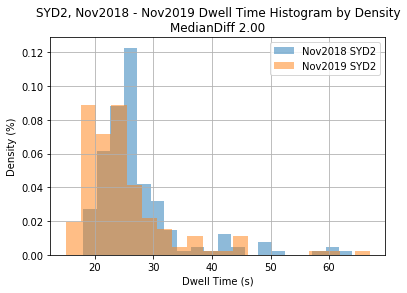

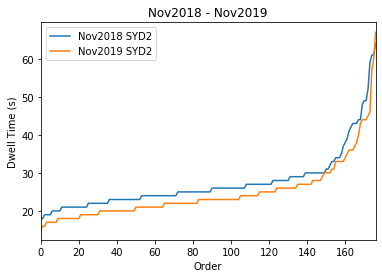


Platform Name TGB1

Platform Name TGB3

Platform Name TGB4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    215.000000
mean      23.613953
std        6.496210
min       15.000000
25%       19.000000
50%       22.000000
75%       26.000000
max       71.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    215.000000
mean      23.841860
std        8.672823
min       14.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       69.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5132614884955067
Dwell Time Decrease NOT Signficiant


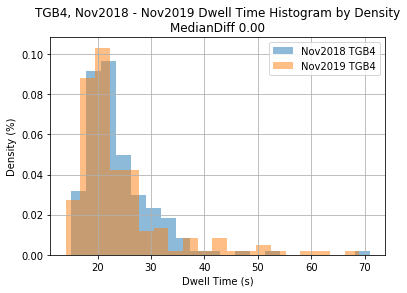

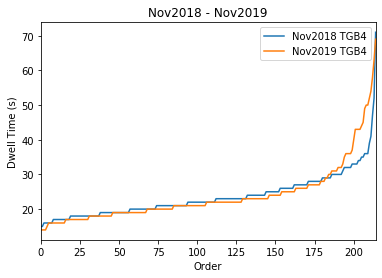


Platform Name THL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    347.000000
mean      59.100865
std       14.245319
min       28.000000
25%       47.500000
50%       61.000000
75%       69.500000
max      114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    347.000000
mean      57.853026
std       15.259178
min       20.000000
25%       47.000000
50%       61.000000
75%       69.000000
max      116.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5494429034015375
Dwell Time Decrease NOT Signficiant


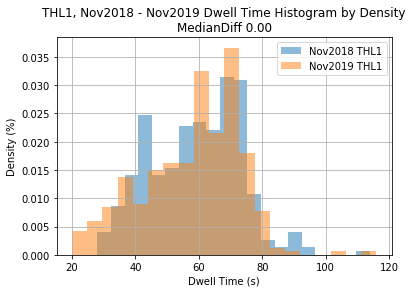

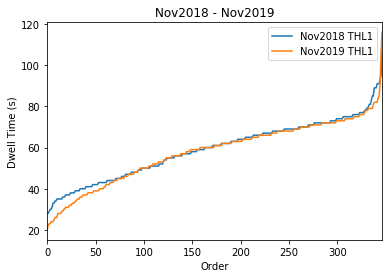


Platform Name THL3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    851.00000
mean      35.33960
std        9.92779
min       19.00000
25%       29.00000
50%       33.00000
75%       39.00000
max       94.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    851.000000
mean      35.278496
std       12.232214
min       17.000000
25%       27.000000
50%       33.000000
75%       40.000000
max       94.000000
Name: time, dtype: float64
KS two-sample test pValue 6.097700681872742e-05
Dwell Time Decrease IS Signficiant


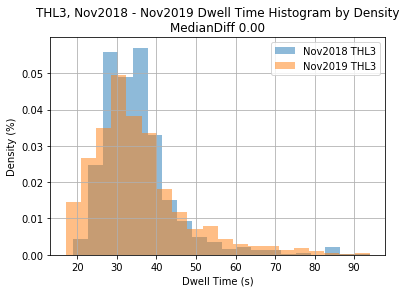

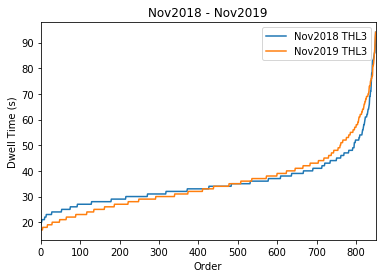


Platform Name THR3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    282.000000
mean      23.968085
std        7.138865
min       15.000000
25%       20.000000
50%       22.000000
75%       25.750000
max       73.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    282.000000
mean      26.262411
std       10.207558
min       13.000000
25%       18.000000
50%       22.500000
75%       34.000000
max       85.000000
Name: time, dtype: float64
KS two-sample test pValue 8.128438593280649e-06
Dwell Time Decrease IS Signficiant


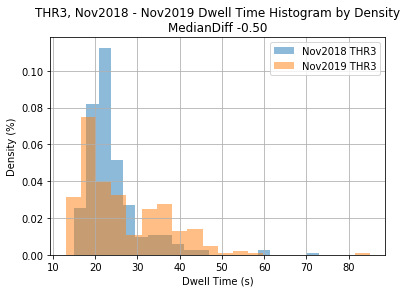

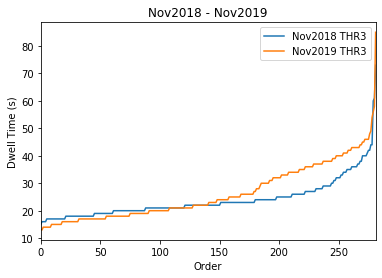


Platform Name TRL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    151.000000
mean      20.463576
std        4.702871
min       14.000000
25%       18.000000
50%       20.000000
75%       22.000000
max       57.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    151.000000
mean      18.662252
std        3.494543
min       13.000000
25%       17.000000
50%       18.000000
75%       20.000000
max       43.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00013094755362641283
Dwell Time Increase IS Signficiant


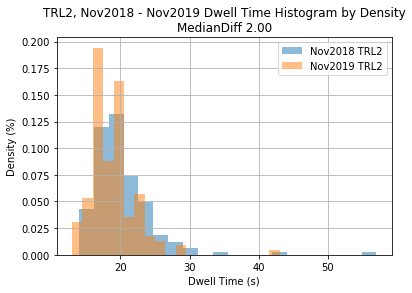

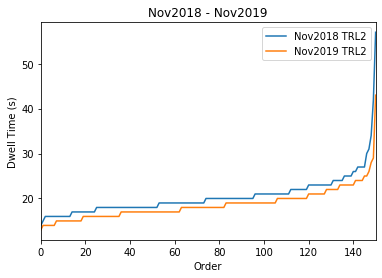


Platform Name TUR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    417.000000
mean      29.995204
std       10.845505
min       16.000000
25%       24.000000
50%       28.000000
75%       32.000000
max      111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    417.000000
mean      23.983213
std        6.586131
min       12.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       66.000000
Name: time, dtype: float64
KS two-sample test pValue 1.298636517823811e-20
Dwell Time Increase IS Signficiant


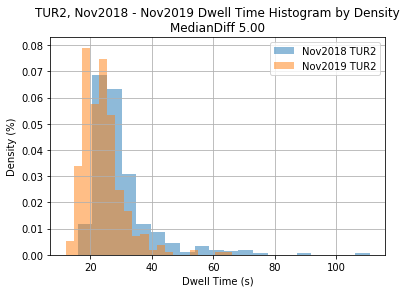

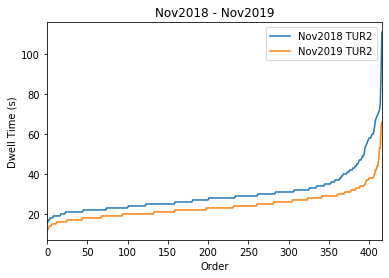


Platform Name VLW2

Platform Name VNY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    154.000000
mean      26.928571
std       15.138190
min       13.000000
25%       18.000000
50%       20.000000
75%       28.000000
max       83.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    154.000000
mean      26.759740
std       17.374407
min       12.000000
25%       16.000000
50%       18.000000
75%       30.500000
max       82.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0006722539413747523
Dwell Time Increase IS Signficiant


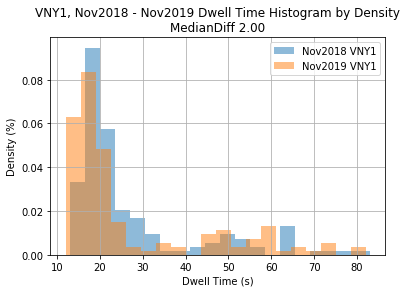

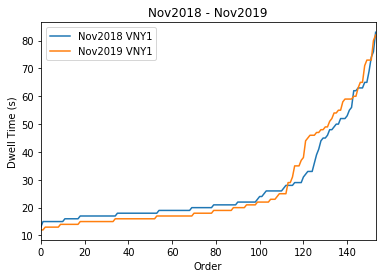


Platform Name WAH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    360.000000
mean      25.458333
std        6.589723
min       15.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       61.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    360.000000
mean      24.697222
std        7.579844
min       12.000000
25%       19.000000
50%       23.000000
75%       29.000000
max       59.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0005954836060249598
Dwell Time Increase IS Signficiant


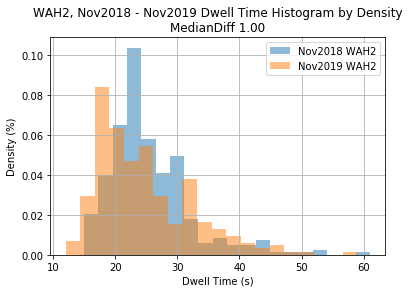

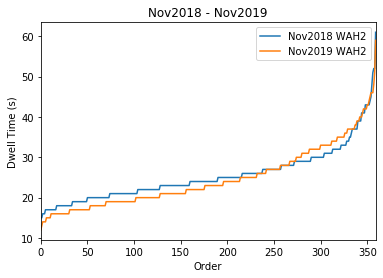


Platform Name WAI2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    406.000000
mean      35.775862
std       15.510618
min       17.000000
25%       25.000000
50%       30.000000
75%       41.750000
max       90.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    406.000000
mean      26.652709
std       13.183045
min       12.000000
25%       19.250000
50%       23.000000
75%       28.000000
max       99.000000
Name: time, dtype: float64
KS two-sample test pValue 2.0875632768537156e-26
Dwell Time Increase IS Signficiant


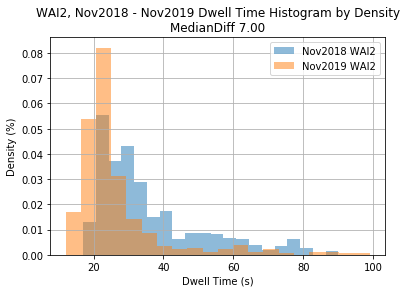

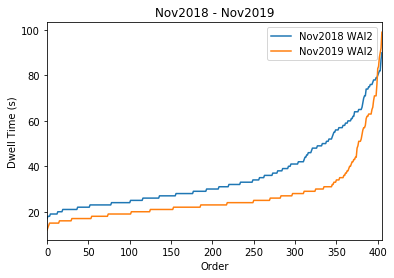


Platform Name WAV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    715.000000
mean      21.405594
std        4.488138
min       14.000000
25%       18.000000
50%       21.000000
75%       23.000000
max       51.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    715.000000
mean      19.669930
std        4.189172
min       11.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       58.000000
Name: time, dtype: float64
KS two-sample test pValue 2.8212983493218085e-13
Dwell Time Increase IS Signficiant


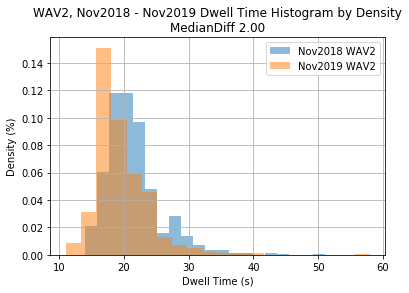

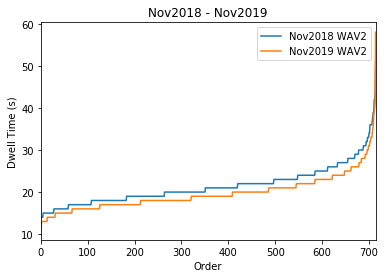


Platform Name WCI2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    307.000000
mean      43.247557
std       17.300420
min       17.000000
25%       30.000000
50%       38.000000
75%       54.000000
max      110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    307.000000
mean      43.416938
std       17.624314
min       16.000000
25%       29.000000
50%       40.000000
75%       58.000000
max       92.000000
Name: time, dtype: float64
KS two-sample test pValue 0.15560556410514864
Dwell Time Decrease NOT Signficiant


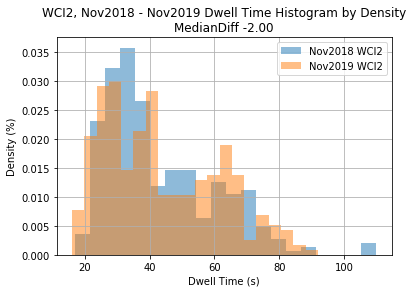

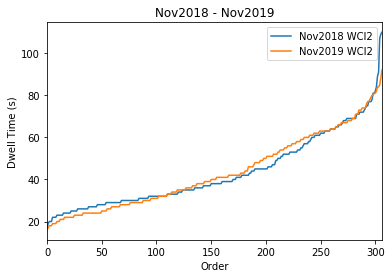


Platform Name WIN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    152.000000
mean      30.776316
std       10.892732
min       17.000000
25%       25.000000
50%       27.000000
75%       34.000000
max       91.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    152.000000
mean      26.144737
std       11.167246
min       14.000000
25%       20.000000
50%       23.000000
75%       28.000000
max       91.000000
Name: time, dtype: float64
KS two-sample test pValue 6.514874802309597e-09
Dwell Time Increase IS Signficiant


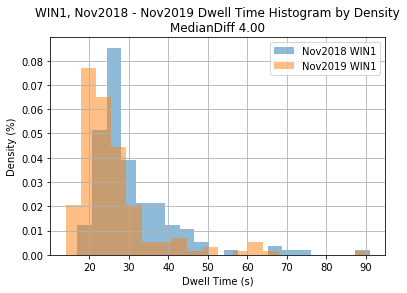

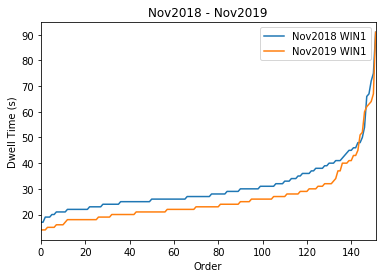


Platform Name WKF2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    279.000000
mean      23.401434
std        8.572383
min       14.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    279.000000
mean      24.215054
std       11.155393
min       12.000000
25%       18.000000
50%       20.000000
75%       26.000000
max       95.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0009957052979697517
Dwell Time Increase IS Signficiant


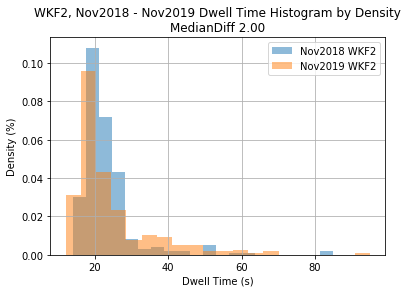

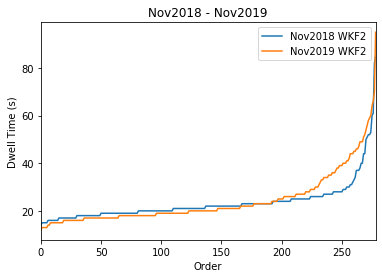


Platform Name WLS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    708.000000
mean      21.956215
std        4.328721
min       13.000000
25%       19.000000
50%       21.000000
75%       24.000000
max       45.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    708.000000
mean      20.306497
std        4.761718
min       11.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       71.000000
Name: time, dtype: float64
KS two-sample test pValue 2.84753268753292e-15
Dwell Time Increase IS Signficiant


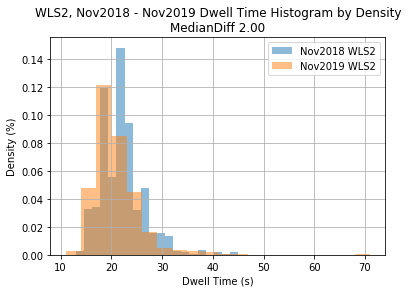

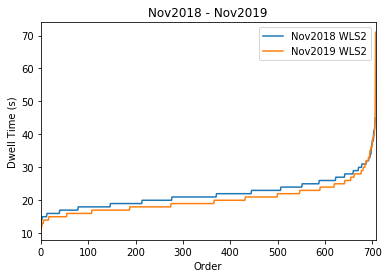


Platform Name WLY2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    148.000000
mean      27.189189
std        7.059852
min       16.000000
25%       22.000000
50%       25.000000
75%       32.250000
max       46.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    148.000000
mean      28.804054
std        8.698783
min       13.000000
25%       22.000000
50%       28.000000
75%       35.000000
max       70.000000
Name: time, dtype: float64
KS two-sample test pValue 0.04065242157583331
Dwell Time Decrease IS Signficiant


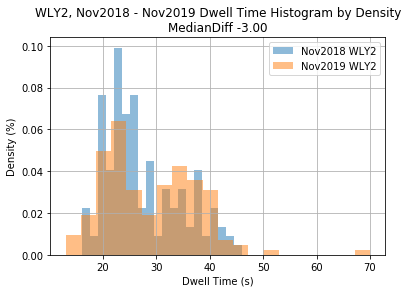

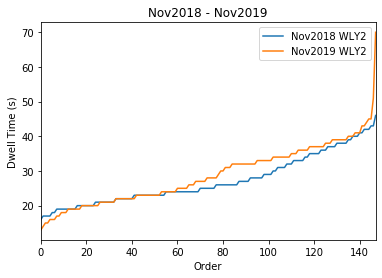


Platform Name WMD1

Platform Name WMD3

Platform Name WMD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    421.000000
mean      29.054632
std        8.920248
min       13.000000
25%       22.000000
50%       28.000000
75%       34.000000
max       72.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    421.000000
mean      28.482185
std        9.503523
min       15.000000
25%       22.000000
50%       26.000000
75%       33.000000
max      105.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0647384998297862
Dwell Time Increase NOT Signficiant


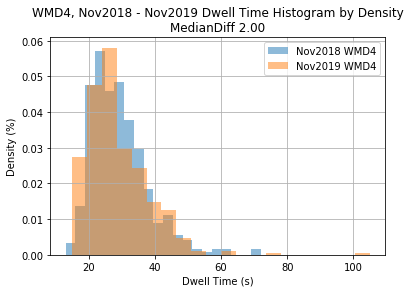

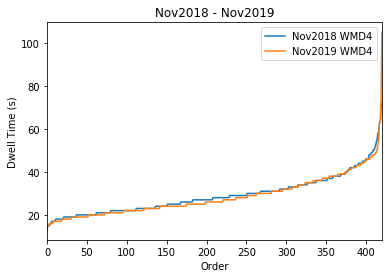


Platform Name WRD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    324.000000
mean      26.626543
std        6.061044
min       17.000000
25%       23.000000
50%       26.000000
75%       29.000000
max       70.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    324.000000
mean      24.067901
std        5.455848
min       14.000000
25%       21.000000
50%       23.000000
75%       26.000000
max       72.000000
Name: time, dtype: float64
KS two-sample test pValue 1.1651958196797031e-06
Dwell Time Increase IS Signficiant


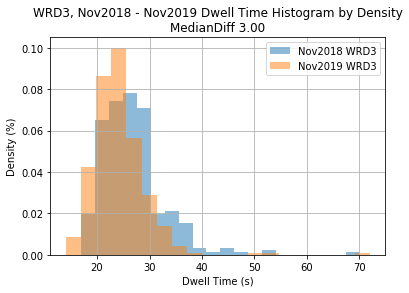

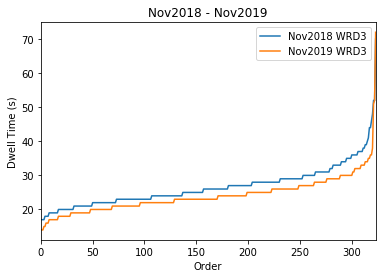


Platform Name WRG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    300.000000
mean      23.586667
std        7.107099
min       13.000000
25%       20.000000
50%       22.000000
75%       25.000000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    300.000000
mean      26.913333
std       15.885643
min       12.000000
25%       17.000000
50%       20.000000
75%       31.250000
max      104.000000
Name: time, dtype: float64
KS two-sample test pValue 4.324047665424968e-09
Dwell Time Increase IS Signficiant


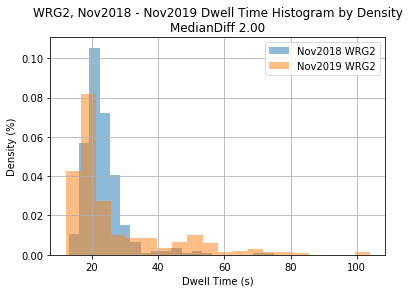

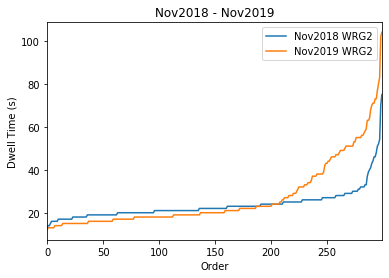


Platform Name WRW2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    355.000000
mean      21.107042
std        7.459482
min       13.000000
25%       18.000000
50%       20.000000
75%       22.000000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    355.000000
mean      19.892958
std        4.494797
min       13.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       47.000000
Name: time, dtype: float64
KS two-sample test pValue 0.01749324858028738
Dwell Time Increase IS Signficiant


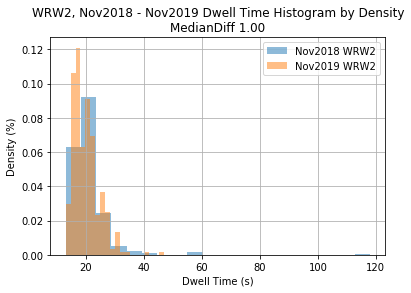

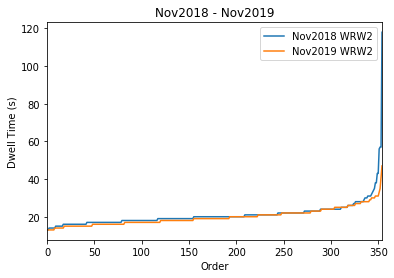


Platform Name WVL1

Platform Name WVL3

Platform Name WVL4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    237.000000
mean      26.759494
std        8.409864
min       16.000000
25%       22.000000
50%       25.000000
75%       29.000000
max       86.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    237.000000
mean      24.628692
std        8.282953
min       14.000000
25%       20.000000
50%       22.000000
75%       27.000000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00011448849956112899
Dwell Time Increase IS Signficiant


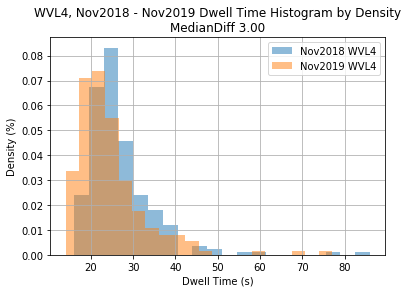

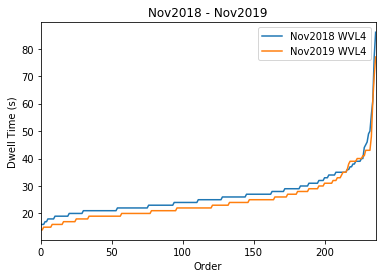


Platform Name WYN4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    861.000000
mean      41.665505
std       13.336942
min       18.000000
25%       31.000000
50%       39.000000
75%       50.000000
max      108.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    861.000000
mean      38.397213
std       14.347277
min       14.000000
25%       27.000000
50%       35.000000
75%       48.000000
max      112.000000
Name: time, dtype: float64
KS two-sample test pValue 8.665898858958386e-10
Dwell Time Increase IS Signficiant


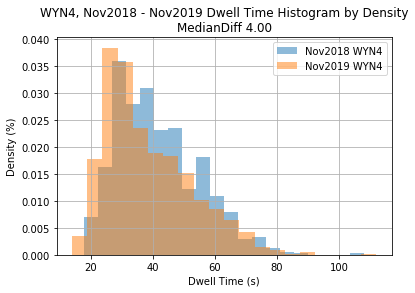

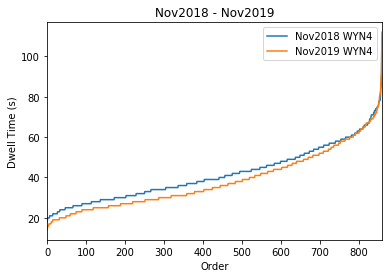


Platform Name WYN5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    336.000000
mean      53.116071
std       13.211311
min       25.000000
25%       44.000000
50%       55.000000
75%       63.250000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    336.000000
mean      51.934524
std       14.419986
min       17.000000
25%       41.000000
50%       55.000000
75%       63.000000
max       93.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6566993078218156
Dwell Time Decrease NOT Signficiant


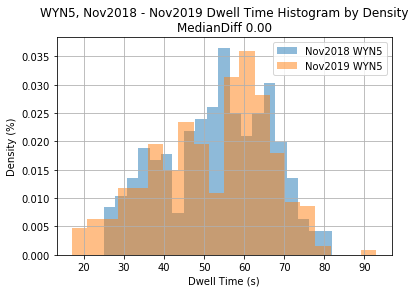

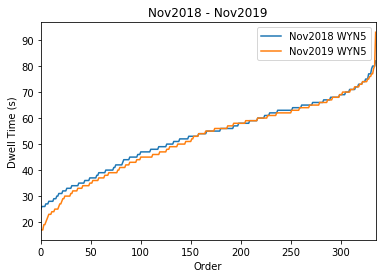


Platform Name YAG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    169.000000
mean      24.177515
std        8.417907
min       14.000000
25%       20.000000
50%       22.000000
75%       26.000000
max       80.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    169.000000
mean      22.171598
std        6.812988
min       14.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       66.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00961292405701525
Dwell Time Increase IS Signficiant


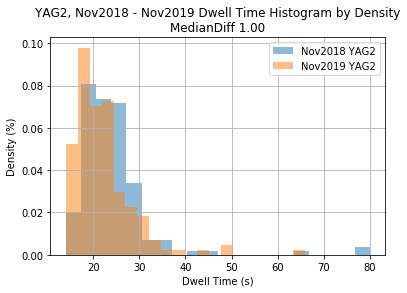

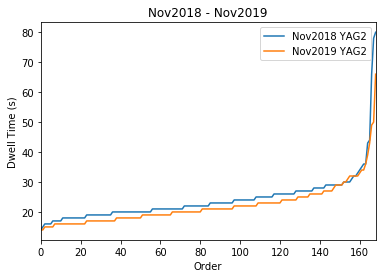


Platform Name YNN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    223.000000
mean      21.349776
std        9.184475
min       13.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       73.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    223.000000
mean      26.542601
std       14.037168
min       14.000000
25%       17.500000
50%       21.000000
75%       29.000000
max       78.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0010375892366583852
Dwell Time Decrease IS Signficiant


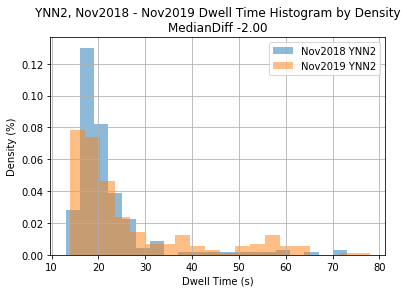

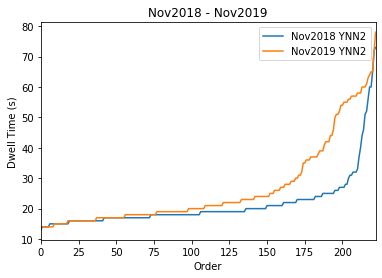



Num Significant Increase 93
Num Significant Decrease 29
Num Not Significant 34
==========Inc_Platform==========
['ASH5', 'AUB4', 'BCR2', 'BMO2', 'BRL2', 'BVH2', 'BWD4', 'BWD6', 'BXN2', 'CAB2', 'CBY2', 'CCQ1', 'CE16', 'CNV2', 'CRD3', 'CRD4', 'DNS3', 'DOO3', 'DOO4', 'EHL3', 'ERC1', 'ERS2', 'EWD3', 'FLD2', 'GLD2', 'GQU2', 'GVL4', 'HBY2', 'HLW2', 'HOM7', 'HPK4', 'HRL2', 'ING2', 'KGR2', 'KLR2', 'LCE2', 'LCE4', 'LDF3', 'LEW2', 'MCO2', 'MDB2', 'MDT3', 'MDT4', 'MIN2', 'MKG2', 'MKV2', 'MQF2', 'MSM1', 'MTC2', 'MUL2', 'MYG2', 'MYL2', 'NRW2', 'NSY4', 'PAD2', 'PET2', 'PUN2', 'PYM2', 'QKH2', 'RD04', 'RD06', 'RD08', 'RIV2', 'RPK2', 'RTY3', 'RVS4', 'SCO2', 'SDT2', 'SIT2', 'SMR3', 'STL3', 'STM3', 'STM4', 'STP2', 'STR6', 'SVH3', 'SVH4', 'SYD2', 'TRL2', 'TUR2', 'VNY1', 'WAH2', 'WAI2', 'WAV2', 'WIN1', 'WKF2', 'WLS2', 'WRD3', 'WRG2', 'WRW2', 'WVL4', 'WYN4', 'YAG2']
==========Dec_Platform==========
['ART2', 'ASQ2', 'BTN6', 'CE18', 'CHT2', 'CTN3', 'CWD4', 'CYD5', 'DHL2', 'EDP2', 'EPG2', 'EPG3', 'GFD4', 'GR

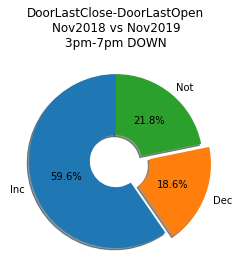

In [129]:
perform_analysis_door_open_close(data1_pm_down_sec, data2_pm_down_sec,'Nov2018', 'Nov2019', 'DoorLastClose-DoorLastOpen\nNov2018 vs Nov2019\n3pm-7pm DOWN')

## Others


Platform Name ART1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1997.000000
mean       19.895844
std         4.431528
min        10.000000
25%        17.000000
50%        19.000000
75%        22.000000
max        59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1997.000000
mean       20.610916
std         4.542754
min        12.000000
25%        18.000000
50%        20.000000
75%        23.000000
max        72.000000
Name: time, dtype: float64
KS two-sample test pValue 4.750293790840468e-09
Dwell Time Decrease IS Signficiant


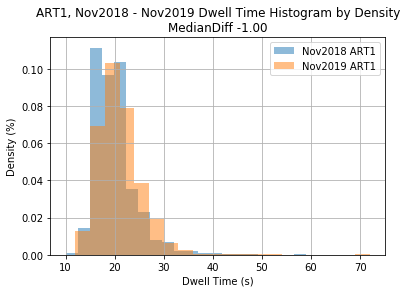

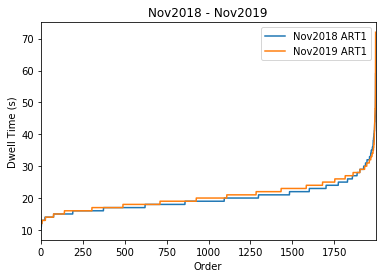


Platform Name ART2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1934.000000
mean       20.483454
std         4.457129
min        11.000000
25%        18.000000
50%        20.000000
75%        22.000000
max        78.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1934.000000
mean       30.931231
std        12.367996
min        13.000000
25%        21.000000
50%        26.000000
75%        41.000000
max        95.000000
Name: time, dtype: float64
KS two-sample test pValue 2.9923139144321638e-173
Dwell Time Decrease IS Signficiant


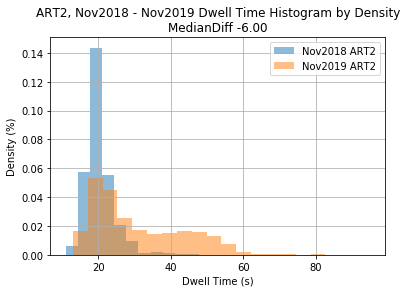

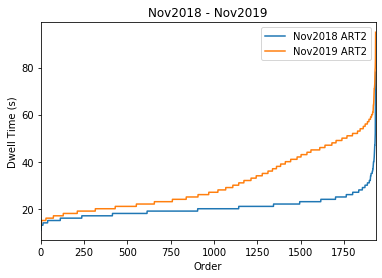


Platform Name ASH3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    869.000000
mean      26.521289
std        8.836251
min       12.000000
25%       22.000000
50%       25.000000
75%       29.000000
max      108.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    869.000000
mean      26.510932
std        6.408802
min       14.000000
25%       22.000000
50%       26.000000
75%       30.000000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 0.2378999665416104
Dwell Time Decrease NOT Signficiant


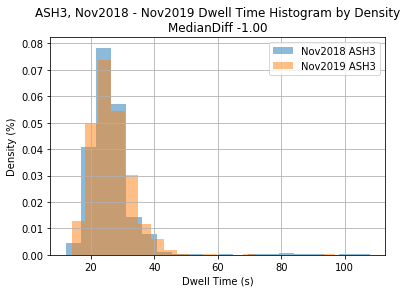

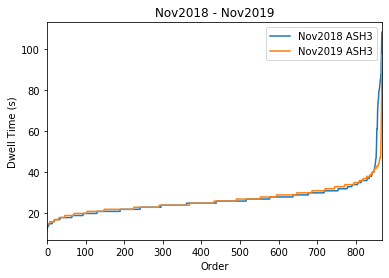


Platform Name ASH4

Platform Name ASH5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    857.000000
mean      25.735123
std        8.463561
min       14.000000
25%       22.000000
50%       24.000000
75%       28.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    857.000000
mean      28.429405
std        8.390163
min       15.000000
25%       23.000000
50%       27.000000
75%       31.000000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 8.494235101520405e-14
Dwell Time Decrease IS Signficiant


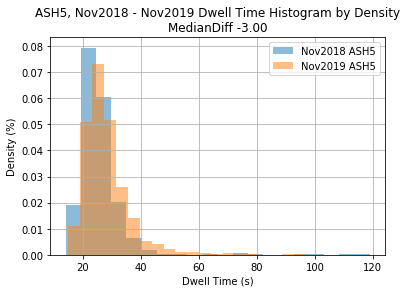

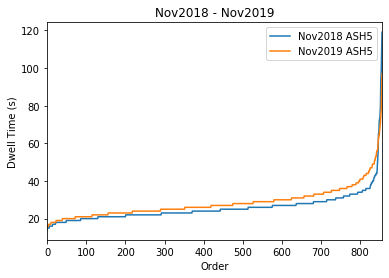


Platform Name ASQ1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    403.000000
mean      20.593052
std        6.236879
min       11.000000
25%       16.000000
50%       19.000000
75%       23.000000
max       49.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    403.000000
mean      21.650124
std        7.370046
min       11.000000
25%       17.000000
50%       20.000000
75%       24.000000
max       87.000000
Name: time, dtype: float64
KS two-sample test pValue 0.020283075832769115
Dwell Time Decrease IS Signficiant


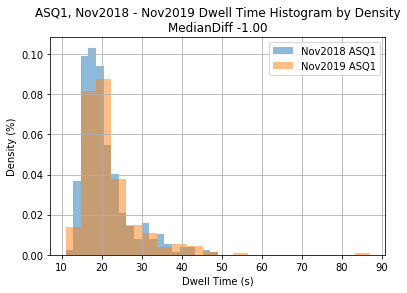

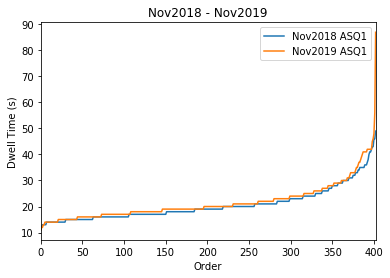


Platform Name ASQ2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    417.000000
mean      20.705036
std        6.615236
min       13.000000
25%       17.000000
50%       19.000000
75%       22.000000
max      111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    417.000000
mean      22.976019
std        6.842978
min       11.000000
25%       18.000000
50%       22.000000
75%       26.000000
max       74.000000
Name: time, dtype: float64
KS two-sample test pValue 4.143650340817585e-09
Dwell Time Decrease IS Signficiant


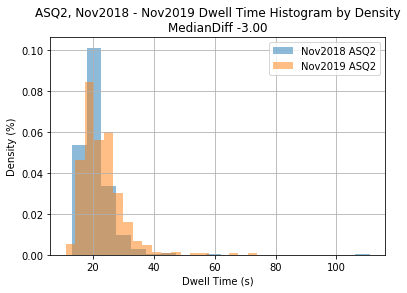

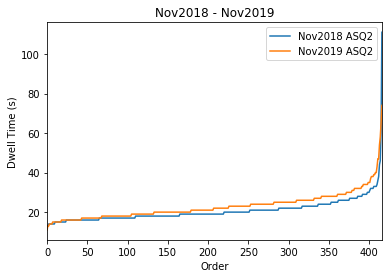


Platform Name AUB1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    47.000000
mean     29.276596
std      18.145190
min      13.000000
25%      19.000000
50%      22.000000
75%      29.000000
max      83.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    47.000000
mean     24.893617
std      12.157006
min      13.000000
25%      19.000000
50%      21.000000
75%      24.500000
max      70.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6800174807197423
Dwell Time Increase NOT Signficiant


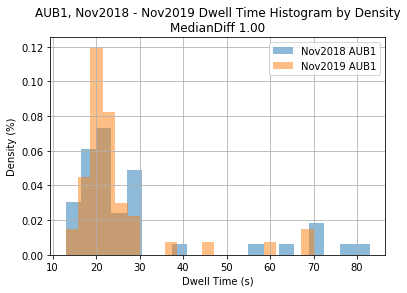

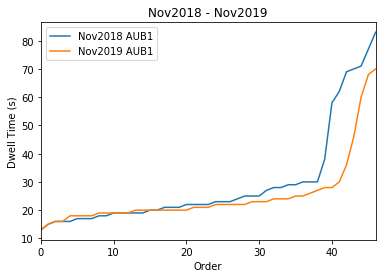


Platform Name AUB2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    90.000000
mean     30.688889
std      11.814716
min      15.000000
25%      22.000000
50%      27.000000
75%      36.000000
max      66.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     90.000000
mean      30.988889
std       14.803199
min       14.000000
25%       23.000000
50%       27.000000
75%       35.000000
max      114.000000
Name: time, dtype: float64
KS two-sample test pValue 0.871900195954173
Dwell Time Decrease NOT Signficiant


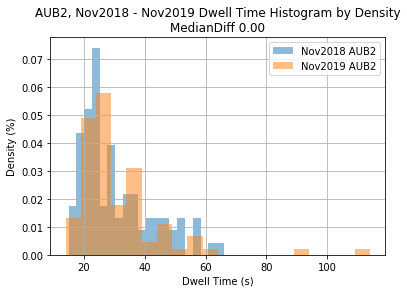

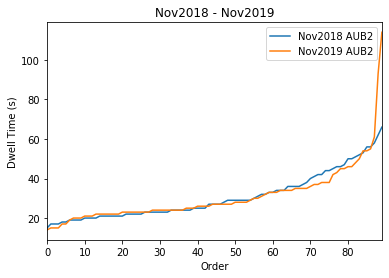


Platform Name AUB3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    798.000000
mean      33.086466
std       12.011132
min       11.000000
25%       23.000000
50%       31.000000
75%       42.000000
max       80.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    798.000000
mean      35.119048
std       11.896969
min       13.000000
25%       25.250000
50%       33.500000
75%       44.000000
max       87.000000
Name: time, dtype: float64
KS two-sample test pValue 0.002503807062588625
Dwell Time Decrease IS Signficiant


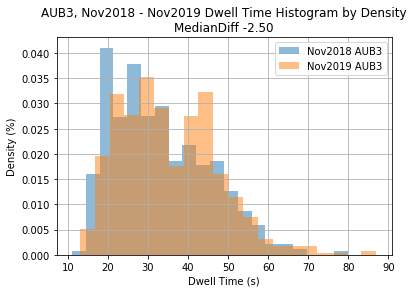

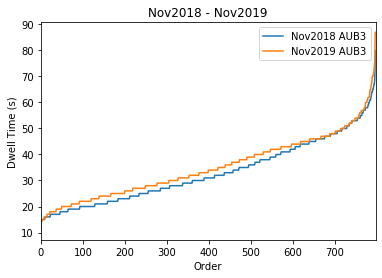


Platform Name AUB4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    824.000000
mean      26.683252
std        8.083279
min       16.000000
25%       22.000000
50%       25.000000
75%       29.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    824.000000
mean      27.938107
std        8.486702
min       16.000000
25%       23.000000
50%       26.000000
75%       31.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.002586632309971548
Dwell Time Decrease IS Signficiant


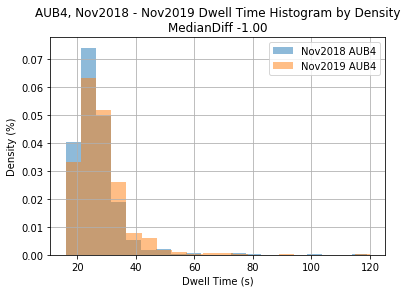

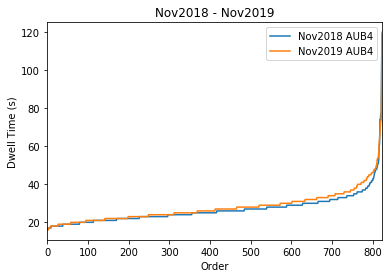


Platform Name BCR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    841.000000
mean      24.934602
std       11.081484
min       11.000000
25%       17.000000
50%       21.000000
75%       29.000000
max       69.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    841.000000
mean      27.202140
std       12.842528
min       11.000000
25%       18.000000
50%       22.000000
75%       34.000000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 0.005878100888073744
Dwell Time Decrease IS Signficiant


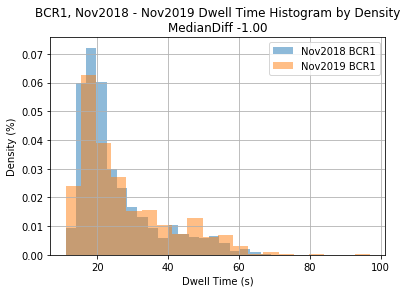

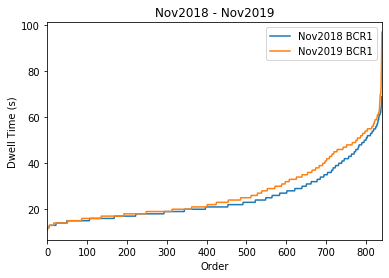


Platform Name BCR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    832.000000
mean      19.600962
std        4.888593
min       12.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    832.000000
mean      22.141827
std        8.314317
min       13.000000
25%       18.000000
50%       20.000000
75%       24.000000
max       71.000000
Name: time, dtype: float64
KS two-sample test pValue 6.50573820447023e-12
Dwell Time Decrease IS Signficiant


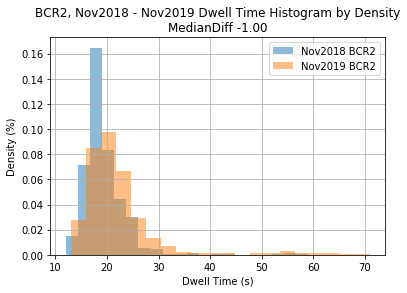

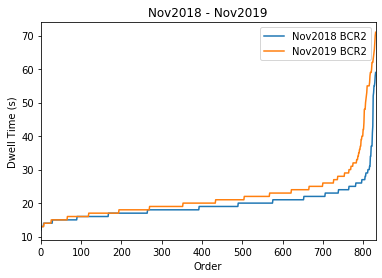


Platform Name BDP1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    488.000000
mean      21.034836
std        5.224804
min       11.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       55.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    488.000000
mean      20.883197
std        4.141824
min       12.000000
25%       18.000000
50%       20.500000
75%       23.000000
max       49.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4443102364571295
Dwell Time Decrease NOT Signficiant


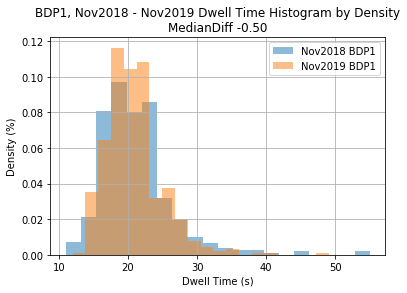

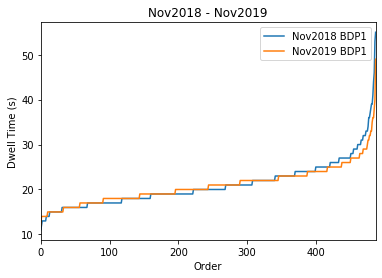


Platform Name BDP2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    443.000000
mean      37.304740
std       17.340081
min       12.000000
25%       20.000000
50%       37.000000
75%       53.000000
max       74.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    443.000000
mean      39.485327
std       16.232520
min       14.000000
25%       23.500000
50%       40.000000
75%       53.000000
max       96.000000
Name: time, dtype: float64
KS two-sample test pValue 0.01097560458461761
Dwell Time Decrease IS Signficiant


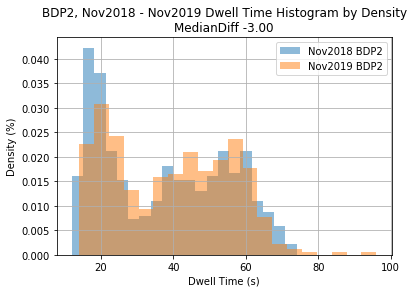

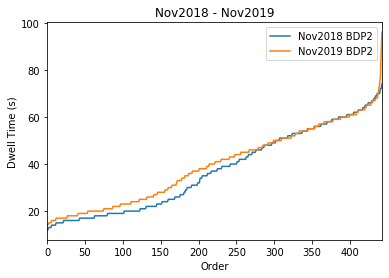


Platform Name BER2

Platform Name BIR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    572.00000
mean      21.68007
std        9.18085
min       11.00000
25%       17.00000
50%       19.00000
75%       23.00000
max      104.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    572.000000
mean      20.568182
std        5.777294
min       11.000000
25%       17.000000
50%       19.000000
75%       23.000000
max       73.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4544715689615938
Dwell Time Decrease NOT Signficiant


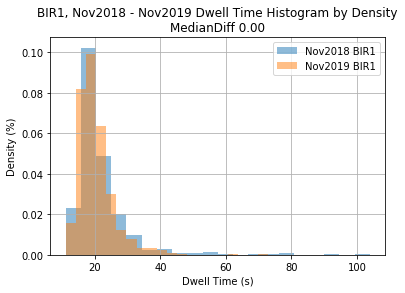

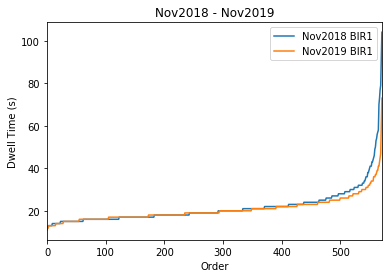


Platform Name BIR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    544.000000
mean      22.904412
std       11.719169
min       11.000000
25%       17.000000
50%       19.000000
75%       24.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    544.000000
mean      24.865809
std       14.780606
min       12.000000
25%       18.000000
50%       20.000000
75%       25.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.03442947072840082
Dwell Time Decrease IS Signficiant


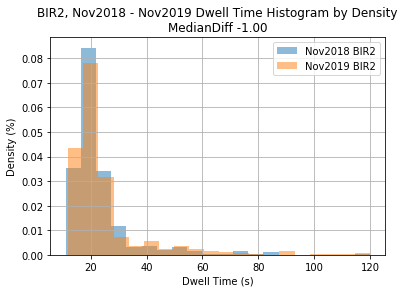

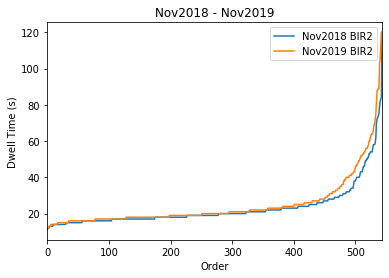


Platform Name BMO1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    509.000000
mean      20.730845
std        5.536231
min       12.000000
25%       17.000000
50%       20.000000
75%       23.000000
max       70.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    509.000000
mean      22.406680
std        8.244638
min       13.000000
25%       18.000000
50%       21.000000
75%       24.000000
max      110.000000
Name: time, dtype: float64
KS two-sample test pValue 9.77461489062923e-05
Dwell Time Decrease IS Signficiant


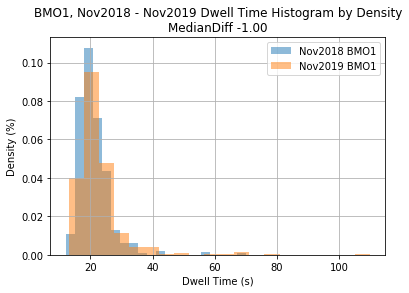

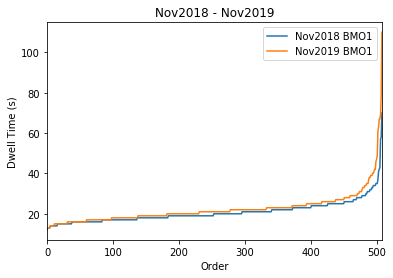


Platform Name BMO2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    509.000000
mean      21.239686
std        4.611428
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       51.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    509.000000
mean      23.593320
std        6.210674
min       13.000000
25%       20.000000
50%       23.000000
75%       26.000000
max       89.000000
Name: time, dtype: float64
KS two-sample test pValue 5.370602194831135e-12
Dwell Time Decrease IS Signficiant


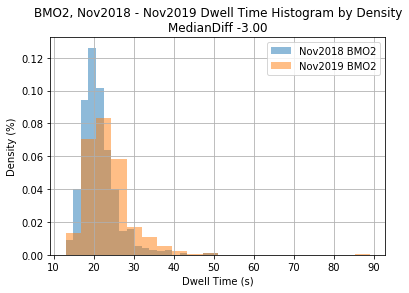

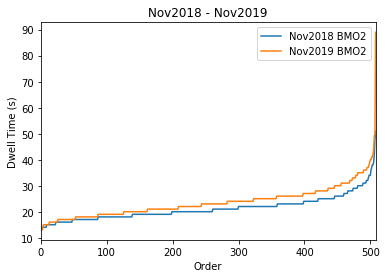


Platform Name BNK1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    243.000000
mean      52.333333
std       29.802657
min       12.000000
25%       25.000000
50%       47.000000
75%       75.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    243.000000
mean      52.082305
std       29.264140
min       15.000000
25%       27.500000
50%       43.000000
75%       73.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.815851698355089
Dwell Time Increase NOT Signficiant


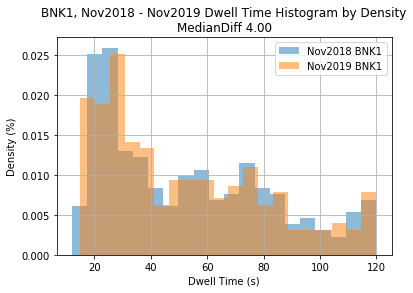

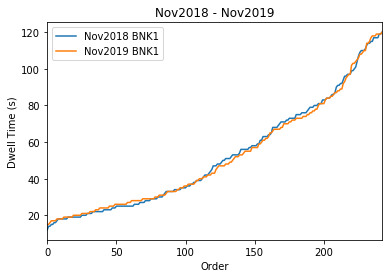


Platform Name BNK2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    355.000000
mean      51.084507
std       27.855228
min       14.000000
25%       26.000000
50%       39.000000
75%       77.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    355.000000
mean      58.923944
std       27.129682
min       15.000000
25%       31.000000
50%       65.000000
75%       82.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00028441546643045475
Dwell Time Decrease IS Signficiant


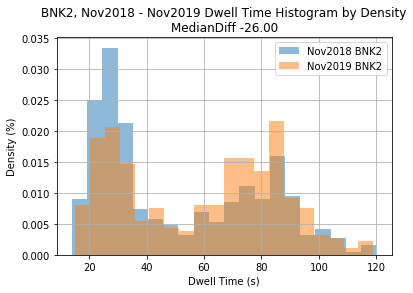

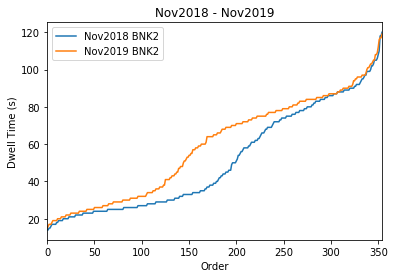


Platform Name BRL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    404.000000
mean      20.571782
std        4.909837
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    404.000000
mean      22.200495
std        7.952832
min       13.000000
25%       18.750000
50%       21.000000
75%       23.000000
max      101.000000
Name: time, dtype: float64
KS two-sample test pValue 0.006629576126384772
Dwell Time Decrease IS Signficiant


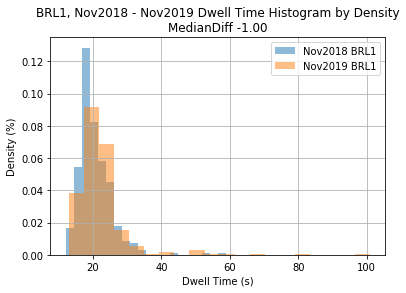

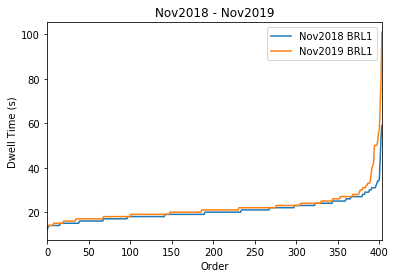


Platform Name BRL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    427.000000
mean      20.704918
std        4.504255
min       13.000000
25%       18.000000
50%       20.000000
75%       22.000000
max       42.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    427.00000
mean      22.70726
std        4.92679
min       13.00000
25%       19.00000
50%       22.00000
75%       25.00000
max       48.00000
Name: time, dtype: float64
KS two-sample test pValue 6.663582933323815e-09
Dwell Time Decrease IS Signficiant


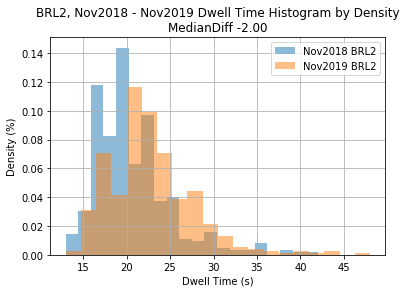

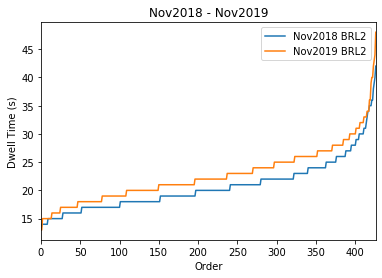


Platform Name BTN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    695.000000
mean      57.989928
std       21.717831
min       16.000000
25%       41.000000
50%       54.000000
75%       73.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    695.000000
mean      59.427338
std       21.606518
min       12.000000
25%       43.000000
50%       57.000000
75%       75.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.37665975760488296
Dwell Time Decrease NOT Signficiant


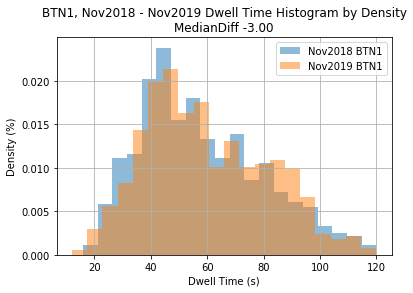

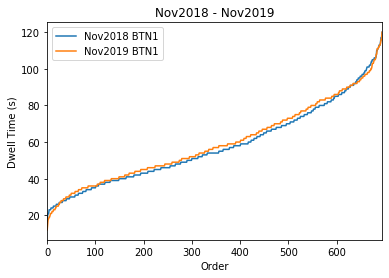


Platform Name BTN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    663.000000
mean      45.416290
std       15.238442
min       16.000000
25%       35.000000
50%       43.000000
75%       53.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    663.000000
mean      44.736048
std       15.055427
min       17.000000
25%       35.000000
50%       43.000000
75%       51.000000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6419314015903321
Dwell Time Decrease NOT Signficiant


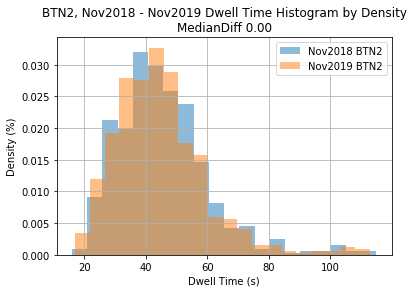

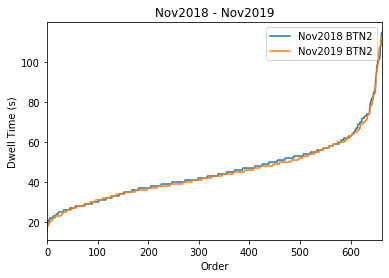


Platform Name BTN3

Platform Name BTN4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    548.000000
mean      42.290146
std       17.354086
min       15.000000
25%       28.000000
50%       41.000000
75%       52.000000
max      106.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    548.000000
mean      42.151460
std       15.522375
min       13.000000
25%       31.000000
50%       41.500000
75%       51.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.42705971254997555
Dwell Time Decrease NOT Signficiant


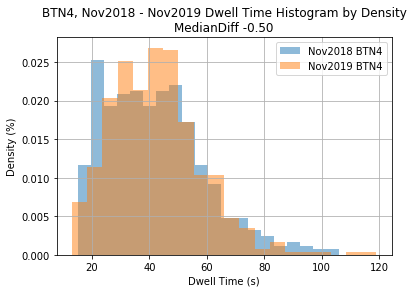

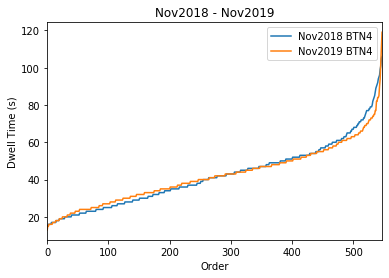


Platform Name BTN5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    263.000000
mean      41.950570
std       15.318048
min       12.000000
25%       29.500000
50%       41.000000
75%       50.000000
max      113.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    263.000000
mean      43.961977
std       17.294223
min       14.000000
25%       31.000000
50%       41.000000
75%       53.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7867713657417866
Dwell Time Decrease NOT Signficiant


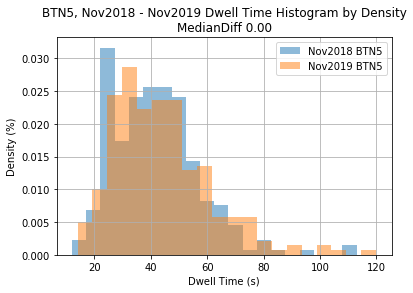

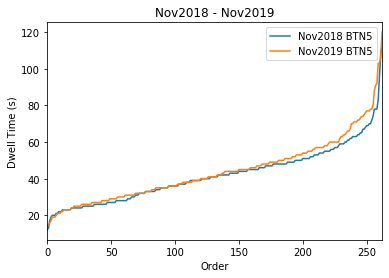


Platform Name BTN6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    121.00000
mean      39.77686
std       19.15093
min       17.00000
25%       26.00000
50%       34.00000
75%       47.00000
max      106.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    121.00000
mean      43.77686
std       19.93886
min       14.00000
25%       27.00000
50%       38.00000
75%       58.00000
max       98.00000
Name: time, dtype: float64
KS two-sample test pValue 0.13756846173362583
Dwell Time Decrease NOT Signficiant


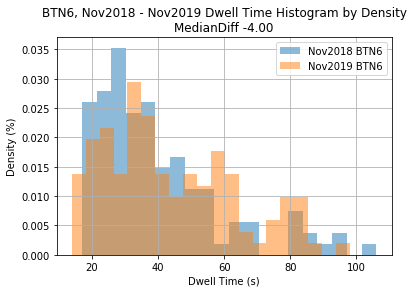

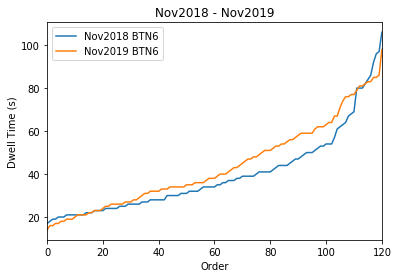


Platform Name BTN7
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    756.000000
mean      46.884921
std       20.740497
min       15.000000
25%       29.000000
50%       44.000000
75%       61.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    756.000000
mean      49.119048
std       19.225579
min       15.000000
25%       34.000000
50%       46.000000
75%       61.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 0.000633999642253336
Dwell Time Decrease IS Signficiant


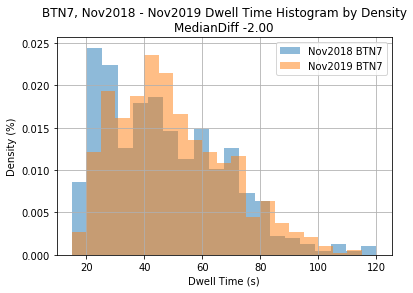

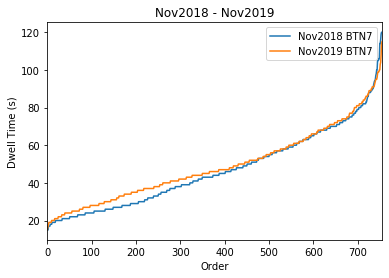


Platform Name BVH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    457.000000
mean      23.166302
std        8.244530
min       12.000000
25%       18.000000
50%       22.000000
75%       26.000000
max      110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    457.000000
mean      22.805252
std        6.202657
min       12.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       60.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8250803265032407
Dwell Time Decrease NOT Signficiant


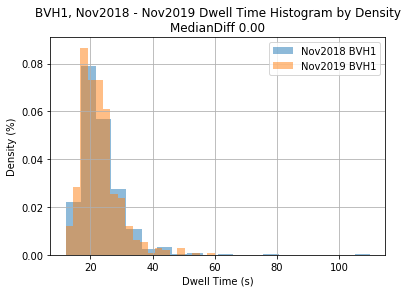

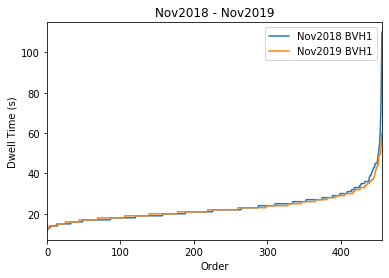


Platform Name BVH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    463.000000
mean      32.904968
std       13.214663
min       12.000000
25%       21.000000
50%       32.000000
75%       44.000000
max       72.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    463.000000
mean      33.380130
std       11.643616
min       13.000000
25%       23.000000
50%       33.000000
75%       43.000000
max       64.000000
Name: time, dtype: float64
KS two-sample test pValue 0.013750935388186902
Dwell Time Decrease IS Signficiant


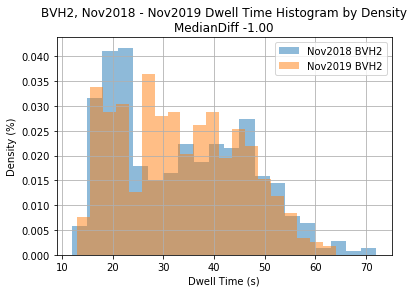

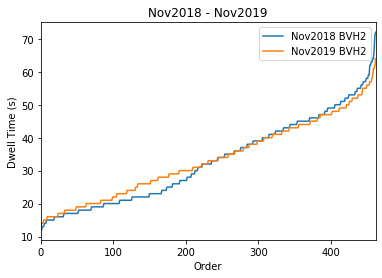


Platform Name BWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    227.000000
mean      26.863436
std        9.826091
min       15.000000
25%       20.000000
50%       24.000000
75%       30.000000
max       80.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    227.000000
mean      29.713656
std       11.844940
min       14.000000
25%       22.000000
50%       27.000000
75%       35.000000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0005623369236919274
Dwell Time Decrease IS Signficiant


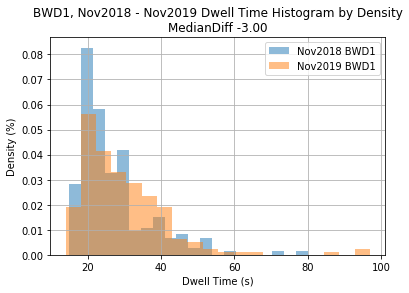

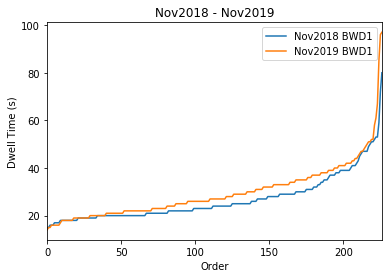


Platform Name BWD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    168.000000
mean      33.684524
std       20.996475
min       14.000000
25%       22.000000
50%       26.000000
75%       32.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    168.000000
mean      41.196429
std       20.751527
min       17.000000
25%       26.000000
50%       33.000000
75%       49.500000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 8.644126941917067e-08
Dwell Time Decrease IS Signficiant


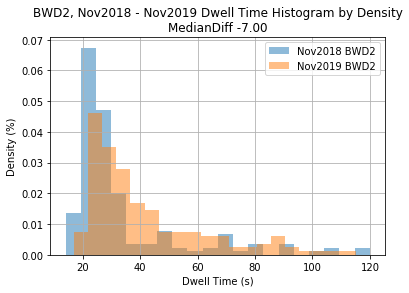

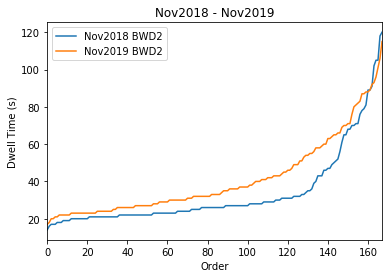


Platform Name BWD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    745.000000
mean      24.318121
std        6.709166
min       13.000000
25%       20.000000
50%       24.000000
75%       27.000000
max       85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    745.000000
mean      24.524832
std        6.106337
min       12.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       69.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3494653325521848
Dwell Time Decrease NOT Signficiant


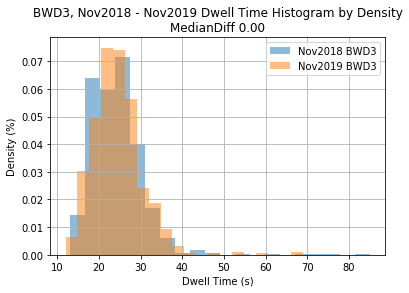

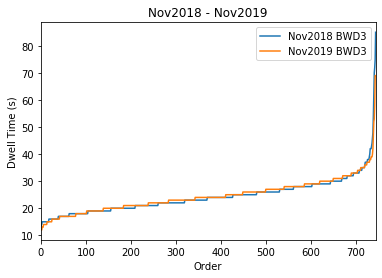


Platform Name BWD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    627.000000
mean      26.969697
std        6.650857
min       14.000000
25%       23.000000
50%       26.000000
75%       30.000000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    627.000000
mean      28.205742
std        7.887028
min       14.000000
25%       23.000000
50%       27.000000
75%       32.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.007731404571693951
Dwell Time Decrease IS Signficiant


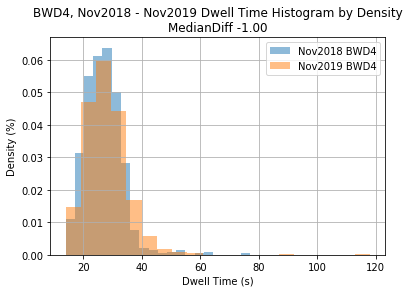

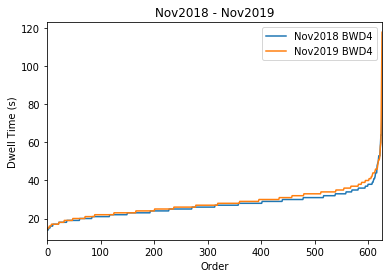


Platform Name BWD5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    855.000000
mean      34.133333
std       15.527297
min       11.000000
25%       24.000000
50%       29.000000
75%       42.500000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    855.000000
mean      34.292398
std       15.259231
min       13.000000
25%       24.000000
50%       29.000000
75%       41.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6688193215781649
Dwell Time Decrease NOT Signficiant


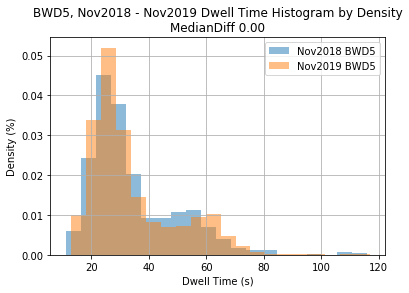

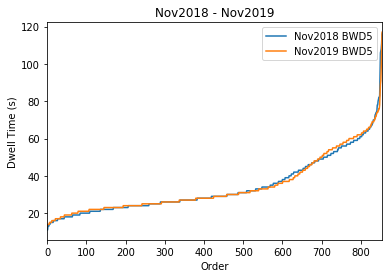


Platform Name BWD6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    850.000000
mean      25.868235
std        7.603641
min       14.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       86.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    850.000000
mean      30.037647
std        9.980593
min       13.000000
25%       23.000000
50%       27.500000
75%       33.000000
max       92.000000
Name: time, dtype: float64
KS two-sample test pValue 1.5832777646743983e-22
Dwell Time Decrease IS Signficiant


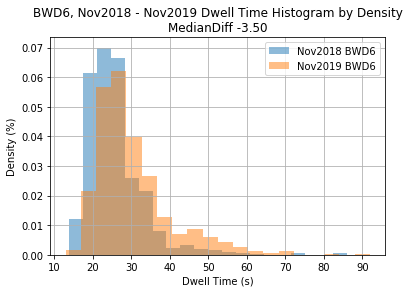

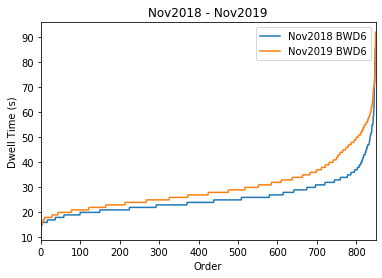


Platform Name BXN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    475.000000
mean      20.991579
std        7.510326
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    475.000000
mean      21.393684
std        7.390749
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max      108.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3815063598234816
Dwell Time Decrease NOT Signficiant


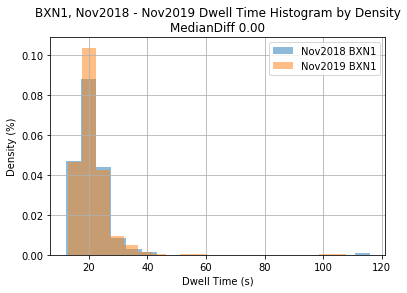

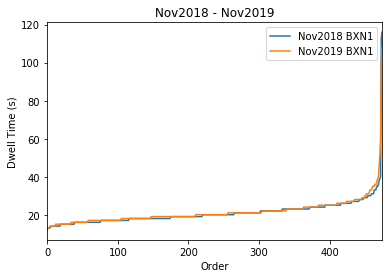


Platform Name BXN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    444.000000
mean      21.423423
std        5.921685
min       12.000000
25%       18.000000
50%       20.000000
75%       24.000000
max       66.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    444.000000
mean      23.020270
std        6.210167
min       14.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       76.000000
Name: time, dtype: float64
KS two-sample test pValue 2.2626162307568847e-05
Dwell Time Decrease IS Signficiant


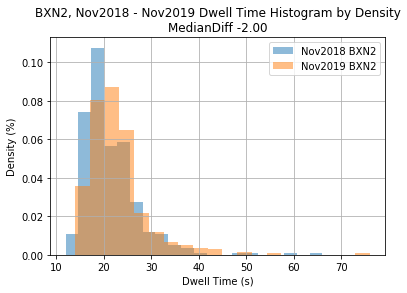

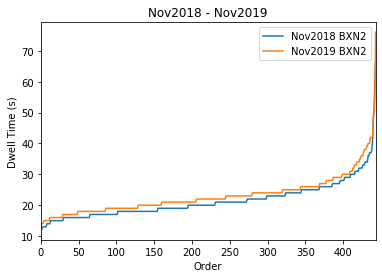


Platform Name CAB1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    767.000000
mean      39.985658
std       15.726731
min       13.000000
25%       27.000000
50%       39.000000
75%       51.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    767.000000
mean      39.897001
std       15.315007
min       13.000000
25%       27.000000
50%       40.000000
75%       51.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.956929954156459
Dwell Time Decrease NOT Signficiant


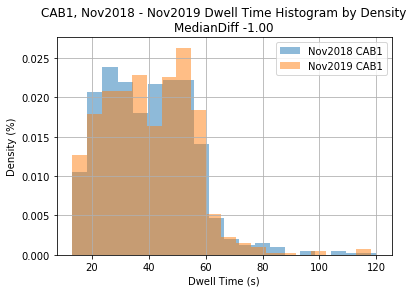

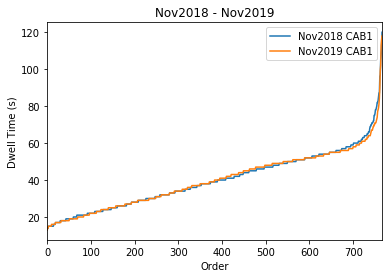


Platform Name CAB2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    820.000000
mean      25.753659
std        8.276675
min       11.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       94.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    820.000000
mean      26.974390
std        7.666783
min       12.000000
25%       22.000000
50%       26.000000
75%       30.000000
max       88.000000
Name: time, dtype: float64
KS two-sample test pValue 6.479788456213152e-05
Dwell Time Decrease IS Signficiant


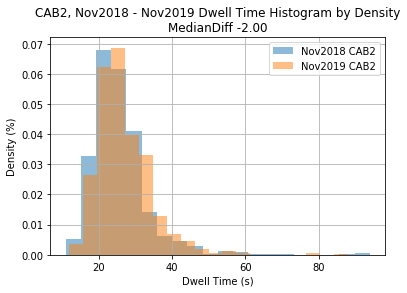

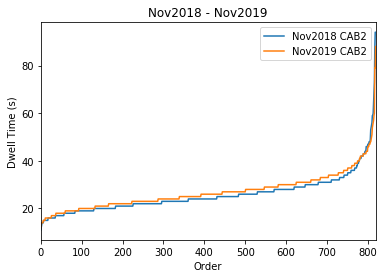


Platform Name CAS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    637.000000
mean      25.601256
std       16.210521
min       11.000000
25%       16.000000
50%       19.000000
75%       25.000000
max      105.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    637.000000
mean      28.095761
std       18.092493
min       12.000000
25%       17.000000
50%       20.000000
75%       30.000000
max       88.000000
Name: time, dtype: float64
KS two-sample test pValue 0.14285962243042433
Dwell Time Decrease NOT Signficiant


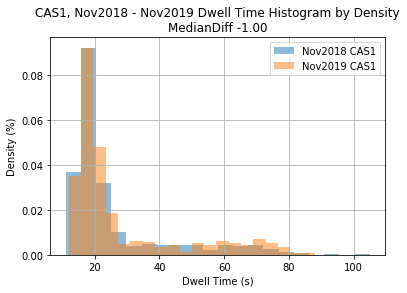

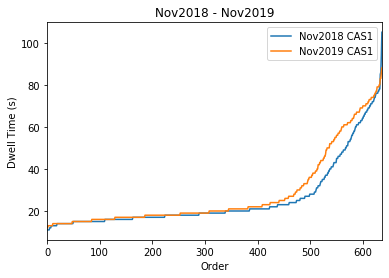


Platform Name CAS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    680.000000
mean      24.358824
std       14.504707
min       11.000000
25%       16.000000
50%       18.000000
75%       24.000000
max       96.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    680.000000
mean      26.129412
std       15.716590
min       12.000000
25%       16.000000
50%       19.000000
75%       27.000000
max       94.000000
Name: time, dtype: float64
KS two-sample test pValue 0.03746742737871666
Dwell Time Decrease IS Signficiant


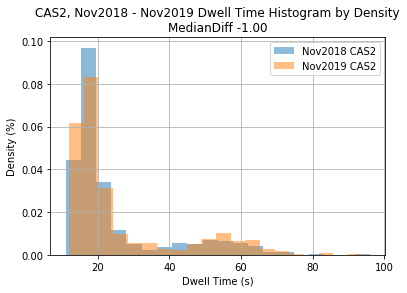

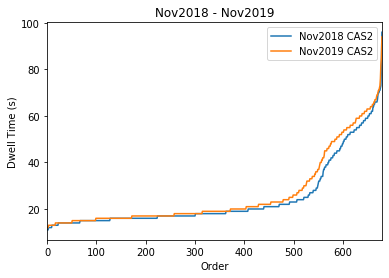


Platform Name CBY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    493.000000
mean      20.125761
std        4.432466
min       13.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       45.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    493.000000
mean      21.107505
std        6.374381
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       84.000000
Name: time, dtype: float64
KS two-sample test pValue 0.21948137046167984
Dwell Time Decrease NOT Signficiant


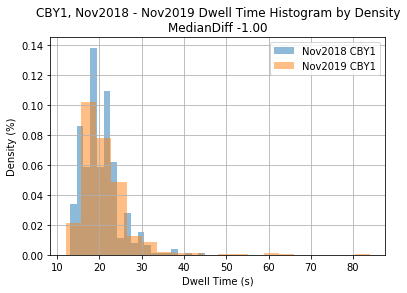

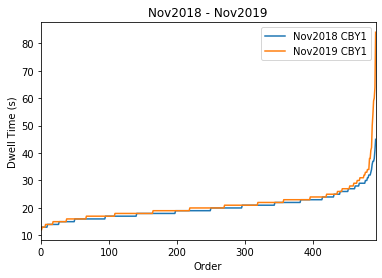


Platform Name CBY2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    515.000000
mean      21.467961
std        5.689471
min       14.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       74.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    515.000000
mean      24.215534
std        6.397816
min       13.000000
25%       20.000000
50%       23.000000
75%       28.000000
max       60.000000
Name: time, dtype: float64
KS two-sample test pValue 5.849958440851387e-10
Dwell Time Decrease IS Signficiant


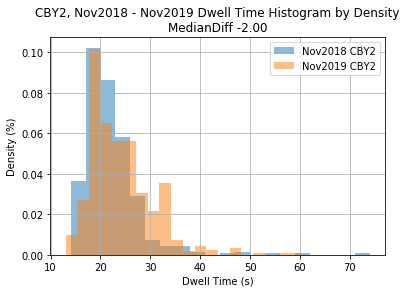

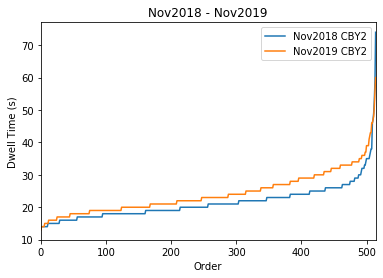


Platform Name CCQ1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    635.000000
mean      37.946457
std       21.557574
min       14.000000
25%       26.000000
50%       31.000000
75%       40.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    635.000000
mean      38.475591
std       23.337950
min       13.000000
25%       25.000000
50%       30.000000
75%       39.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.20566457767486818
Dwell Time Increase NOT Signficiant


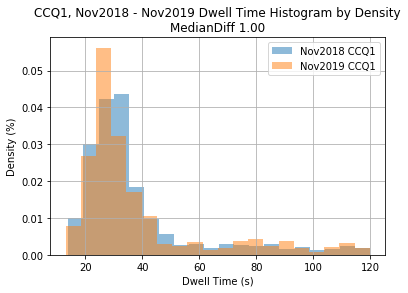

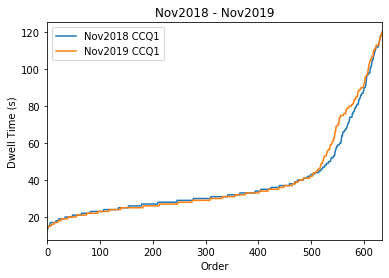


Platform Name CCQ2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1388.000000
mean       46.961095
std        18.662677
min        16.000000
25%        30.000000
50%        48.000000
75%        62.000000
max       110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1388.000000
mean       46.314841
std        18.167240
min        14.000000
25%        29.000000
50%        47.000000
75%        61.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.643850385382536
Dwell Time Increase NOT Signficiant


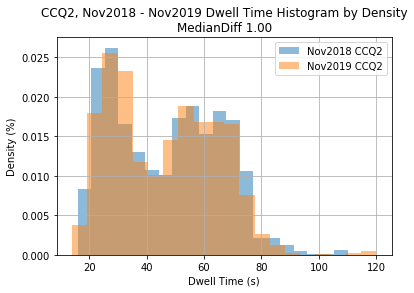

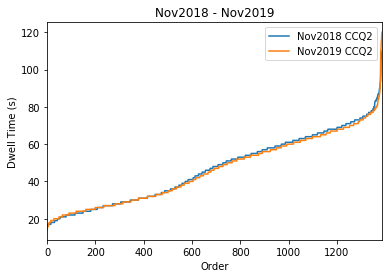


Platform Name CDN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    266.000000
mean      67.582707
std       36.693564
min       11.000000
25%       29.000000
50%       74.500000
75%      101.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    266.000000
mean      63.951128
std       36.632204
min       12.000000
25%       22.000000
50%       68.000000
75%       97.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5068136806191683
Dwell Time Increase NOT Signficiant


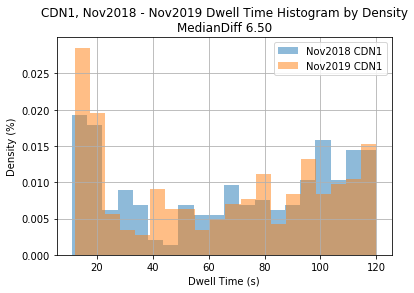

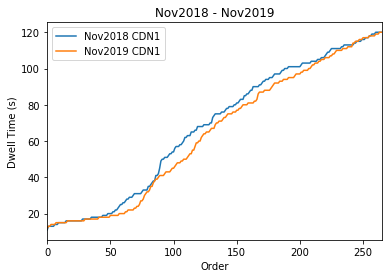


Platform Name CDN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    491.000000
mean      39.560081
std       31.674266
min       11.000000
25%       16.000000
50%       21.000000
75%       59.500000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    491.000000
mean      42.755601
std       30.344709
min       11.000000
25%       17.000000
50%       27.000000
75%       65.500000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.012251205166452192
Dwell Time Decrease IS Signficiant


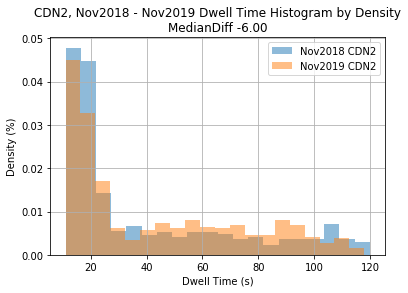

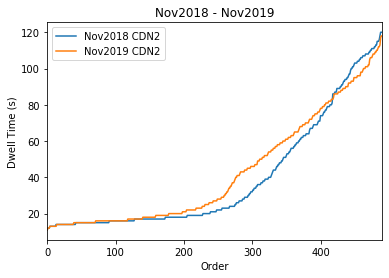


Platform Name CE16
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    4381.000000
mean       52.125542
std        18.795116
min        13.000000
25%        40.000000
50%        49.000000
75%        61.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    4381.000000
mean       47.470212
std        16.520220
min        16.000000
25%        36.000000
50%        44.000000
75%        56.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 5.0000296834762664e-39
Dwell Time Increase IS Signficiant


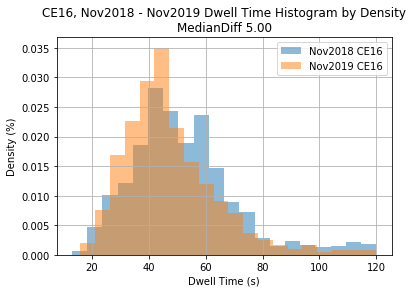

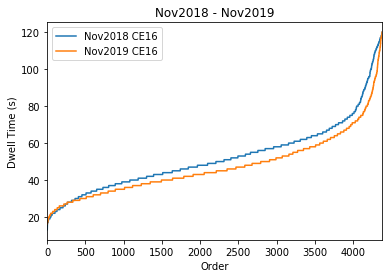


Platform Name CE17
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2803.000000
mean       47.966108
std        16.120750
min        15.000000
25%        37.000000
50%        47.000000
75%        57.000000
max       118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2803.000000
mean       44.827685
std        13.754368
min        16.000000
25%        36.000000
50%        43.000000
75%        52.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 1.9096400741640684e-20
Dwell Time Increase IS Signficiant


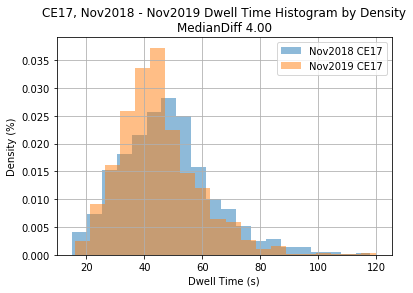

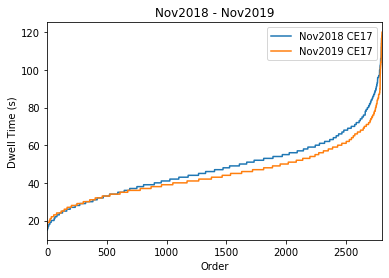


Platform Name CE18
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    4213.000000
mean       63.899596
std        18.800791
min        16.000000
25%        50.000000
50%        66.000000
75%        77.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    4213.000000
mean       61.923095
std        17.728799
min        21.000000
25%        49.000000
50%        64.000000
75%        75.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 4.109437739951463e-08
Dwell Time Increase IS Signficiant


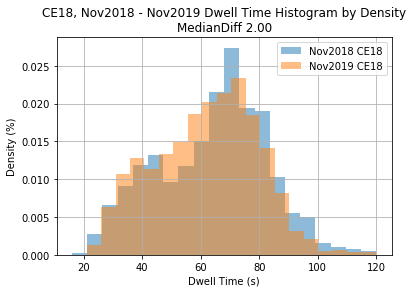

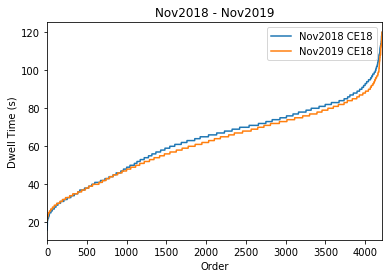


Platform Name CE19
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    905.00000
mean      59.20663
std       19.95987
min       16.00000
25%       46.00000
50%       63.00000
75%       73.00000
max      120.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    905.000000
mean      62.091713
std       16.993602
min       17.000000
25%       51.000000
50%       64.000000
75%       74.000000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0002568616852335817
Dwell Time Decrease IS Signficiant


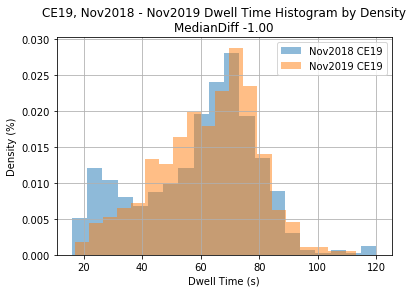

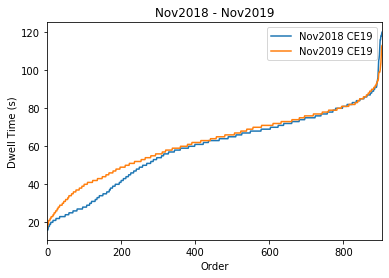


Platform Name CE20
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    238.000000
mean      49.726891
std       22.004722
min       12.000000
25%       33.000000
50%       49.000000
75%       67.000000
max      110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    238.000000
mean      47.415966
std       23.012730
min       13.000000
25%       32.250000
50%       47.000000
75%       63.750000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3707131367768906
Dwell Time Increase NOT Signficiant


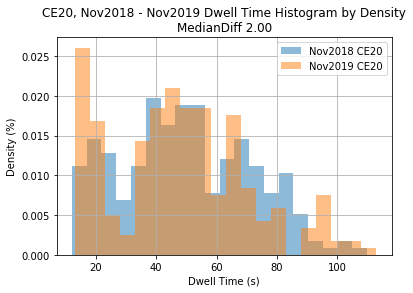

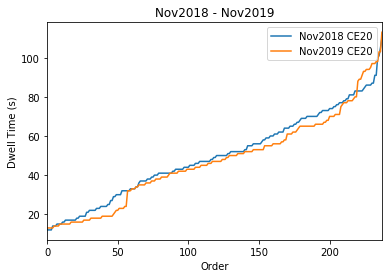


Platform Name CE21
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1528.000000
mean       68.192408
std        21.361108
min        19.000000
25%        51.000000
50%        68.000000
75%        85.000000
max       119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1528.000000
mean       66.359948
std        19.123800
min        25.000000
25%        51.000000
50%        65.000000
75%        81.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.001924851054900886
Dwell Time Increase IS Signficiant


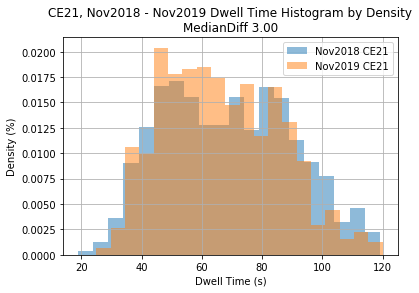

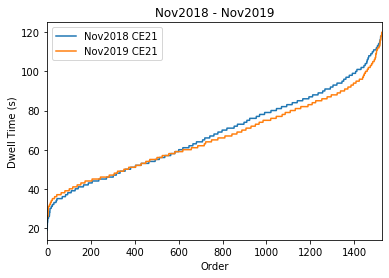


Platform Name CE22
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    484.000000
mean      61.721074
std       32.344015
min       15.000000
25%       30.000000
50%       57.000000
75%       94.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    484.000000
mean      70.117769
std       29.697379
min       15.000000
25%       41.000000
50%       73.000000
75%       97.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 6.663022575691349e-06
Dwell Time Decrease IS Signficiant


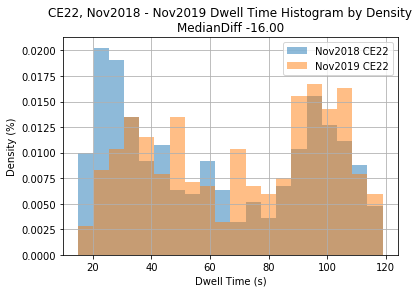

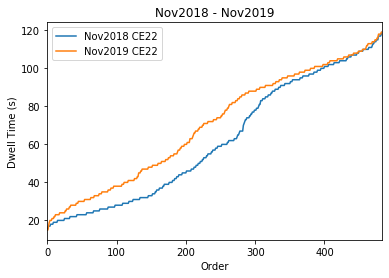


Platform Name CE23
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    852.000000
mean      65.403756
std       26.593098
min       20.000000
25%       39.000000
50%       68.000000
75%       89.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    852.000000
mean      69.588028
std       24.386778
min       18.000000
25%       48.750000
50%       75.000000
75%       89.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 7.693683390821224e-05
Dwell Time Decrease IS Signficiant


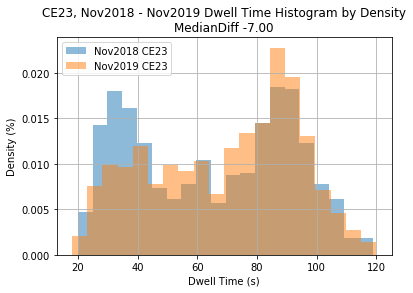

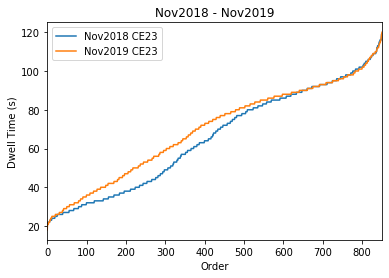


Platform Name CHH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    141.000000
mean      19.531915
std        5.214750
min       12.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       52.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    141.000000
mean      20.347518
std        7.621385
min       12.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       90.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6887180647227926
Dwell Time Decrease NOT Signficiant


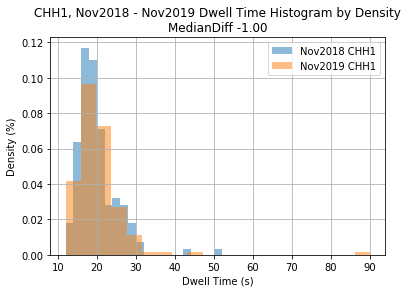

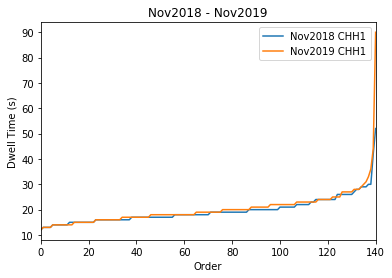


Platform Name CHH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    124.000000
mean      20.935484
std        6.427509
min       11.000000
25%       17.000000
50%       20.000000
75%       23.000000
max       53.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    124.000000
mean      21.080645
std        5.419922
min       12.000000
25%       17.000000
50%       20.000000
75%       24.000000
max       39.000000
Name: time, dtype: float64
KS two-sample test pValue 0.40944268111769516
Dwell Time Decrease NOT Signficiant


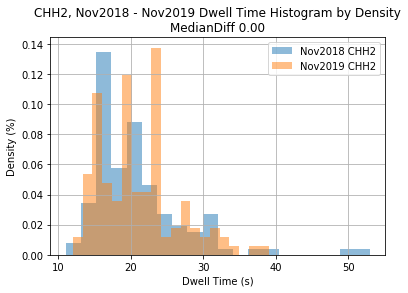

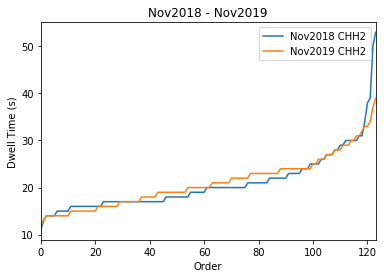


Platform Name CHT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    846.000000
mean      19.286052
std        7.924703
min       11.000000
25%       16.000000
50%       18.000000
75%       20.000000
max       98.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    846.000000
mean      18.752955
std        6.188304
min       12.000000
25%       16.000000
50%       17.000000
75%       20.000000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8541286575888711
Dwell Time Increase NOT Signficiant


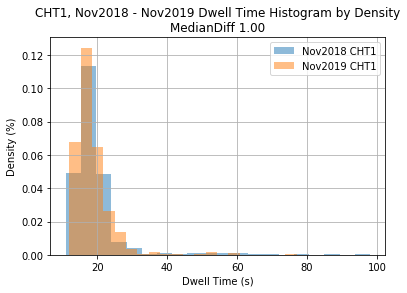

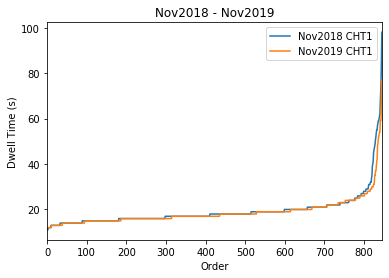


Platform Name CHT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    813.000000
mean      22.744157
std        9.962169
min       12.000000
25%       17.000000
50%       20.000000
75%       26.000000
max      106.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    813.000000
mean      23.023370
std        7.733122
min       12.000000
25%       18.000000
50%       21.000000
75%       26.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 9.287654937666619e-05
Dwell Time Decrease IS Signficiant


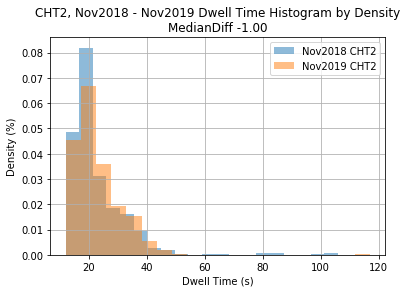

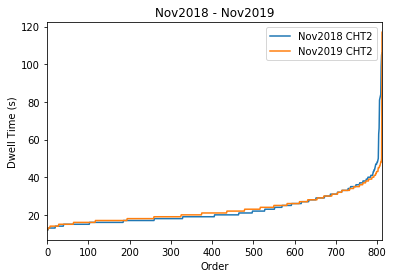


Platform Name CLJ2

Platform Name CLJ3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    64.00000
mean     29.34375
std      12.38050
min      12.00000
25%      18.75000
50%      27.50000
75%      39.00000
max      66.00000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    64.000000
mean     28.625000
std      11.507761
min      13.000000
25%      18.000000
50%      25.500000
75%      39.000000
max      54.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9997180010908584
Dwell Time Increase NOT Signficiant


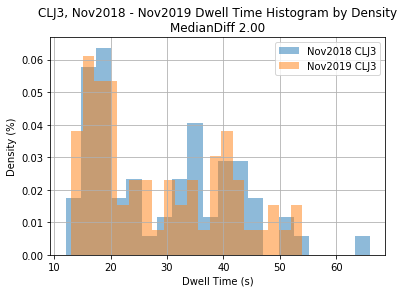

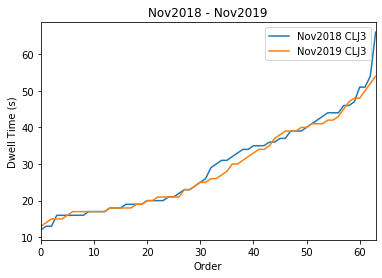


Platform Name CLJ4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    639.000000
mean      25.223787
std       11.465705
min       12.000000
25%       17.000000
50%       20.000000
75%       31.000000
max       83.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    639.000000
mean      26.931142
std       12.237781
min       12.000000
25%       18.000000
50%       22.000000
75%       35.000000
max       86.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0039924869077393125
Dwell Time Decrease IS Signficiant


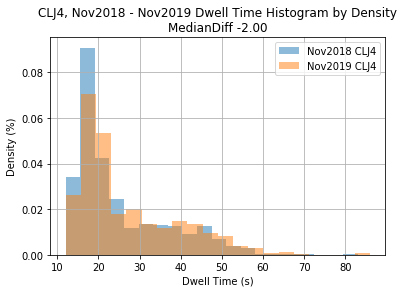

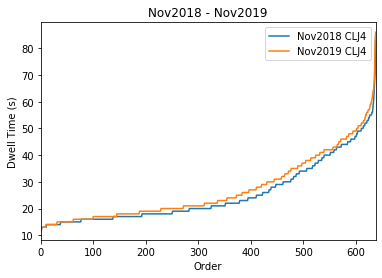


Platform Name CLJ5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    703.000000
mean      22.614509
std        7.544977
min       13.000000
25%       18.000000
50%       21.000000
75%       25.000000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    703.000000
mean      22.499289
std        6.071951
min       14.000000
25%       19.000000
50%       21.000000
75%       25.000000
max       85.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3484686770117763
Dwell Time Decrease NOT Signficiant


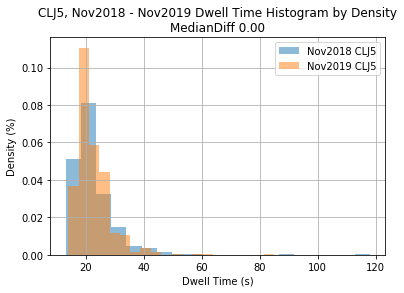

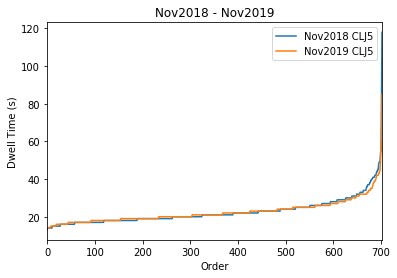


Platform Name CMP1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    558.000000
mean      31.075269
std       10.255343
min       12.000000
25%       24.000000
50%       29.000000
75%       36.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    558.000000
mean      31.415771
std       10.304131
min       12.000000
25%       25.000000
50%       29.000000
75%       36.000000
max      114.000000
Name: time, dtype: float64
KS two-sample test pValue 0.630389992674604
Dwell Time Decrease NOT Signficiant


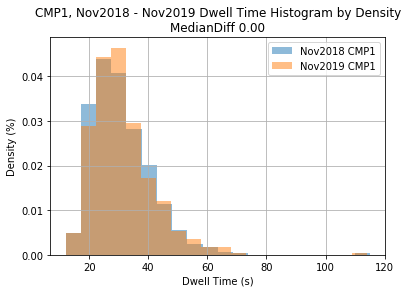

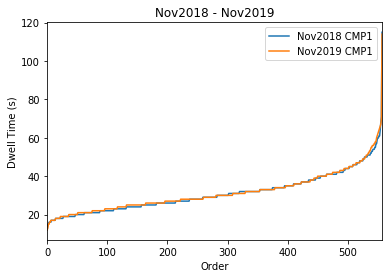


Platform Name CMP2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    542.000000
mean      32.101476
std       10.598314
min       16.000000
25%       24.000000
50%       30.000000
75%       38.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    542.000000
mean      34.092251
std        9.040614
min       17.000000
25%       27.250000
50%       33.000000
75%       39.000000
max       89.000000
Name: time, dtype: float64
KS two-sample test pValue 1.64240354135258e-06
Dwell Time Decrease IS Signficiant


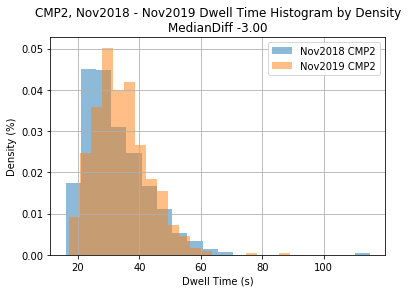

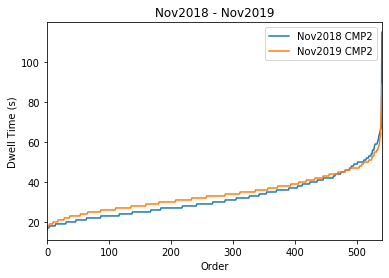


Platform Name CNV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    600.000000
mean      25.108333
std        8.560300
min       13.000000
25%       19.000000
50%       24.000000
75%       29.000000
max       86.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    600.000000
mean      26.583333
std       12.171139
min       12.000000
25%       20.000000
50%       25.000000
75%       30.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.32447657397050844
Dwell Time Decrease NOT Signficiant


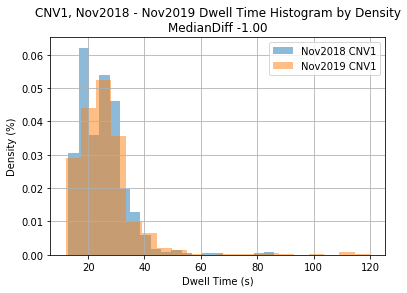

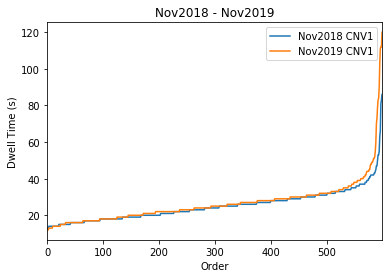


Platform Name CNV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    661.000000
mean      27.273828
std       20.008916
min       11.000000
25%       18.000000
50%       20.000000
75%       26.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    661.000000
mean      26.712557
std       16.716866
min       13.000000
25%       18.000000
50%       22.000000
75%       27.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0007777283029825246
Dwell Time Decrease IS Signficiant


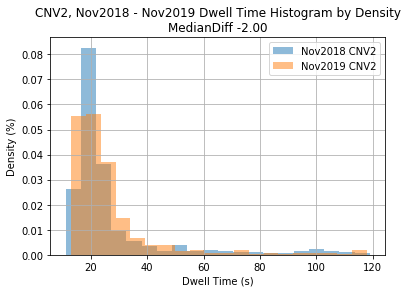

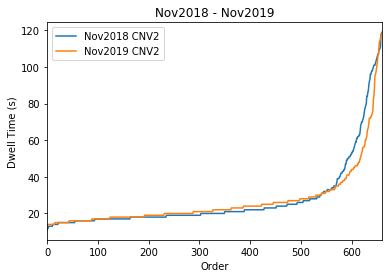


Platform Name CRD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    794.000000
mean      20.078086
std        7.748340
min       11.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       91.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    794.000000
mean      19.804786
std        6.773469
min       10.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       79.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9970721917150747
Dwell Time Decrease NOT Signficiant


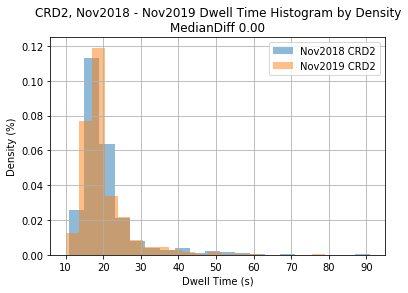

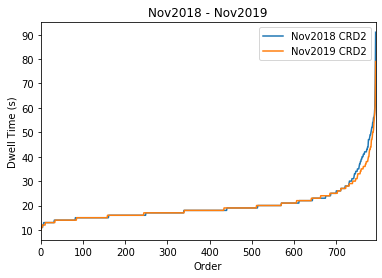


Platform Name CRD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    577.000000
mean      19.306759
std        5.038515
min       13.000000
25%       17.000000
50%       18.000000
75%       21.000000
max       89.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    577.000000
mean      19.630849
std        5.316113
min       13.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       86.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4600762710856414
Dwell Time Decrease NOT Signficiant


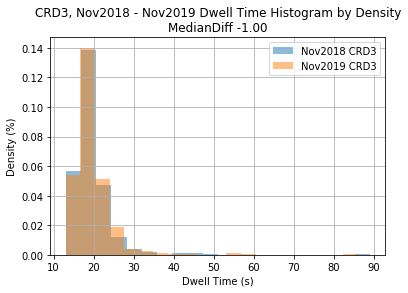

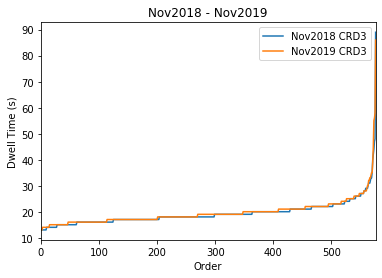


Platform Name CRD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    99.000000
mean     19.151515
std       9.855449
min      13.000000
25%      15.500000
50%      18.000000
75%      19.000000
max      97.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    99.000000
mean     22.575758
std       8.977399
min      13.000000
25%      18.000000
50%      21.000000
75%      25.000000
max      94.000000
Name: time, dtype: float64
KS two-sample test pValue 3.559615676850103e-09
Dwell Time Decrease IS Signficiant


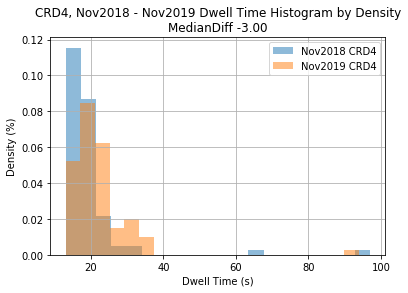

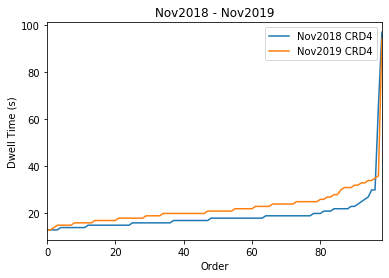


Platform Name CRR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    160.000000
mean      20.287500
std        5.683904
min       12.000000
25%       16.750000
50%       19.500000
75%       22.000000
max       53.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    160.000000
mean      20.475000
std        5.296195
min       11.000000
25%       17.000000
50%       19.000000
75%       24.000000
max       38.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6680518893809643
Dwell Time Increase NOT Signficiant


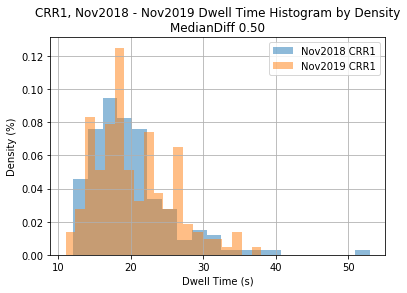

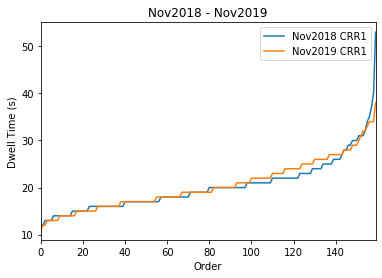


Platform Name CRR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    132.000000
mean      19.007576
std        6.948553
min       11.000000
25%       16.000000
50%       18.000000
75%       20.250000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    132.000000
mean      19.765152
std        5.291300
min       13.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       49.000000
Name: time, dtype: float64
KS two-sample test pValue 0.22417871680078566
Dwell Time Decrease NOT Signficiant


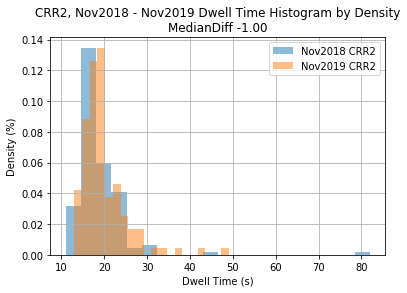

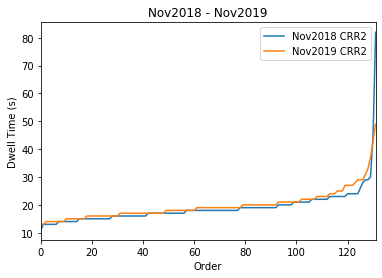


Platform Name CTN1

Platform Name CTN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    537.000000
mean      78.795158
std       18.561891
min       16.000000
25%       71.000000
50%       82.000000
75%       91.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    537.000000
mean      76.439479
std       22.249110
min       17.000000
25%       65.000000
50%       83.000000
75%       91.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.05432531769624796
Dwell Time Decrease NOT Signficiant


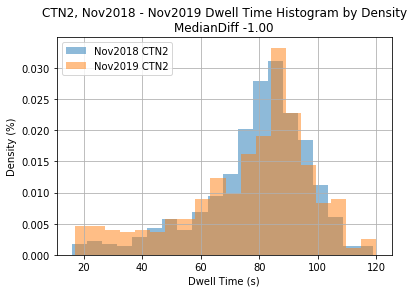

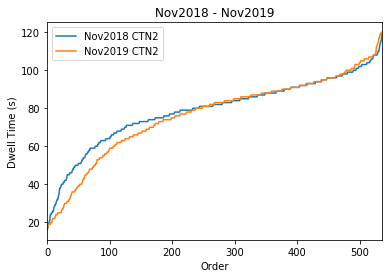


Platform Name CTN3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    313.000000
mean      78.079872
std       28.594143
min       17.000000
25%       52.000000
50%       88.000000
75%      100.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    313.000000
mean      80.198083
std       27.253306
min       18.000000
25%       58.000000
50%       89.000000
75%      101.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6795476028909546
Dwell Time Decrease NOT Signficiant


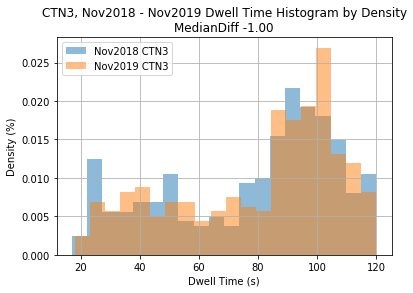

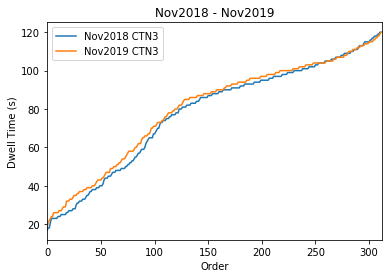


Platform Name CWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2179.000000
mean       42.463515
std        22.236332
min        12.000000
25%        25.000000
50%        34.000000
75%        57.000000
max       119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2179.000000
mean       57.269849
std        24.294275
min        14.000000
25%        36.000000
50%        56.000000
75%        75.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 4.326760136876493e-78
Dwell Time Decrease IS Signficiant


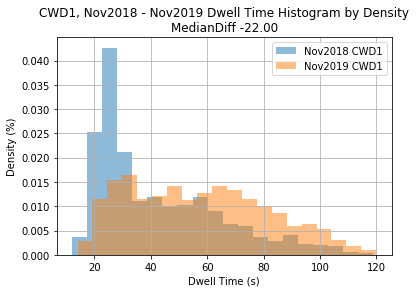

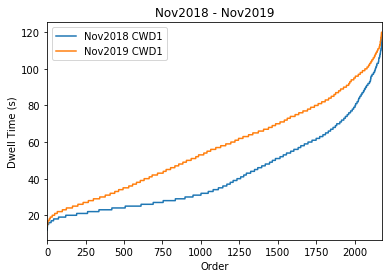


Platform Name CWD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2125.000000
mean       56.774588
std        28.948173
min        11.000000
25%        28.000000
50%        56.000000
75%        83.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2125.000000
mean       49.928941
std        18.524330
min        15.000000
25%        33.000000
50%        52.000000
75%        64.000000
max       118.000000
Name: time, dtype: float64
KS two-sample test pValue 9.402948403798491e-72
Dwell Time Increase IS Signficiant


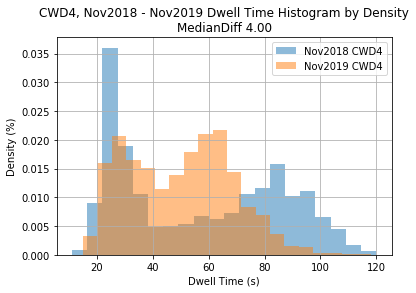

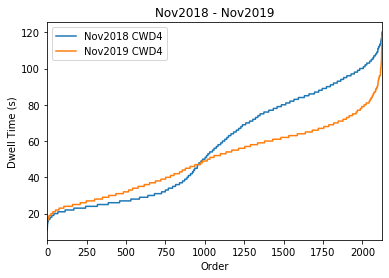


Platform Name CYD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    419.000000
mean      21.696897
std        8.649820
min       11.000000
25%       17.000000
50%       20.000000
75%       23.000000
max      113.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    419.000000
mean      21.546539
std        6.743745
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max      106.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5536269476080524
Dwell Time Decrease NOT Signficiant


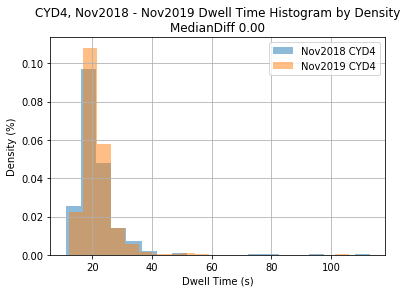

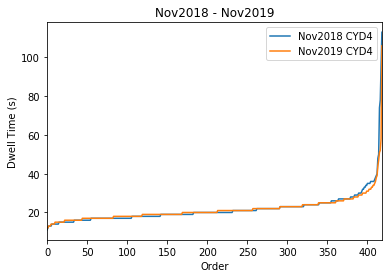


Platform Name CYD5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    363.000000
mean      32.176309
std       12.470597
min       13.000000
25%       22.000000
50%       29.000000
75%       41.000000
max       79.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    363.000000
mean      34.793388
std       12.953540
min       15.000000
25%       23.000000
50%       33.000000
75%       44.500000
max       76.000000
Name: time, dtype: float64
KS two-sample test pValue 0.037380231553029455
Dwell Time Decrease IS Signficiant


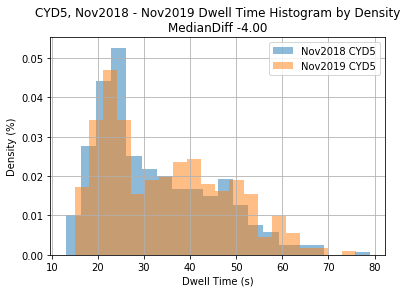

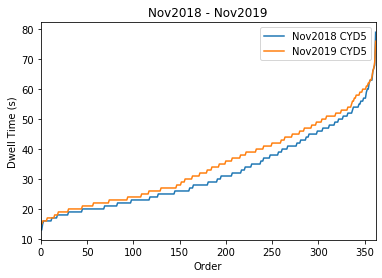


Platform Name DHL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    517.000000
mean      27.806576
std        7.565048
min       11.000000
25%       23.000000
50%       28.000000
75%       32.000000
max       79.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    517.000000
mean      29.305609
std       13.439047
min       13.000000
25%       23.000000
50%       28.000000
75%       32.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9967910660979609
Dwell Time Decrease NOT Signficiant


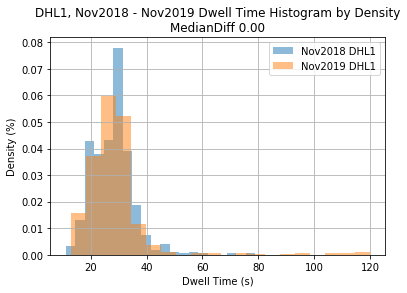

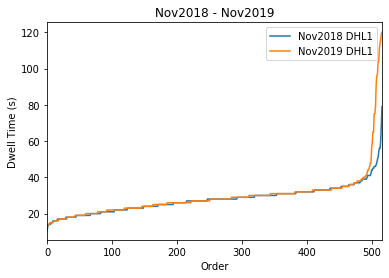


Platform Name DHL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    524.000000
mean      37.372137
std       21.661680
min       13.000000
25%       19.000000
50%       26.500000
75%       58.000000
max       98.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    524.000000
mean      42.129771
std       20.780892
min       14.000000
25%       23.000000
50%       36.000000
75%       64.000000
max       94.000000
Name: time, dtype: float64
KS two-sample test pValue 4.277739300914477e-09
Dwell Time Decrease IS Signficiant


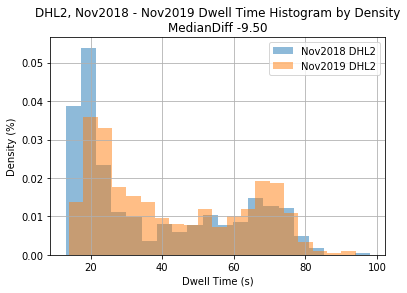

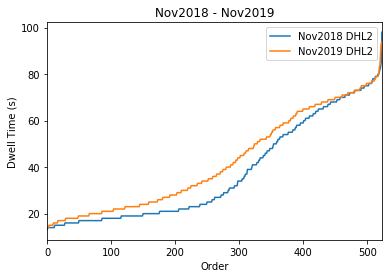


Platform Name DNS1

Platform Name DNS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    783.000000
mean      49.931034
std       26.114010
min       11.000000
25%       18.000000
50%       60.000000
75%       71.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    783.000000
mean      50.547893
std       24.798264
min       11.000000
25%       19.000000
50%       60.000000
75%       71.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6564482072558213
Dwell Time Decrease NOT Signficiant


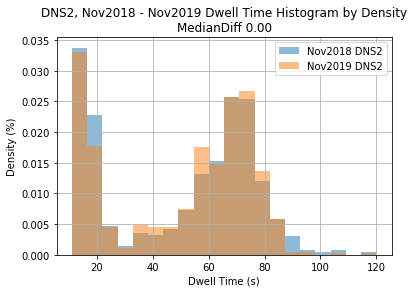

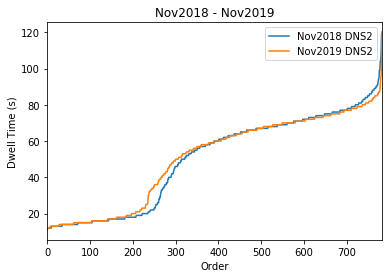


Platform Name DNS3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    750.000000
mean      18.025333
std        5.435201
min       11.000000
25%       15.000000
50%       16.000000
75%       19.000000
max       44.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    750.000000
mean      18.954667
std        6.002276
min       12.000000
25%       16.000000
50%       17.000000
75%       20.000000
max       98.000000
Name: time, dtype: float64
KS two-sample test pValue 3.142125417742432e-05
Dwell Time Decrease IS Signficiant


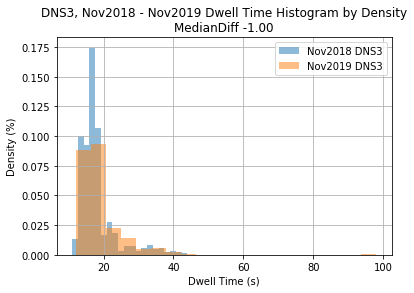

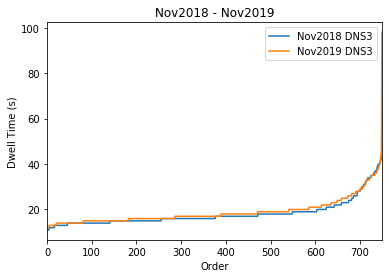


Platform Name DNS4

Platform Name DOO1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    519.000000
mean      23.701349
std       11.327582
min       11.000000
25%       17.000000
50%       20.000000
75%       26.000000
max      101.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    519.000000
mean      25.473988
std       12.335043
min       12.000000
25%       18.000000
50%       21.000000
75%       28.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 0.003796974729441463
Dwell Time Decrease IS Signficiant


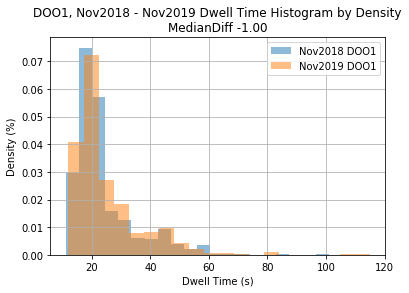

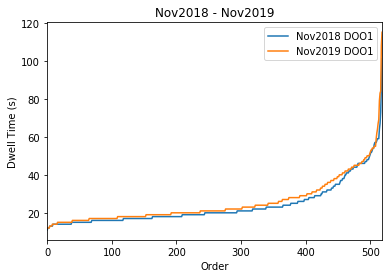


Platform Name DOO2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    295.000000
mean      27.057627
std       11.372484
min       10.000000
25%       19.000000
50%       23.000000
75%       33.000000
max       79.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    295.000000
mean      29.016949
std       13.457531
min       12.000000
25%       20.000000
50%       24.000000
75%       34.500000
max       87.000000
Name: time, dtype: float64
KS two-sample test pValue 0.33174629369263126
Dwell Time Decrease NOT Signficiant


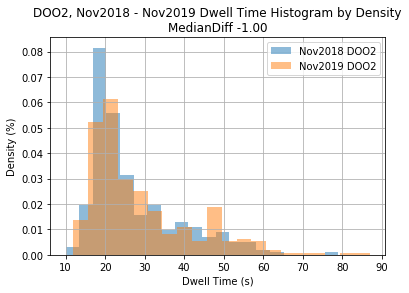

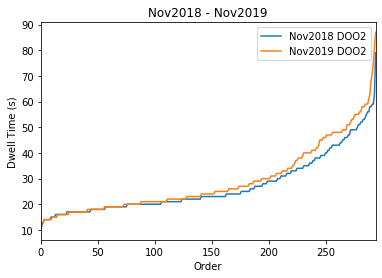


Platform Name DOO3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    119.000000
mean      22.747899
std       11.302631
min       14.000000
25%       17.000000
50%       19.000000
75%       23.000000
max       76.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    119.000000
mean      26.201681
std       14.548912
min       12.000000
25%       18.000000
50%       22.000000
75%       26.500000
max       99.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0009884615161297684
Dwell Time Decrease IS Signficiant


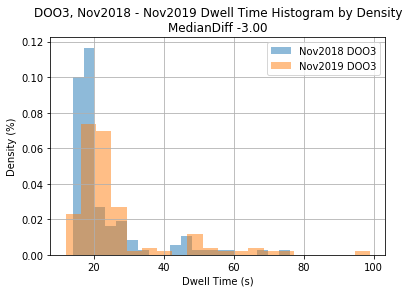

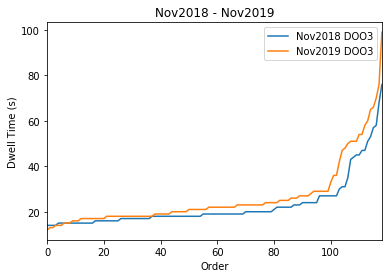


Platform Name DOO4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    754.000000
mean      30.728117
std       24.756108
min       12.000000
25%       18.000000
50%       21.000000
75%       29.750000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    754.000000
mean      34.196286
std       26.564586
min       13.000000
25%       19.000000
50%       24.000000
75%       33.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 2.0479386348680673e-07
Dwell Time Decrease IS Signficiant


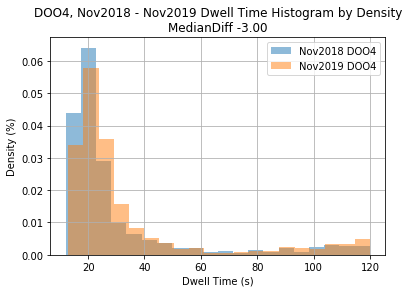

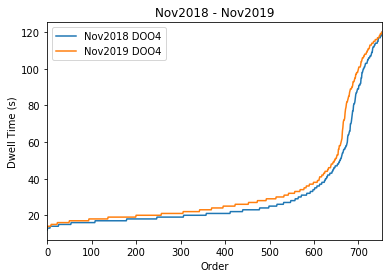


Platform Name EDP1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    631.000000
mean      17.410460
std        4.708771
min       10.000000
25%       14.000000
50%       16.000000
75%       19.000000
max       50.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    631.000000
mean      20.434231
std        6.480621
min       11.000000
25%       16.000000
50%       19.000000
75%       23.000000
max       68.000000
Name: time, dtype: float64
KS two-sample test pValue 2.828715186446244e-23
Dwell Time Decrease IS Signficiant


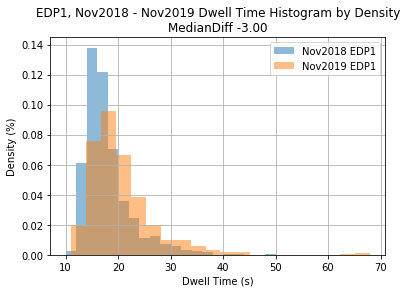

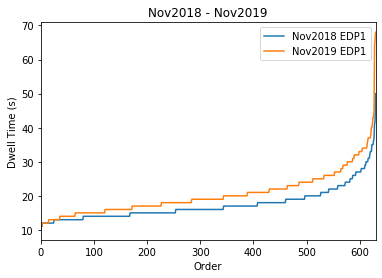


Platform Name EDP2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    686.000000
mean      28.358601
std       19.139815
min       11.000000
25%       17.000000
50%       21.000000
75%       31.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    686.000000
mean      30.816327
std       19.438049
min       11.000000
25%       19.000000
50%       23.000000
75%       33.000000
max      105.000000
Name: time, dtype: float64
KS two-sample test pValue 7.85308514245719e-09
Dwell Time Decrease IS Signficiant


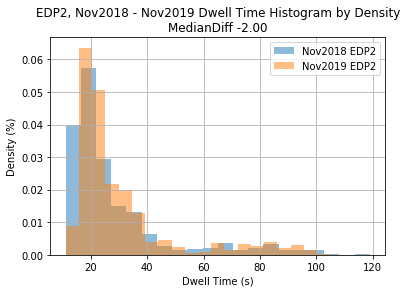

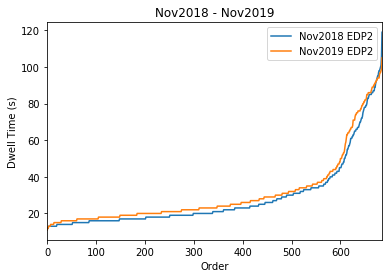


Platform Name EHL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    513.000000
mean      57.099415
std       21.816794
min       12.000000
25%       41.000000
50%       61.000000
75%       74.000000
max      111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    513.000000
mean      57.265107
std       20.101400
min       13.000000
25%       45.000000
50%       60.000000
75%       72.000000
max      104.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6815327454942105
Dwell Time Increase NOT Signficiant


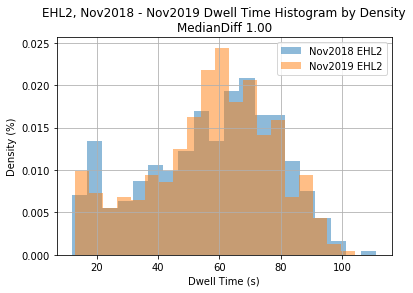

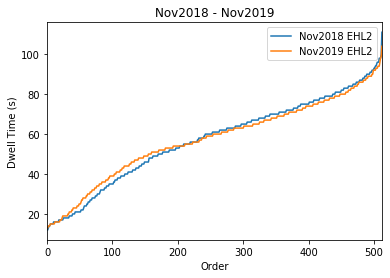


Platform Name EHL3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    538.000000
mean      20.672862
std        6.005030
min       12.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       61.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    538.000000
mean      21.524164
std        5.548531
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       58.000000
Name: time, dtype: float64
KS two-sample test pValue 5.6201482032093887e-05
Dwell Time Decrease IS Signficiant


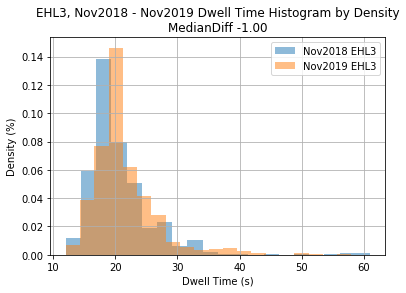

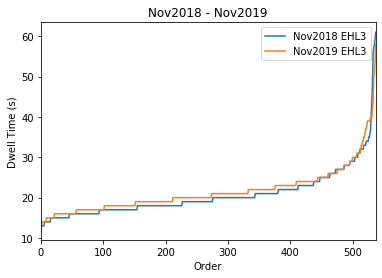


Platform Name EPG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    608.000000
mean      57.409539
std       26.195219
min       15.000000
25%       30.000000
50%       61.000000
75%       79.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    608.000000
mean      62.552632
std       23.268305
min       13.000000
25%       43.750000
50%       67.000000
75%       81.250000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00014717642734247445
Dwell Time Decrease IS Signficiant


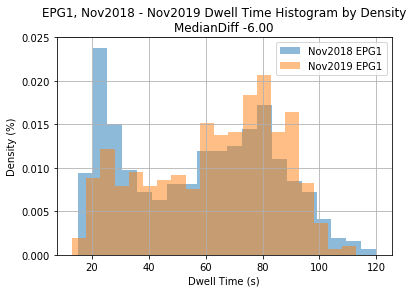

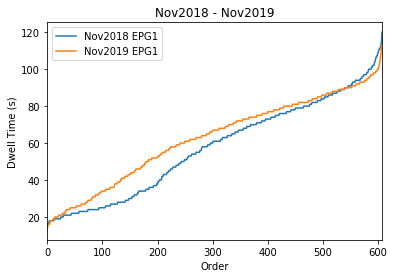


Platform Name EPG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    746.000000
mean      42.001340
std       25.117095
min       14.000000
25%       24.000000
50%       31.000000
75%       53.750000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    746.000000
mean      46.395442
std       26.712648
min       14.000000
25%       26.000000
50%       35.000000
75%       60.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 2.3139395768260347e-05
Dwell Time Decrease IS Signficiant


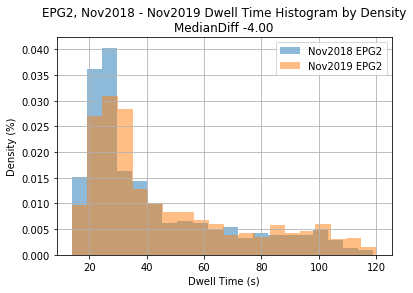

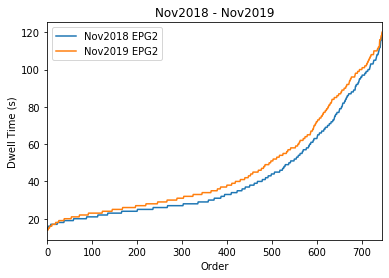


Platform Name EPG3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    181.000000
mean      35.226519
std       11.368502
min       15.000000
25%       26.000000
50%       31.000000
75%       43.000000
max       76.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    181.000000
mean      39.635359
std       12.029116
min       19.000000
25%       31.000000
50%       36.000000
75%       48.000000
max       85.000000
Name: time, dtype: float64
KS two-sample test pValue 1.5213071907584923e-05
Dwell Time Decrease IS Signficiant


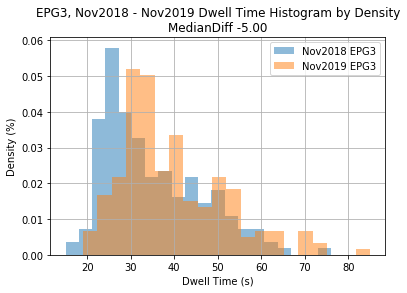

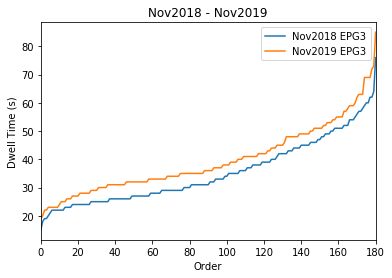


Platform Name EPL1

Platform Name EPL2

Platform Name ERC1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1021.000000
mean       18.830558
std         7.886430
min        10.000000
25%        15.000000
50%        17.000000
75%        20.000000
max       111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1021.000000
mean       18.571988
std         6.394848
min        11.000000
25%        15.000000
50%        17.000000
75%        20.000000
max        80.000000
Name: time, dtype: float64
KS two-sample test pValue 0.05882809620063935
Dwell Time Decrease NOT Signficiant


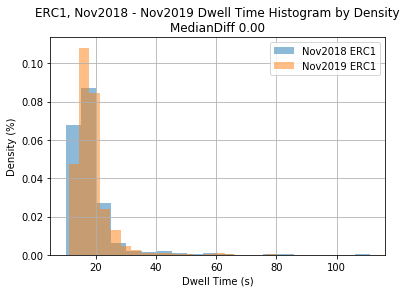

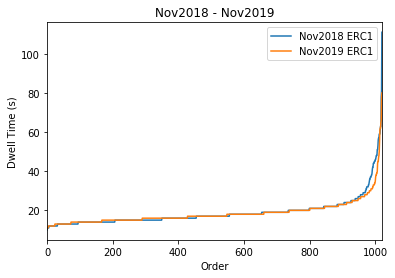


Platform Name ERS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    489.000000
mean      27.605317
std        9.628002
min       12.000000
25%       21.000000
50%       27.000000
75%       32.000000
max       96.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    489.000000
mean      27.895706
std        7.918861
min       12.000000
25%       22.000000
50%       27.000000
75%       33.000000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 0.494438005631411
Dwell Time Decrease NOT Signficiant


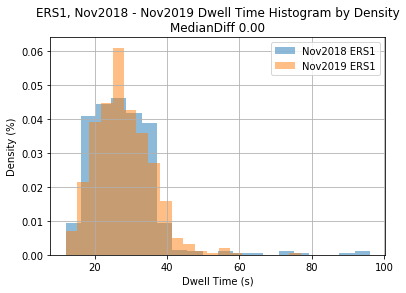

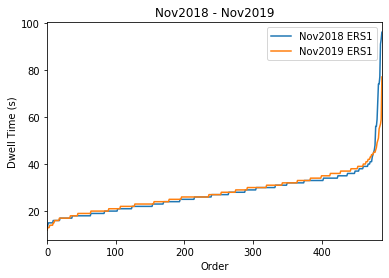


Platform Name ERS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    516.000000
mean      19.620155
std        4.095830
min       12.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       47.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    516.000000
mean      23.050388
std        7.497662
min       12.000000
25%       18.000000
50%       21.000000
75%       26.000000
max       84.000000
Name: time, dtype: float64
KS two-sample test pValue 1.2066141848681494e-12
Dwell Time Decrease IS Signficiant


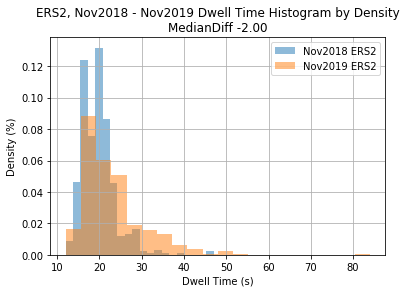

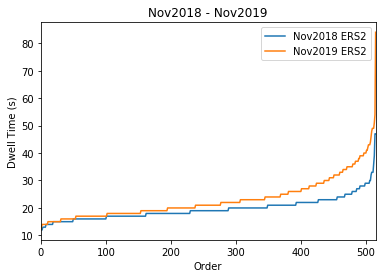


Platform Name ERS3

Platform Name ERS4

Platform Name EWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    152.000000
mean      30.151316
std       17.715844
min       18.000000
25%       23.000000
50%       24.000000
75%       28.250000
max      110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    152.000000
mean      28.276316
std       12.506527
min       17.000000
25%       23.000000
50%       26.000000
75%       29.000000
max      103.000000
Name: time, dtype: float64
KS two-sample test pValue 0.10991992376517033
Dwell Time Decrease NOT Signficiant


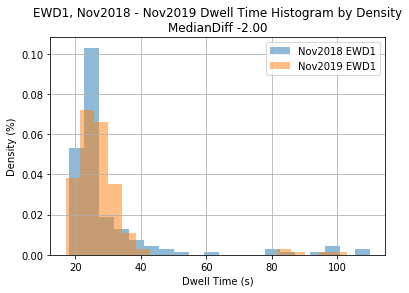

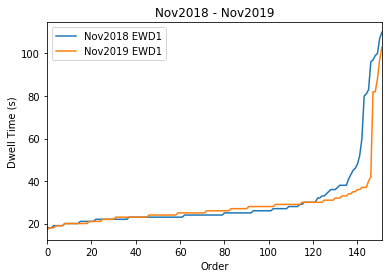


Platform Name EWD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    769.000000
mean      50.314694
std       26.764887
min       11.000000
25%       22.000000
50%       54.000000
75%       75.000000
max      111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    769.000000
mean      49.801040
std       26.827782
min       13.000000
25%       22.000000
50%       53.000000
75%       74.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8483742597518801
Dwell Time Increase NOT Signficiant


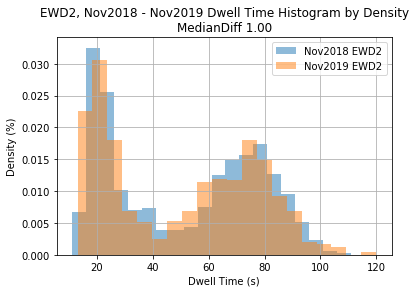

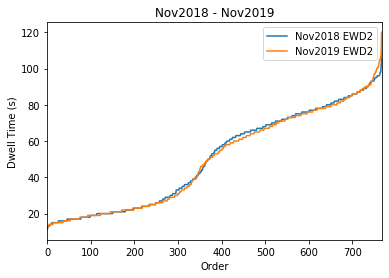


Platform Name EWD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    792.000000
mean      26.059343
std        7.491943
min       13.000000
25%       22.000000
50%       25.000000
75%       29.000000
max      101.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    792.000000
mean      27.566919
std        7.248039
min       14.000000
25%       23.000000
50%       26.000000
75%       31.000000
max       69.000000
Name: time, dtype: float64
KS two-sample test pValue 4.489894442939686e-05
Dwell Time Decrease IS Signficiant


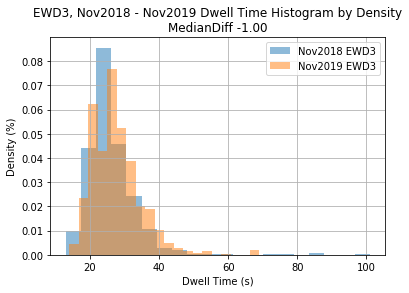

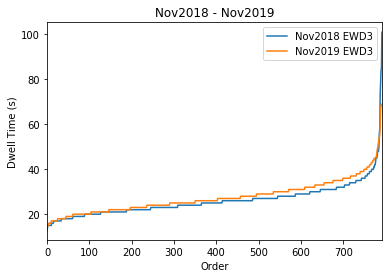


Platform Name EWD4

Platform Name FLD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    647.000000
mean      29.863988
std       11.862736
min       14.000000
25%       22.000000
50%       26.000000
75%       34.000000
max      112.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    647.000000
mean      31.927357
std       12.643087
min       13.000000
25%       23.500000
50%       28.000000
75%       38.000000
max       99.000000
Name: time, dtype: float64
KS two-sample test pValue 0.002900269096266374
Dwell Time Decrease IS Signficiant


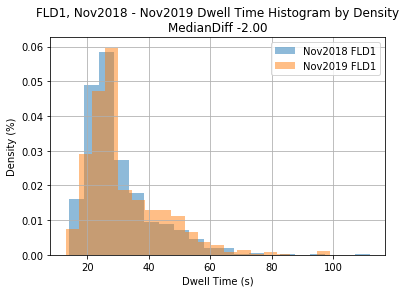

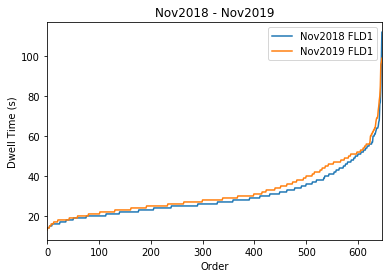


Platform Name FLD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    677.000000
mean      29.116691
std       10.918592
min       13.000000
25%       22.000000
50%       26.000000
75%       33.000000
max       93.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    677.000000
mean      29.651403
std       10.208024
min       12.000000
25%       23.000000
50%       27.000000
75%       34.000000
max       92.000000
Name: time, dtype: float64
KS two-sample test pValue 0.16693980132522723
Dwell Time Decrease NOT Signficiant


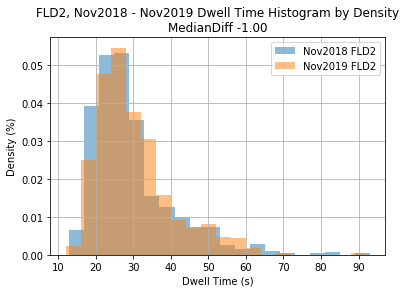

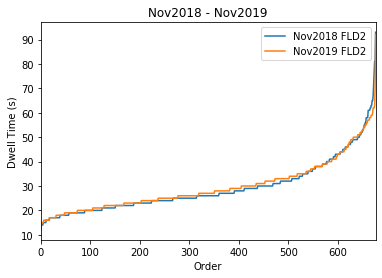


Platform Name FLM1

Platform Name FLM2

Platform Name FLM3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    674.000000
mean      21.301187
std        5.344570
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    674.000000
mean      21.087537
std        5.909400
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5610598921402171
Dwell Time Decrease NOT Signficiant


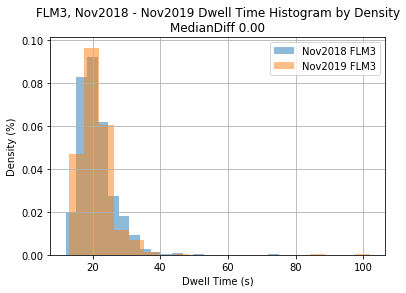

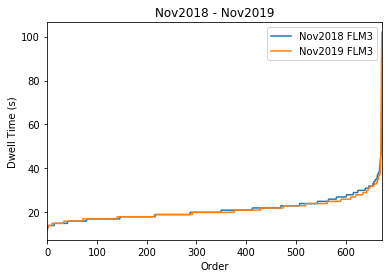


Platform Name FLM4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    631.000000
mean      22.438986
std        8.250195
min       13.000000
25%       18.000000
50%       21.000000
75%       24.000000
max      106.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    631.000000
mean      23.670365
std        8.334232
min       13.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       98.000000
Name: time, dtype: float64
KS two-sample test pValue 2.1441813672301588e-06
Dwell Time Decrease IS Signficiant


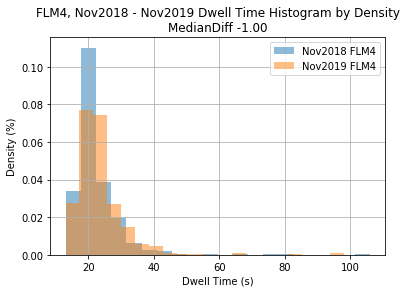

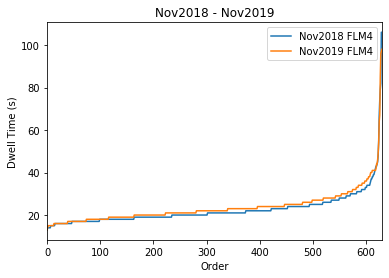


Platform Name GFD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    201.000000
mean      90.606965
std       23.339018
min       15.000000
25%       88.000000
50%       98.000000
75%      104.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    201.000000
mean      83.174129
std       28.065896
min       14.000000
25%       76.000000
50%       94.000000
75%      101.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.030346521742401992
Dwell Time Increase IS Signficiant


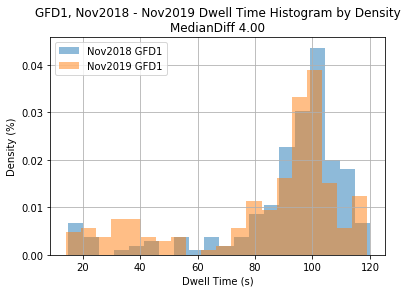

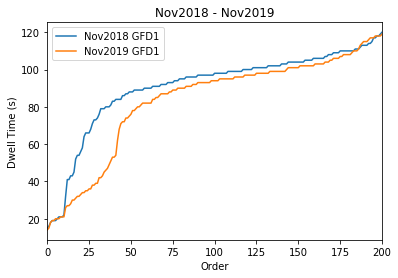


Platform Name GFD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    309.000000
mean      52.245955
std       36.096790
min       11.000000
25%       22.000000
50%       37.000000
75%       88.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    309.000000
mean      44.022654
std       29.237987
min       12.000000
25%       22.000000
50%       34.000000
75%       53.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.008615545724790466
Dwell Time Increase IS Signficiant


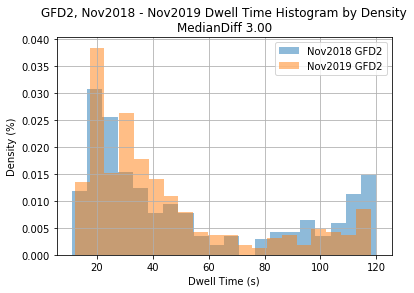

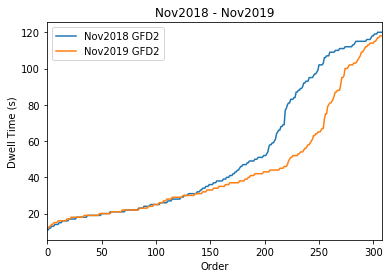


Platform Name GFD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    455.000000
mean      51.997802
std       33.088621
min       14.000000
25%       24.000000
50%       38.000000
75%       79.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    455.000000
mean      55.052747
std       33.519366
min       15.000000
25%       27.000000
50%       42.000000
75%       82.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.02833201538498947
Dwell Time Decrease IS Signficiant


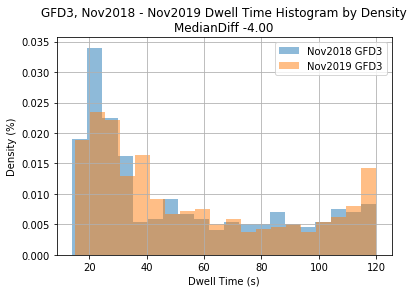

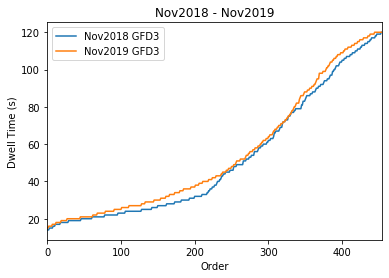


Platform Name GFD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    190.000000
mean      64.257895
std       35.355516
min       14.000000
25%       26.250000
50%       62.500000
75%       97.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    190.000000
mean      63.705263
std       33.307410
min       13.000000
25%       32.000000
50%       65.000000
75%       93.500000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5118487042022548
Dwell Time Decrease NOT Signficiant


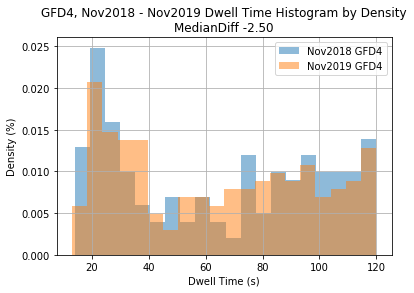

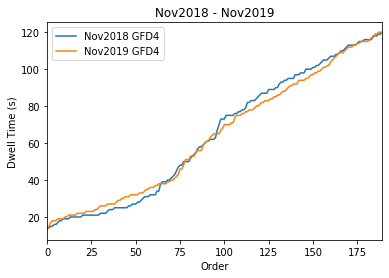


Platform Name GLD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    644.000000
mean      32.391304
std       15.425000
min       11.000000
25%       20.000000
50%       27.000000
75%       44.250000
max       95.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    644.000000
mean      34.200311
std       16.139225
min       11.000000
25%       21.000000
50%       29.000000
75%       48.000000
max      101.000000
Name: time, dtype: float64
KS two-sample test pValue 0.23839469420327586
Dwell Time Decrease NOT Signficiant


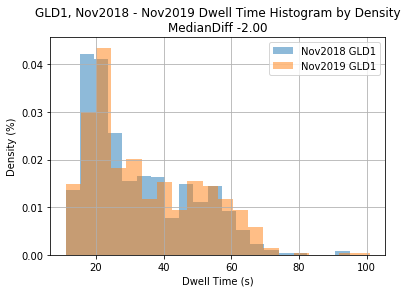

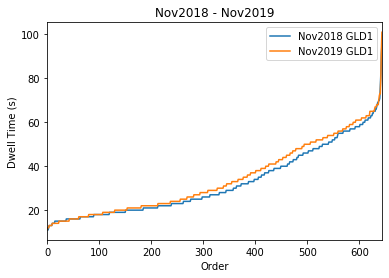


Platform Name GLD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    683.000000
mean      22.149341
std        7.676254
min       12.000000
25%       18.000000
50%       20.000000
75%       24.000000
max      112.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    683.000000
mean      22.994143
std        7.690682
min       13.000000
25%       19.000000
50%       21.000000
75%       25.000000
max      106.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0238161331398564
Dwell Time Decrease IS Signficiant


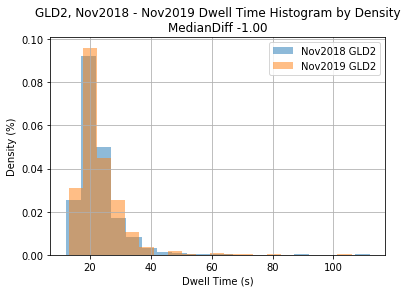

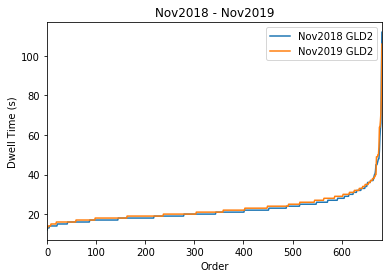


Platform Name GQU1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    871.000000
mean      25.414466
std        6.656203
min       13.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    871.000000
mean      25.788749
std        5.633554
min       14.000000
25%       22.000000
50%       25.000000
75%       28.000000
max       55.000000
Name: time, dtype: float64
KS two-sample test pValue 0.062025097978159464
Dwell Time Decrease NOT Signficiant


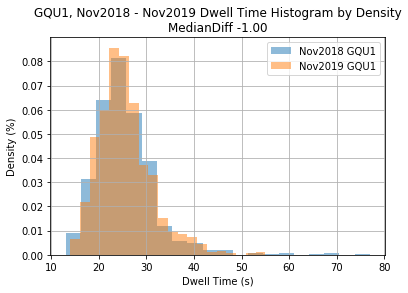

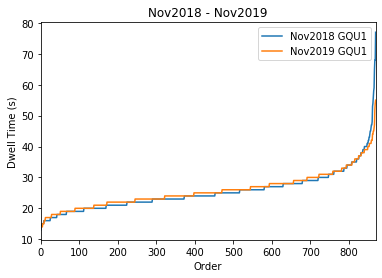


Platform Name GQU2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    880.000000
mean      23.704545
std        5.459040
min       12.000000
25%       20.000000
50%       23.000000
75%       26.000000
max       50.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    880.000000
mean      25.622727
std        7.333184
min       13.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 3.5822916454917404e-05
Dwell Time Decrease IS Signficiant


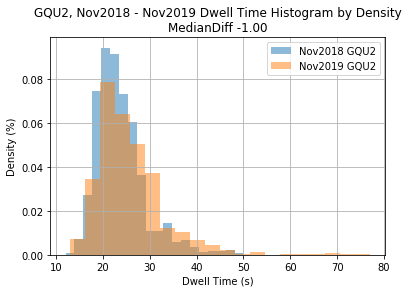

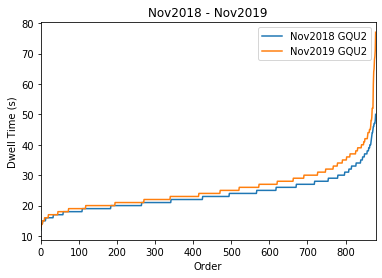


Platform Name GRD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1161.000000
mean       24.646856
std        10.793645
min        11.000000
25%        17.000000
50%        21.000000
75%        28.000000
max       110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1161.000000
mean       29.652885
std        12.020281
min        12.000000
25%        21.000000
50%        27.000000
75%        36.000000
max       118.000000
Name: time, dtype: float64
KS two-sample test pValue 9.385454298805522e-38
Dwell Time Decrease IS Signficiant


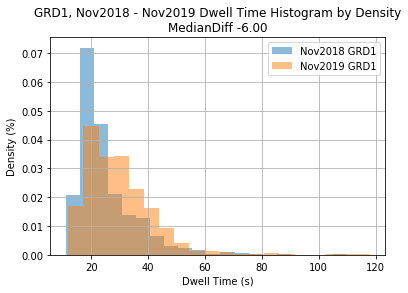

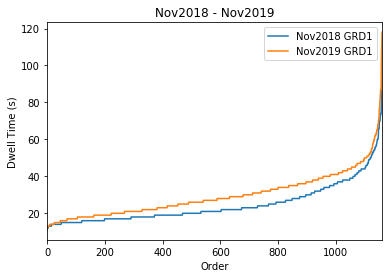


Platform Name GRD2

Platform Name GRD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1148.000000
mean       32.365854
std        17.023199
min        13.000000
25%        21.000000
50%        26.000000
75%        38.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1148.000000
mean       45.060105
std        19.394425
min        14.000000
25%        28.000000
50%        43.000000
75%        60.000000
max       104.000000
Name: time, dtype: float64
KS two-sample test pValue 5.302369112657309e-54
Dwell Time Decrease IS Signficiant


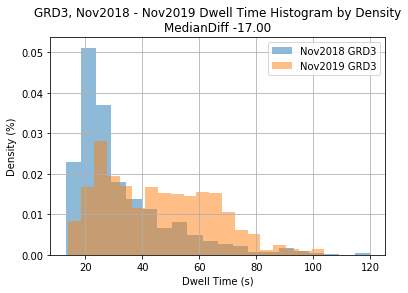

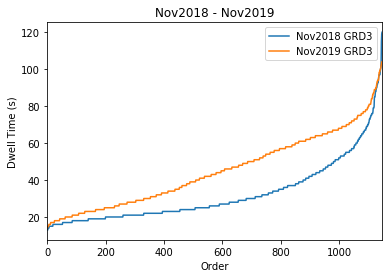


Platform Name GVL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    69.000000
mean     27.304348
std       7.924839
min      18.000000
25%      22.000000
50%      26.000000
75%      31.000000
max      65.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    69.000000
mean     30.159420
std      13.274947
min      13.000000
25%      22.000000
50%      29.000000
75%      33.000000
max      92.000000
Name: time, dtype: float64
KS two-sample test pValue 0.11689366527741817
Dwell Time Decrease NOT Signficiant


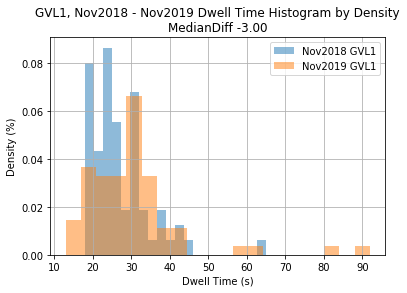

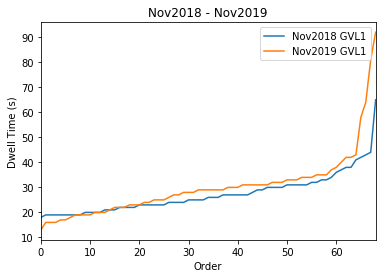


Platform Name GVL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     92.000000
mean      27.423913
std       16.218449
min       15.000000
25%       20.000000
50%       23.000000
75%       26.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    92.000000
mean     29.163043
std      16.389005
min      15.000000
25%      19.750000
50%      22.000000
75%      30.250000
max      87.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6515379403106726
Dwell Time Increase NOT Signficiant


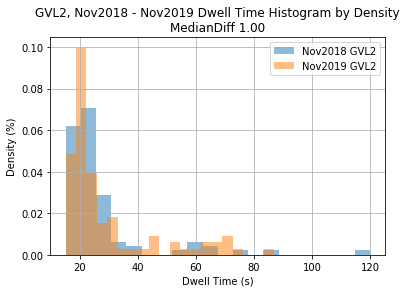

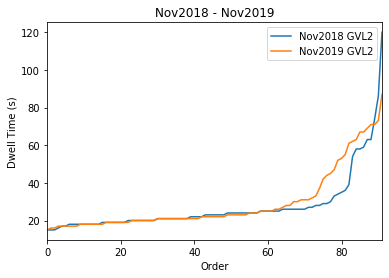


Platform Name GVL3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    824.000000
mean      24.311893
std        7.731902
min       11.000000
25%       20.000000
50%       23.000000
75%       26.000000
max      108.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    824.000000
mean      25.634709
std        7.494595
min       14.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       92.000000
Name: time, dtype: float64
KS two-sample test pValue 4.99176090986229e-06
Dwell Time Decrease IS Signficiant


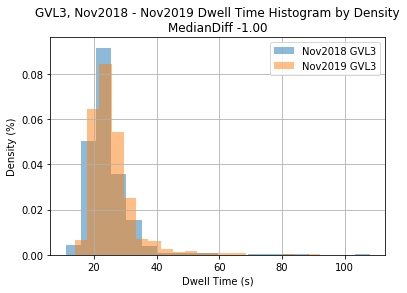

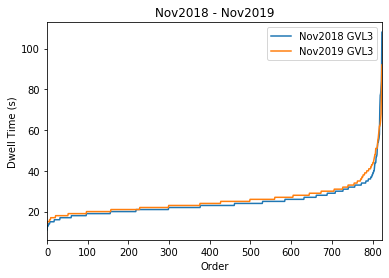


Platform Name GVL4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    829.000000
mean      29.741858
std       15.896509
min       14.000000
25%       21.000000
50%       24.000000
75%       30.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    829.000000
mean      29.519903
std       14.206080
min       16.000000
25%       22.000000
50%       25.000000
75%       31.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.022443811234086952
Dwell Time Decrease IS Signficiant


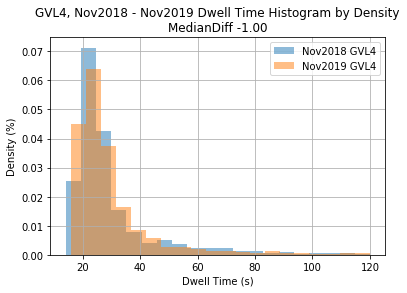

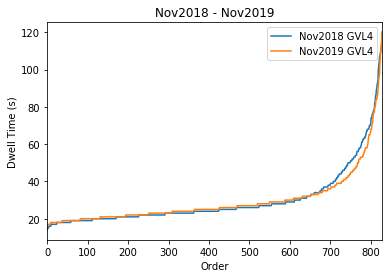


Platform Name HBY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    637.000000
mean      53.897959
std       24.923984
min       11.000000
25%       36.000000
50%       48.000000
75%       69.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    637.000000
mean      50.814757
std       22.573505
min       13.000000
25%       34.000000
50%       45.000000
75%       63.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0721506132675103
Dwell Time Increase NOT Signficiant


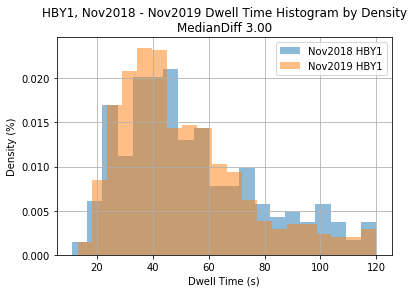

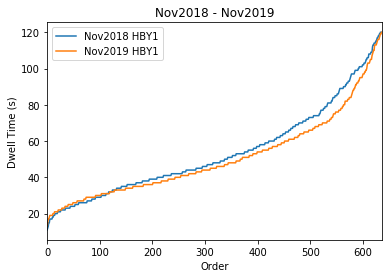


Platform Name HBY2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    446.000000
mean      75.313901
std       25.340116
min       17.000000
25%       59.000000
50%       68.500000
75%       97.750000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    446.000000
mean      71.260090
std       24.606833
min       20.000000
25%       54.000000
50%       65.000000
75%       92.750000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0017486758672466177
Dwell Time Increase IS Signficiant


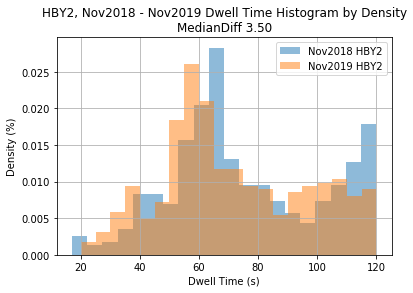

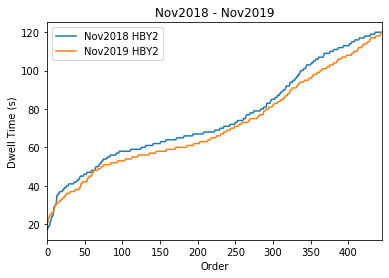


Platform Name HBY3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     48.0000
mean      78.5000
std       29.0275
min       17.0000
25%       62.2500
50%       81.5000
75%      101.0000
max      120.0000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     48.000000
mean      55.166667
std       29.145514
min       11.000000
25%       32.250000
50%       51.000000
75%       81.750000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00016540848551374775
Dwell Time Increase IS Signficiant


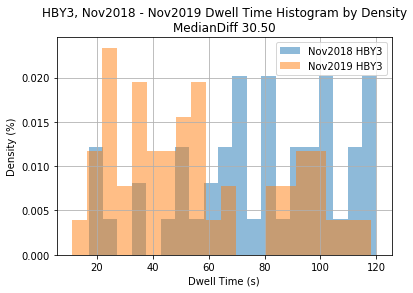

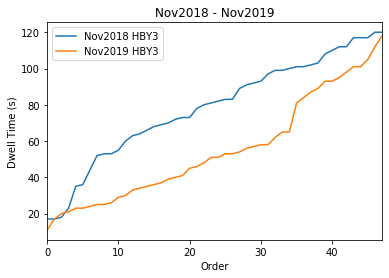


Platform Name HBY4

Platform Name HLW1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    549.000000
mean      21.728597
std        9.565426
min       11.000000
25%       17.000000
50%       19.000000
75%       23.000000
max       86.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    549.000000
mean      21.178506
std        5.949684
min       11.000000
25%       17.000000
50%       20.000000
75%       24.000000
max       57.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0499783633629329
Dwell Time Decrease IS Signficiant


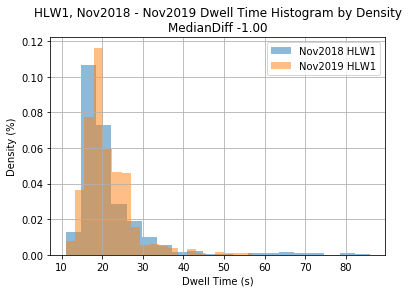

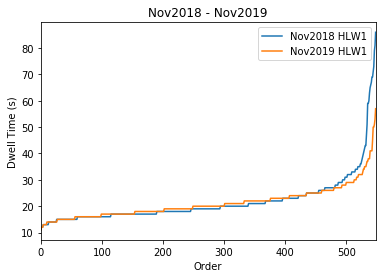


Platform Name HLW2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    556.000000
mean      23.615108
std        6.380945
min       13.000000
25%       19.000000
50%       22.000000
75%       27.000000
max       64.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    556.000000
mean      26.194245
std       10.008377
min       14.000000
25%       20.000000
50%       24.000000
75%       30.000000
max      107.000000
Name: time, dtype: float64
KS two-sample test pValue 0.000175411071160457
Dwell Time Decrease IS Signficiant


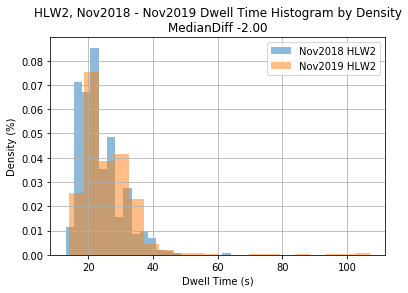

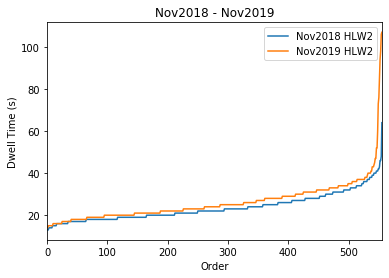


Platform Name HOM2

Platform Name HOM3

Platform Name HOM4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    248.000000
mean      21.790323
std        5.459122
min       13.000000
25%       19.000000
50%       21.000000
75%       24.000000
max       57.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    248.000000
mean      21.504032
std        4.684368
min       13.000000
25%       18.000000
50%       21.000000
75%       23.000000
max       44.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9880178846826205
Dwell Time Decrease NOT Signficiant


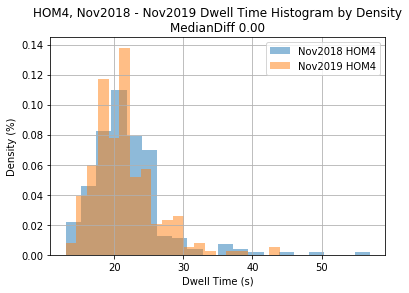

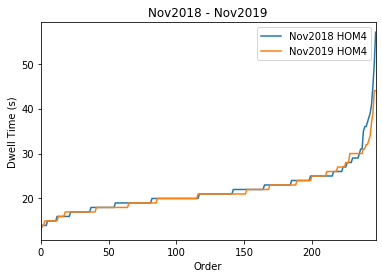


Platform Name HOM6

Platform Name HOM7
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    191.000000
mean      24.994764
std        7.081107
min       15.000000
25%       21.000000
50%       24.000000
75%       27.000000
max       90.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    191.000000
mean      27.167539
std        7.538197
min       15.000000
25%       23.000000
50%       26.000000
75%       30.000000
max       73.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0006720162895476836
Dwell Time Decrease IS Signficiant


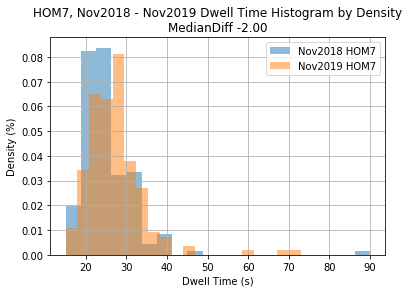

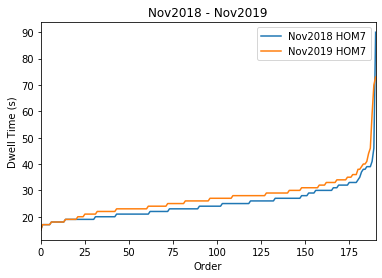


Platform Name HPK1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count     53.000000
mean      20.471698
std       13.940262
min       13.000000
25%       16.000000
50%       18.000000
75%       20.000000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    53.000000
mean     24.811321
std      14.926817
min      11.000000
25%      17.000000
50%      19.000000
75%      27.000000
max      87.000000
Name: time, dtype: float64
KS two-sample test pValue 0.20483478586787635
Dwell Time Decrease NOT Signficiant


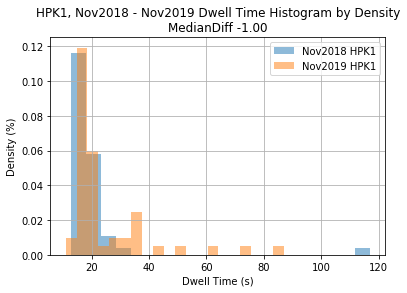

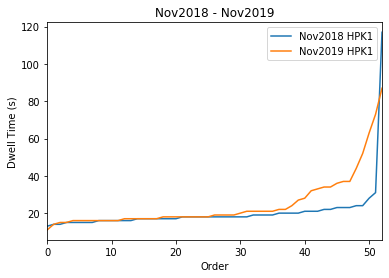


Platform Name HPK2

Platform Name HPK3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    453.000000
mean      22.384106
std       11.334922
min       12.000000
25%       17.000000
50%       20.000000
75%       23.000000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    453.000000
mean      23.942605
std       12.802145
min       11.000000
25%       18.000000
50%       20.000000
75%       24.000000
max      110.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3526627111086215
Dwell Time Decrease NOT Signficiant


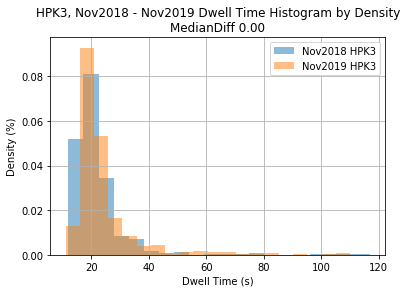

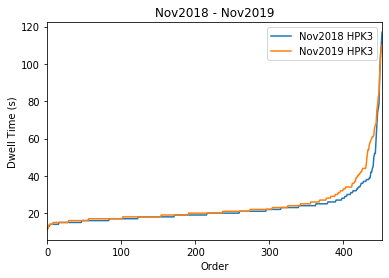


Platform Name HPK4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    459.000000
mean      28.954248
std       19.830397
min       13.000000
25%       18.000000
50%       21.000000
75%       31.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    459.000000
mean      27.677560
std       17.260923
min       11.000000
25%       18.000000
50%       21.000000
75%       29.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6680186364936206
Dwell Time Decrease NOT Signficiant


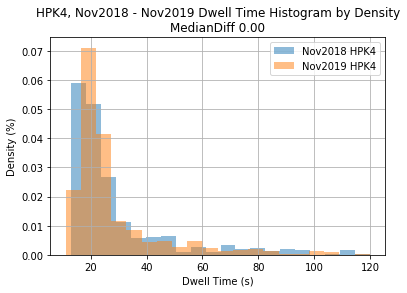

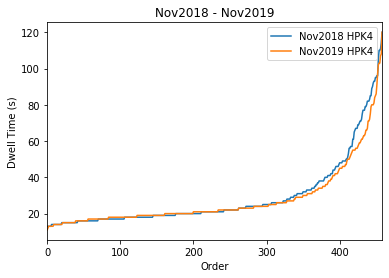


Platform Name HRL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    495.000000
mean      31.842424
std       11.787054
min       12.000000
25%       21.000000
50%       32.000000
75%       40.000000
max       73.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    495.000000
mean      29.404040
std       11.686803
min       11.000000
25%       20.000000
50%       27.000000
75%       39.000000
max       73.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0027992537675133903
Dwell Time Increase IS Signficiant


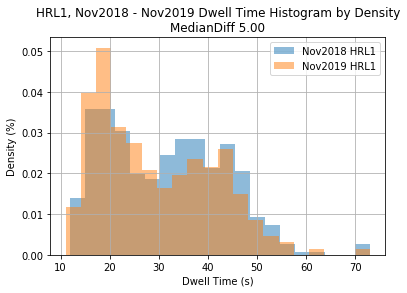

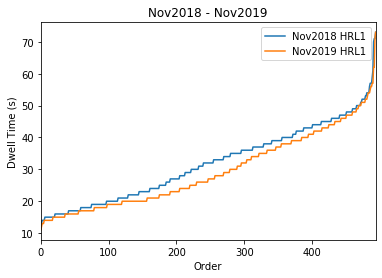


Platform Name HRL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    539.000000
mean      23.556586
std        7.576257
min       12.000000
25%       18.000000
50%       22.000000
75%       28.000000
max       71.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    539.000000
mean      27.076067
std        7.389569
min       13.000000
25%       21.500000
50%       27.000000
75%       31.000000
max       72.000000
Name: time, dtype: float64
KS two-sample test pValue 2.524344134142042e-13
Dwell Time Decrease IS Signficiant


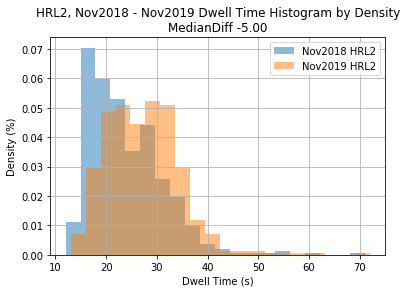

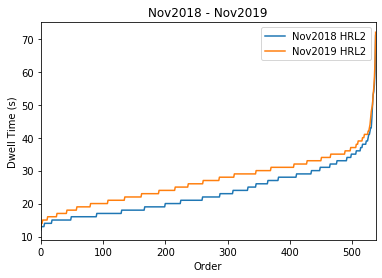


Platform Name ING1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    567.000000
mean      35.553792
std       13.300822
min       13.000000
25%       24.500000
50%       35.000000
75%       45.000000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    567.000000
mean      36.063492
std       12.770308
min       12.000000
25%       27.000000
50%       36.000000
75%       44.500000
max      107.000000
Name: time, dtype: float64
KS two-sample test pValue 0.29229474354134
Dwell Time Decrease NOT Signficiant


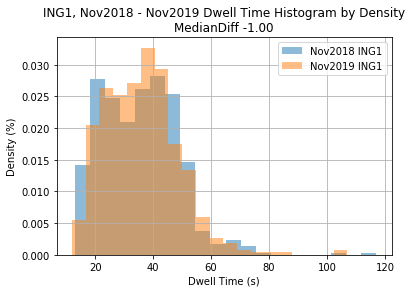

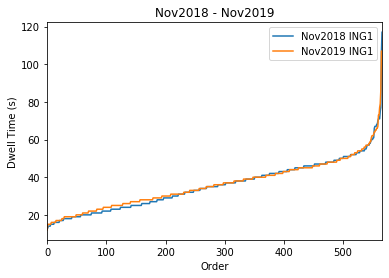


Platform Name ING2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    563.000000
mean      26.619893
std        9.928988
min       12.000000
25%       20.000000
50%       24.000000
75%       31.000000
max       98.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    563.000000
mean      28.586146
std        9.855231
min       13.000000
25%       22.000000
50%       27.000000
75%       33.000000
max      103.000000
Name: time, dtype: float64
KS two-sample test pValue 2.2479650181366936e-05
Dwell Time Decrease IS Signficiant


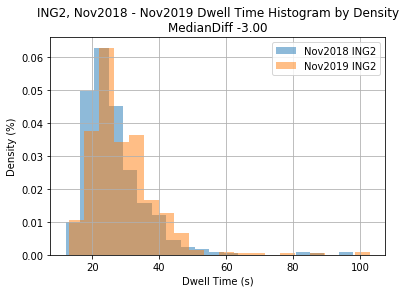

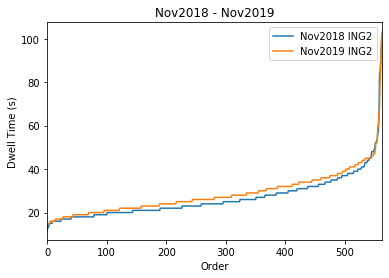


Platform Name KGR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    480.000000
mean      42.137500
std       12.191832
min       14.000000
25%       36.000000
50%       44.000000
75%       51.000000
max       87.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    480.000000
mean      40.706250
std       12.008659
min       13.000000
25%       33.000000
50%       42.000000
75%       49.000000
max       79.000000
Name: time, dtype: float64
KS two-sample test pValue 0.07131730297846899
Dwell Time Increase NOT Signficiant


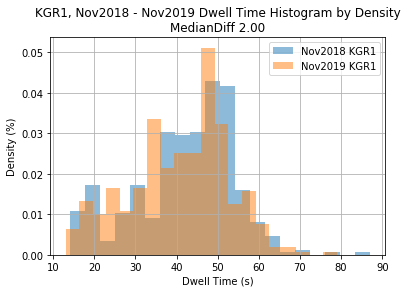

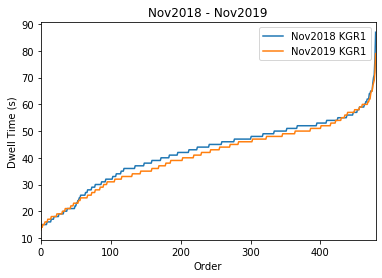


Platform Name KGR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    457.000000
mean      21.901532
std        7.770921
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       66.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    457.000000
mean      21.794311
std        5.521621
min       14.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       47.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3579512156342854
Dwell Time Decrease NOT Signficiant


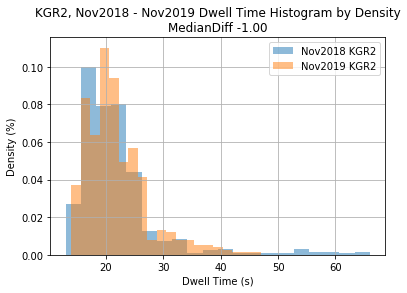

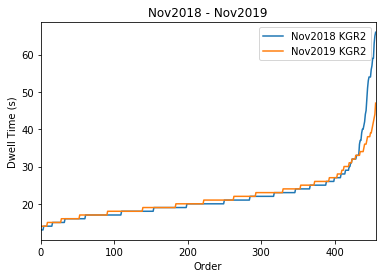


Platform Name KLR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1765.000000
mean       19.661190
std        10.045288
min        11.000000
25%        15.000000
50%        17.000000
75%        20.000000
max       116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1765.000000
mean       18.534278
std         3.747953
min        11.000000
25%        16.000000
50%        18.000000
75%        20.000000
max        44.000000
Name: time, dtype: float64
KS two-sample test pValue 2.418335980012675e-06
Dwell Time Decrease IS Signficiant


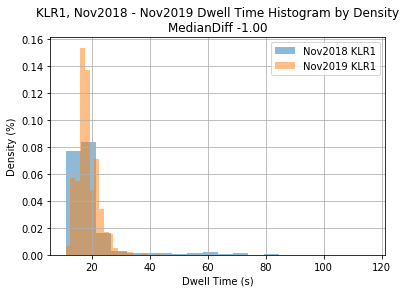

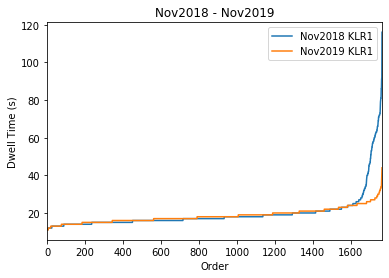


Platform Name KLR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1745.000000
mean       22.290544
std        11.335473
min        10.000000
25%        16.000000
50%        18.000000
75%        22.000000
max       111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1745.000000
mean       18.989685
std         4.234105
min        11.000000
25%        16.000000
50%        18.000000
75%        21.000000
max        52.000000
Name: time, dtype: float64
KS two-sample test pValue 3.641952197358906e-15
Dwell Time Decrease IS Signficiant


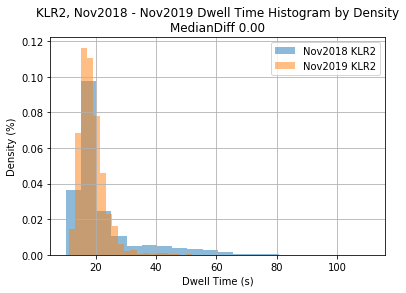

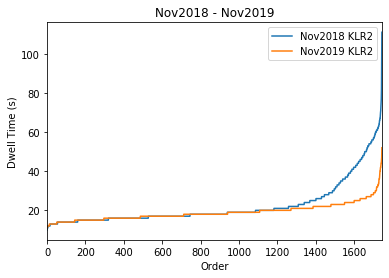


Platform Name KWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    825.000000
mean      22.280000
std       10.456354
min       11.000000
25%       17.000000
50%       19.000000
75%       24.000000
max       90.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    825.000000
mean      22.626667
std        9.521629
min       12.000000
25%       18.000000
50%       20.000000
75%       24.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00020492025325508122
Dwell Time Decrease IS Signficiant


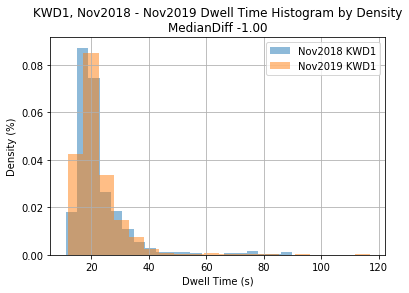

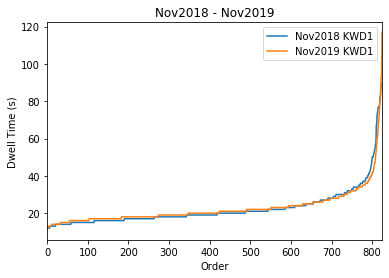


Platform Name KWD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    869.000000
mean      27.398159
std       14.048478
min       12.000000
25%       18.000000
50%       21.000000
75%       33.000000
max      102.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    869.000000
mean      29.811277
std       16.242086
min       12.000000
25%       19.000000
50%       24.000000
75%       34.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 3.93404926953443e-08
Dwell Time Decrease IS Signficiant


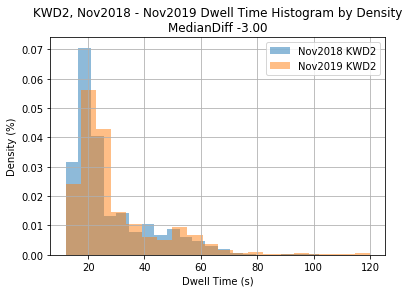

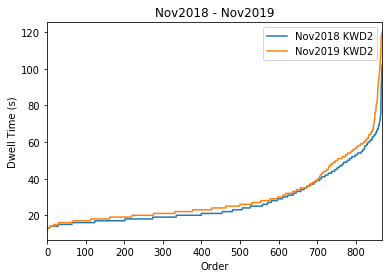


Platform Name LAK1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    567.000000
mean      30.804233
std        9.116179
min       11.000000
25%       24.000000
50%       31.000000
75%       36.000000
max       74.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    567.000000
mean      30.299824
std        8.280104
min       12.000000
25%       24.000000
50%       30.000000
75%       36.000000
max       60.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6404364097383056
Dwell Time Increase NOT Signficiant


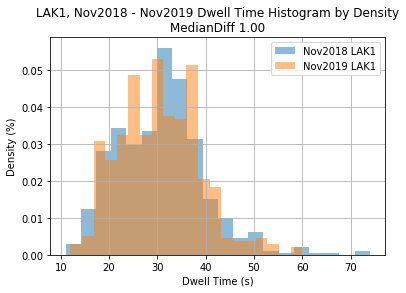

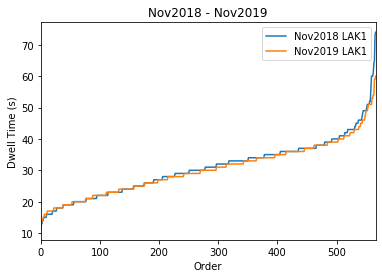


Platform Name LAK2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    573.000000
mean      26.792321
std       10.452213
min       14.000000
25%       20.000000
50%       24.000000
75%       30.000000
max       84.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    573.000000
mean      28.727749
std       11.489850
min       14.000000
25%       22.000000
50%       25.000000
75%       33.000000
max       95.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00010694500806641001
Dwell Time Decrease IS Signficiant


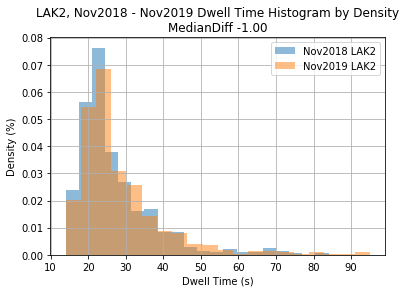

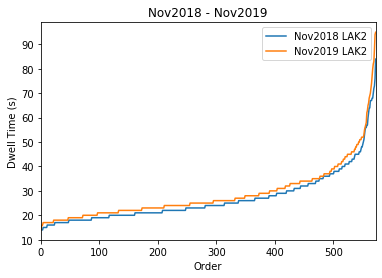


Platform Name LCE1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    735.000000
mean      30.201361
std       11.001498
min       14.000000
25%       24.000000
50%       28.000000
75%       33.000000
max      112.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    735.000000
mean      30.295238
std       10.651843
min       13.000000
25%       25.000000
50%       28.000000
75%       32.500000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.11238117094478174
Dwell Time Decrease NOT Signficiant


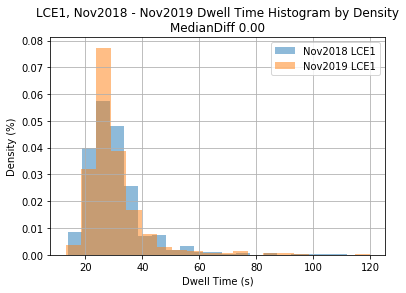

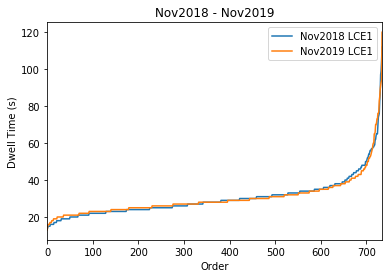


Platform Name LCE2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    707.000000
mean      33.321075
std       12.176122
min       16.000000
25%       26.000000
50%       30.000000
75%       36.000000
max       89.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    707.000000
mean      34.997171
std       11.723079
min       17.000000
25%       28.000000
50%       32.000000
75%       39.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 1.5983835476273118e-05
Dwell Time Decrease IS Signficiant


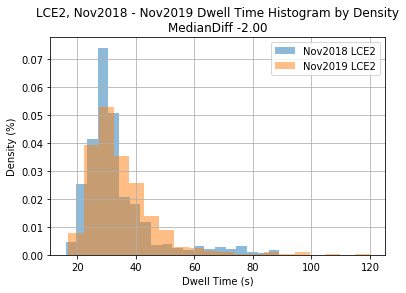

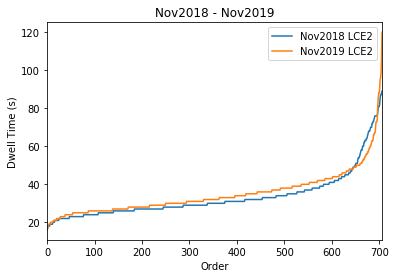


Platform Name LCE3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    799.000000
mean      33.390488
std       12.829720
min       12.000000
25%       24.000000
50%       31.000000
75%       39.000000
max      106.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    799.000000
mean      36.115144
std       12.320867
min       16.000000
25%       27.500000
50%       35.000000
75%       42.000000
max      116.000000
Name: time, dtype: float64
KS two-sample test pValue 2.813219927219028e-08
Dwell Time Decrease IS Signficiant


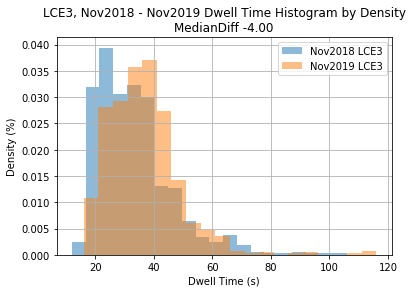

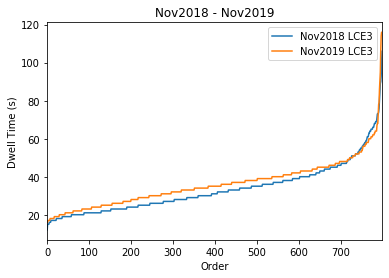


Platform Name LCE4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    813.000000
mean      41.402214
std       15.777684
min       15.000000
25%       30.000000
50%       38.000000
75%       49.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    813.000000
mean      39.309963
std       13.708699
min       16.000000
25%       30.000000
50%       37.000000
75%       45.000000
max      114.000000
Name: time, dtype: float64
KS two-sample test pValue 0.005705190222811562
Dwell Time Increase IS Signficiant


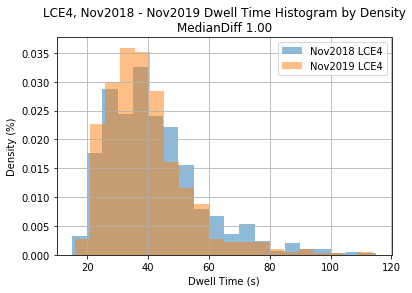

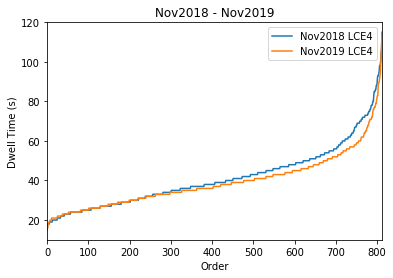


Platform Name LCE5

Platform Name LDF1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1768.000000
mean       19.546946
std         6.167723
min        11.000000
25%        16.000000
50%        18.000000
75%        21.000000
max       117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1768.000000
mean       20.289593
std         4.833839
min        12.000000
25%        17.000000
50%        19.000000
75%        22.000000
max        75.000000
Name: time, dtype: float64
KS two-sample test pValue 7.042379636517349e-10
Dwell Time Decrease IS Signficiant


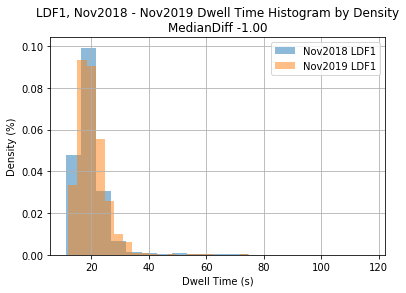

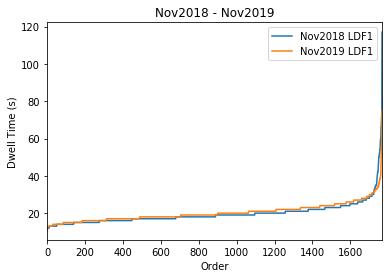


Platform Name LDF2

Platform Name LDF3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1823.000000
mean       18.791004
std         4.592110
min        11.000000
25%        16.000000
50%        18.000000
75%        20.000000
max        91.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1823.000000
mean       21.256720
std         7.721975
min        11.000000
25%        17.000000
50%        20.000000
75%        23.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 3.7812513269185984e-31
Dwell Time Decrease IS Signficiant


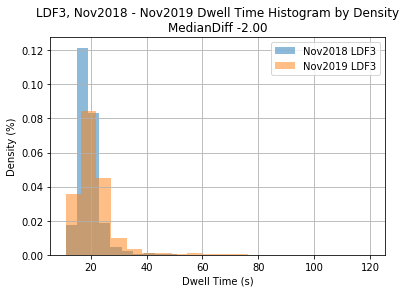

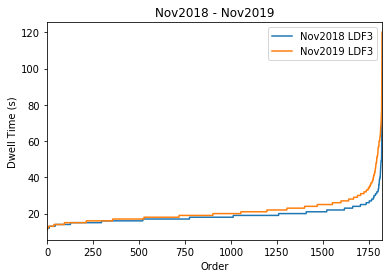


Platform Name LEP1

Platform Name LEP2

Platform Name LEP3

Platform Name LEP4

Platform Name LEW1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    440.0000
mean      21.4000
std        7.5318
min       12.0000
25%       17.0000
50%       19.0000
75%       23.0000
max       86.0000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    440.000000
mean      21.034091
std        5.066862
min       10.000000
25%       17.000000
50%       20.000000
75%       24.000000
max       42.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5300070032660658
Dwell Time Decrease NOT Signficiant


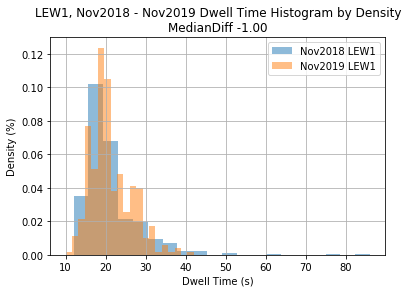

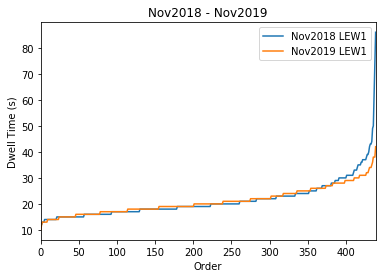


Platform Name LEW2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    418.000000
mean      23.358852
std        7.307263
min       13.000000
25%       19.000000
50%       21.000000
75%       25.000000
max       59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    418.000000
mean      24.796651
std        6.914988
min       14.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       63.000000
Name: time, dtype: float64
KS two-sample test pValue 1.556407379569916e-05
Dwell Time Decrease IS Signficiant


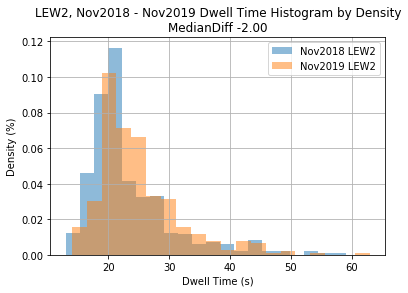

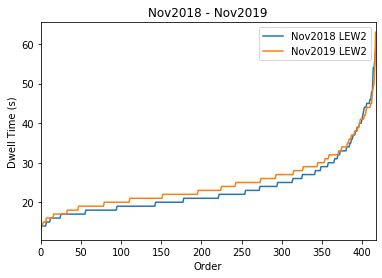


Platform Name LIV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    599.000000
mean      48.437396
std       20.297429
min       13.000000
25%       33.000000
50%       46.000000
75%       60.500000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    599.000000
mean      48.207012
std       18.562933
min       14.000000
25%       34.500000
50%       47.000000
75%       59.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.22959188534445418
Dwell Time Decrease NOT Signficiant


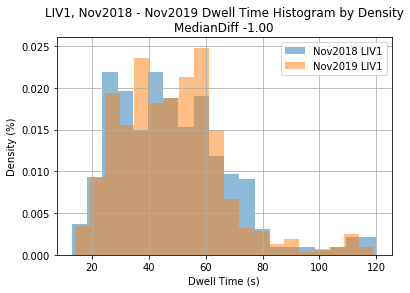

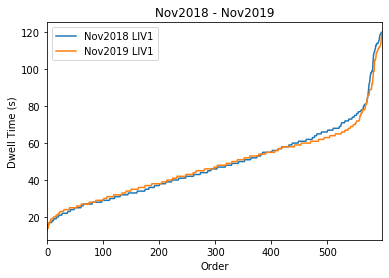


Platform Name LIV2

Platform Name LIV3

Platform Name LIV4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    678.000000
mean      40.830383
std       20.028912
min       14.000000
25%       24.000000
50%       33.000000
75%       60.000000
max      113.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    678.000000
mean      39.750737
std       18.817120
min       14.000000
25%       25.000000
50%       33.000000
75%       56.000000
max      114.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5648985783113307
Dwell Time Decrease NOT Signficiant


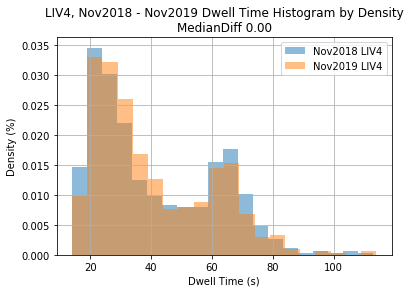

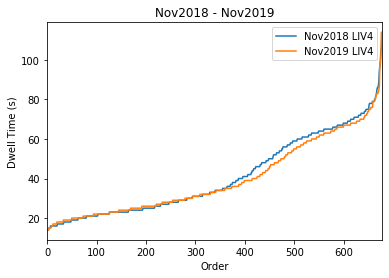


Platform Name LTN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    152.000000
mean      34.348684
std       11.515759
min       12.000000
25%       27.000000
50%       37.000000
75%       42.000000
max       60.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    152.000000
mean      34.914474
std       11.486211
min       11.000000
25%       27.000000
50%       37.000000
75%       42.000000
max       88.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8226725994642933
Dwell Time Decrease NOT Signficiant


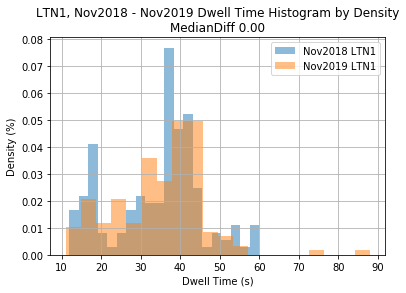

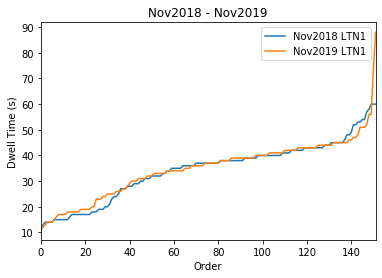


Platform Name LTN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    121.000000
mean      21.677686
std       10.025979
min       11.000000
25%       16.000000
50%       18.000000
75%       22.000000
max       65.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    121.000000
mean      20.553719
std        9.497325
min       12.000000
25%       15.000000
50%       18.000000
75%       22.000000
max       74.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7015902012906106
Dwell Time Decrease NOT Signficiant


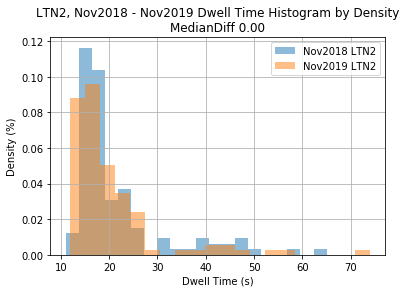

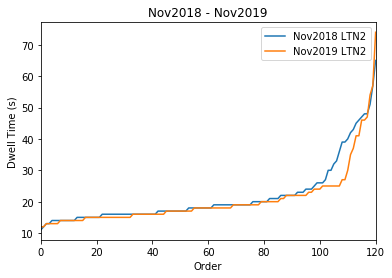


Platform Name LUH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    564.000000
mean      33.159574
std       15.105528
min       11.000000
25%       19.000000
50%       32.500000
75%       45.000000
max      106.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    564.000000
mean      34.714539
std       15.705948
min       12.000000
25%       20.000000
50%       35.000000
75%       46.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 0.22769116938559317
Dwell Time Decrease NOT Signficiant


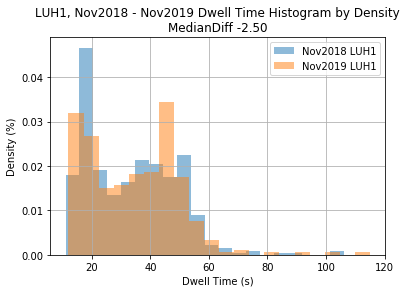

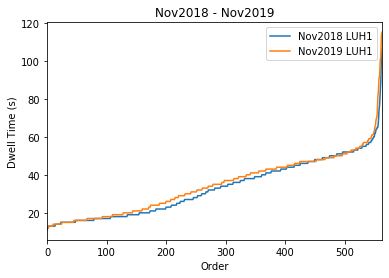


Platform Name LUH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    562.000000
mean      54.772242
std       23.683777
min       14.000000
25%       30.000000
50%       61.000000
75%       74.000000
max      110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    562.000000
mean      55.325623
std       21.697294
min       15.000000
25%       34.250000
50%       61.500000
75%       73.000000
max      107.000000
Name: time, dtype: float64
KS two-sample test pValue 0.08665236606414507
Dwell Time Decrease NOT Signficiant


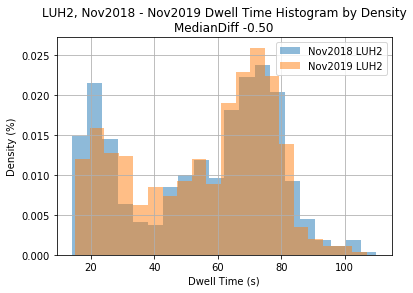

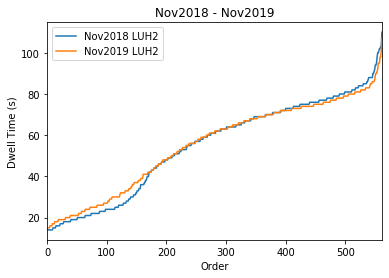


Platform Name MCA1

Platform Name MCA2

Platform Name MCA3

Platform Name MCO1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    874.000000
mean      33.564073
std       11.748652
min       16.000000
25%       25.000000
50%       30.000000
75%       40.000000
max      113.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    874.000000
mean      32.423341
std        9.453168
min       14.000000
25%       26.000000
50%       30.000000
75%       37.000000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0005096561490043071
Dwell Time Decrease IS Signficiant


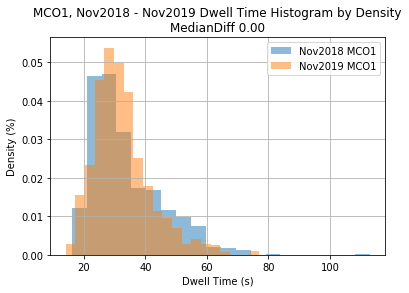

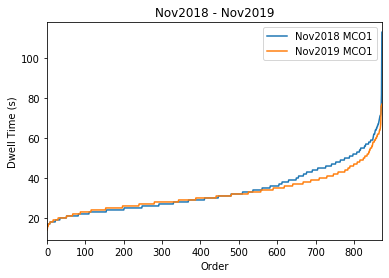


Platform Name MCO2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    871.000000
mean      26.143513
std        6.766301
min       15.000000
25%       22.000000
50%       25.000000
75%       29.000000
max       64.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    871.000000
mean      28.133180
std        7.749271
min       12.000000
25%       23.000000
50%       26.000000
75%       32.000000
max       80.000000
Name: time, dtype: float64
KS two-sample test pValue 2.9753737465114798e-06
Dwell Time Decrease IS Signficiant


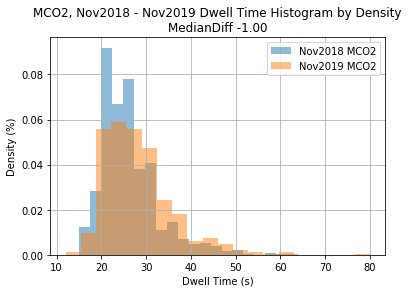

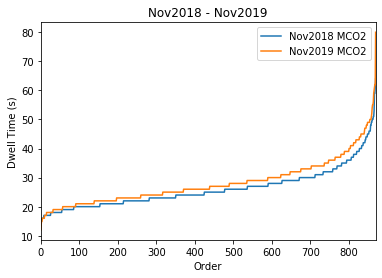


Platform Name MCT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    384.000000
mean      20.380208
std        9.643852
min       12.000000
25%       17.000000
50%       19.000000
75%       22.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    384.000000
mean      19.684896
std        4.773423
min       13.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       70.000000
Name: time, dtype: float64
KS two-sample test pValue 0.735755185914001
Dwell Time Decrease NOT Signficiant


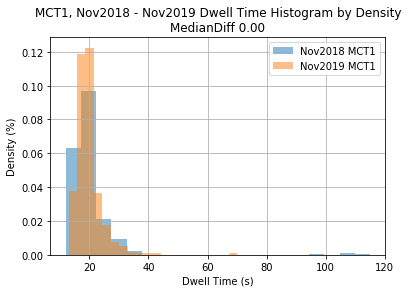

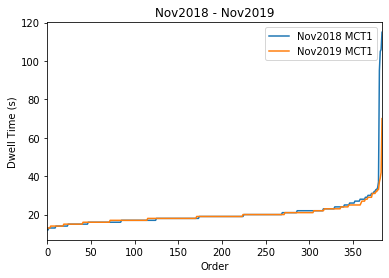


Platform Name MCT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    404.000000
mean      22.084158
std        6.681544
min       13.000000
25%       18.000000
50%       20.000000
75%       25.000000
max       68.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    404.000000
mean      22.022277
std        5.952417
min       13.000000
25%       18.000000
50%       21.000000
75%       25.000000
max       76.000000
Name: time, dtype: float64
KS two-sample test pValue 0.18530898791825812
Dwell Time Decrease NOT Signficiant


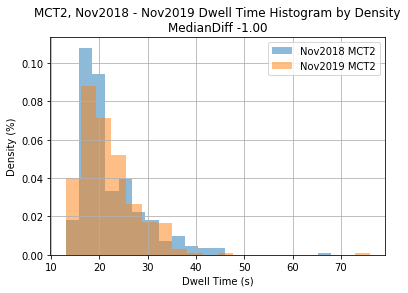

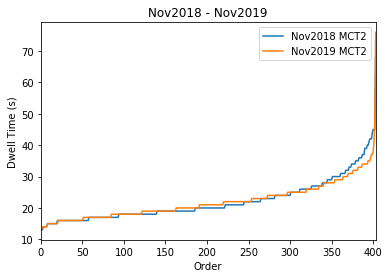


Platform Name MDB1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    862.000000
mean      22.861949
std        8.231732
min       11.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       80.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    862.000000
mean      23.118329
std        7.843854
min       11.000000
25%       19.000000
50%       22.000000
75%       26.000000
max       87.000000
Name: time, dtype: float64
KS two-sample test pValue 0.05981459210075348
Dwell Time Decrease NOT Signficiant


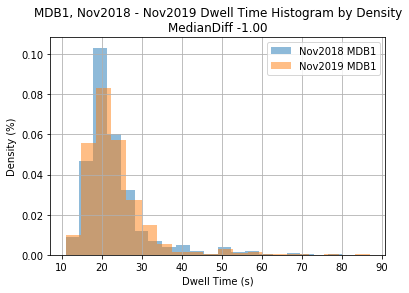

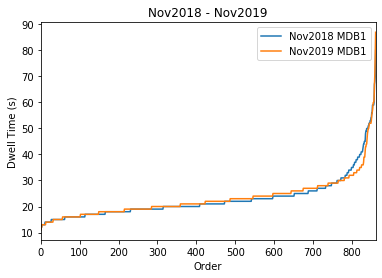


Platform Name MDB2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    881.000000
mean      20.875142
std        5.025420
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    881.000000
mean      23.048808
std        5.572956
min       12.000000
25%       20.000000
50%       22.000000
75%       25.000000
max       58.000000
Name: time, dtype: float64
KS two-sample test pValue 2.540163106040884e-16
Dwell Time Decrease IS Signficiant


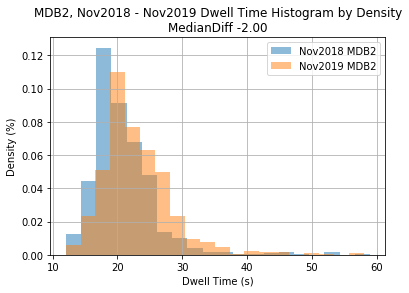

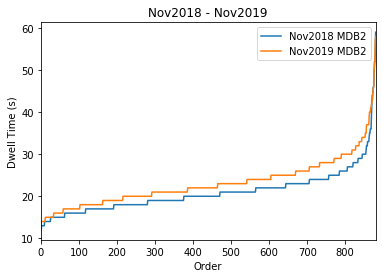


Platform Name MDT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    518.000000
mean      30.615830
std       15.890373
min       13.000000
25%       20.000000
50%       24.500000
75%       35.000000
max       91.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    518.000000
mean      34.250965
std       17.894564
min       12.000000
25%       23.000000
50%       29.000000
75%       38.750000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 2.3629178279207566e-08
Dwell Time Decrease IS Signficiant


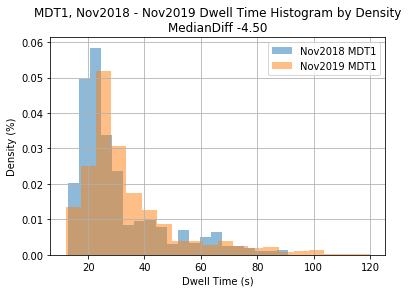

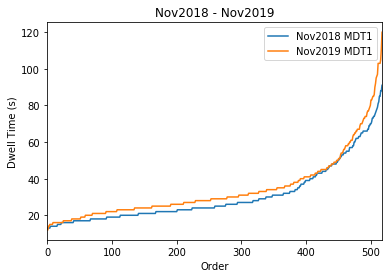


Platform Name MDT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    295.000000
mean      34.091525
std       18.533710
min       12.000000
25%       23.000000
50%       28.000000
75%       37.000000
max      109.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    295.000000
mean      31.288136
std       14.240704
min       13.000000
25%       23.000000
50%       28.000000
75%       34.000000
max      108.000000
Name: time, dtype: float64
KS two-sample test pValue 0.16899613550482942
Dwell Time Decrease NOT Signficiant


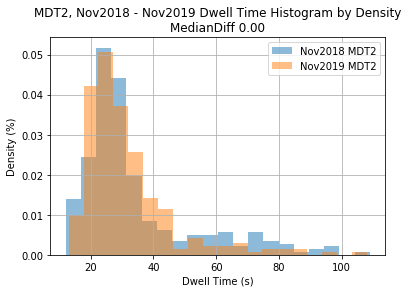

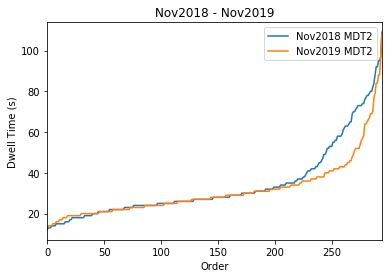


Platform Name MDT3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    119.000000
mean      24.512605
std        7.306679
min       14.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       62.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    119.000000
mean      27.831933
std       14.038880
min       13.000000
25%       19.000000
50%       25.000000
75%       31.500000
max      104.000000
Name: time, dtype: float64
KS two-sample test pValue 0.03403941734274615
Dwell Time Decrease IS Signficiant


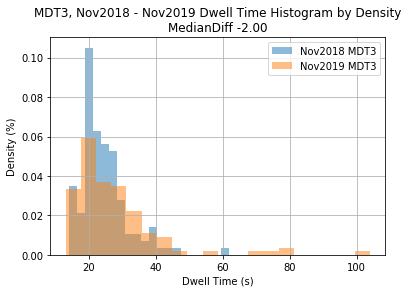

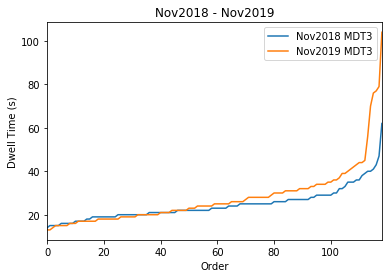


Platform Name MDT4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    745.000000
mean      27.386577
std        9.536480
min       12.000000
25%       22.000000
50%       26.000000
75%       30.000000
max      114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    745.000000
mean      29.963758
std        9.711291
min       13.000000
25%       24.000000
50%       28.000000
75%       34.000000
max      104.000000
Name: time, dtype: float64
KS two-sample test pValue 1.4299675818494928e-08
Dwell Time Decrease IS Signficiant


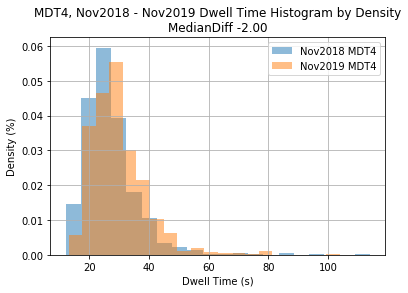

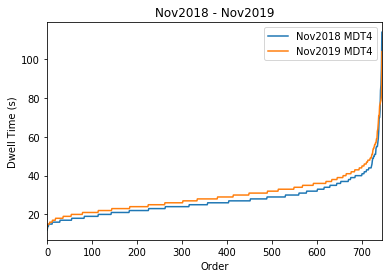


Platform Name MIN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    570.000000
mean      28.264912
std       12.218500
min       12.000000
25%       20.000000
50%       24.000000
75%       34.000000
max       83.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    570.000000
mean      28.084211
std       11.567025
min       13.000000
25%       20.250000
50%       25.000000
75%       32.000000
max       80.000000
Name: time, dtype: float64
KS two-sample test pValue 0.40906318840796896
Dwell Time Decrease NOT Signficiant


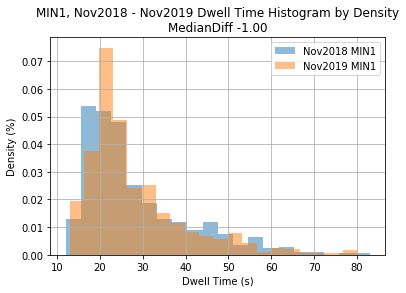

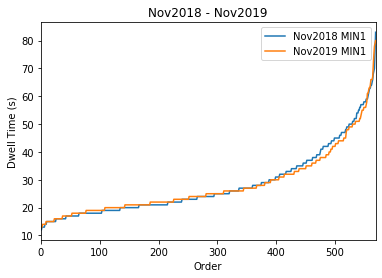


Platform Name MIN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    549.000000
mean      32.692168
std       14.600706
min       12.000000
25%       22.000000
50%       29.000000
75%       41.000000
max      110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    549.000000
mean      32.832423
std       11.923156
min       14.000000
25%       23.000000
50%       31.000000
75%       41.000000
max       84.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0357290476103026
Dwell Time Decrease IS Signficiant


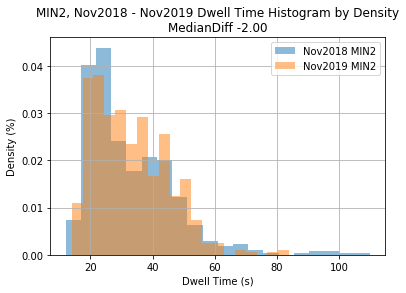

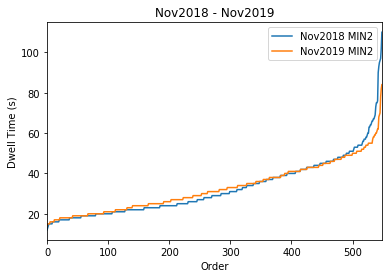


Platform Name MKG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    397.000000
mean      17.274559
std        4.764418
min       11.000000
25%       15.000000
50%       16.000000
75%       18.000000
max       70.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    397.000000
mean      17.453401
std        3.562709
min       11.000000
25%       15.000000
50%       17.000000
75%       19.000000
max       40.000000
Name: time, dtype: float64
KS two-sample test pValue 0.043307128416551266
Dwell Time Decrease IS Signficiant


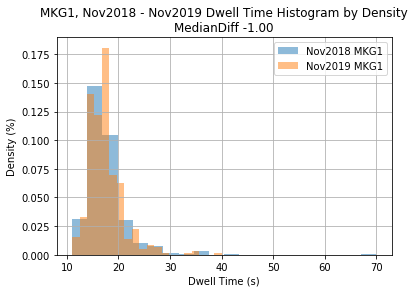

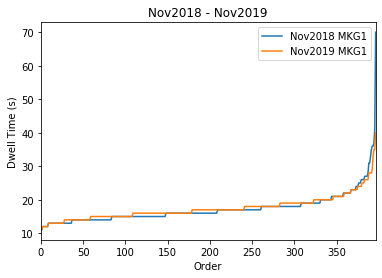


Platform Name MKG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    422.000000
mean      21.274882
std        7.523536
min       13.000000
25%       17.000000
50%       19.000000
75%       23.000000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    422.000000
mean      20.862559
std        4.992638
min       13.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       59.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3537955547803578
Dwell Time Decrease NOT Signficiant


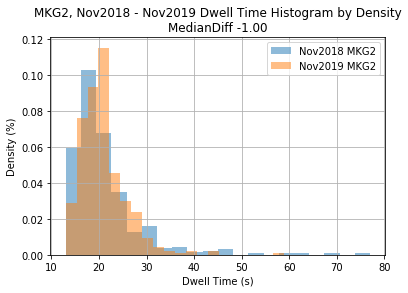

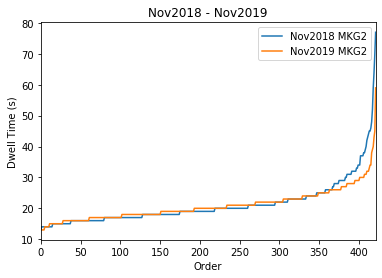


Platform Name MKV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    568.000000
mean      21.568662
std        7.490537
min       11.000000
25%       17.000000
50%       20.000000
75%       23.000000
max       87.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    568.000000
mean      23.329225
std        9.039931
min       12.000000
25%       18.000000
50%       21.000000
75%       25.000000
max       74.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0022836679247057044
Dwell Time Decrease IS Signficiant


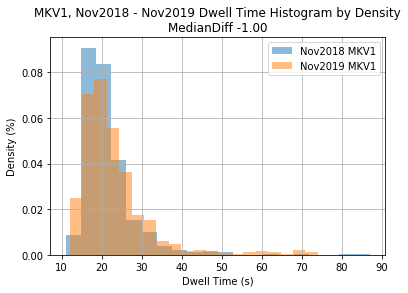

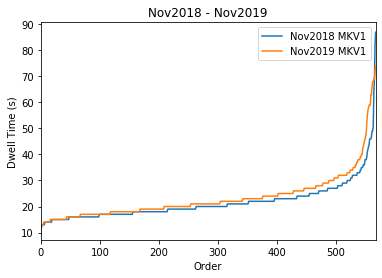


Platform Name MKV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    570.000000
mean      24.847368
std        9.464922
min       13.000000
25%       19.250000
50%       22.000000
75%       27.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    570.000000
mean      27.392982
std        8.772458
min       13.000000
25%       22.000000
50%       25.000000
75%       31.000000
max       76.000000
Name: time, dtype: float64
KS two-sample test pValue 9.679307236193988e-11
Dwell Time Decrease IS Signficiant


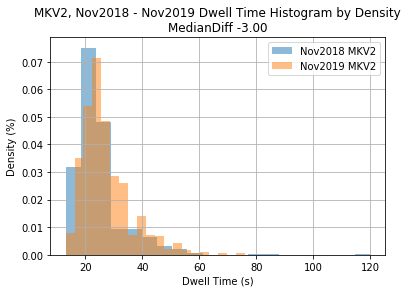

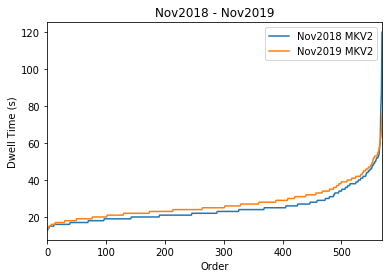


Platform Name MPT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2408.000000
mean       21.542774
std         6.684212
min        12.000000
25%        18.000000
50%        20.000000
75%        24.000000
max       112.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2408.000000
mean       24.174003
std         9.414300
min        11.000000
25%        19.000000
50%        22.000000
75%        26.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 5.184871790145507e-33
Dwell Time Decrease IS Signficiant


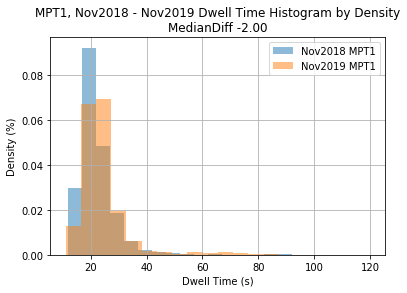

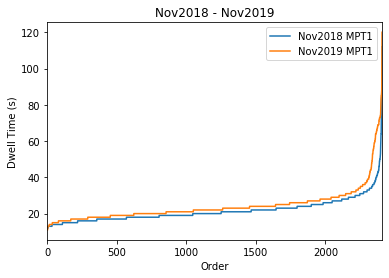


Platform Name MPT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2418.000000
mean       20.848635
std         6.560895
min        10.000000
25%        18.000000
50%        20.000000
75%        22.000000
max       117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2418.000000
mean       27.799421
std        10.789054
min        12.000000
25%        20.000000
50%        24.000000
75%        34.000000
max       113.000000
Name: time, dtype: float64
KS two-sample test pValue 6.656758093124625e-124
Dwell Time Decrease IS Signficiant


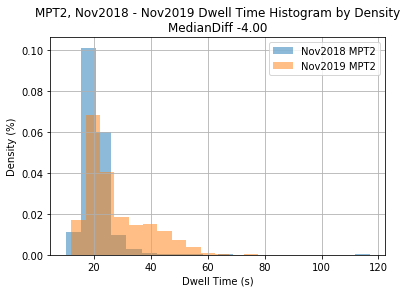

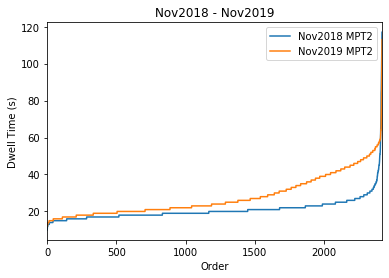


Platform Name MQF1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    547.000000
mean      48.234004
std       16.110769
min       13.000000
25%       41.000000
50%       53.000000
75%       59.000000
max       94.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    547.000000
mean      47.968921
std       15.331172
min       12.000000
25%       39.500000
50%       52.000000
75%       59.000000
max       92.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7194134515930318
Dwell Time Increase NOT Signficiant


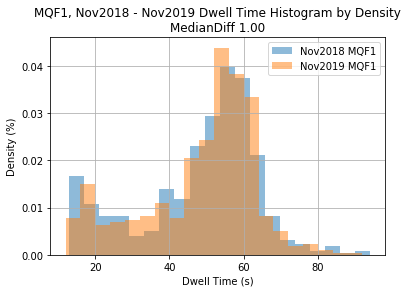

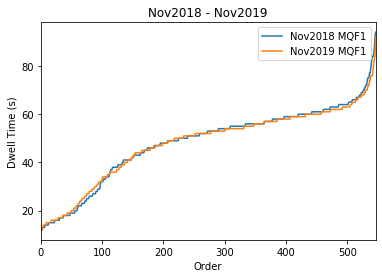


Platform Name MQF2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    553.000000
mean      18.661844
std        6.326240
min       10.000000
25%       16.000000
50%       18.000000
75%       20.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    553.000000
mean      19.569620
std        5.526873
min       12.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       68.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0007499335763958816
Dwell Time Decrease IS Signficiant


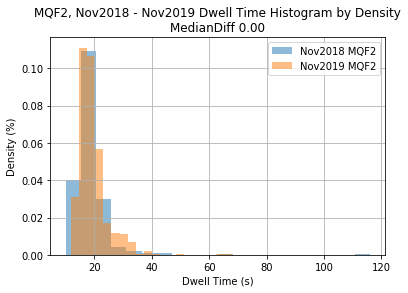

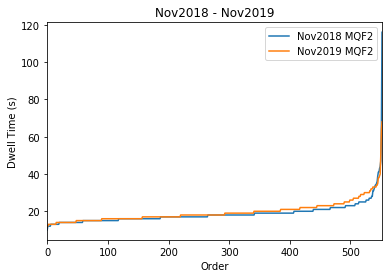


Platform Name MSM1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    937.000000
mean      32.243330
std       11.554614
min       12.000000
25%       23.000000
50%       30.000000
75%       40.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    937.000000
mean      32.690502
std       10.841035
min       13.000000
25%       24.000000
50%       30.000000
75%       40.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.4242773701500468
Dwell Time Decrease NOT Signficiant


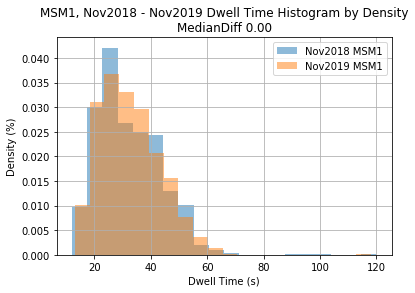

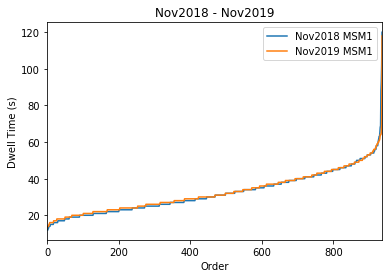


Platform Name MSM2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1429.000000
mean       25.650105
std         9.082837
min        13.000000
25%        20.000000
50%        23.000000
75%        29.000000
max       102.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1429.000000
mean       25.837649
std         7.578457
min        13.000000
25%        20.000000
50%        24.000000
75%        30.000000
max        89.000000
Name: time, dtype: float64
KS two-sample test pValue 0.07145215435796283
Dwell Time Decrease NOT Signficiant


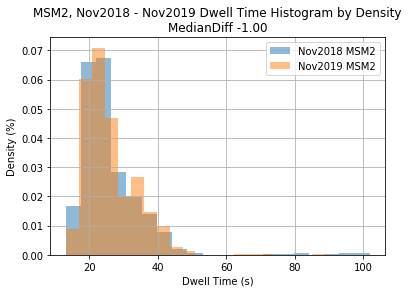

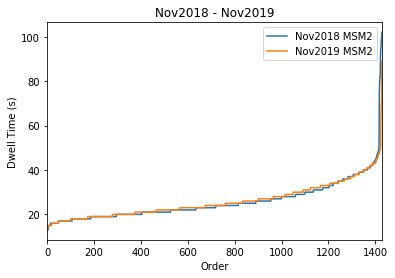


Platform Name MTC1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    402.000000
mean      16.960199
std        4.154547
min       11.000000
25%       15.000000
50%       16.000000
75%       18.000000
max       52.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    402.000000
mean      18.497512
std        4.391245
min       10.000000
25%       16.000000
50%       18.000000
75%       20.000000
max       40.000000
Name: time, dtype: float64
KS two-sample test pValue 1.1730799700794959e-08
Dwell Time Decrease IS Signficiant


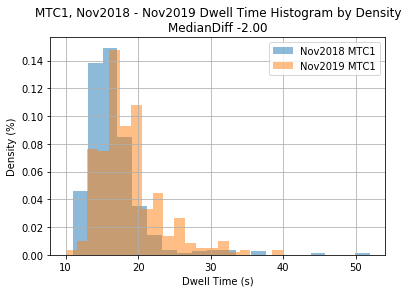

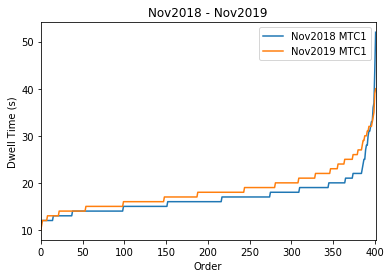


Platform Name MTC2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    421.000000
mean      28.705463
std       13.726710
min       12.000000
25%       18.000000
50%       22.000000
75%       38.000000
max       69.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    421.000000
mean      31.049881
std       13.630319
min       11.000000
25%       20.000000
50%       26.000000
75%       42.000000
max       82.000000
Name: time, dtype: float64
KS two-sample test pValue 1.693663314644341e-05
Dwell Time Decrease IS Signficiant


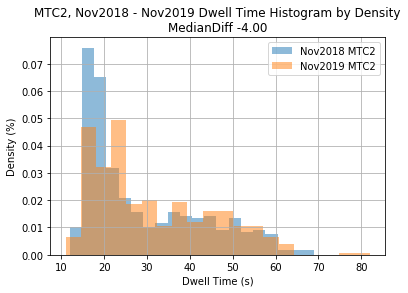

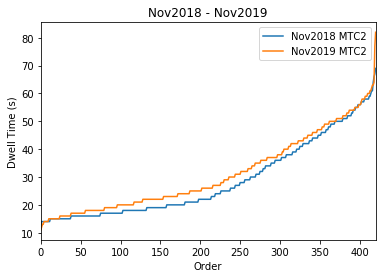


Platform Name MUL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    481.000000
mean      22.432432
std       16.489141
min       11.000000
25%       15.000000
50%       17.000000
75%       22.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    481.000000
mean      21.854470
std       12.417714
min       11.000000
25%       16.000000
50%       18.000000
75%       23.000000
max      114.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0072005179501755745
Dwell Time Decrease IS Signficiant


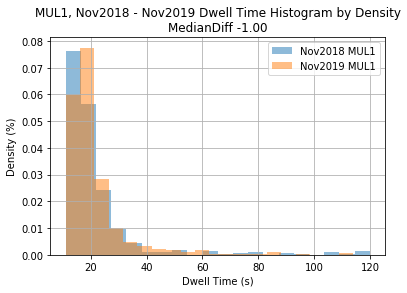

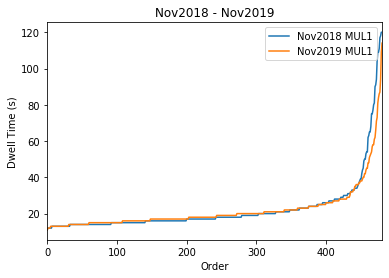


Platform Name MUL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    478.000000
mean      22.384937
std       12.537505
min       11.000000
25%       15.000000
50%       17.000000
75%       23.000000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    478.000000
mean      23.278243
std       13.996705
min       12.000000
25%       16.000000
50%       19.000000
75%       23.000000
max      114.000000
Name: time, dtype: float64
KS two-sample test pValue 0.010662087405134774
Dwell Time Decrease IS Signficiant


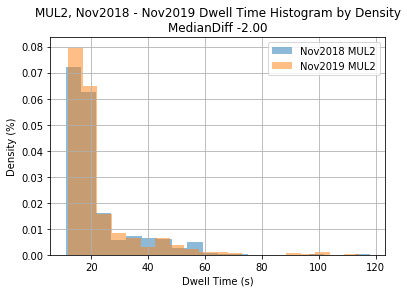

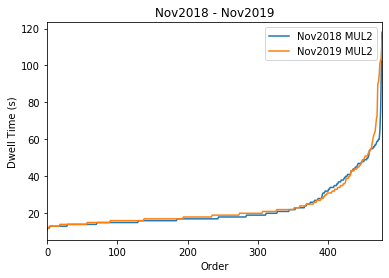


Platform Name MYG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    749.000000
mean      18.711615
std        6.768292
min       10.000000
25%       15.000000
50%       17.000000
75%       20.000000
max       96.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    749.000000
mean      19.931909
std        7.075559
min       11.000000
25%       16.000000
50%       18.000000
75%       22.000000
max      111.000000
Name: time, dtype: float64
KS two-sample test pValue 1.0119741658877026e-07
Dwell Time Decrease IS Signficiant


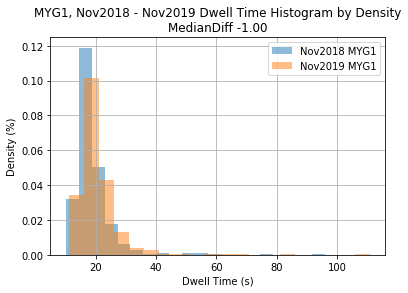

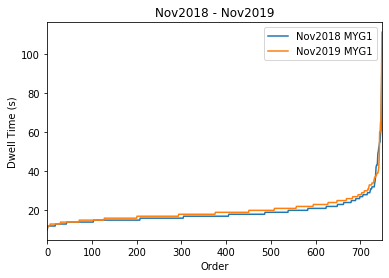


Platform Name MYG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    737.000000
mean      19.295794
std        6.100997
min       12.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    737.000000
mean      20.335142
std        7.590596
min       12.000000
25%       17.000000
50%       19.000000
75%       22.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0005147692817906818
Dwell Time Decrease IS Signficiant


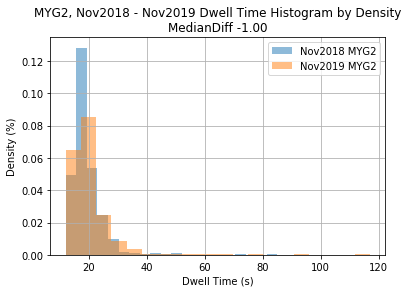

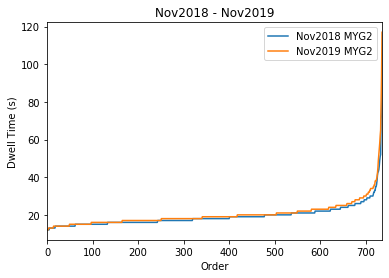


Platform Name MYL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    624.000000
mean      34.099359
std       15.043001
min       15.000000
25%       24.000000
50%       30.000000
75%       37.000000
max       92.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    624.000000
mean      34.801282
std       15.041268
min       14.000000
25%       26.000000
50%       31.000000
75%       37.000000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.042617445072696665
Dwell Time Decrease IS Signficiant


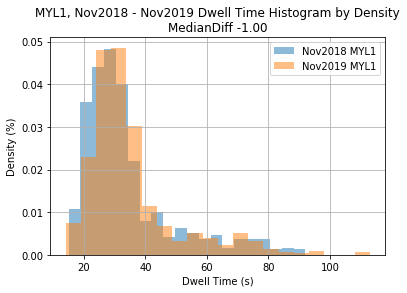

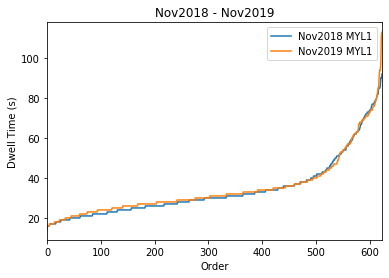


Platform Name MYL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    685.000000
mean      24.216058
std        6.660087
min       14.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       95.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    685.000000
mean      25.388321
std        6.478790
min       14.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       65.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0008288267548613558
Dwell Time Decrease IS Signficiant


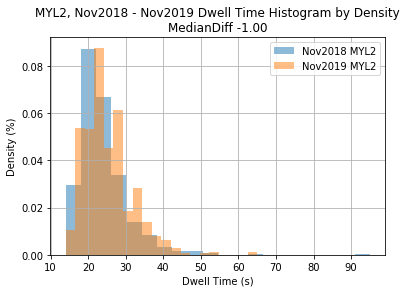

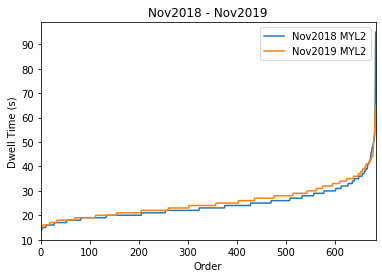


Platform Name Missing

Platform Name NMH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    833.000000
mean      19.683073
std        5.095050
min       12.000000
25%       16.000000
50%       19.000000
75%       22.000000
max       67.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    833.000000
mean      20.040816
std        6.868844
min       11.000000
25%       16.000000
50%       19.000000
75%       22.000000
max       98.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5306519602820238
Dwell Time Decrease NOT Signficiant


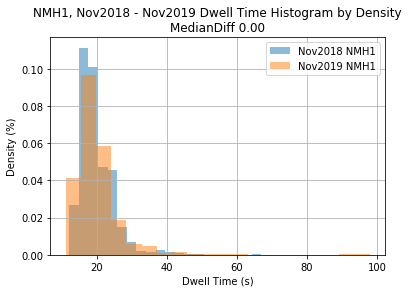

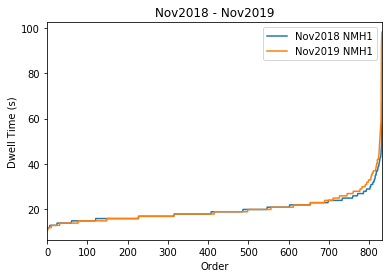


Platform Name NMH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    791.000000
mean      24.384324
std        9.114960
min       11.000000
25%       18.000000
50%       21.000000
75%       29.000000
max       91.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    791.000000
mean      24.887484
std        8.479386
min       12.000000
25%       19.000000
50%       23.000000
75%       29.000000
max       91.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0023597121281895774
Dwell Time Decrease IS Signficiant


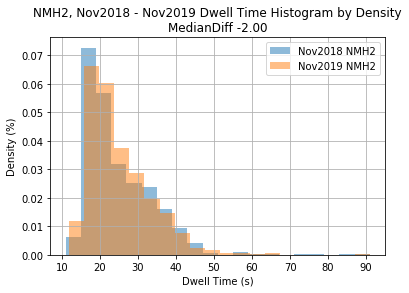

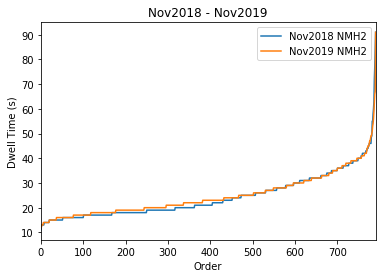


Platform Name NRW1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    463.000000
mean      40.717063
std       14.494658
min       12.000000
25%       29.000000
50%       41.000000
75%       51.000000
max       89.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    463.000000
mean      38.436285
std       14.232293
min       14.000000
25%       26.000000
50%       38.000000
75%       49.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 0.030498875147671037
Dwell Time Increase IS Signficiant


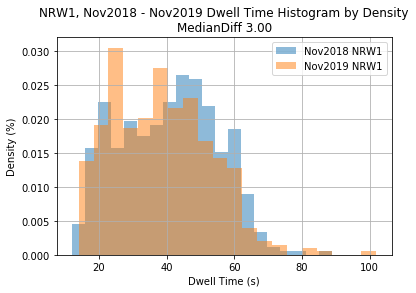

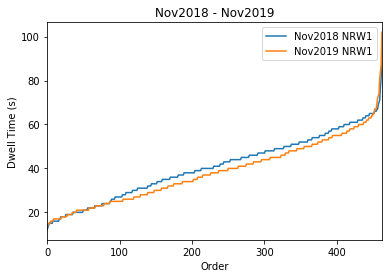


Platform Name NRW2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    440.000000
mean      23.390909
std        8.176410
min       12.000000
25%       19.000000
50%       22.000000
75%       26.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    440.000000
mean      23.975000
std        6.256609
min       14.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       57.000000
Name: time, dtype: float64
KS two-sample test pValue 0.075089631096757
Dwell Time Decrease NOT Signficiant


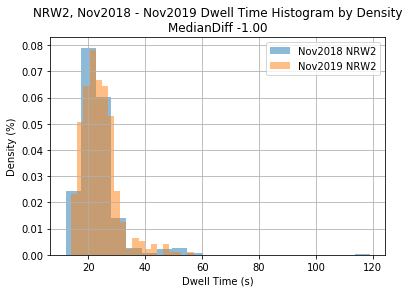

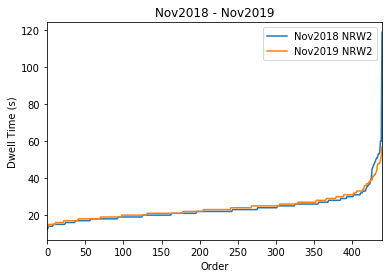


Platform Name NST1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    256.000000
mean      20.933594
std        7.335616
min       12.000000
25%       17.000000
50%       20.000000
75%       23.000000
max       85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    256.000000
mean      21.214844
std        7.351986
min       12.000000
25%       17.000000
50%       19.000000
75%       23.000000
max       74.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9996558847418895
Dwell Time Increase NOT Signficiant


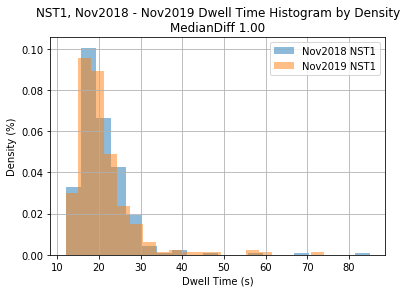

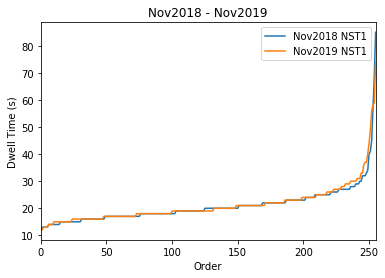


Platform Name NST2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    257.000000
mean      19.529183
std        3.599062
min       13.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       41.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    257.000000
mean      19.743191
std        3.133146
min       14.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       33.000000
Name: time, dtype: float64
KS two-sample test pValue 0.48442746757477007
Dwell Time Decrease NOT Signficiant


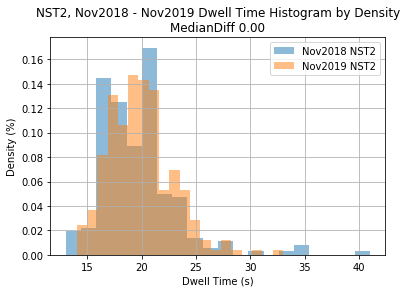

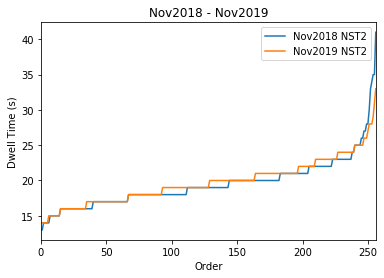


Platform Name NST3

Platform Name NSY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2166.000000
mean       35.701754
std        15.817308
min        11.000000
25%        24.000000
50%        31.000000
75%        42.000000
max       116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2166.000000
mean       66.623730
std        28.549284
min        13.000000
25%        40.000000
50%        65.000000
75%        92.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 6.164236358899258e-232
Dwell Time Decrease IS Signficiant


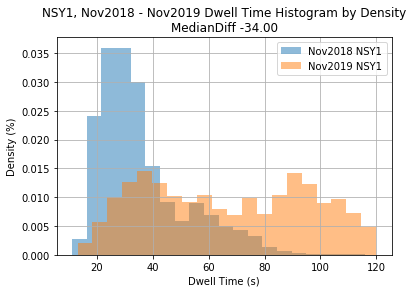

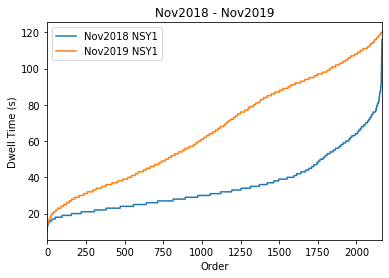


Platform Name NSY2

Platform Name NSY3

Platform Name NSY4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2118.000000
mean       60.793201
std        31.043354
min        13.000000
25%        31.000000
50%        55.000000
75%        91.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2118.000000
mean       52.310670
std        23.876805
min        14.000000
25%        29.000000
50%        50.000000
75%        76.000000
max       111.000000
Name: time, dtype: float64
KS two-sample test pValue 3.265392519625828e-53
Dwell Time Increase IS Signficiant


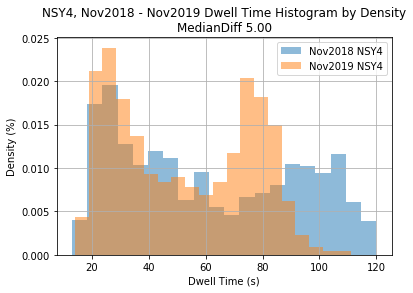

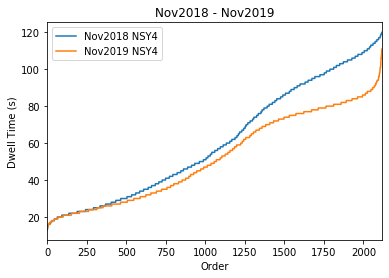


Platform Name NTN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    812.000000
mean      25.970443
std       11.960544
min       12.000000
25%       20.000000
50%       23.000000
75%       28.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    812.000000
mean      25.932266
std       10.336942
min       11.000000
25%       20.000000
50%       24.000000
75%       28.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 0.11713904527607863
Dwell Time Decrease NOT Signficiant


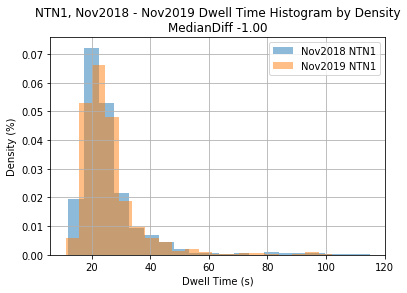

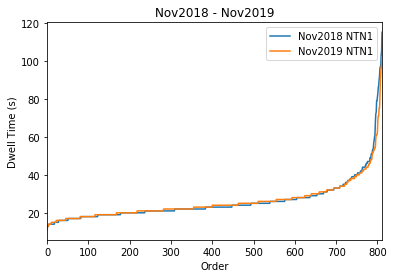


Platform Name NTN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    814.000000
mean      32.826781
std       10.944935
min       13.000000
25%       24.000000
50%       31.000000
75%       41.000000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    814.000000
mean      33.449631
std        9.974841
min       16.000000
25%       26.000000
50%       31.000000
75%       41.000000
max       94.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0009291124963428469
Dwell Time Decrease IS Signficiant


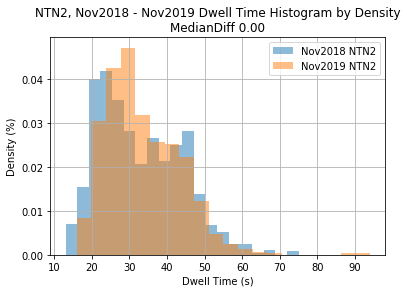

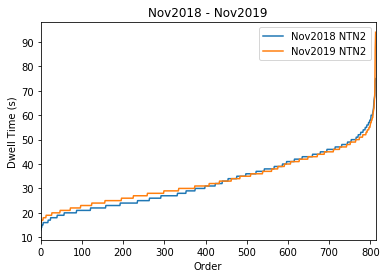


Platform Name OLP2

Platform Name PAD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    506.000000
mean      31.454545
std       16.160179
min       11.000000
25%       18.000000
50%       25.500000
75%       44.000000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    506.000000
mean      32.863636
std       16.171579
min       12.000000
25%       19.000000
50%       29.000000
75%       45.000000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 0.06120013928553739
Dwell Time Decrease NOT Signficiant


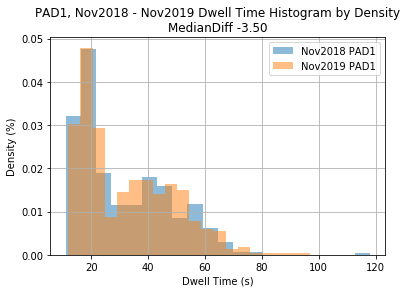

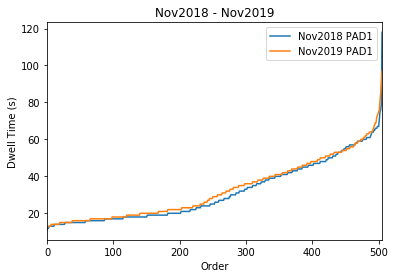


Platform Name PAD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    447.000000
mean      21.472036
std        6.328702
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       71.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    447.000000
mean      22.382550
std        5.644471
min       13.000000
25%       19.000000
50%       21.000000
75%       25.000000
max       53.000000
Name: time, dtype: float64
KS two-sample test pValue 0.01753238226061285
Dwell Time Decrease IS Signficiant


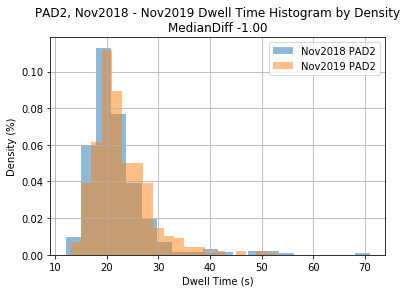

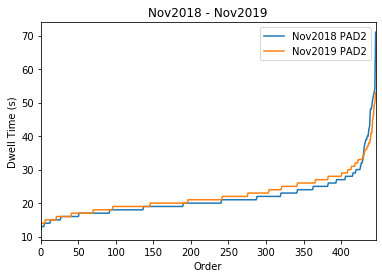


Platform Name PAN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    539.000000
mean      20.289425
std        6.864169
min       11.000000
25%       17.000000
50%       19.000000
75%       22.000000
max      100.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    539.000000
mean      20.326531
std        5.892868
min       13.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       72.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7108740975158637
Dwell Time Decrease NOT Signficiant


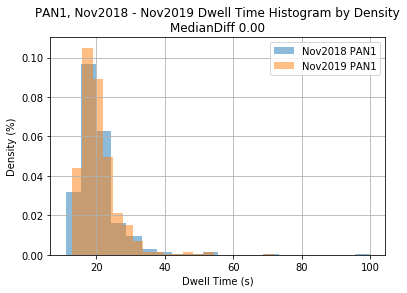

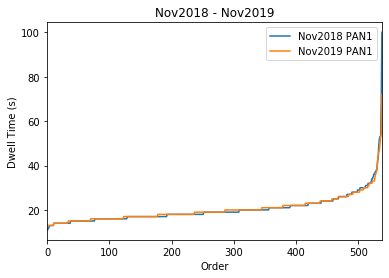


Platform Name PAN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    542.000000
mean      40.044280
std       18.914094
min       12.000000
25%       21.000000
50%       41.000000
75%       55.000000
max       87.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    542.000000
mean      42.592251
std       18.655397
min       12.000000
25%       24.000000
50%       45.000000
75%       58.000000
max      114.000000
Name: time, dtype: float64
KS two-sample test pValue 0.02845539034792665
Dwell Time Decrease IS Signficiant


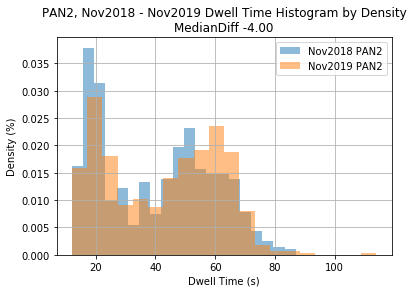

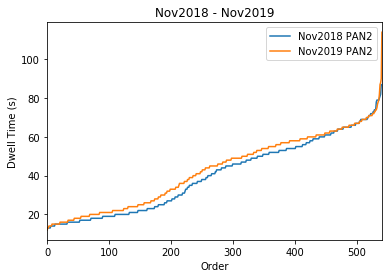


Platform Name PDH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    761.000000
mean      21.168200
std        6.450466
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    761.000000
mean      22.325887
std        7.860392
min       12.000000
25%       18.000000
50%       21.000000
75%       24.000000
max      111.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00011856929133471183
Dwell Time Decrease IS Signficiant


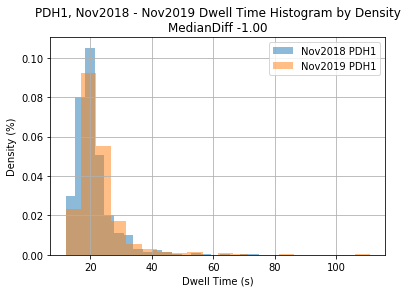

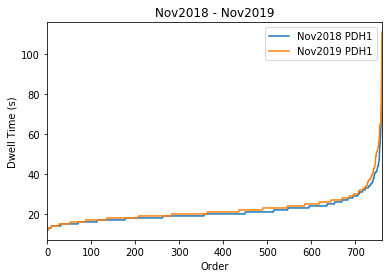


Platform Name PDH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    38.000000
mean     20.842105
std       6.056162
min      11.000000
25%      17.000000
50%      19.000000
75%      23.750000
max      35.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    38.000000
mean     21.500000
std       7.058635
min      14.000000
25%      18.000000
50%      19.500000
75%      22.000000
max      47.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9866453783650283
Dwell Time Decrease NOT Signficiant


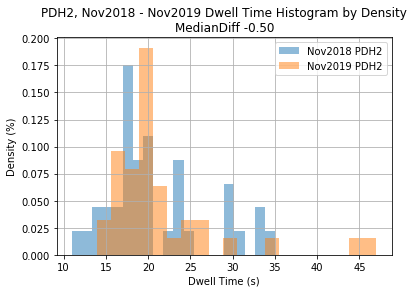

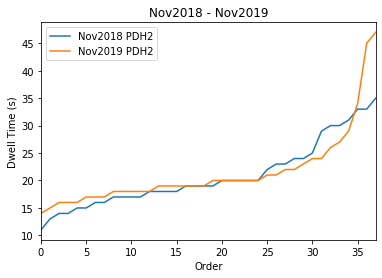


Platform Name PDH3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    86.000000
mean     24.453488
std       9.372873
min      13.000000
25%      19.000000
50%      22.000000
75%      26.000000
max      67.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    86.000000
mean     25.383721
std      11.046606
min      13.000000
25%      19.000000
50%      22.000000
75%      27.750000
max      76.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9403434525017745
Dwell Time Decrease NOT Signficiant


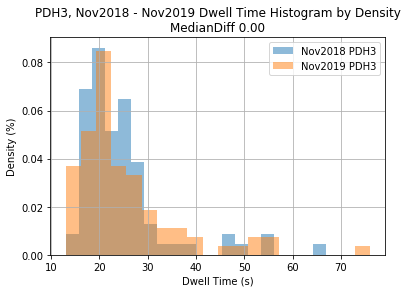

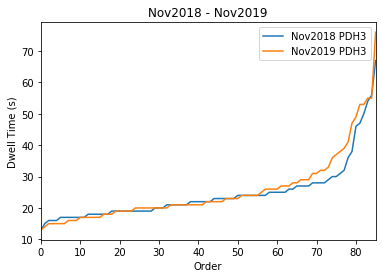


Platform Name PDH4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    724.000000
mean      26.983425
std       12.309393
min       12.000000
25%       19.000000
50%       22.000000
75%       29.000000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    724.000000
mean      28.121547
std       11.945780
min       12.000000
25%       20.000000
50%       24.000000
75%       31.000000
max      104.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00018270244788471545
Dwell Time Decrease IS Signficiant


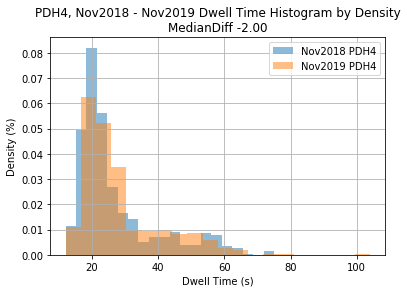

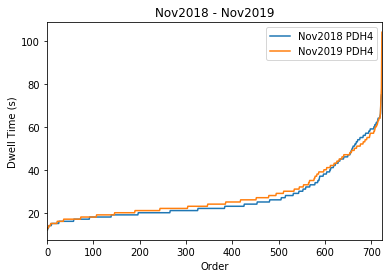


Platform Name PEN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    58.000000
mean     41.362069
std      17.808630
min      20.000000
25%      28.250000
50%      38.000000
75%      48.750000
max      99.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count     58.000000
mean      47.362069
std       16.016108
min       26.000000
25%       37.000000
50%       44.000000
75%       54.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0037314020990613706
Dwell Time Decrease IS Signficiant


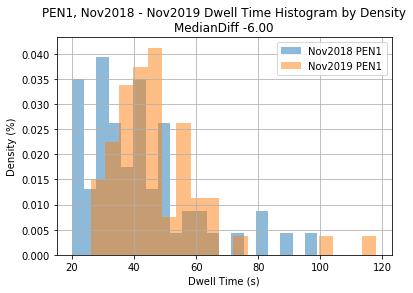

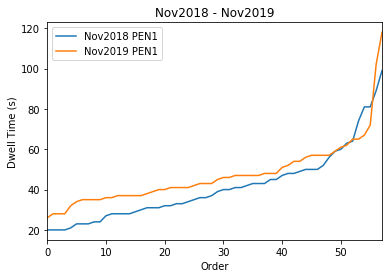


Platform Name PEN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    349.000000
mean      49.057307
std       21.076684
min       12.000000
25%       31.000000
50%       47.000000
75%       65.000000
max      114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    349.000000
mean      53.535817
std       22.651077
min       10.000000
25%       34.000000
50%       53.000000
75%       72.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.03950882698871156
Dwell Time Decrease IS Signficiant


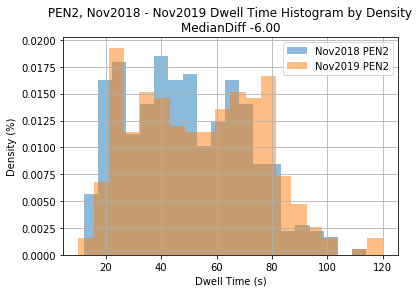

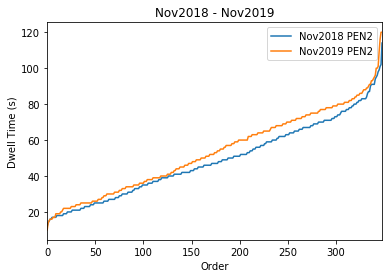


Platform Name PEN3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    251.000000
mean      60.916335
std       25.894651
min       18.000000
25%       38.000000
50%       60.000000
75%       81.500000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    251.000000
mean      57.478088
std       24.642778
min       15.000000
25%       37.000000
50%       53.000000
75%       81.000000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.2903218359776523
Dwell Time Increase NOT Signficiant


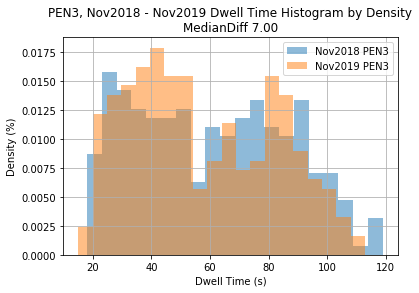

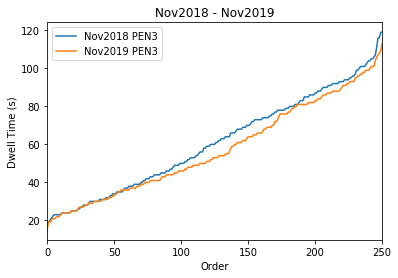


Platform Name PET1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    461.000000
mean      30.711497
std       12.982147
min       12.000000
25%       20.000000
50%       28.000000
75%       40.000000
max      114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    461.000000
mean      30.511931
std        9.818481
min       12.000000
25%       23.000000
50%       28.000000
75%       38.000000
max       62.000000
Name: time, dtype: float64
KS two-sample test pValue 0.013456305255143705
Dwell Time Decrease IS Signficiant


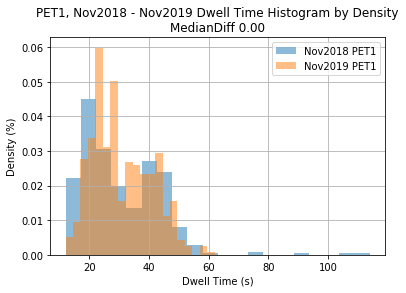

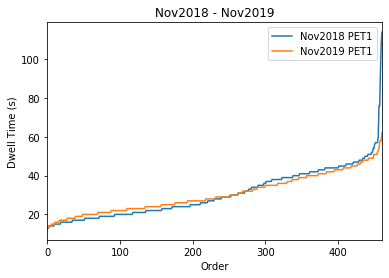


Platform Name PET2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    395.000000
mean      20.526582
std        4.632283
min       13.000000
25%       18.000000
50%       20.000000
75%       22.000000
max       48.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    395.000000
mean      21.086076
std        5.520859
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max       75.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5152125657372315
Dwell Time Decrease NOT Signficiant


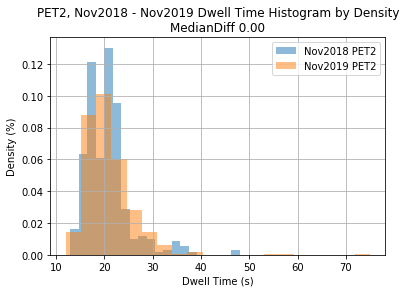

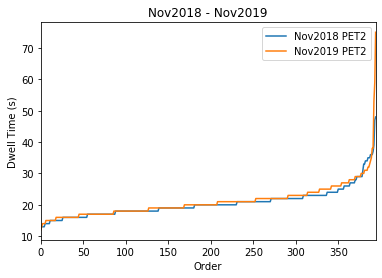


Platform Name PNT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    860.000000
mean      19.813953
std        5.118188
min       10.000000
25%       16.000000
50%       19.000000
75%       22.000000
max       71.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    860.000000
mean      20.277907
std        7.493154
min       11.000000
25%       16.000000
50%       19.000000
75%       22.000000
max       84.000000
Name: time, dtype: float64
KS two-sample test pValue 0.02639149043444432
Dwell Time Decrease IS Signficiant


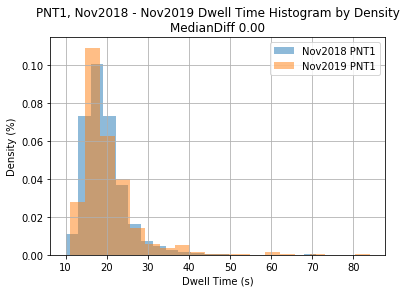

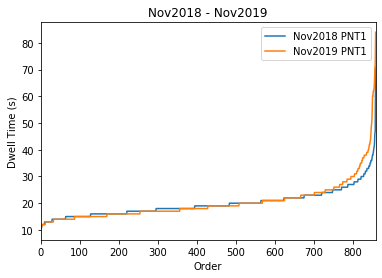


Platform Name PNT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    789.000000
mean      25.399240
std       10.878963
min       13.000000
25%       18.000000
50%       22.000000
75%       30.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    789.000000
mean      25.653992
std       10.774013
min       13.000000
25%       19.000000
50%       22.000000
75%       29.000000
max       99.000000
Name: time, dtype: float64
KS two-sample test pValue 0.020835421660167115
Dwell Time Decrease IS Signficiant


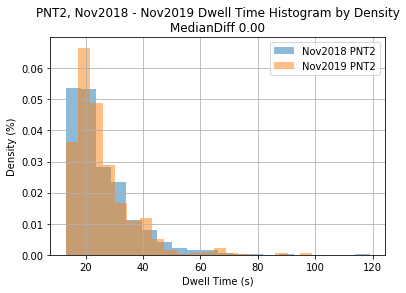

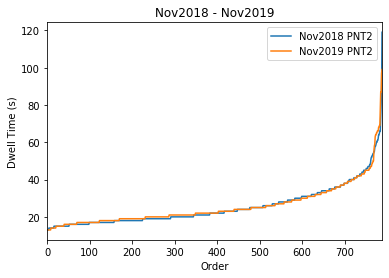


Platform Name PTA1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1216.000000
mean       48.303454
std        20.722684
min        17.000000
25%        33.000000
50%        42.000000
75%        60.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1216.000000
mean       48.963816
std        19.900088
min        15.000000
25%        34.000000
50%        43.000000
75%        60.250000
max       110.000000
Name: time, dtype: float64
KS two-sample test pValue 0.02212443398076056
Dwell Time Decrease IS Signficiant


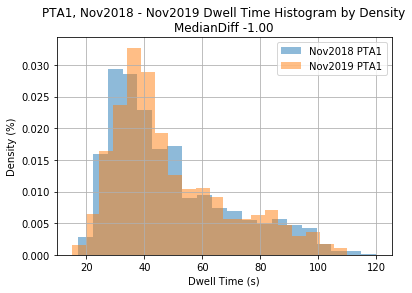

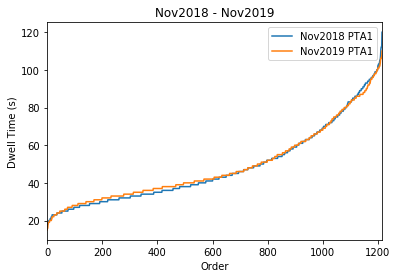


Platform Name PTA2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    984.000000
mean      47.099593
std       23.244777
min       17.000000
25%       31.000000
50%       38.000000
75%       56.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    984.000000
mean      53.563008
std       23.250463
min       15.000000
25%       36.000000
50%       48.000000
75%       65.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 5.1382476182824236e-18
Dwell Time Decrease IS Signficiant


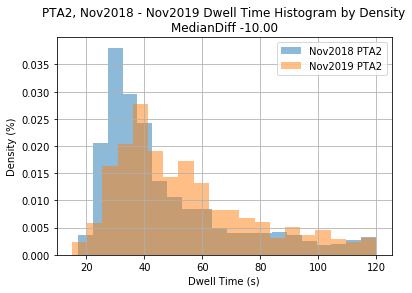

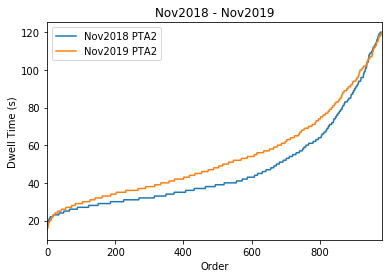


Platform Name PTA3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    396.000000
mean      45.666667
std       22.917132
min       17.000000
25%       28.000000
50%       38.000000
75%       58.250000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    396.000000
mean      48.378788
std       21.658990
min       17.000000
25%       32.000000
50%       41.000000
75%       63.000000
max      112.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0016407733174991694
Dwell Time Decrease IS Signficiant


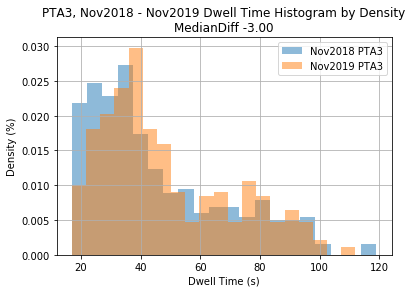

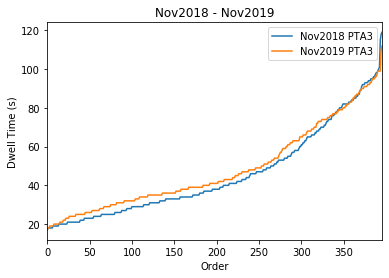


Platform Name PTA4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    317.000000
mean      43.063091
std       22.952396
min       16.000000
25%       28.000000
50%       34.000000
75%       51.000000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    317.000000
mean      45.293375
std       24.526769
min       16.000000
25%       27.000000
50%       36.000000
75%       61.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.49055850681889357
Dwell Time Decrease NOT Signficiant


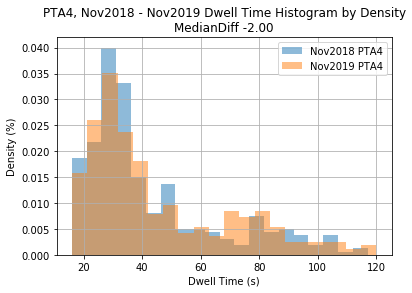

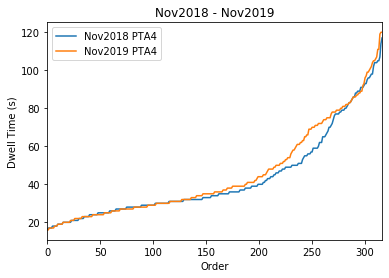


Platform Name PUN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    487.000000
mean      24.094456
std        5.514227
min       12.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       48.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    487.000000
mean      25.008214
std        6.002052
min       13.000000
25%       21.000000
50%       24.000000
75%       28.000000
max       51.000000
Name: time, dtype: float64
KS two-sample test pValue 0.12027555154544296
Dwell Time Decrease NOT Signficiant


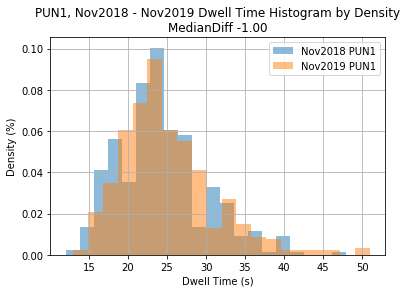

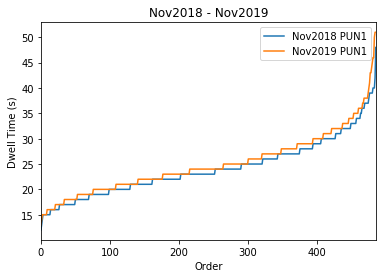


Platform Name PUN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    524.000000
mean      24.198473
std        6.503030
min       12.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       71.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    524.000000
mean      26.005725
std        6.139080
min       14.000000
25%       22.000000
50%       25.000000
75%       29.000000
max       60.000000
Name: time, dtype: float64
KS two-sample test pValue 4.234936359486515e-08
Dwell Time Decrease IS Signficiant


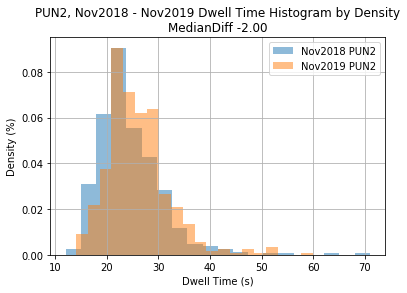

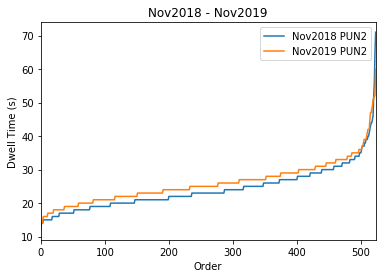


Platform Name PYM1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1059.000000
mean       24.378659
std         9.311007
min        11.000000
25%        18.000000
50%        21.000000
75%        29.000000
max        75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1059.000000
mean       24.631728
std         8.198758
min        12.000000
25%        19.000000
50%        22.000000
75%        28.000000
max        65.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0007987669276707951
Dwell Time Decrease IS Signficiant


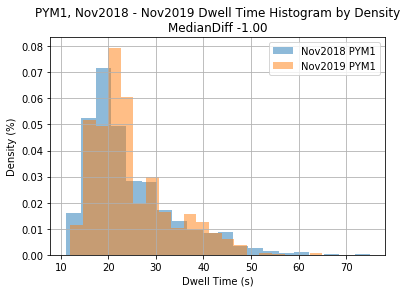

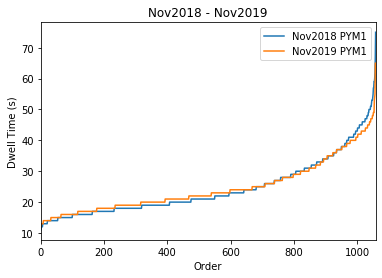


Platform Name PYM2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    993.000000
mean      31.899295
std       13.418809
min       12.000000
25%       20.000000
50%       28.000000
75%       44.000000
max       78.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    993.000000
mean      22.118832
std        5.927143
min       13.000000
25%       18.000000
50%       21.000000
75%       24.000000
max       83.000000
Name: time, dtype: float64
KS two-sample test pValue 9.776635046234115e-69
Dwell Time Increase IS Signficiant


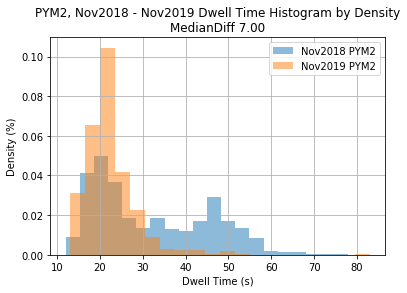

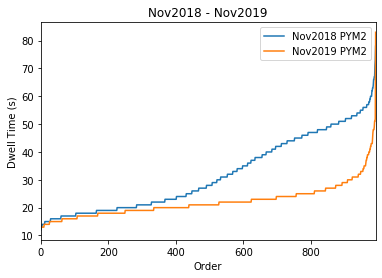


Platform Name QKH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    744.000000
mean      22.163978
std       10.920365
min       10.000000
25%       17.000000
50%       20.000000
75%       23.250000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    744.000000
mean      23.637097
std       11.952014
min       11.000000
25%       17.000000
50%       20.500000
75%       25.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 0.021711704637050796
Dwell Time Decrease IS Signficiant


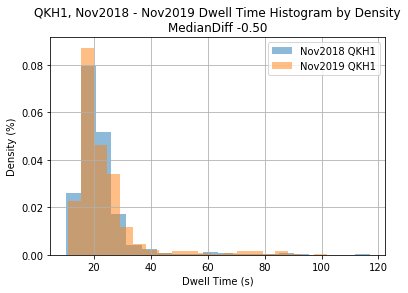

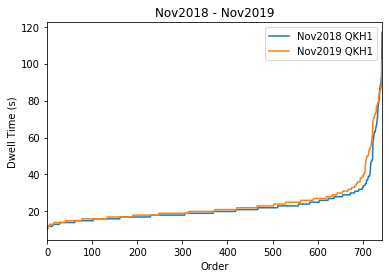


Platform Name QKH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    741.000000
mean      24.765182
std       13.017511
min       14.000000
25%       18.000000
50%       21.000000
75%       25.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    741.000000
mean      26.484480
std       12.511026
min       12.000000
25%       20.000000
50%       23.000000
75%       28.000000
max       95.000000
Name: time, dtype: float64
KS two-sample test pValue 2.0753050123867842e-07
Dwell Time Decrease IS Signficiant


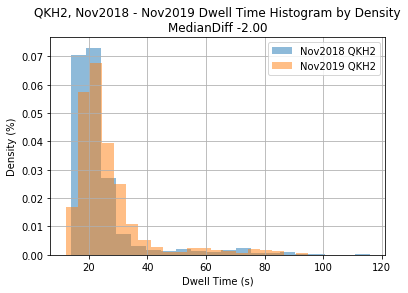

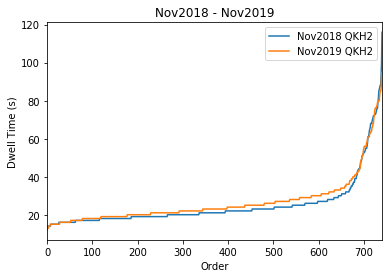


Platform Name RD01

Platform Name RD02

Platform Name RD03
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2253.000000
mean       36.426542
std        20.816515
min        13.000000
25%        23.000000
50%        28.000000
75%        41.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2253.000000
mean       35.142477
std        17.315294
min        13.000000
25%        24.000000
50%        29.000000
75%        40.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0030064873632060433
Dwell Time Decrease IS Signficiant


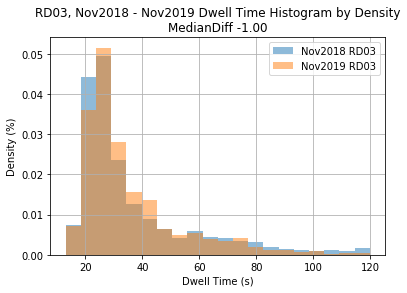

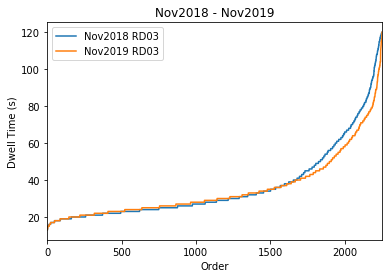


Platform Name RD04
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2262.000000
mean       23.910256
std         5.836213
min        14.000000
25%        20.000000
50%        23.000000
75%        26.000000
max        79.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2262.000000
mean       25.348806
std         8.360566
min        14.000000
25%        21.000000
50%        24.000000
75%        27.000000
max       112.000000
Name: time, dtype: float64
KS two-sample test pValue 4.8720830309475436e-14
Dwell Time Decrease IS Signficiant


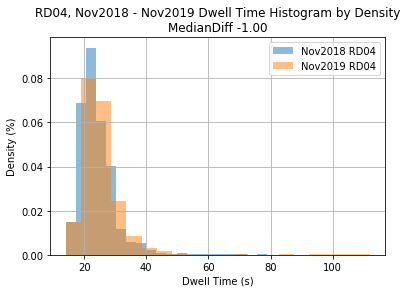

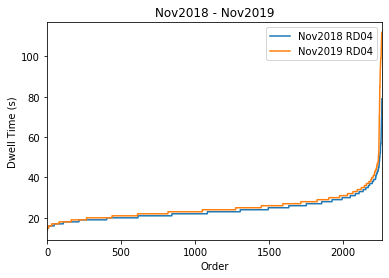


Platform Name RD05
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    875.000000
mean      41.737143
std       18.304804
min       16.000000
25%       25.000000
50%       38.000000
75%       58.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    875.000000
mean      42.120000
std       17.693242
min       14.000000
25%       26.000000
50%       40.000000
75%       56.000000
max      112.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3498891505409804
Dwell Time Decrease NOT Signficiant


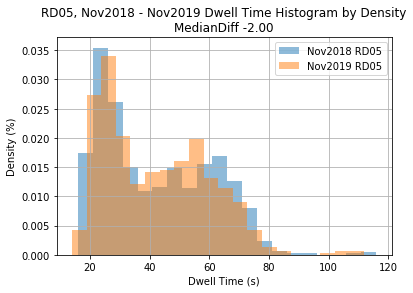

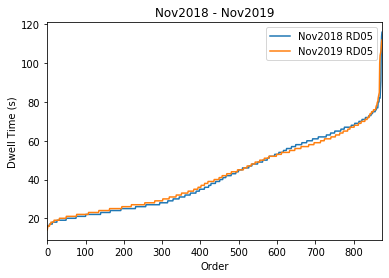


Platform Name RD06
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    855.000000
mean      24.177778
std        6.271098
min       13.000000
25%       20.000000
50%       23.000000
75%       26.000000
max       71.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    855.000000
mean      24.971930
std        6.658914
min       14.000000
25%       21.000000
50%       23.000000
75%       28.000000
max       79.000000
Name: time, dtype: float64
KS two-sample test pValue 0.029647498500930985
Dwell Time Decrease IS Signficiant


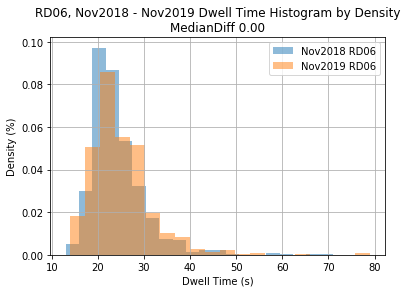

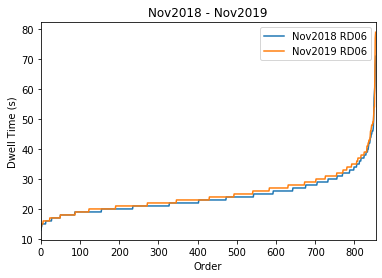


Platform Name RD07
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    549.000000
mean      25.608379
std       12.025429
min       11.000000
25%       20.000000
50%       23.000000
75%       26.000000
max      111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    549.000000
mean      26.298725
std       10.103390
min       14.000000
25%       21.000000
50%       24.000000
75%       28.000000
max      108.000000
Name: time, dtype: float64
KS two-sample test pValue 0.002259891430640932
Dwell Time Decrease IS Signficiant


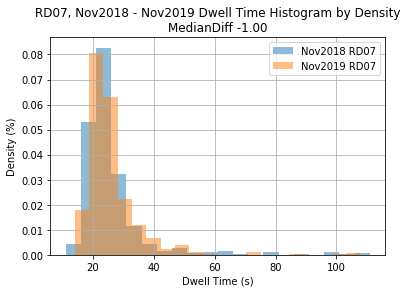

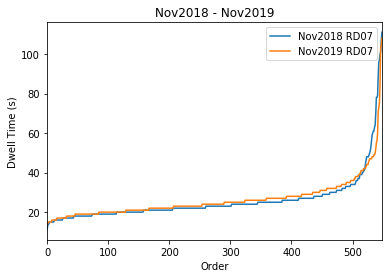


Platform Name RD08
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    573.000000
mean      26.804538
std        9.941974
min       14.000000
25%       20.000000
50%       24.000000
75%       31.000000
max       93.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    573.000000
mean      30.357766
std        9.915522
min       13.000000
25%       23.000000
50%       28.000000
75%       37.000000
max       81.000000
Name: time, dtype: float64
KS two-sample test pValue 1.0978953777828831e-10
Dwell Time Decrease IS Signficiant


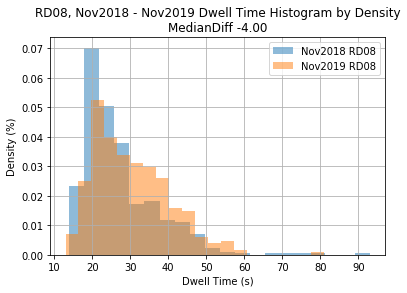

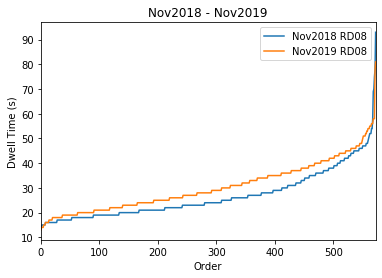


Platform Name RD09

Platform Name RD10

Platform Name RDS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    946.000000
mean      28.327696
std       13.682585
min       12.000000
25%       21.000000
50%       25.000000
75%       30.000000
max       97.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    946.000000
mean      28.662791
std       13.211965
min       12.000000
25%       21.000000
50%       26.000000
75%       32.000000
max      101.000000
Name: time, dtype: float64
KS two-sample test pValue 0.05708295858157445
Dwell Time Decrease NOT Signficiant


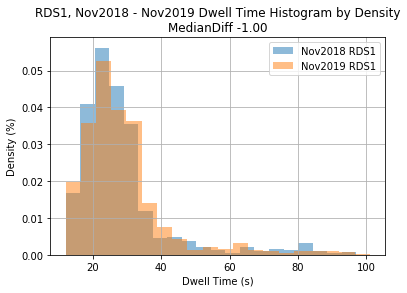

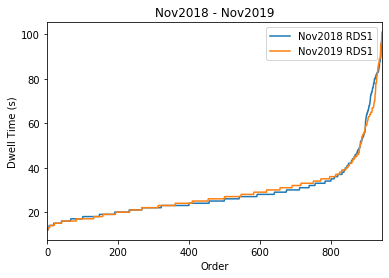


Platform Name RDS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    840.000000
mean      25.709524
std        8.121186
min       13.000000
25%       21.000000
50%       24.000000
75%       29.000000
max       94.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    840.000000
mean      27.380952
std        8.195619
min       13.000000
25%       22.000000
50%       26.000000
75%       31.000000
max       84.000000
Name: time, dtype: float64
KS two-sample test pValue 9.104603254614722e-08
Dwell Time Decrease IS Signficiant


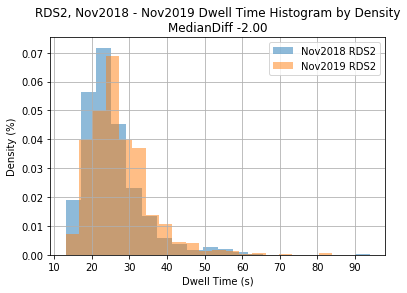

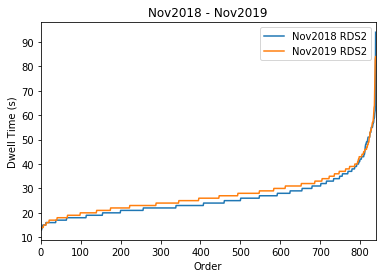


Platform Name RDS3

Platform Name RIC1

Platform Name RIC2

Platform Name RIV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    381.000000
mean      56.650919
std       33.884113
min       12.000000
25%       22.000000
50%       55.000000
75%       86.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    381.000000
mean      57.018373
std       31.304988
min       13.000000
25%       25.000000
50%       58.000000
75%       81.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.21986616538337722
Dwell Time Decrease NOT Signficiant


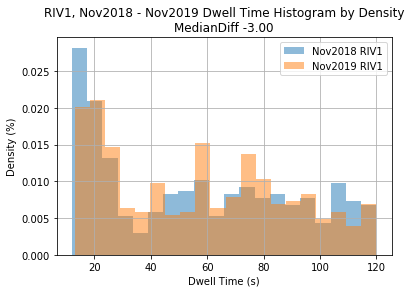

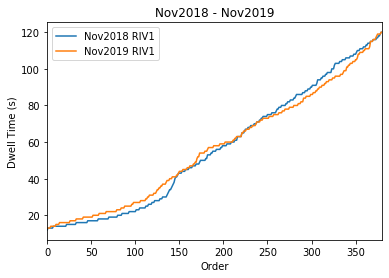


Platform Name RIV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    439.000000
mean      45.544419
std       33.634243
min       13.000000
25%       20.000000
50%       26.000000
75%       73.500000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    439.000000
mean      48.232346
std       31.531831
min       12.000000
25%       22.000000
50%       33.000000
75%       73.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 1.0248629720723734e-05
Dwell Time Decrease IS Signficiant


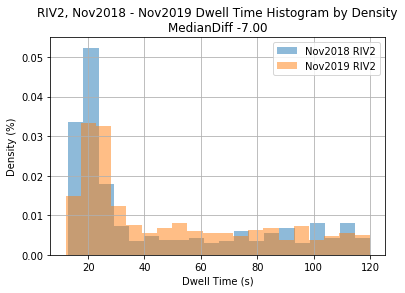

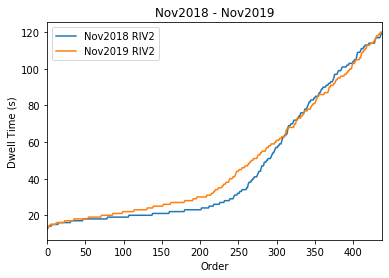


Platform Name RPK1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    336.000000
mean      63.982143
std       34.810527
min       14.000000
25%       27.000000
50%       65.000000
75%       96.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    336.000000
mean      65.901786
std       33.101010
min       14.000000
25%       33.000000
50%       67.500000
75%       96.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.41108135066006407
Dwell Time Decrease NOT Signficiant


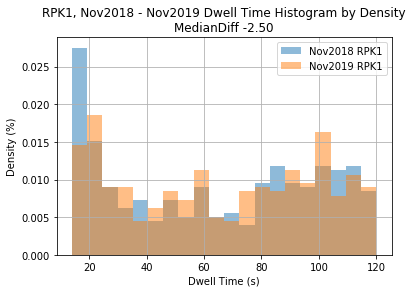

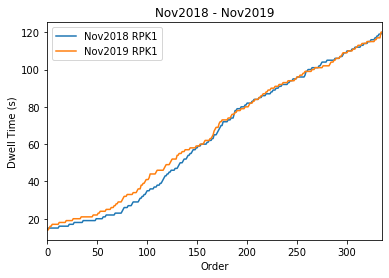


Platform Name RPK2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    309.000000
mean      24.187702
std       13.592530
min       11.000000
25%       18.000000
50%       20.000000
75%       23.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    309.000000
mean      25.576052
std       12.776737
min       13.000000
25%       19.000000
50%       22.000000
75%       26.000000
max      116.000000
Name: time, dtype: float64
KS two-sample test pValue 0.001134861958267057
Dwell Time Decrease IS Signficiant


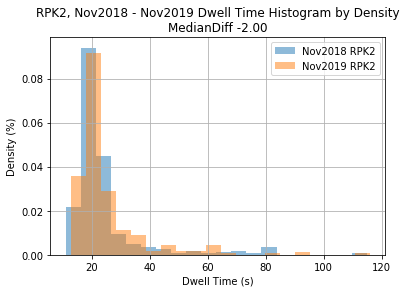

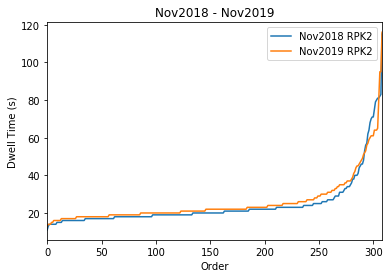


Platform Name RSV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1848.000000
mean       22.046537
std        10.523853
min        11.000000
25%        16.000000
50%        19.000000
75%        22.000000
max        79.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1848.000000
mean       18.819264
std         4.312234
min        11.000000
25%        16.000000
50%        18.000000
75%        21.000000
max        68.000000
Name: time, dtype: float64
KS two-sample test pValue 4.94356635508409e-12
Dwell Time Increase IS Signficiant


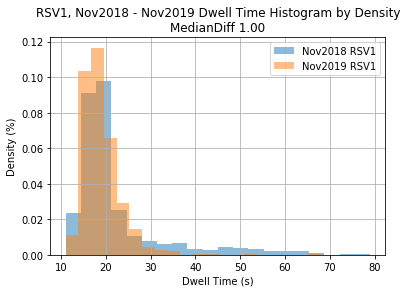

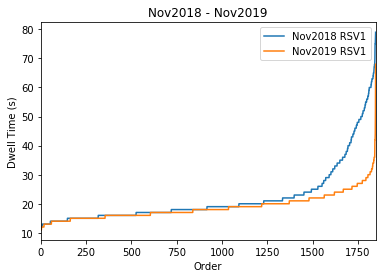


Platform Name RSV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1858.000000
mean       19.138321
std         4.781125
min        11.000000
25%        16.250000
50%        18.000000
75%        21.000000
max       107.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1858.000000
mean       41.213132
std        18.501242
min        12.000000
25%        21.000000
50%        45.000000
75%        58.000000
max        95.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0
Dwell Time Decrease IS Signficiant


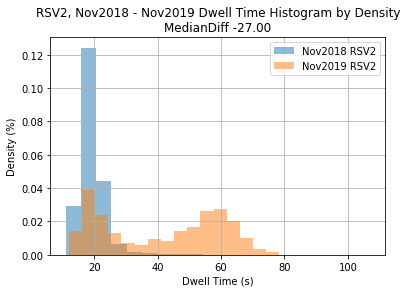

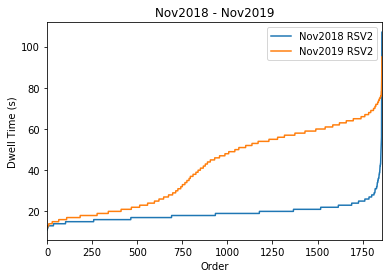


Platform Name RTY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    518.000000
mean      24.723938
std       10.685003
min       12.000000
25%       18.000000
50%       21.000000
75%       29.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    518.000000
mean      24.588803
std        8.244266
min       13.000000
25%       18.000000
50%       22.000000
75%       29.750000
max       59.000000
Name: time, dtype: float64
KS two-sample test pValue 0.687367781031012
Dwell Time Decrease NOT Signficiant


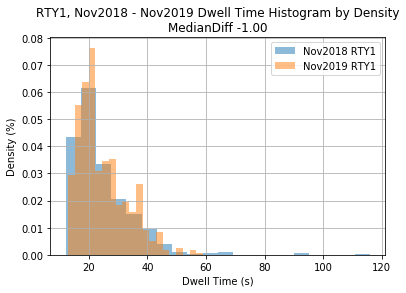

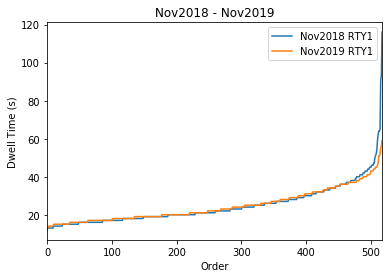


Platform Name RTY2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    294.000000
mean      26.020408
std        9.814991
min       12.000000
25%       20.000000
50%       24.000000
75%       30.000000
max       92.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    294.000000
mean      23.904762
std        8.315727
min       13.000000
25%       18.250000
50%       21.000000
75%       27.000000
max       73.000000
Name: time, dtype: float64
KS two-sample test pValue 0.006516551541099631
Dwell Time Increase IS Signficiant


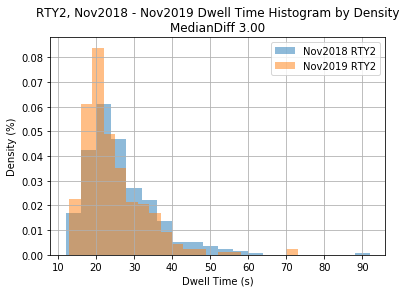

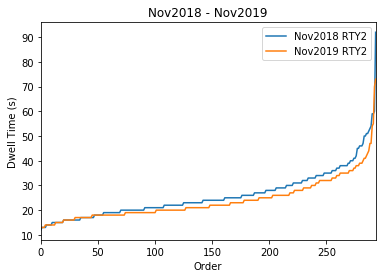


Platform Name RTY3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    120.000000
mean      21.883333
std        8.058800
min       14.000000
25%       18.000000
50%       20.500000
75%       23.000000
max       85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    120.000000
mean      23.533333
std        6.439027
min       13.000000
25%       19.000000
50%       23.000000
75%       26.000000
max       45.000000
Name: time, dtype: float64
KS two-sample test pValue 0.004479355810728165
Dwell Time Decrease IS Signficiant


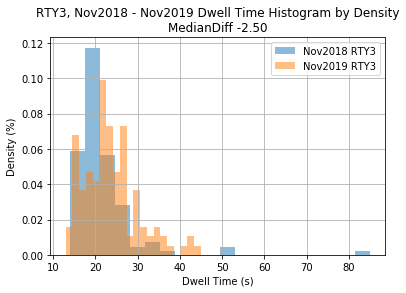

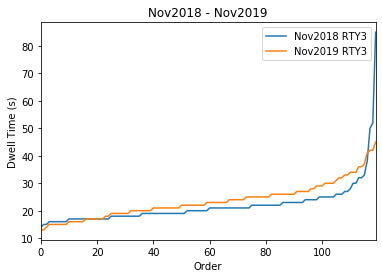


Platform Name RTY4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    768.000000
mean      25.888021
std       10.985612
min       13.000000
25%       19.000000
50%       22.000000
75%       28.000000
max      104.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    768.000000
mean      28.407552
std       11.947922
min       13.000000
25%       20.000000
50%       24.000000
75%       33.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 6.29763445317018e-08
Dwell Time Decrease IS Signficiant


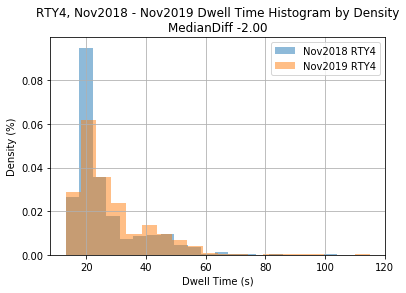

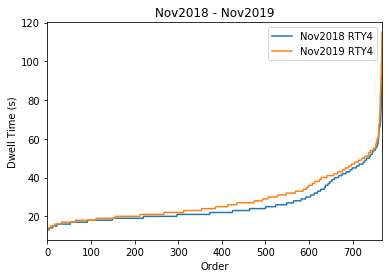


Platform Name RVS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    385.000000
mean      52.402597
std       14.721954
min       17.000000
25%       43.000000
50%       55.000000
75%       63.000000
max       95.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    385.000000
mean      51.337662
std       14.053294
min       15.000000
25%       43.000000
50%       52.000000
75%       60.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 0.057064262608638866
Dwell Time Increase NOT Signficiant


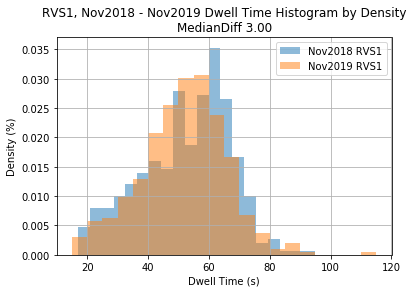

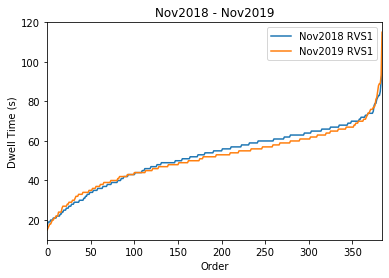


Platform Name RVS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    150.000000
mean      32.513333
std       13.594184
min       13.000000
25%       20.000000
50%       30.000000
75%       44.000000
max       67.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    150.000000
mean      31.846667
std       11.725459
min       14.000000
25%       21.250000
50%       30.000000
75%       40.000000
max       58.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7249566931207618
Dwell Time Decrease NOT Signficiant


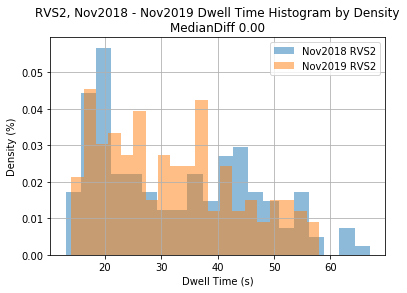

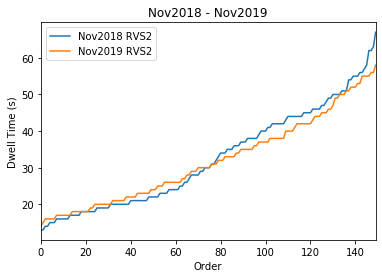


Platform Name RVS3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    141.000000
mean      27.000000
std        8.739075
min       14.000000
25%       20.000000
50%       25.000000
75%       30.000000
max       56.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    141.000000
mean      29.560284
std       10.400116
min       16.000000
25%       21.000000
50%       28.000000
75%       36.000000
max       88.000000
Name: time, dtype: float64
KS two-sample test pValue 0.023586813923806318
Dwell Time Decrease IS Signficiant


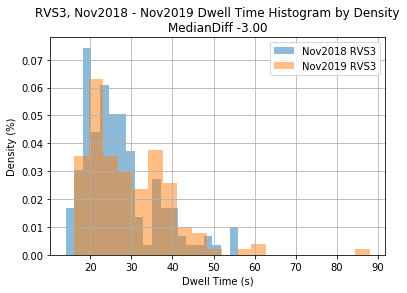

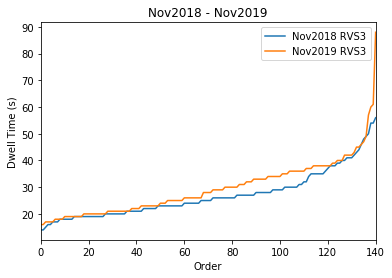


Platform Name RVS4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    392.000000
mean      35.502551
std       17.268898
min       15.000000
25%       22.000000
50%       29.000000
75%       46.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    392.000000
mean      39.561224
std       17.752816
min       15.000000
25%       25.000000
50%       34.000000
75%       51.000000
max      107.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00010711384665660428
Dwell Time Decrease IS Signficiant


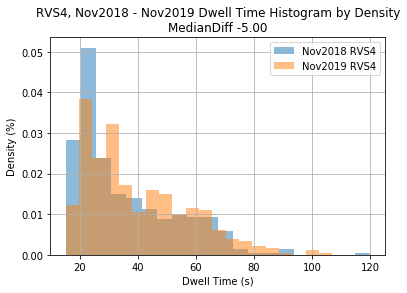

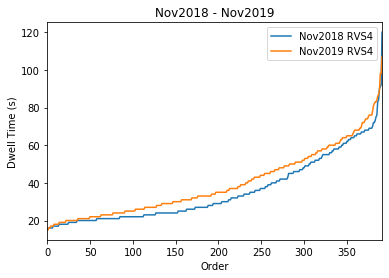


Platform Name RWD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    481.000000
mean      26.613306
std       11.176433
min       13.000000
25%       19.000000
50%       22.000000
75%       31.000000
max       75.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    481.000000
mean      25.357588
std        9.244198
min       14.000000
25%       19.000000
50%       22.000000
75%       27.000000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 0.27075510227462846
Dwell Time Decrease NOT Signficiant


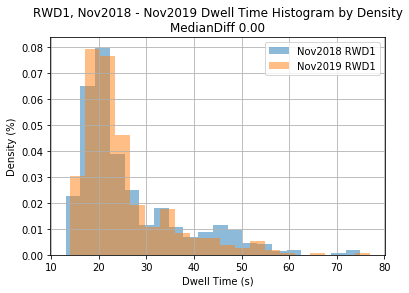

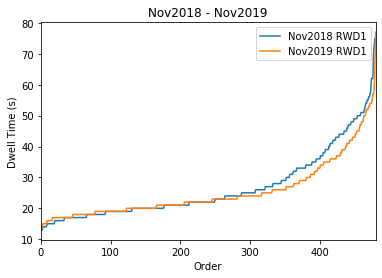


Platform Name RWD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    441.000000
mean      42.755102
std       17.050297
min       13.000000
25%       26.000000
50%       47.000000
75%       56.000000
max      111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    441.000000
mean      44.478458
std       15.131548
min       15.000000
25%       33.000000
50%       48.000000
75%       55.000000
max       95.000000
Name: time, dtype: float64
KS two-sample test pValue 0.010718829314803533
Dwell Time Decrease IS Signficiant


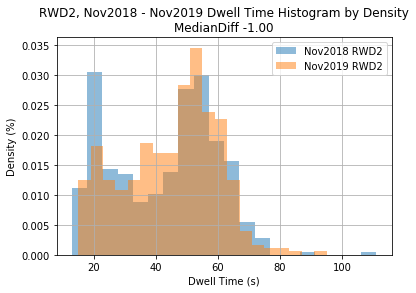

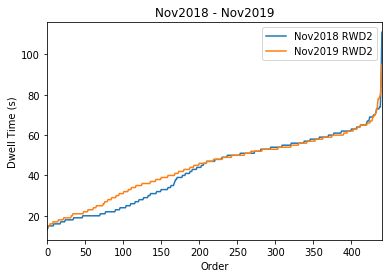


Platform Name SCO1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    486.000000
mean      20.613169
std       11.008270
min       10.000000
25%       15.000000
50%       18.000000
75%       22.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    486.000000
mean      24.296296
std       15.166929
min       11.000000
25%       17.000000
50%       19.000000
75%       25.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 1.3215806873228717e-06
Dwell Time Decrease IS Signficiant


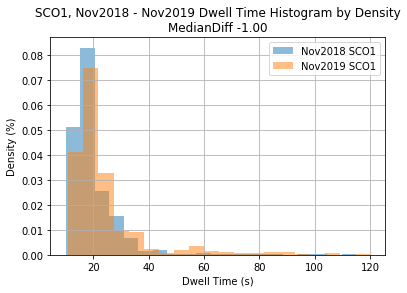

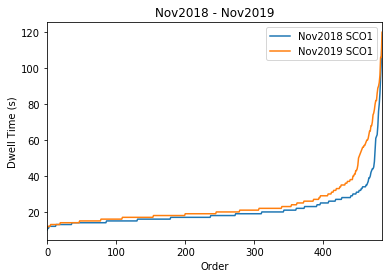


Platform Name SCO2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    548.000000
mean      25.848540
std       18.439507
min       11.000000
25%       17.000000
50%       19.000000
75%       23.000000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    548.000000
mean      28.317518
std       18.082421
min       11.000000
25%       18.000000
50%       22.000000
75%       28.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 4.841849510126667e-09
Dwell Time Decrease IS Signficiant


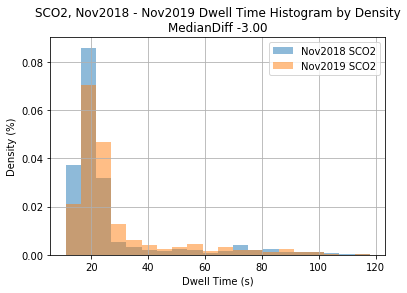

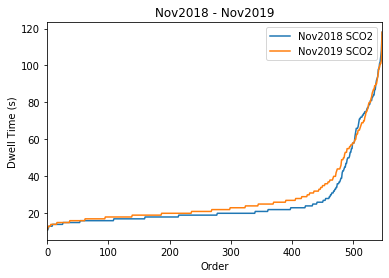


Platform Name SD03

Platform Name SD04

Platform Name SD08

Platform Name SD09

Platform Name SD10

Platform Name SD11

Platform Name SD12

Platform Name SDT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    893.000000
mean      28.461366
std        8.501643
min       13.000000
25%       23.000000
50%       27.000000
75%       32.000000
max       83.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    893.000000
mean      28.908175
std        8.415664
min       13.000000
25%       23.000000
50%       28.000000
75%       32.000000
max       86.000000
Name: time, dtype: float64
KS two-sample test pValue 0.27679148252256
Dwell Time Decrease NOT Signficiant


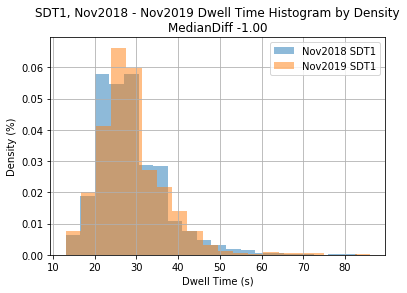

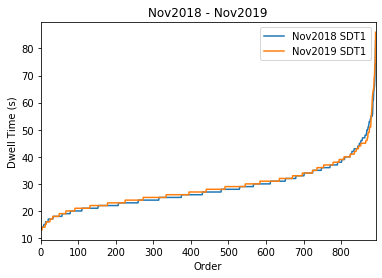


Platform Name SDT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    865.000000
mean      30.120231
std        9.560449
min       15.000000
25%       24.000000
50%       29.000000
75%       35.000000
max       93.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    865.000000
mean      30.522543
std        8.861186
min       14.000000
25%       24.000000
50%       29.000000
75%       35.000000
max       76.000000
Name: time, dtype: float64
KS two-sample test pValue 0.19234265709814788
Dwell Time Decrease NOT Signficiant


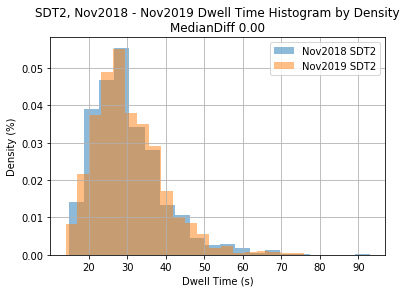

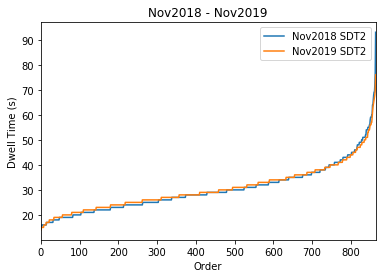


Platform Name SFT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    137.000000
mean      21.065693
std       10.641349
min       11.000000
25%       16.000000
50%       19.000000
75%       22.000000
max      105.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    137.000000
mean      21.912409
std       12.066893
min       12.000000
25%       16.000000
50%       19.000000
75%       23.000000
max       94.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9994814323523501
Dwell Time Decrease NOT Signficiant


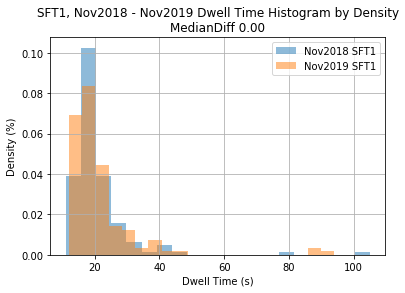

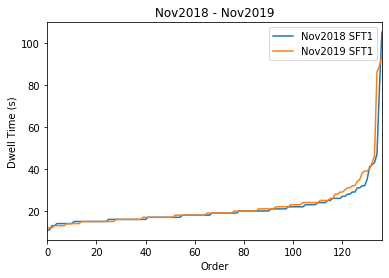


Platform Name SFT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    121.000000
mean      22.008264
std       13.945427
min       11.000000
25%       16.000000
50%       18.000000
75%       22.000000
max      109.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    121.000000
mean      22.900826
std       11.371313
min       13.000000
25%       17.000000
50%       19.000000
75%       25.000000
max      100.000000
Name: time, dtype: float64
KS two-sample test pValue 0.007344036612292108
Dwell Time Decrease IS Signficiant


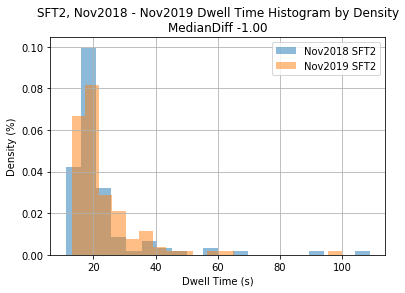

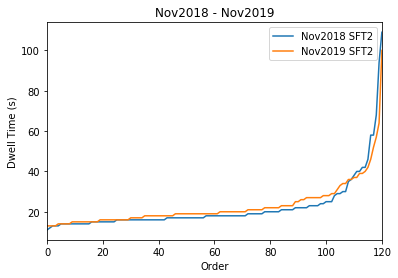


Platform Name SIT1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    865.000000
mean      22.966474
std        6.605626
min       11.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       67.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    865.000000
mean      24.495954
std        7.502178
min       13.000000
25%       20.000000
50%       23.000000
75%       28.000000
max      109.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00013742415327430883
Dwell Time Decrease IS Signficiant


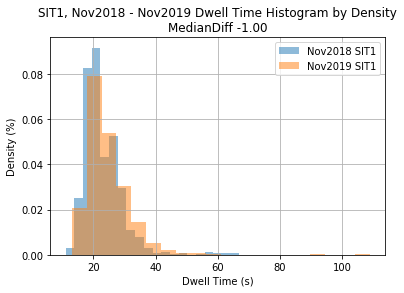

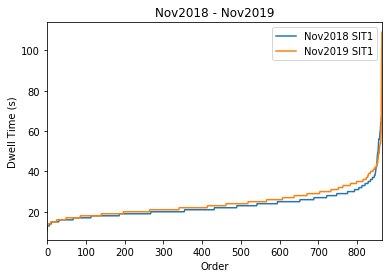


Platform Name SIT2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    853.000000
mean      24.485346
std        7.197015
min       14.000000
25%       20.000000
50%       23.000000
75%       28.000000
max      113.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    853.000000
mean      24.233294
std        6.357002
min       12.000000
25%       20.000000
50%       23.000000
75%       27.000000
max       72.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7479513025543788
Dwell Time Decrease NOT Signficiant


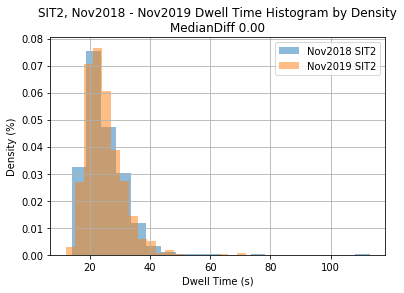

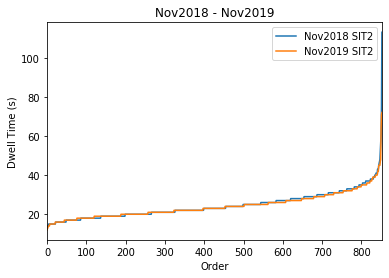


Platform Name SMH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    443.000000
mean      20.835214
std        9.225306
min       11.000000
25%       17.000000
50%       19.000000
75%       22.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    443.000000
mean      21.381490
std        6.164878
min       10.000000
25%       18.000000
50%       21.000000
75%       23.000000
max       66.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00033455076858502334
Dwell Time Decrease IS Signficiant


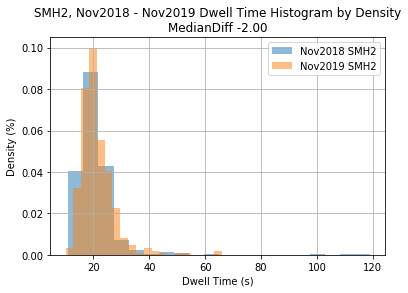

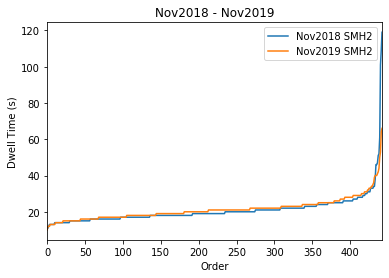


Platform Name SMH3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    406.000000
mean      29.251232
std        9.821163
min       14.000000
25%       21.000000
50%       27.000000
75%       36.000000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    406.000000
mean      32.219212
std        9.970263
min       15.000000
25%       24.000000
50%       30.000000
75%       40.750000
max       59.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0006582875631824225
Dwell Time Decrease IS Signficiant


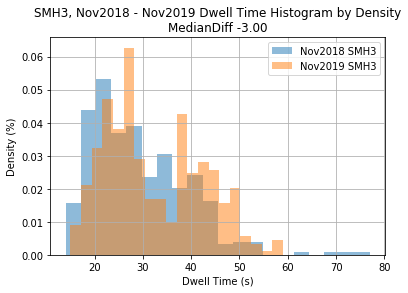

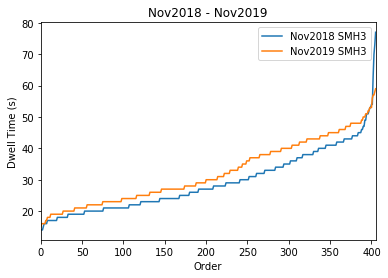


Platform Name SMR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    439.000000
mean      28.904328
std       10.023486
min       12.000000
25%       21.000000
50%       29.000000
75%       35.000000
max      102.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    439.000000
mean      28.735763
std        8.733935
min       11.000000
25%       21.000000
50%       29.000000
75%       36.000000
max       63.000000
Name: time, dtype: float64
KS two-sample test pValue 0.932966578886878
Dwell Time Decrease NOT Signficiant


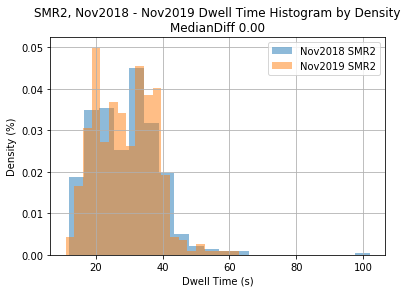

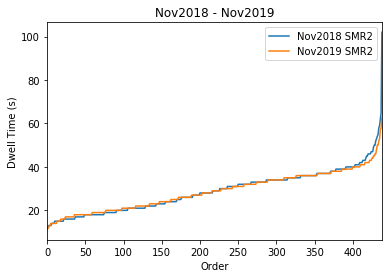


Platform Name SMR3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    412.000000
mean      21.485437
std        4.622728
min       13.000000
25%       19.000000
50%       21.000000
75%       23.000000
max       51.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    412.000000
mean      22.783981
std        5.705628
min       14.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       73.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0016677654180214999
Dwell Time Decrease IS Signficiant


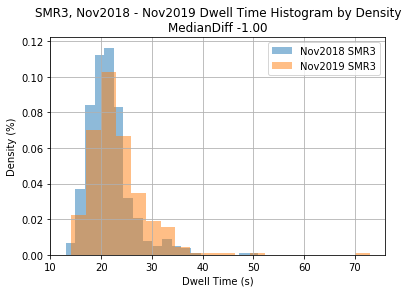

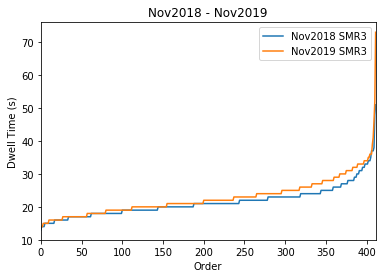


Platform Name STJ1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    963.000000
mean      33.570093
std       10.652224
min       11.000000
25%       26.000000
50%       34.000000
75%       40.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    963.000000
mean      34.694704
std        9.374970
min       13.000000
25%       28.000000
50%       36.000000
75%       42.000000
max       71.000000
Name: time, dtype: float64
KS two-sample test pValue 0.004223775278623913
Dwell Time Decrease IS Signficiant


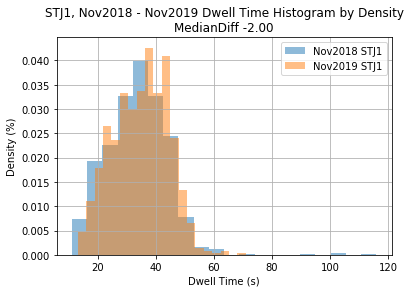

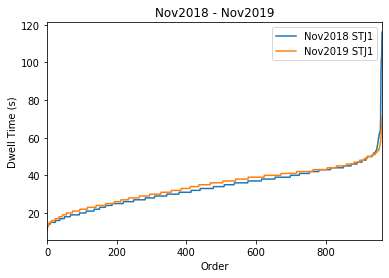


Platform Name STJ2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1400.000000
mean       23.408571
std         7.435897
min        13.000000
25%        19.000000
50%        22.000000
75%        26.000000
max       117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1400.000000
mean       22.579286
std         6.241689
min        12.000000
25%        19.000000
50%        22.000000
75%        25.000000
max        90.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0036218385756953326
Dwell Time Decrease IS Signficiant


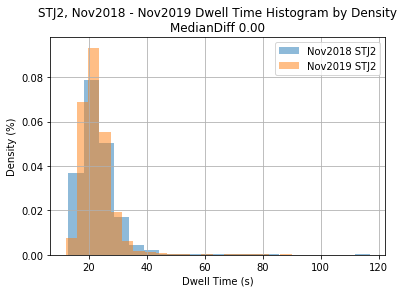

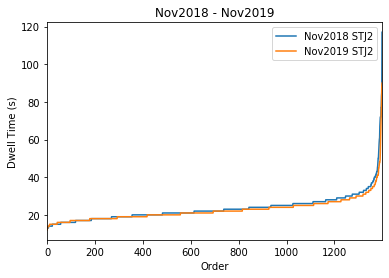


Platform Name STL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2191.000000
mean       23.023733
std         6.966022
min        12.000000
25%        19.000000
50%        22.000000
75%        25.000000
max        80.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2191.000000
mean       30.493382
std         9.778031
min        12.000000
25%        23.000000
50%        29.000000
75%        36.000000
max       100.000000
Name: time, dtype: float64
KS two-sample test pValue 4.792568722914079e-159
Dwell Time Decrease IS Signficiant


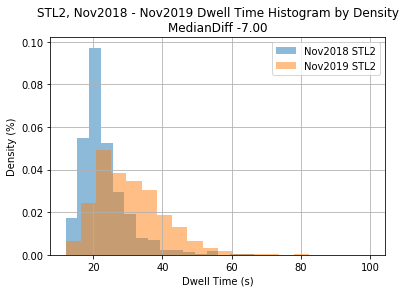

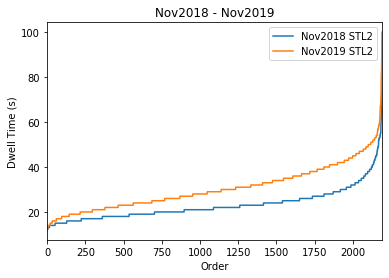


Platform Name STL3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2146.000000
mean       30.183131
std        13.249111
min        13.000000
25%        21.000000
50%        26.000000
75%        35.000000
max        94.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2146.000000
mean       28.535415
std        12.272352
min        11.000000
25%        21.000000
50%        25.000000
75%        31.750000
max       109.000000
Name: time, dtype: float64
KS two-sample test pValue 8.424153266362569e-05
Dwell Time Increase IS Signficiant


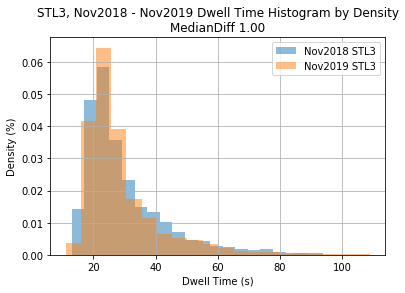

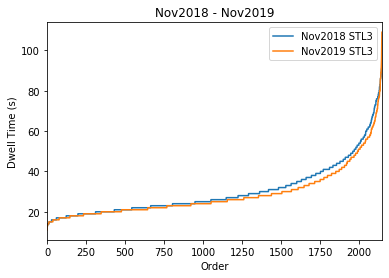


Platform Name STM1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    518.000000
mean      23.025097
std        8.241363
min       12.000000
25%       18.000000
50%       21.000000
75%       26.000000
max       86.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    518.000000
mean      25.936293
std       10.506413
min       12.000000
25%       20.000000
50%       23.000000
75%       28.000000
max       97.000000
Name: time, dtype: float64
KS two-sample test pValue 2.3629178279207566e-08
Dwell Time Decrease IS Signficiant


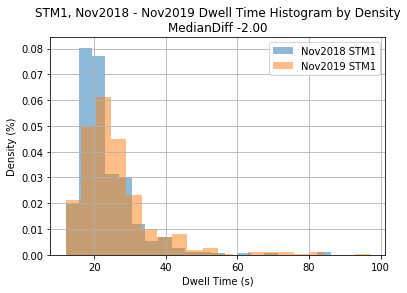

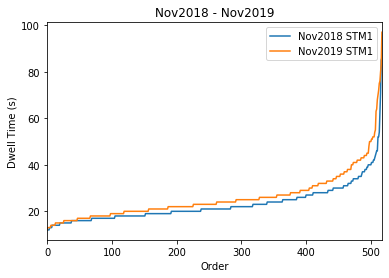


Platform Name STM2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    313.000000
mean      26.335463
std        9.841008
min       13.000000
25%       20.000000
50%       24.000000
75%       29.000000
max       74.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    313.000000
mean      26.632588
std        9.040640
min       12.000000
25%       21.000000
50%       25.000000
75%       30.000000
max       82.000000
Name: time, dtype: float64
KS two-sample test pValue 0.8089495241615403
Dwell Time Decrease NOT Signficiant


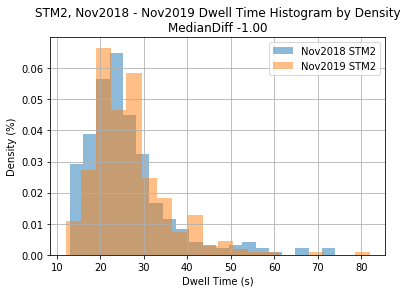

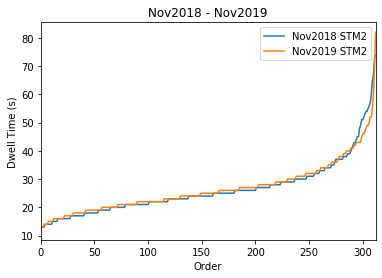


Platform Name STM3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    119.000000
mean      25.134454
std       10.802483
min       15.000000
25%       19.000000
50%       22.000000
75%       27.000000
max       87.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    119.000000
mean      28.193277
std       14.688447
min       14.000000
25%       19.000000
50%       24.000000
75%       30.500000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 0.13150234226220237
Dwell Time Decrease NOT Signficiant


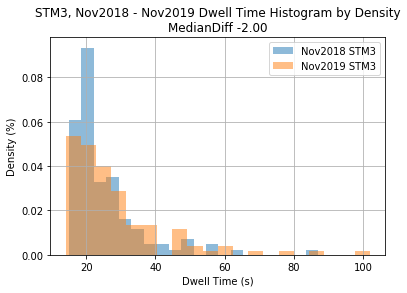

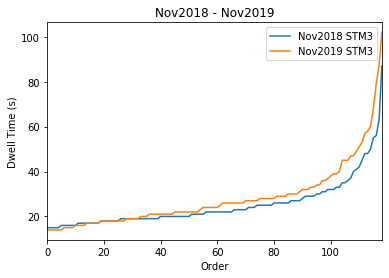


Platform Name STM4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    740.000000
mean      29.233784
std       13.900602
min       14.000000
25%       20.000000
50%       24.000000
75%       34.000000
max      114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    740.000000
mean      33.117568
std       16.266837
min       12.000000
25%       23.000000
50%       29.000000
75%       38.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 2.176858118141955e-10
Dwell Time Decrease IS Signficiant


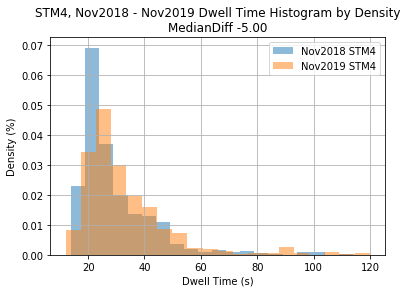

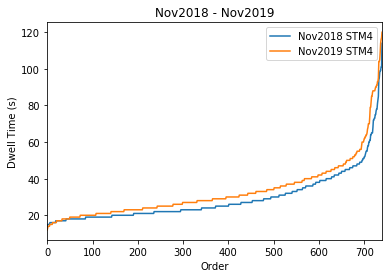


Platform Name STP1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    484.000000
mean      24.400826
std        9.229559
min       11.000000
25%       19.000000
50%       22.000000
75%       29.000000
max      100.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    484.000000
mean      24.508264
std        6.789190
min       11.000000
25%       19.000000
50%       24.000000
75%       28.000000
max       65.000000
Name: time, dtype: float64
KS two-sample test pValue 0.03658050076825413
Dwell Time Decrease IS Signficiant


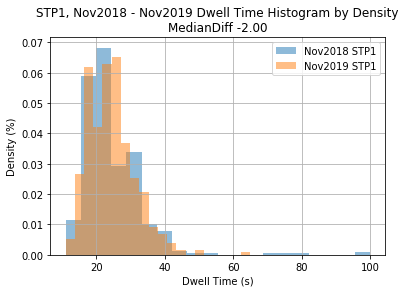

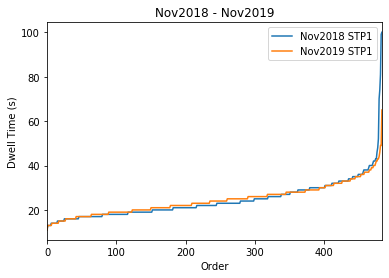


Platform Name STP2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    529.000000
mean      19.047259
std        3.930220
min       12.000000
25%       17.000000
50%       18.000000
75%       20.000000
max       41.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    529.000000
mean      20.586011
std        5.100939
min       12.000000
25%       17.000000
50%       19.000000
75%       23.000000
max       58.000000
Name: time, dtype: float64
KS two-sample test pValue 3.4677011823818415e-08
Dwell Time Decrease IS Signficiant


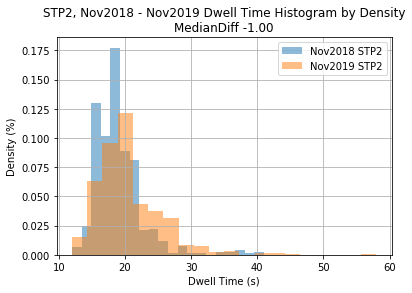

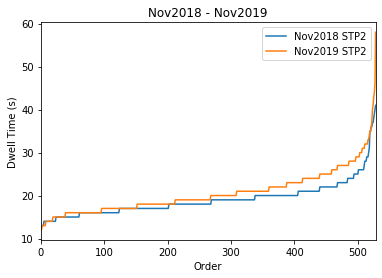


Platform Name STP3

Platform Name STP4

Platform Name STR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    178.000000
mean      48.235955
std       26.189670
min       21.000000
25%       29.000000
50%       34.000000
75%       69.500000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    178.000000
mean      52.044944
std       25.425380
min       18.000000
25%       32.000000
50%       43.000000
75%       66.750000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00014941247003428962
Dwell Time Decrease IS Signficiant


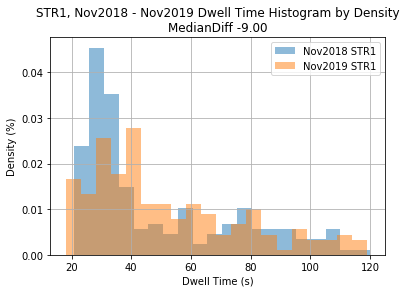

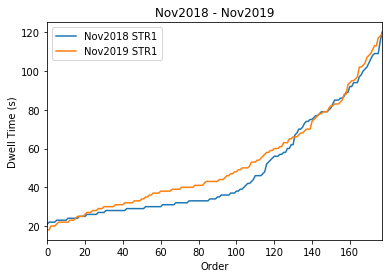


Platform Name STR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    147.000000
mean      36.965986
std       24.514579
min       14.000000
25%       23.000000
50%       27.000000
75%       36.500000
max      118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    147.00000
mean      33.22449
std       13.66868
min       17.00000
25%       24.50000
50%       29.00000
75%       38.00000
max      106.00000
Name: time, dtype: float64
KS two-sample test pValue 0.2799478952553812
Dwell Time Decrease NOT Signficiant


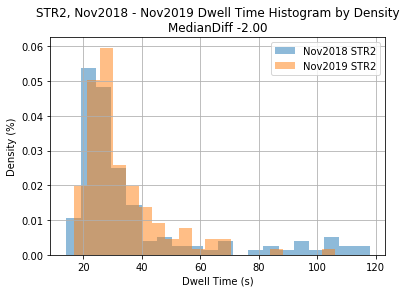

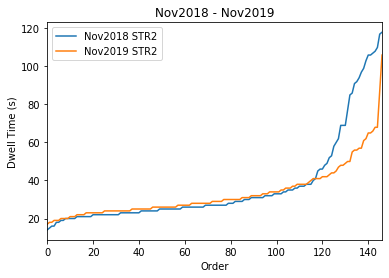


Platform Name STR3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    263.000000
mean      45.726236
std       26.460131
min       16.000000
25%       26.000000
50%       34.000000
75%       60.500000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    263.000000
mean      48.692015
std       26.076082
min       20.000000
25%       29.000000
50%       39.000000
75%       62.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.06522858078440581
Dwell Time Decrease NOT Signficiant


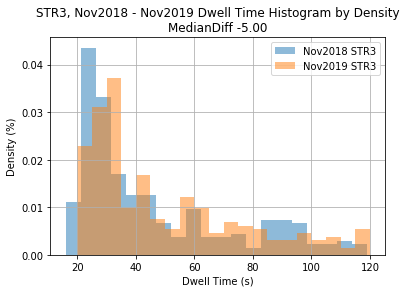

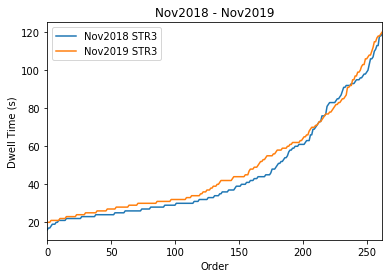


Platform Name STR4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1240.000000
mean       35.320161
std        19.577002
min        15.000000
25%        23.000000
50%        28.000000
75%        40.000000
max       118.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1240.000000
mean       33.758871
std        16.950169
min        15.000000
25%        24.000000
50%        28.000000
75%        37.000000
max       119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.030556872800435276
Dwell Time Decrease IS Signficiant


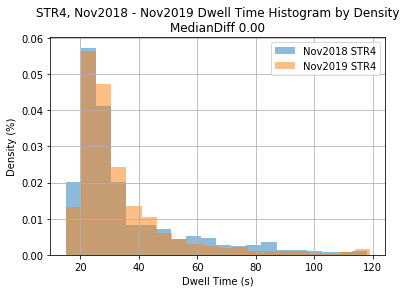

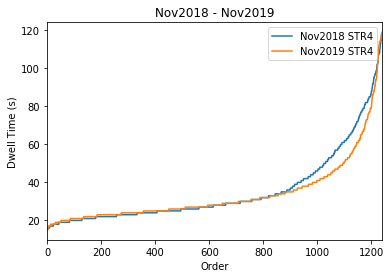


Platform Name STR5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    668.000000
mean      62.645210
std       30.465133
min       15.000000
25%       33.000000
50%       59.000000
75%       90.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    668.000000
mean      64.700599
std       28.535680
min       16.000000
25%       38.000000
50%       64.000000
75%       89.000000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 0.025384549722723776
Dwell Time Decrease IS Signficiant


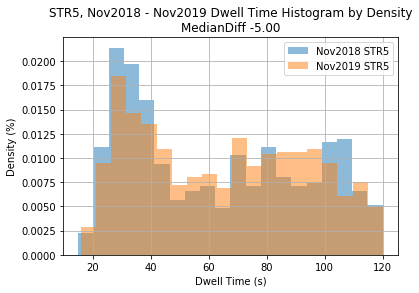

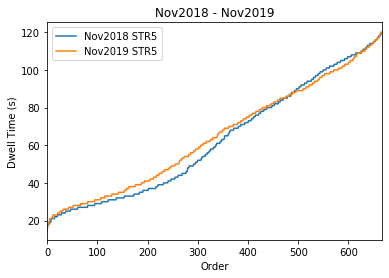


Platform Name STR6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2135.000000
mean       32.665105
std        15.162932
min        16.000000
25%        24.000000
50%        28.000000
75%        34.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2135.000000
mean       38.447775
std        18.172220
min        17.000000
25%        27.000000
50%        32.000000
75%        43.000000
max       117.000000
Name: time, dtype: float64
KS two-sample test pValue 3.1338867398592965e-37
Dwell Time Decrease IS Signficiant


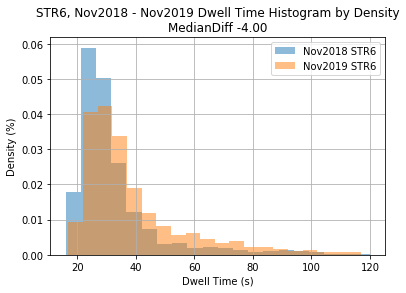

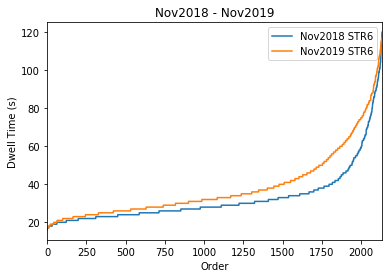


Platform Name STR7
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    866.000000
mean      33.660508
std       15.062651
min       14.000000
25%       25.000000
50%       29.000000
75%       36.000000
max       98.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    866.000000
mean      35.628176
std       16.360331
min       14.000000
25%       26.000000
50%       31.000000
75%       38.000000
max      101.000000
Name: time, dtype: float64
KS two-sample test pValue 0.00017137024990515772
Dwell Time Decrease IS Signficiant


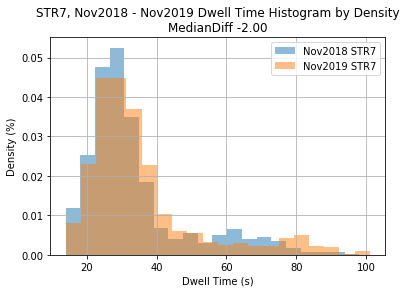

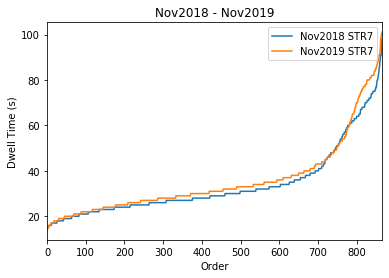


Platform Name STR8
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    878.000000
mean      41.861048
std       17.304143
min       15.000000
25%       26.000000
50%       39.000000
75%       57.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    878.000000
mean      47.900911
std       17.117155
min       17.000000
25%       33.000000
50%       49.000000
75%       59.000000
max      117.000000
Name: time, dtype: float64
KS two-sample test pValue 2.299595275012478e-12
Dwell Time Decrease IS Signficiant


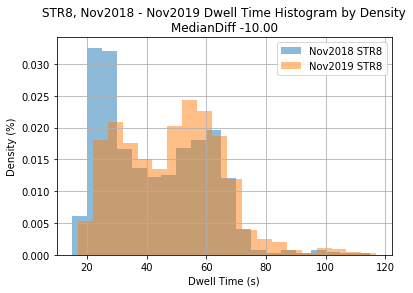

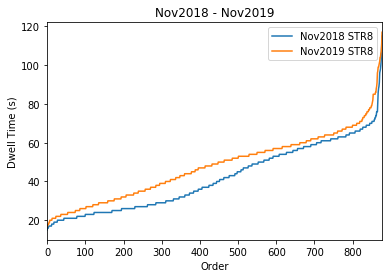


Platform Name SVH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1180.000000
mean       25.668644
std        11.294254
min        12.000000
25%        19.000000
50%        22.000000
75%        29.000000
max       113.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1180.000000
mean       27.250847
std        10.788181
min        13.000000
25%        20.000000
50%        24.000000
75%        31.000000
max        98.000000
Name: time, dtype: float64
KS two-sample test pValue 2.401673975236301e-07
Dwell Time Decrease IS Signficiant


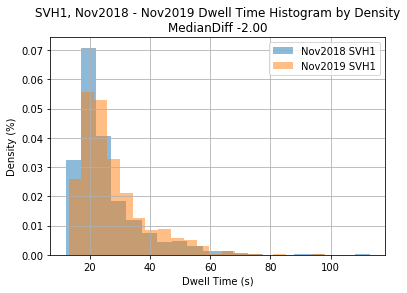

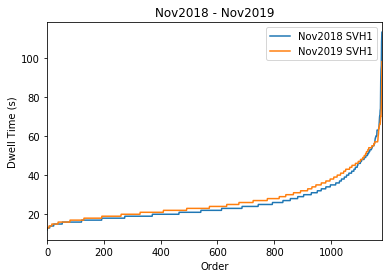


Platform Name SVH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    339.000000
mean      25.283186
std        7.971995
min       12.000000
25%       20.000000
50%       24.000000
75%       28.500000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    339.000000
mean      28.309735
std        9.059056
min       14.000000
25%       22.000000
50%       27.000000
75%       33.000000
max       77.000000
Name: time, dtype: float64
KS two-sample test pValue 6.68938809852398e-05
Dwell Time Decrease IS Signficiant


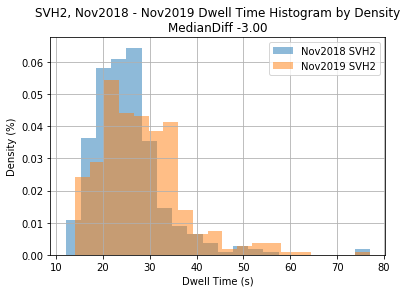

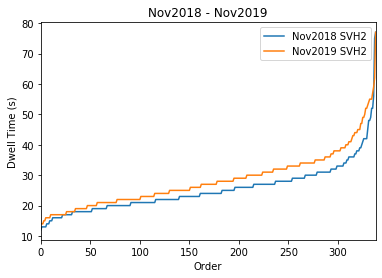


Platform Name SVH3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    351.000000
mean      34.501425
std       20.844441
min       14.000000
25%       21.000000
50%       26.000000
75%       38.000000
max      116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    351.000000
mean      40.196581
std       22.772881
min       14.000000
25%       23.000000
50%       32.000000
75%       50.500000
max      120.000000
Name: time, dtype: float64
KS two-sample test pValue 3.0499844637464804e-07
Dwell Time Decrease IS Signficiant


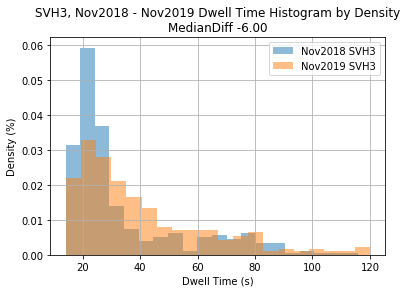

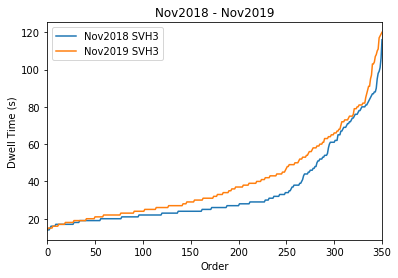


Platform Name SVH4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1187.000000
mean       33.420388
std        23.719184
min        13.000000
25%        20.000000
50%        24.000000
75%        33.500000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1187.000000
mean       35.181129
std        23.403601
min        13.000000
25%        21.000000
50%        26.000000
75%        37.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 6.370997742084491e-08
Dwell Time Decrease IS Signficiant


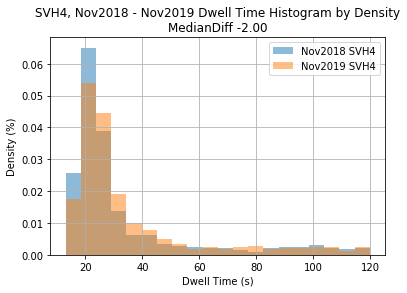

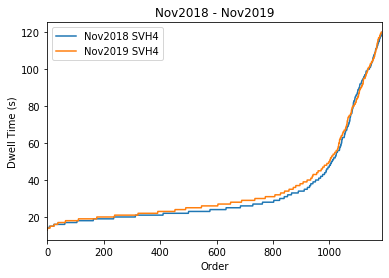


Platform Name SYD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    563.000000
mean      32.197158
std       12.273073
min       14.000000
25%       24.500000
50%       30.000000
75%       37.000000
max      110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    563.000000
mean      31.648313
std        9.957594
min       13.000000
25%       25.000000
50%       30.000000
75%       37.000000
max       92.000000
Name: time, dtype: float64
KS two-sample test pValue 0.9982920454791254
Dwell Time Decrease NOT Signficiant


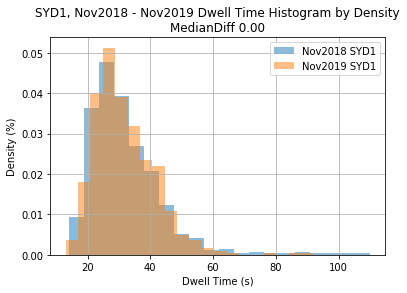

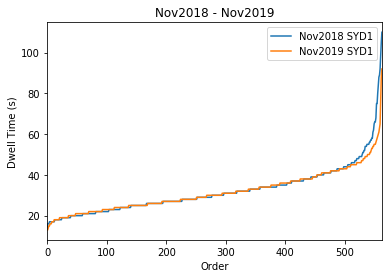


Platform Name SYD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    581.000000
mean      23.311532
std        7.606102
min       12.000000
25%       19.000000
50%       22.000000
75%       25.000000
max       99.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    581.000000
mean      25.032702
std        8.820663
min       14.000000
25%       20.000000
50%       23.000000
75%       26.000000
max       89.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0013771353047142153
Dwell Time Decrease IS Signficiant


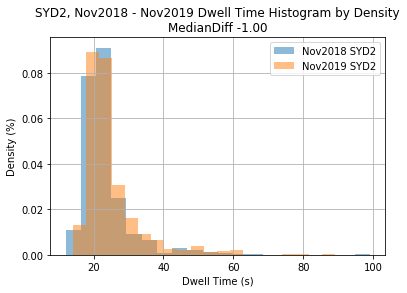

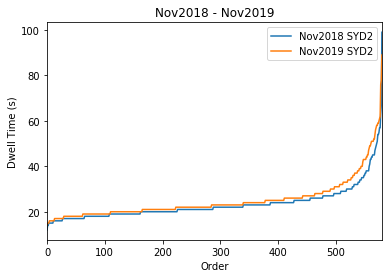


Platform Name TGB1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    746.000000
mean      27.841823
std       12.470063
min       11.000000
25%       18.000000
50%       22.000000
75%       36.750000
max       81.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    746.000000
mean      29.817694
std       12.678852
min       11.000000
25%       19.000000
50%       26.000000
75%       39.000000
max       92.000000
Name: time, dtype: float64
KS two-sample test pValue 2.9604295654659768e-05
Dwell Time Decrease IS Signficiant


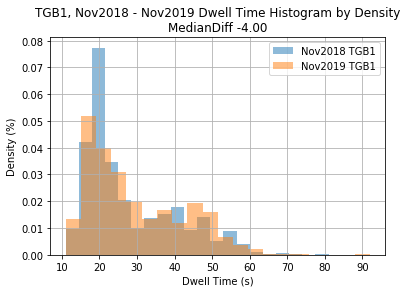

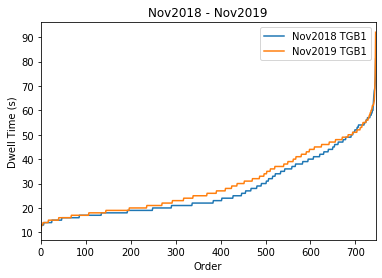


Platform Name TGB2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    37.000000
mean     20.594595
std       7.715279
min      12.000000
25%      16.000000
50%      19.000000
75%      22.000000
max      53.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    37.000000
mean     21.648649
std       6.490233
min      12.000000
25%      17.000000
50%      20.000000
75%      24.000000
max      39.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7227565530633371
Dwell Time Decrease NOT Signficiant


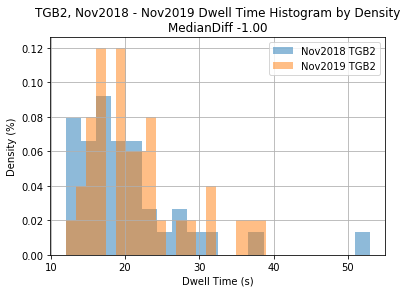

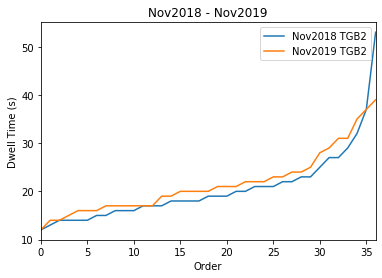


Platform Name TGB3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    84.000000
mean     23.773810
std      11.796825
min      14.000000
25%      18.000000
50%      20.000000
75%      25.000000
max      82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    84.000000
mean     21.916667
std       7.410849
min      13.000000
25%      16.750000
50%      20.000000
75%      24.000000
max      52.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5939882493667966
Dwell Time Decrease NOT Signficiant


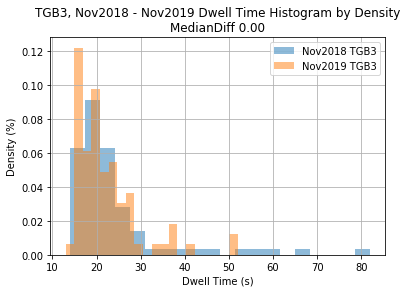

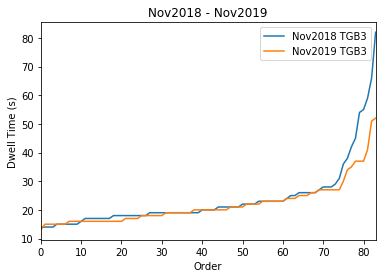


Platform Name TGB4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    723.000000
mean      20.846473
std        7.406290
min       11.000000
25%       17.000000
50%       19.000000
75%       22.000000
max      112.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    723.000000
mean      22.846473
std        8.237469
min       12.000000
25%       18.000000
50%       21.000000
75%       24.000000
max      100.000000
Name: time, dtype: float64
KS two-sample test pValue 1.8761124250850355e-07
Dwell Time Decrease IS Signficiant


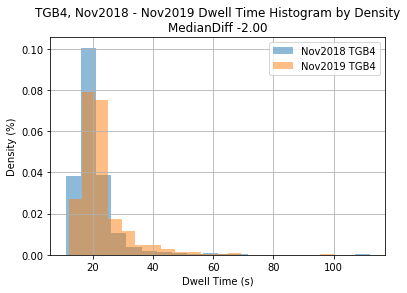

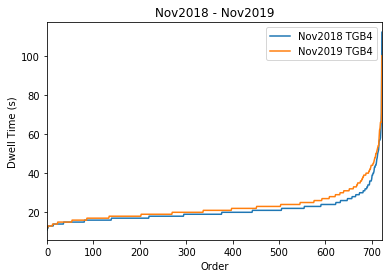


Platform Name THL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    964.000000
mean      57.483402
std       17.000419
min       15.000000
25%       45.000000
50%       61.000000
75%       70.000000
max      115.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    964.000000
mean      59.782158
std       15.499849
min       17.000000
25%       50.000000
50%       63.000000
75%       70.000000
max      113.000000
Name: time, dtype: float64
KS two-sample test pValue 0.02178105686417542
Dwell Time Decrease IS Signficiant


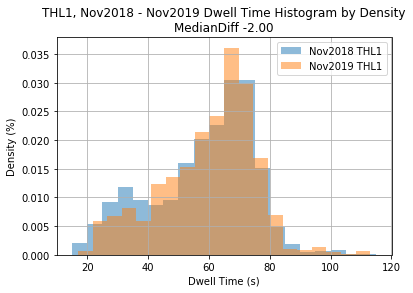

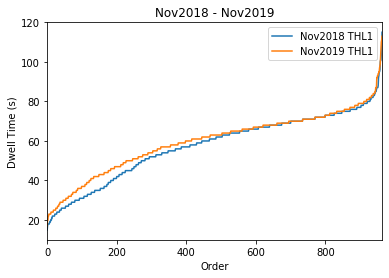


Platform Name THL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1712.000000
mean       72.396028
std        28.467331
min        17.000000
25%        49.000000
50%        65.000000
75%       101.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1712.000000
mean       75.729556
std        27.929880
min        19.000000
25%        50.000000
50%        76.000000
75%       102.000000
max       120.000000
Name: time, dtype: float64
KS two-sample test pValue 2.0874103868787318e-09
Dwell Time Decrease IS Signficiant


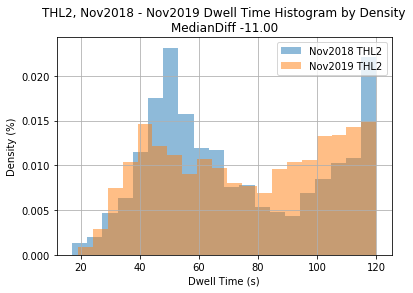

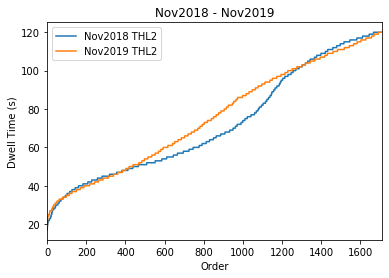


Platform Name THL3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2410.000000
mean       35.533195
std        13.244199
min        14.000000
25%        26.000000
50%        32.000000
75%        41.000000
max       105.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2410.000000
mean       34.978008
std        11.874671
min        14.000000
25%        27.000000
50%        33.000000
75%        40.000000
max       119.000000
Name: time, dtype: float64
KS two-sample test pValue 0.05525388776112086
Dwell Time Decrease NOT Signficiant


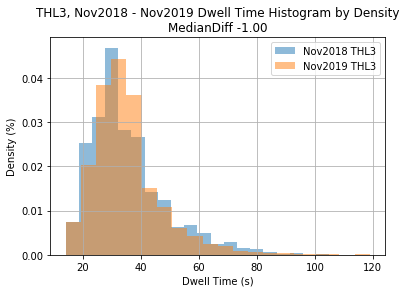

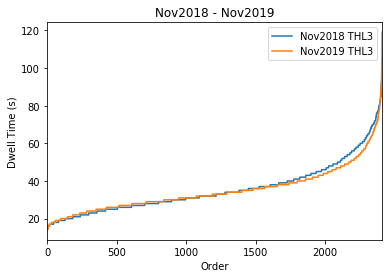


Platform Name THL6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1421.000000
mean       27.925405
std         8.107816
min        13.000000
25%        22.000000
50%        27.000000
75%        32.000000
max        84.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1421.000000
mean       31.072484
std        10.787105
min        14.000000
25%        24.000000
50%        29.000000
75%        36.000000
max       113.000000
Name: time, dtype: float64
KS two-sample test pValue 1.3232139207757046e-11
Dwell Time Decrease IS Signficiant


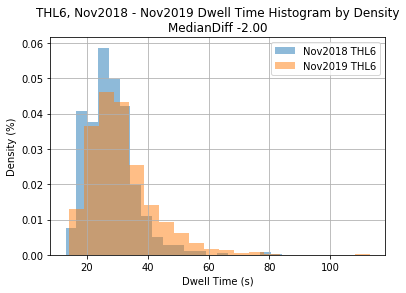

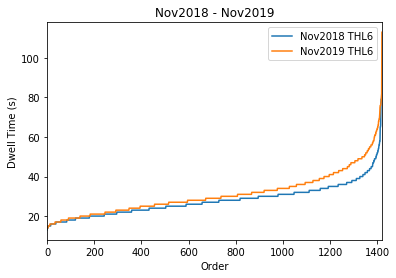


Platform Name THR1

Platform Name THR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    863.000000
mean      18.025492
std        4.111192
min       11.000000
25%       16.000000
50%       17.000000
75%       20.000000
max       59.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    863.000000
mean      18.497103
std        6.199669
min       11.000000
25%       15.000000
50%       17.000000
75%       20.000000
max      103.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5536820392891787
Dwell Time Decrease NOT Signficiant


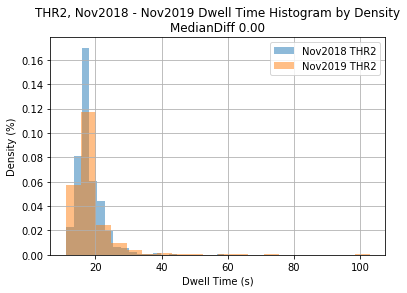

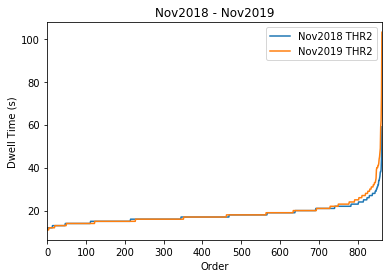


Platform Name THR3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    792.000000
mean      26.094697
std       10.829555
min       12.000000
25%       18.000000
50%       22.000000
75%       34.000000
max       85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    792.000000
mean      26.563131
std       10.109442
min       12.000000
25%       19.000000
50%       24.000000
75%       34.000000
max       83.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0019759474419331537
Dwell Time Decrease IS Signficiant


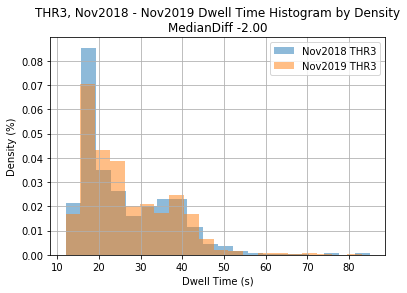

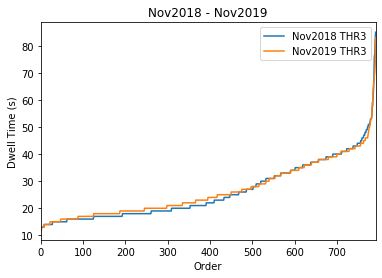


Platform Name TRL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    449.000000
mean      54.193764
std       17.478567
min       12.000000
25%       43.000000
50%       59.000000
75%       67.000000
max       93.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    449.000000
mean      54.668151
std       16.186108
min       13.000000
25%       47.000000
50%       59.000000
75%       66.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 0.7105369953417324
Dwell Time Decrease NOT Signficiant


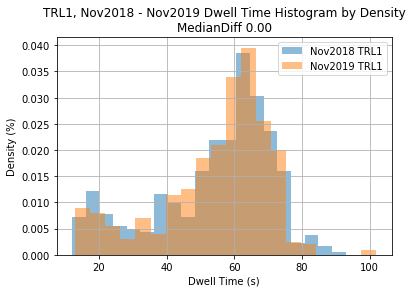

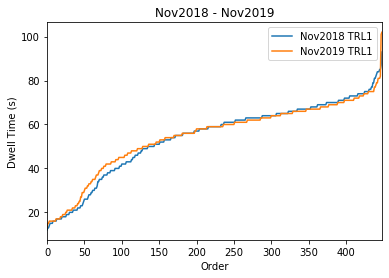


Platform Name TRL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    419.000000
mean      18.620525
std        6.161049
min       12.000000
25%       16.000000
50%       18.000000
75%       19.500000
max       69.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    419.000000
mean      18.718377
std        4.284379
min       12.000000
25%       16.000000
50%       18.000000
75%       20.000000
max       53.000000
Name: time, dtype: float64
KS two-sample test pValue 0.20174154089717594
Dwell Time Decrease NOT Signficiant


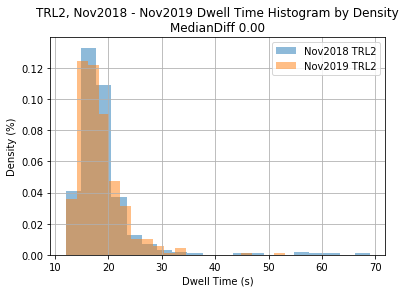

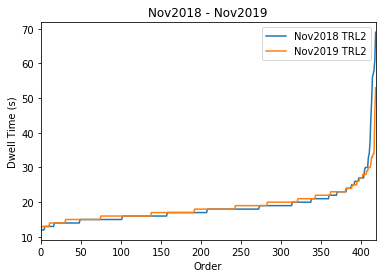


Platform Name TUR1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1201.000000
mean       23.587011
std        13.602670
min        10.000000
25%        17.000000
50%        19.000000
75%        24.000000
max       114.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1201.000000
mean       22.333056
std         7.484806
min        12.000000
25%        18.000000
50%        21.000000
75%        25.000000
max        97.000000
Name: time, dtype: float64
KS two-sample test pValue 5.005943085592443e-07
Dwell Time Decrease IS Signficiant


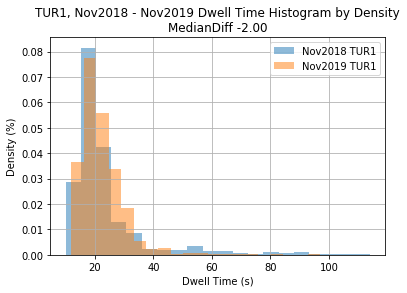

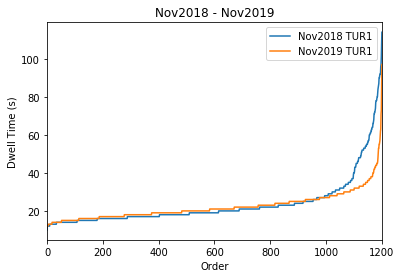


Platform Name TUR2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1150.000000
mean       22.597391
std         8.193408
min        11.000000
25%        18.000000
50%        21.000000
75%        24.000000
max        97.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1150.000000
mean       23.391304
std         6.193705
min        12.000000
25%        19.000000
50%        22.000000
75%        26.000000
max        91.000000
Name: time, dtype: float64
KS two-sample test pValue 3.024271614094412e-11
Dwell Time Decrease IS Signficiant


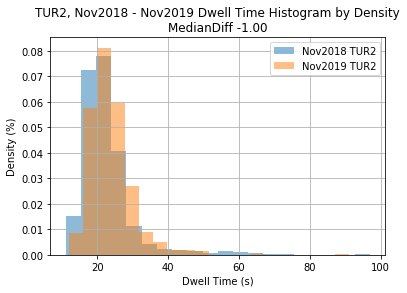

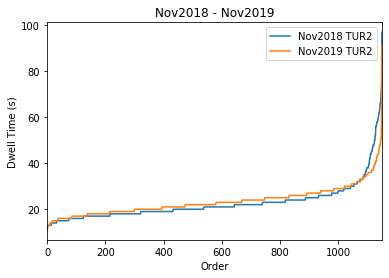


Platform Name VLW1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    156.000000
mean      50.121795
std       20.184741
min       12.000000
25%       34.750000
50%       53.000000
75%       68.250000
max       83.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    156.000000
mean      54.307692
std       19.771474
min       13.000000
25%       40.000000
50%       60.000000
75%       68.000000
max      102.000000
Name: time, dtype: float64
KS two-sample test pValue 0.04969119284270125
Dwell Time Decrease IS Signficiant


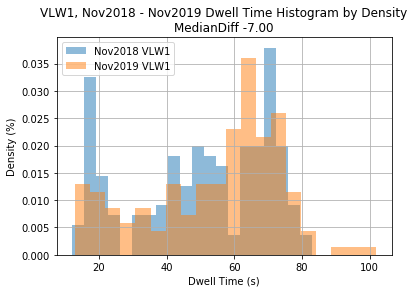

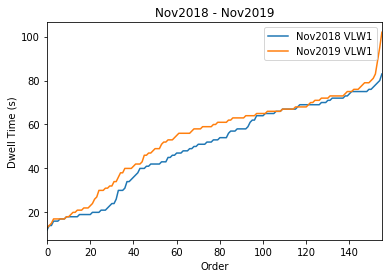


Platform Name VLW2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    129.000000
mean      26.488372
std       11.543475
min       12.000000
25%       18.000000
50%       22.000000
75%       36.000000
max       66.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    129.000000
mean      25.573643
std       10.944302
min       13.000000
25%       17.000000
50%       23.000000
75%       33.000000
max       83.000000
Name: time, dtype: float64
KS two-sample test pValue 0.27494082748745724
Dwell Time Decrease NOT Signficiant


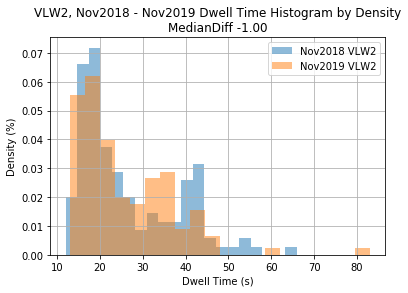

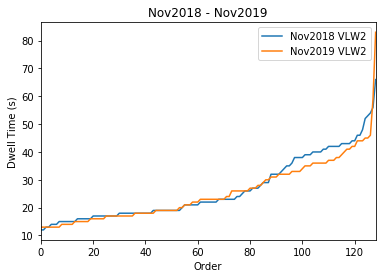


Platform Name VNY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1052.000000
mean       21.197719
std        12.618718
min        11.000000
25%        15.000000
50%        17.000000
75%        20.000000
max        84.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1052.000000
mean       22.884981
std        15.168733
min        11.000000
25%        15.000000
50%        17.000000
75%        21.000000
max       109.000000
Name: time, dtype: float64
KS two-sample test pValue 0.02802036927351348
Dwell Time Decrease IS Signficiant


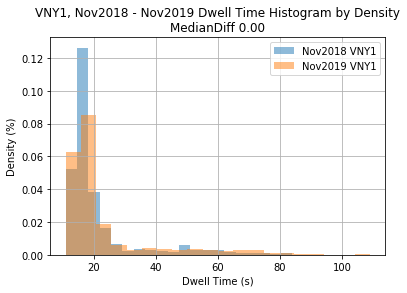

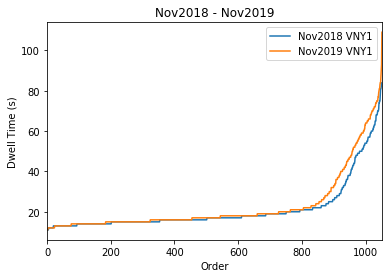


Platform Name WAH1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1048.000000
mean       18.284351
std         4.871144
min        11.000000
25%        15.000000
50%        17.000000
75%        20.000000
max        61.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1048.000000
mean       18.619275
std         4.983170
min        11.000000
25%        16.000000
50%        18.000000
75%        20.000000
max       105.000000
Name: time, dtype: float64
KS two-sample test pValue 0.009313933865825621
Dwell Time Decrease IS Signficiant


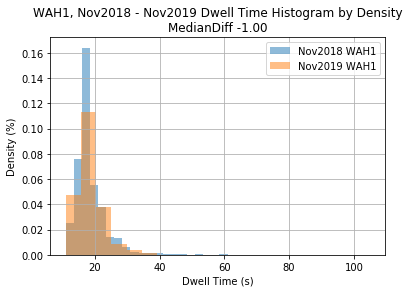

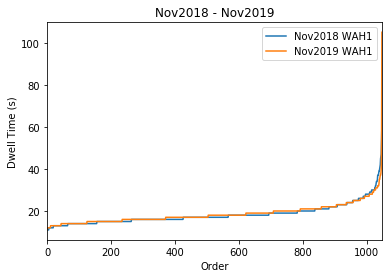


Platform Name WAH2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    999.000000
mean      19.848849
std        4.626336
min       12.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       51.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    999.000000
mean      24.601602
std        7.203834
min       12.000000
25%       19.000000
50%       23.000000
75%       29.000000
max       55.000000
Name: time, dtype: float64
KS two-sample test pValue 5.58082303216293e-52
Dwell Time Decrease IS Signficiant


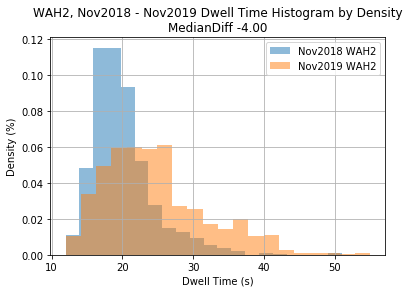

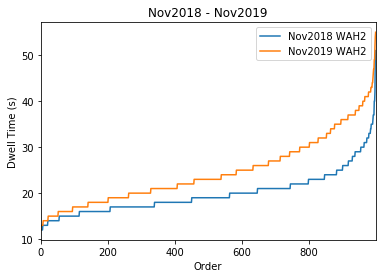


Platform Name WAI1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1089.000000
mean       19.326905
std         5.139204
min        11.000000
25%        16.000000
50%        19.000000
75%        21.000000
max       107.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1089.000000
mean       21.235078
std         7.919042
min        12.000000
25%        17.000000
50%        20.000000
75%        23.000000
max       118.000000
Name: time, dtype: float64
KS two-sample test pValue 4.91653823076798e-10
Dwell Time Decrease IS Signficiant


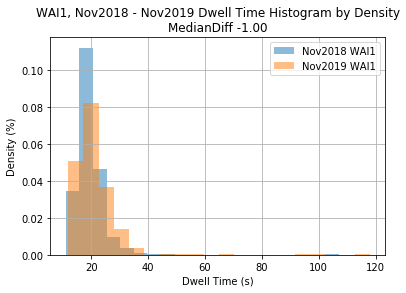

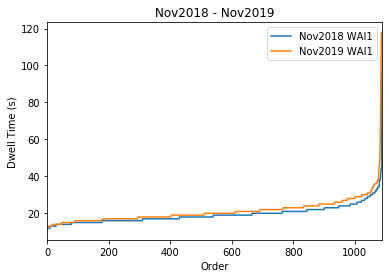


Platform Name WAI2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1153.000000
mean       38.105811
std        19.757275
min        12.000000
25%        21.000000
50%        32.000000
75%        52.000000
max       111.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1153.000000
mean       27.059844
std        13.415271
min        12.000000
25%        20.000000
50%        23.000000
75%        28.000000
max        99.000000
Name: time, dtype: float64
KS two-sample test pValue 1.571139598573619e-58
Dwell Time Increase IS Signficiant


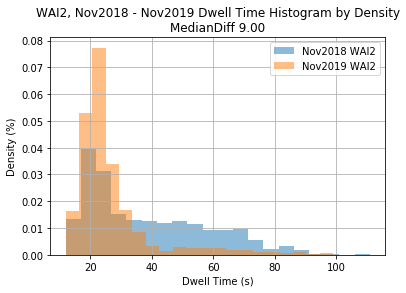

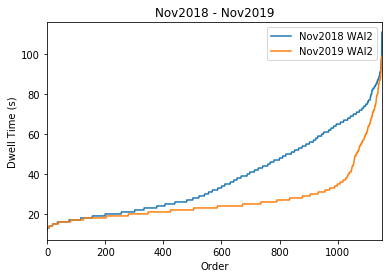


Platform Name WAV1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1997.000000
mean       18.094141
std         5.111889
min        11.000000
25%        15.000000
50%        17.000000
75%        19.000000
max       100.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1997.000000
mean       18.634452
std         4.313210
min        12.000000
25%        16.000000
50%        18.000000
75%        20.000000
max        68.000000
Name: time, dtype: float64
KS two-sample test pValue 6.105720821346419e-07
Dwell Time Decrease IS Signficiant


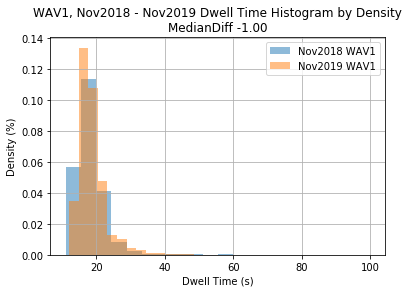

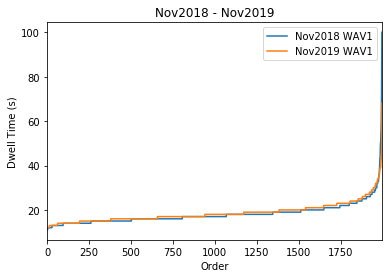


Platform Name WAV2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1936.000000
mean       19.235021
std         3.841435
min        12.000000
25%        17.000000
50%        19.000000
75%        21.000000
max        64.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1936.000000
mean       19.803202
std         4.627522
min        12.000000
25%        17.000000
50%        19.000000
75%        22.000000
max       116.000000
Name: time, dtype: float64
KS two-sample test pValue 2.8194439117468076e-05
Dwell Time Decrease IS Signficiant


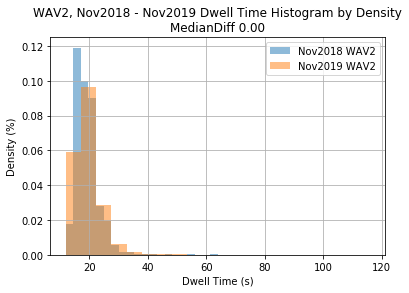

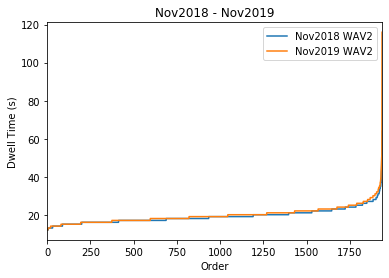


Platform Name WCI1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    875.000000
mean      31.219429
std       13.240422
min       15.000000
25%       22.000000
50%       27.000000
75%       37.000000
max       95.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    875.000000
mean      32.726857
std       13.528668
min       15.000000
25%       23.000000
50%       29.000000
75%       39.000000
max      108.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0011009484446087869
Dwell Time Decrease IS Signficiant


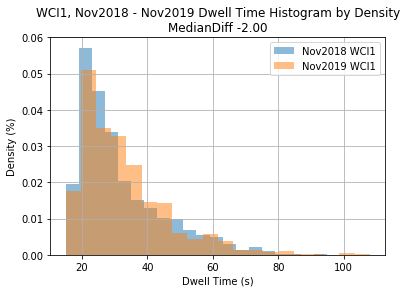

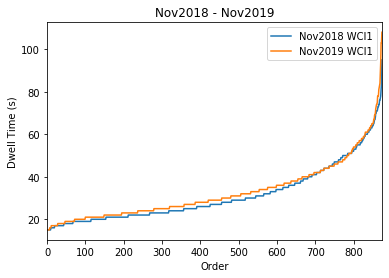


Platform Name WCI2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    842.000000
mean      40.720903
std       18.934878
min       15.000000
25%       24.000000
50%       34.000000
75%       56.000000
max      102.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    842.000000
mean      41.268409
std       17.684019
min       15.000000
25%       27.000000
50%       36.000000
75%       54.000000
max      115.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0009930316052329732
Dwell Time Decrease IS Signficiant


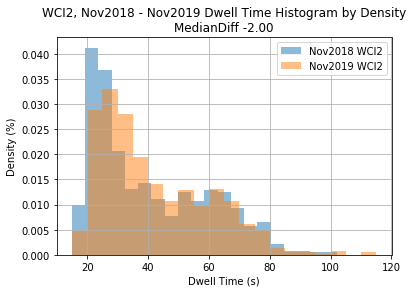

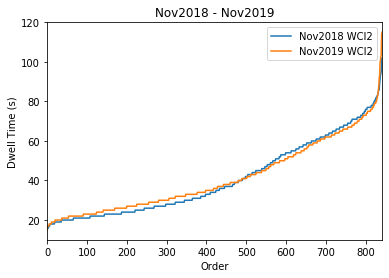


Platform Name WIN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1053.000000
mean       25.541311
std        12.398617
min        12.000000
25%        19.000000
50%        22.000000
75%        27.000000
max       116.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1053.000000
mean       26.606838
std        12.437495
min        12.000000
25%        20.000000
50%        24.000000
75%        29.000000
max       119.000000
Name: time, dtype: float64
KS two-sample test pValue 5.503266651103073e-07
Dwell Time Decrease IS Signficiant


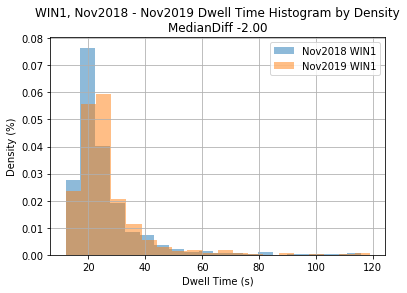

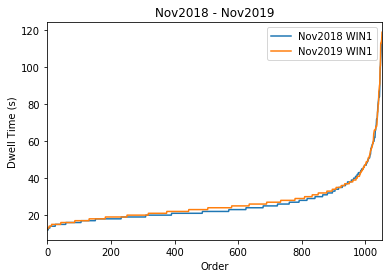


Platform Name WKF1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    802.000000
mean      31.396509
std       17.911626
min       11.000000
25%       17.000000
50%       21.000000
75%       49.000000
max       85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    802.000000
mean      34.177057
std       20.281381
min       11.000000
25%       17.000000
50%       23.000000
75%       55.000000
max      104.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0037101140043997046
Dwell Time Decrease IS Signficiant


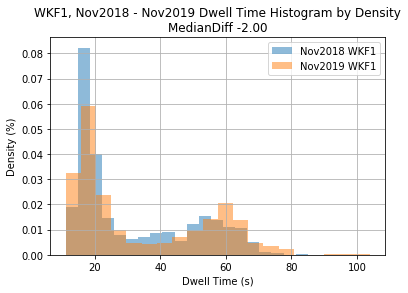

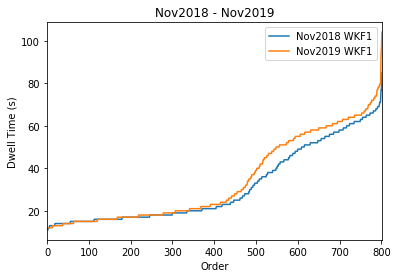


Platform Name WKF2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    826.000000
mean      23.690073
std       11.501919
min       11.000000
25%       17.000000
50%       19.000000
75%       25.000000
max       82.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    826.000000
mean      24.507264
std       11.289065
min       11.000000
25%       18.000000
50%       20.000000
75%       27.000000
max       99.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0008566461828911329
Dwell Time Decrease IS Signficiant


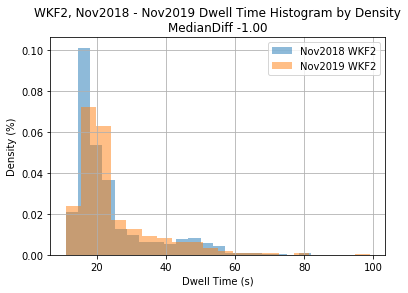

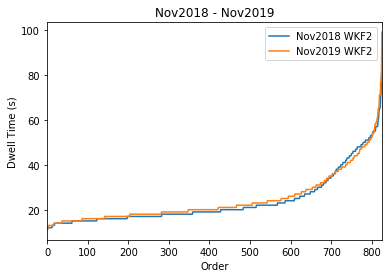


Platform Name WLS1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2000.000000
mean       18.802000
std         4.306979
min        11.000000
25%        16.000000
50%        18.000000
75%        20.000000
max        73.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2000.000000
mean       19.188000
std         3.840577
min        11.000000
25%        17.000000
50%        19.000000
75%        21.000000
max        63.000000
Name: time, dtype: float64
KS two-sample test pValue 1.5919996522366633e-08
Dwell Time Decrease IS Signficiant


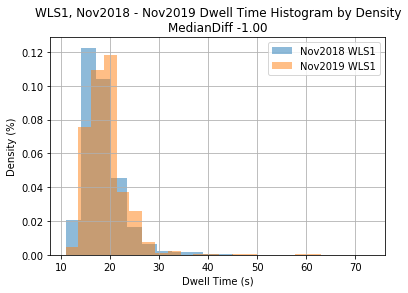

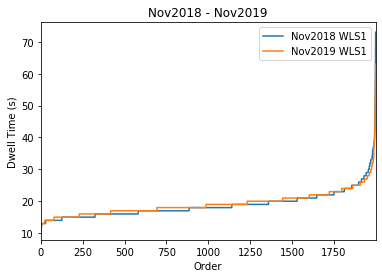


Platform Name WLS2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1941.000000
mean       19.145801
std         3.852549
min        11.000000
25%        17.000000
50%        18.000000
75%        21.000000
max        70.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1941.000000
mean       20.294178
std         4.511670
min        12.000000
25%        18.000000
50%        20.000000
75%        22.000000
max        89.000000
Name: time, dtype: float64
KS two-sample test pValue 4.595333653457946e-16
Dwell Time Decrease IS Signficiant


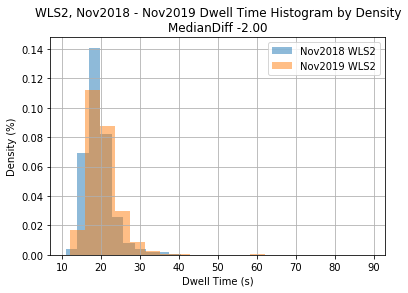

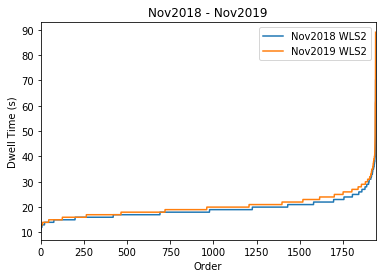


Platform Name WLY1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    492.000000
mean      22.750000
std        5.648252
min       12.000000
25%       19.000000
50%       22.000000
75%       26.000000
max       63.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    492.000000
mean      23.193089
std        6.098088
min       12.000000
25%       19.000000
50%       22.000000
75%       26.000000
max       78.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6023274815685765
Dwell Time Decrease NOT Signficiant


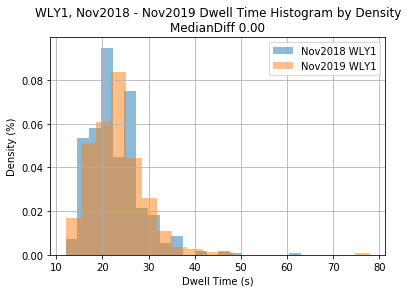

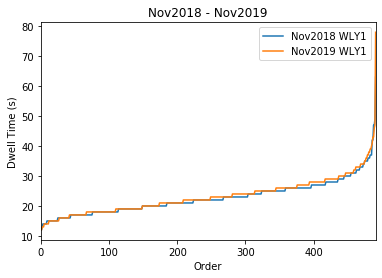


Platform Name WLY2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    536.000000
mean      26.035448
std        9.740399
min       13.000000
25%       18.000000
50%       24.000000
75%       32.000000
max       79.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    536.000000
mean      27.397388
std        8.818455
min       12.000000
25%       21.000000
50%       26.000000
75%       34.000000
max       92.000000
Name: time, dtype: float64
KS two-sample test pValue 2.2832879430577095e-05
Dwell Time Decrease IS Signficiant


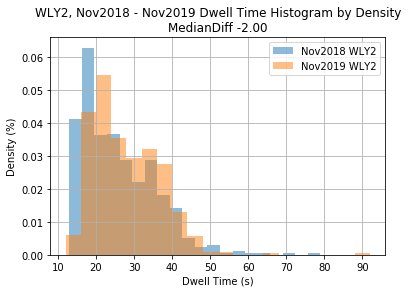

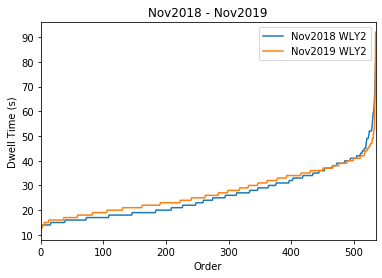


Platform Name WMD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1243.000000
mean       25.597747
std        13.055773
min        12.000000
25%        19.000000
50%        22.000000
75%        27.000000
max       120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1243.000000
mean       26.221239
std        11.871160
min        12.000000
25%        20.000000
50%        23.000000
75%        28.000000
max       119.000000
Name: time, dtype: float64
KS two-sample test pValue 1.1032490863591283e-07
Dwell Time Decrease IS Signficiant


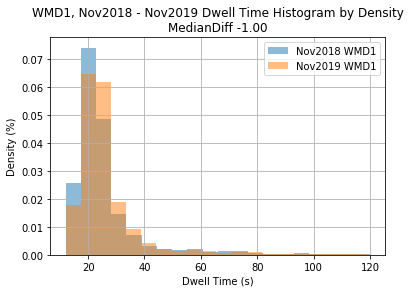

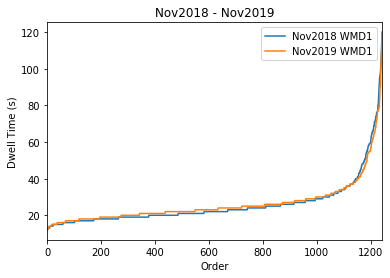


Platform Name WMD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    344.000000
mean      24.418605
std        9.604985
min       12.000000
25%       19.000000
50%       23.000000
75%       26.000000
max      101.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    344.000000
mean      23.462209
std        8.684544
min       13.000000
25%       19.000000
50%       22.000000
75%       25.000000
max      100.000000
Name: time, dtype: float64
KS two-sample test pValue 0.24006923714533787
Dwell Time Increase NOT Signficiant


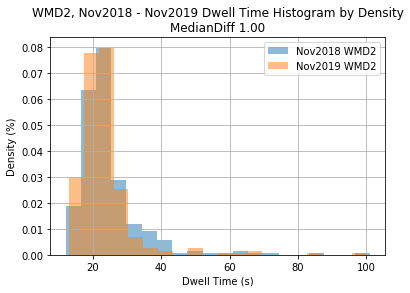

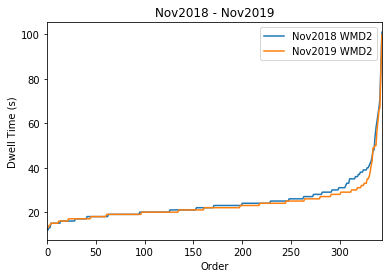


Platform Name WMD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    351.000000
mean      26.900285
std       10.706408
min       12.000000
25%       20.000000
50%       23.000000
75%       30.000000
max       69.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    351.000000
mean      29.618234
std       11.642636
min       12.000000
25%       21.000000
50%       27.000000
75%       36.000000
max       81.000000
Name: time, dtype: float64
KS two-sample test pValue 0.000656313058870449
Dwell Time Decrease IS Signficiant


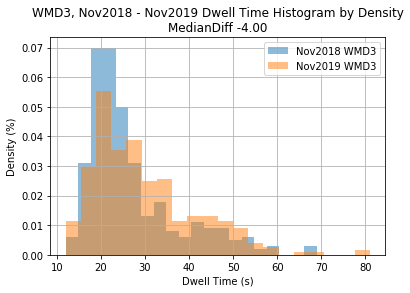

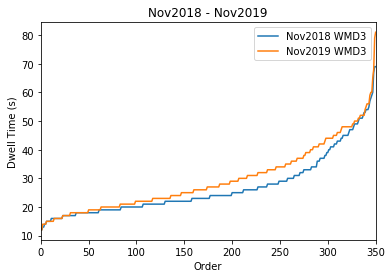


Platform Name WMD4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1221.000000
mean       25.723997
std         8.949677
min        12.000000
25%        19.000000
50%        23.000000
75%        30.000000
max        85.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1221.000000
mean       28.626536
std        10.600870
min        13.000000
25%        21.000000
50%        26.000000
75%        34.000000
max       118.000000
Name: time, dtype: float64
KS two-sample test pValue 5.32892343361286e-15
Dwell Time Decrease IS Signficiant


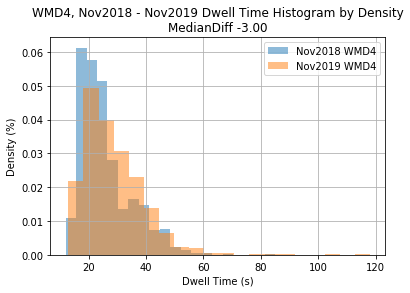

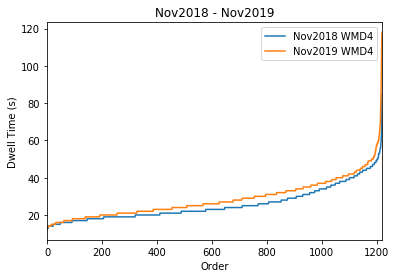


Platform Name WRD1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    153.000000
mean      24.575163
std        9.483152
min       16.000000
25%       19.000000
50%       22.000000
75%       26.000000
max       77.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    153.000000
mean      23.928105
std        5.446033
min       16.000000
25%       20.000000
50%       23.000000
75%       26.000000
max       46.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3737884999691056
Dwell Time Decrease NOT Signficiant


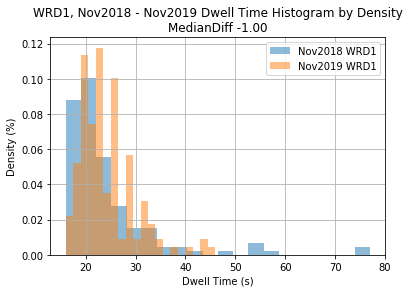

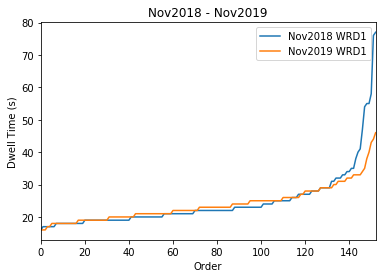


Platform Name WRD2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    772.000000
mean      29.882124
std       15.472174
min       14.000000
25%       20.750000
50%       26.000000
75%       34.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    772.000000
mean      28.488342
std       12.544442
min       12.000000
25%       21.000000
50%       26.000000
75%       32.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.1822519888756969
Dwell Time Decrease NOT Signficiant


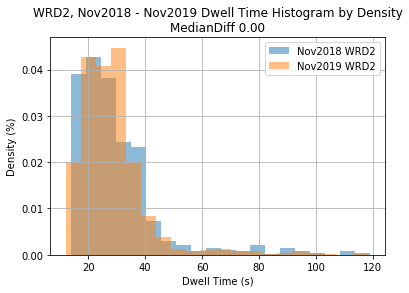

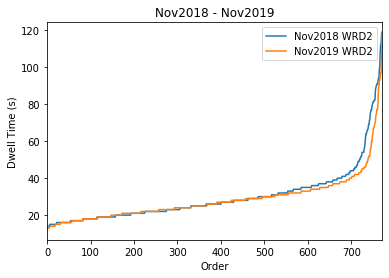


Platform Name WRD3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    947.000000
mean      22.718057
std        6.072825
min       13.000000
25%       19.000000
50%       22.000000
75%       24.000000
max       78.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    947.000000
mean      24.511088
std        6.502450
min       14.000000
25%       21.000000
50%       24.000000
75%       27.000000
max       87.000000
Name: time, dtype: float64
KS two-sample test pValue 1.047438773493793e-14
Dwell Time Decrease IS Signficiant


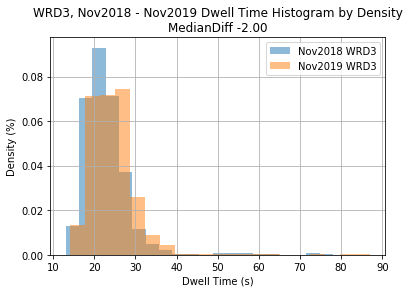

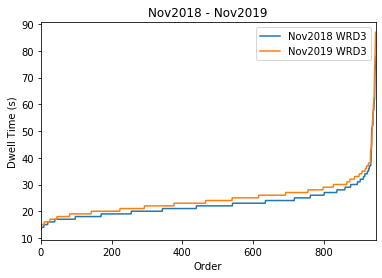


Platform Name WRG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    827.000000
mean      26.723096
std       15.532501
min       11.000000
25%       16.000000
50%       20.000000
75%       32.000000
max      103.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    827.000000
mean      27.322854
std       15.500949
min       12.000000
25%       17.000000
50%       21.000000
75%       32.000000
max      100.000000
Name: time, dtype: float64
KS two-sample test pValue 0.09730020601679108
Dwell Time Decrease NOT Signficiant


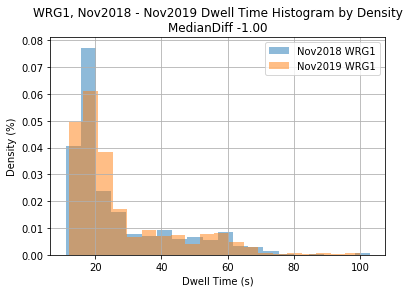

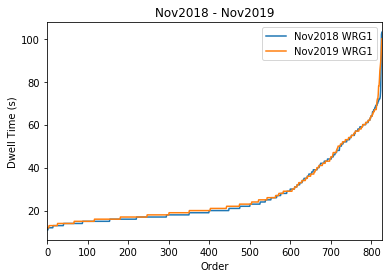


Platform Name WRG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    872.000000
mean      23.557339
std       12.412409
min       12.000000
25%       16.000000
50%       19.000000
75%       24.000000
max      119.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    872.000000
mean      26.036697
std       15.421027
min       12.000000
25%       17.000000
50%       20.000000
75%       27.000000
max      119.000000
Name: time, dtype: float64
KS two-sample test pValue 2.353311480234025e-06
Dwell Time Decrease IS Signficiant


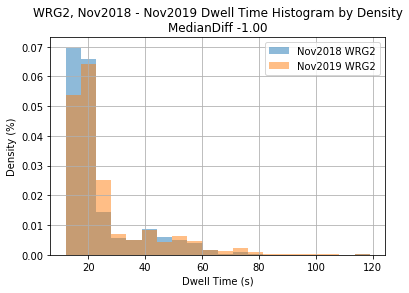

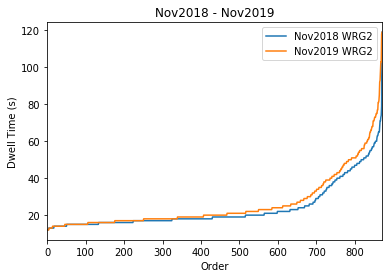


Platform Name WRW1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1056.000000
mean       18.055871
std         4.798272
min        10.000000
25%        15.000000
50%        17.000000
75%        19.000000
max        50.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1056.000000
mean       18.370265
std         5.656371
min        10.000000
25%        15.000000
50%        17.000000
75%        20.000000
max       114.000000
Name: time, dtype: float64
KS two-sample test pValue 0.18733515188263647
Dwell Time Decrease NOT Signficiant


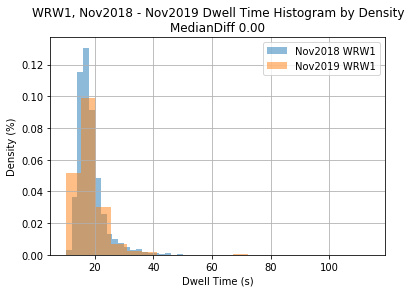

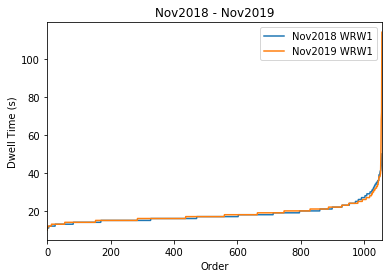


Platform Name WRW2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1003.000000
mean       18.402792
std         5.136196
min        12.000000
25%        16.000000
50%        17.000000
75%        20.000000
max       110.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1003.000000
mean       20.219342
std         4.785806
min        12.000000
25%        17.000000
50%        19.000000
75%        22.000000
max        64.000000
Name: time, dtype: float64
KS two-sample test pValue 2.522608043458023e-22
Dwell Time Decrease IS Signficiant


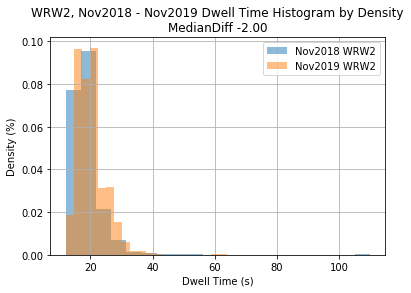

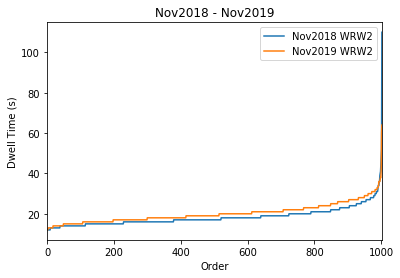


Platform Name WVL1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    765.000000
mean      29.383007
std       13.580899
min       11.000000
25%       19.000000
50%       24.000000
75%       38.000000
max       80.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    765.000000
mean      31.028758
std       13.262323
min       13.000000
25%       21.000000
50%       27.000000
75%       41.000000
max       96.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0018754535541080245
Dwell Time Decrease IS Signficiant


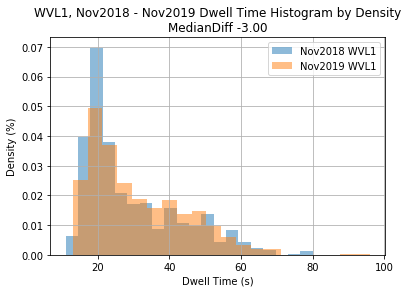

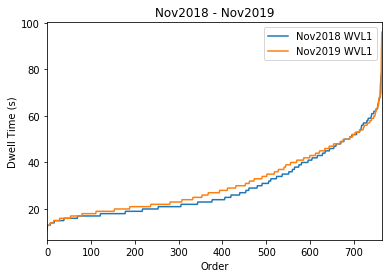


Platform Name WVL2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    41.000000
mean     23.414634
std      11.642542
min      11.000000
25%      17.000000
50%      19.000000
75%      27.000000
max      66.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    41.000000
mean     23.024390
std      10.541555
min      13.000000
25%      16.000000
50%      18.000000
75%      26.000000
max      50.000000
Name: time, dtype: float64
KS two-sample test pValue 0.5945211330032322
Dwell Time Increase NOT Signficiant


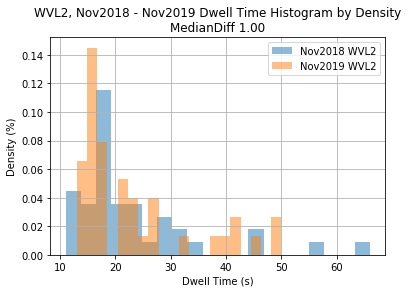

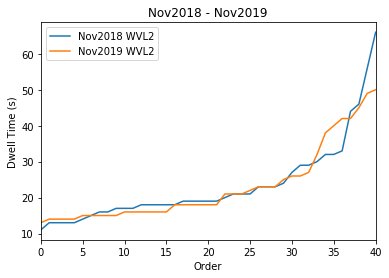


Platform Name WVL3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    89.000000
mean     21.089888
std       4.404647
min      14.000000
25%      18.000000
50%      20.000000
75%      22.000000
max      36.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    89.000000
mean     20.797753
std       7.672530
min      11.000000
25%      17.000000
50%      19.000000
75%      22.000000
max      76.000000
Name: time, dtype: float64
KS two-sample test pValue 0.05224838094271614
Dwell Time Increase NOT Signficiant


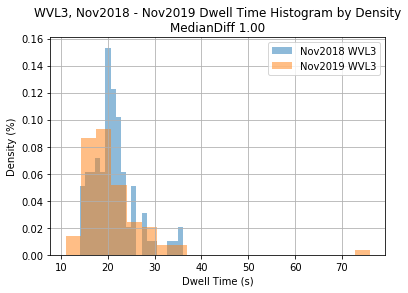

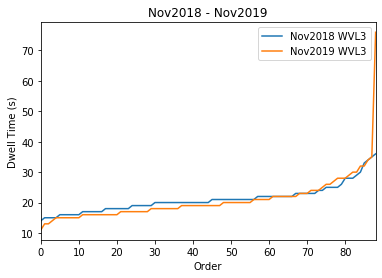


Platform Name WVL4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    723.000000
mean      21.485477
std        6.332500
min       12.000000
25%       18.000000
50%       20.000000
75%       23.000000
max      100.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    723.000000
mean      23.852006
std        7.642928
min       11.000000
25%       19.000000
50%       22.000000
75%       26.000000
max       78.000000
Name: time, dtype: float64
KS two-sample test pValue 3.9310280549025547e-13
Dwell Time Decrease IS Signficiant


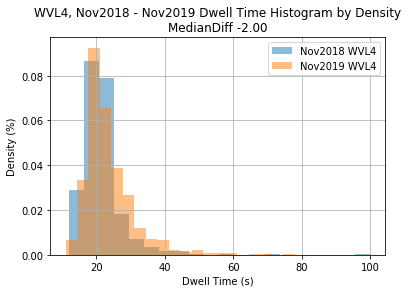

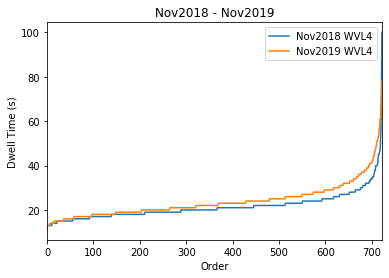


Platform Name WYN3
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2414.000000
mean       49.932891
std        19.595507
min        14.000000
25%        33.000000
50%        46.000000
75%        66.000000
max       107.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2414.000000
mean       34.189312
std        11.448808
min        13.000000
25%        26.000000
50%        32.000000
75%        40.000000
max       104.000000
Name: time, dtype: float64
KS two-sample test pValue 2.518156658055563e-147
Dwell Time Increase IS Signficiant


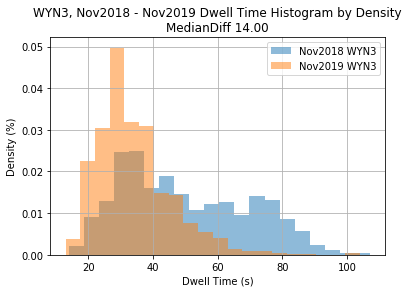

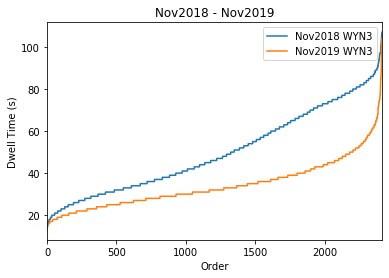


Platform Name WYN4
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    2423.000000
mean       38.890219
std        14.940078
min        13.000000
25%        27.000000
50%        36.000000
75%        48.000000
max       102.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    2423.000000
mean       38.276929
std        14.050886
min        15.000000
25%        27.000000
50%        35.000000
75%        47.000000
max       105.000000
Name: time, dtype: float64
KS two-sample test pValue 0.10870829145559967
Dwell Time Increase NOT Signficiant


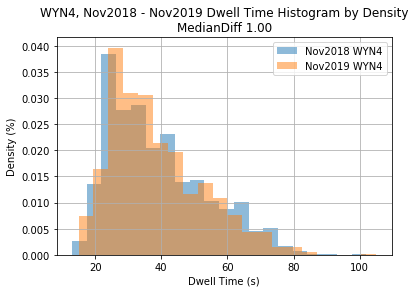

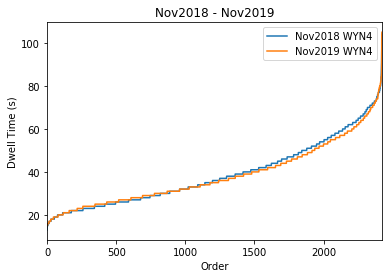


Platform Name WYN5
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    948.000000
mean      49.991561
std       16.119666
min       12.000000
25%       37.000000
50%       53.000000
75%       62.000000
max      117.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    948.000000
mean      52.853376
std       14.746310
min       14.000000
25%       43.000000
50%       56.000000
75%       64.000000
max      110.000000
Name: time, dtype: float64
KS two-sample test pValue 0.0032521469634509614
Dwell Time Decrease IS Signficiant


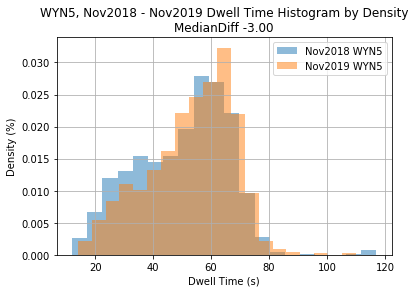

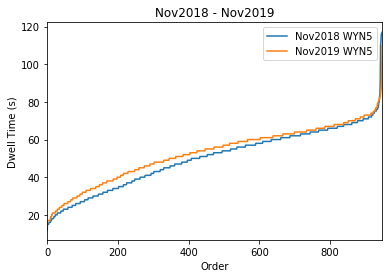


Platform Name WYN6
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    1391.000000
mean       36.539180
std        14.647946
min        14.000000
25%        25.000000
50%        33.000000
75%        46.000000
max       100.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    1391.000000
mean       37.986341
std        14.068249
min        13.000000
25%        27.000000
50%        35.000000
75%        47.000000
max       101.000000
Name: time, dtype: float64
KS two-sample test pValue 7.514573705634452e-05
Dwell Time Decrease IS Signficiant


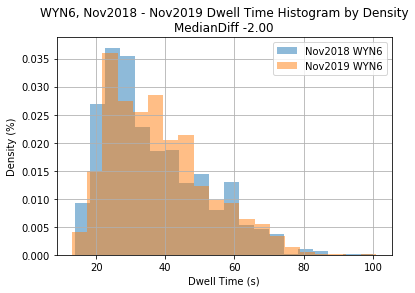

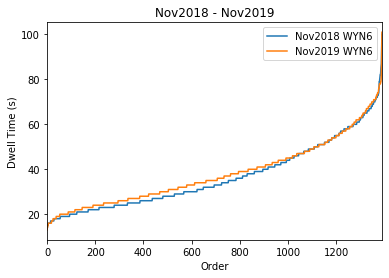


Platform Name YAG1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    518.000000
mean      20.059846
std        8.459614
min       12.000000
25%       16.000000
50%       18.000000
75%       21.000000
max       94.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    518.000000
mean      19.270270
std        4.404623
min       12.000000
25%       17.000000
50%       19.000000
75%       21.000000
max       50.000000
Name: time, dtype: float64
KS two-sample test pValue 0.06635484787122274
Dwell Time Decrease NOT Signficiant


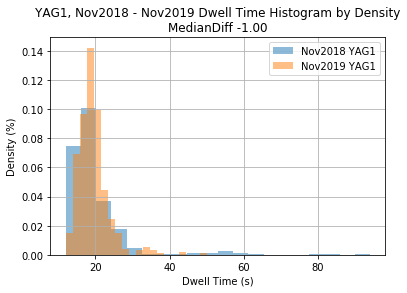

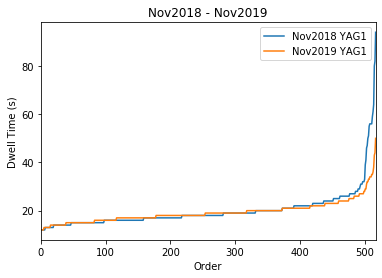


Platform Name YAG2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    528.000000
mean      20.534091
std        7.155548
min       12.000000
25%       17.000000
50%       19.000000
75%       22.000000
max       95.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    528.000000
mean      21.373106
std        6.108366
min       11.000000
25%       18.000000
50%       20.000000
75%       24.000000
max       85.000000
Name: time, dtype: float64
KS two-sample test pValue 3.452328113836107e-05
Dwell Time Decrease IS Signficiant


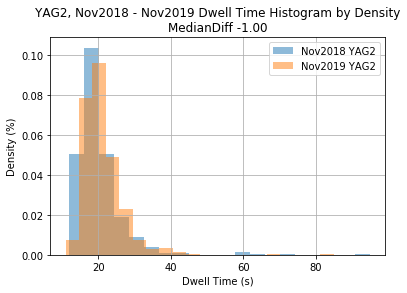

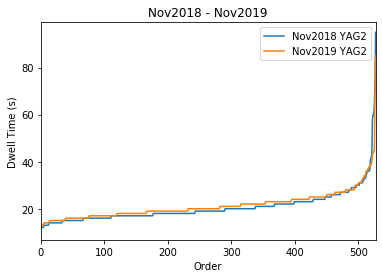


Platform Name YNN1
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    658.000000
mean      23.186930
std       12.058205
min       12.000000
25%       16.000000
50%       19.000000
75%       24.000000
max      120.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    658.000000
mean      24.305471
std       12.867762
min       11.000000
25%       16.000000
50%       19.000000
75%       26.000000
max      110.000000
Name: time, dtype: float64
KS two-sample test pValue 0.3098260177587354
Dwell Time Decrease NOT Signficiant


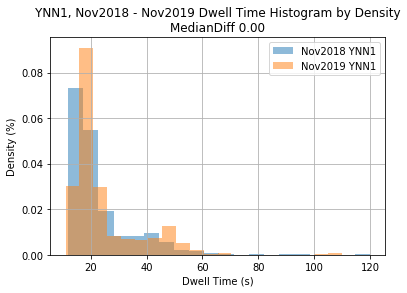

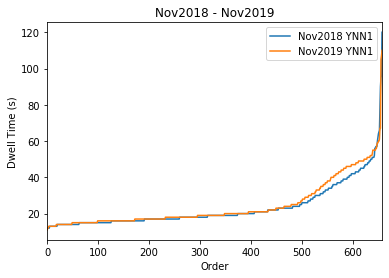


Platform Name YNN2
Dwell time selected by:
=============== Statistics ===============
Nov2018 dwell median in (sec)
count    688.000000
mean      27.313953
std       16.332881
min       11.000000
25%       17.000000
50%       20.000000
75%       32.000000
max      105.000000
Name: time, dtype: float64
Nov2019 dwell median in (sec)
count    688.000000
mean      27.171512
std       15.956809
min       11.000000
25%       17.000000
50%       20.000000
75%       31.000000
max      118.000000
Name: time, dtype: float64
KS two-sample test pValue 0.6194064672410855
Dwell Time Decrease NOT Signficiant


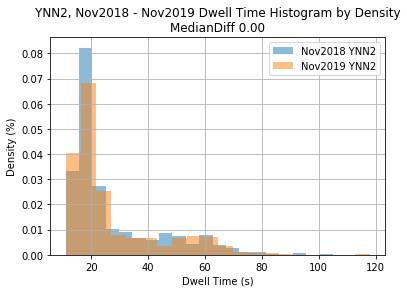

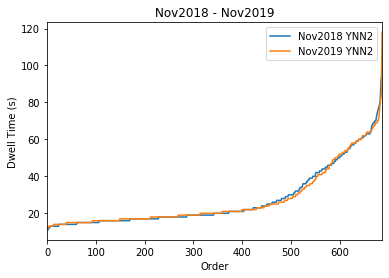



Num Significant Increase 19
Num Significant Decrease 187
Num Not Significant 127
==========Inc_Platform==========
['CE16', 'CE17', 'CE18', 'CE21', 'CWD4', 'GFD1', 'GFD2', 'HBY2', 'HBY3', 'HRL1', 'LCE4', 'NRW1', 'NSY4', 'PYM2', 'RSV1', 'RTY2', 'STL3', 'WAI2', 'WYN3']
==========Dec_Platform==========
['ART1', 'ART2', 'ASH5', 'ASQ1', 'ASQ2', 'AUB3', 'AUB4', 'BCR1', 'BCR2', 'BDP2', 'BIR2', 'BMO1', 'BMO2', 'BNK2', 'BRL1', 'BRL2', 'BTN7', 'BVH2', 'BWD1', 'BWD2', 'BWD4', 'BWD6', 'BXN2', 'CAB2', 'CAS2', 'CBY2', 'CDN2', 'CE19', 'CE22', 'CE23', 'CHT2', 'CLJ4', 'CMP2', 'CNV2', 'CRD4', 'CWD1', 'CYD5', 'DHL2', 'DNS3', 'DOO1', 'DOO3', 'DOO4', 'EDP1', 'EDP2', 'EHL3', 'EPG1', 'EPG2', 'EPG3', 'ERS2', 'EWD3', 'FLD1', 'FLM4', 'GFD3', 'GLD2', 'GQU2', 'GRD1', 'GRD3', 'GVL3', 'GVL4', 'HLW1', 'HLW2', 'HOM7', 'HRL2', 'ING2', 'KLR1', 'KLR2', 'KWD1', 'KWD2', 'LAK2', 'LCE2', 'LCE3', 'LDF1', 'LDF3', 'LEW2', 'MCO1', 'MCO2', 'MDB2', 'MDT1', 'MDT3', 'MDT4', 'MIN2', 'MKG1', 'MKV1', 'MKV2', 'MPT1', 'MPT2', 'MQF2', '

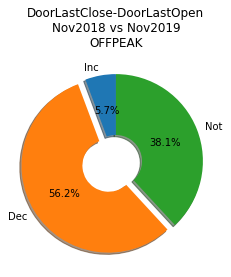

In [127]:
perform_analysis_door_open_close(data1_offpeak_sec, data2_offpeak_sec,'Nov2018', 'Nov2019', 'DoorLastClose-DoorLastOpen\nNov2018 vs Nov2019\nOFFPEAK')

# Wheel Stop

In [ ]:
data1['dwell_depart_calc_time'.upper()] = pd.to_datetime(
    data1['dwell_depart_calc_time'.upper()])
data1['dwell_arrival_calc_time'.upper()] = pd.to_datetime(
    data1['dwell_arrival_calc_time'.upper()])
data2['dwell_depart_calc_time'.upper()] = pd.to_datetime(
    data2['dwell_depart_calc_time'.upper()])
data2['dwell_arrival_calc_time'.upper()] = pd.to_datetime(
    data2['dwell_arrival_calc_time'.upper()])

data1_am_up_sec = (
    data1.loc[data1_am_up_idx, 'dwell_depart_calc_time'.upper()] -
    data1.loc[data1_am_up_idx, 'dwell_arrival_calc_time'.upper()]
).dt.total_seconds()
data1_am_up_sec = pd.merge([
    data1_am_up_sec,
    data1.loc[data1_am_up_idx, 'actual_arrival_platform'.upper()]
],
                           axis=1)
data2_am_up_sec = (
    data2.loc[data2_am_up_idx, 'dwell_depart_calc_time'.upper()] -
    data2.loc[data2_am_up_idx, 'dwell_arrival_calc_time'.upper()]
).dt.total_seconds()
data2_am_up_sec = pd.merge([
    data2_am_up_sec,
    data2.loc[data2_am_up_idx, 'actual_arrival_platform'.upper()]
],
                           axis=1)

data1_pm_down_sec = (
    data1.loc[data1_pm_down_idx, 'dwell_depart_calc_time'.upper()] -
    data1.loc[data1_pm_down_idx, 'dwell_arrival_calc_time'.upper()]
).dt.total_seconds()
data1_pm_down_sec = pd.merge([
    data1_pm_down_sec,
    data1.loc[data1_pm_down_idx, 'actual_arrival_platform'.upper()]
],
                             axis=1)

data2_pm_down_sec = (
    data2.loc[data2_pm_down_idx, 'dwell_depart_calc_time'.upper()] -
    data2.loc[data2_pm_down_idx, 'dwell_arrival_calc_time'.upper()]
).dt.total_seconds()
data2_pm_down_sec = pd.merge([
    data2_pm_down_sec,
    data2.loc[data2_pm_down_idx, 'actual_arrival_platform'.upper()]
],
                             axis=1)

data1_offpeak_sec = (
    data1.loc[data1_offpeak_idx, 'dwell_depart_calc_time'.upper()] -
    data1.loc[data1_offpeak_idx, 'dwell_arrival_calc_time'.upper()]
).dt.total_seconds()
data1_offpeak_sec = pd.merge([
    data1_offpeak_sec,
    data1.loc[data1_offpeak_idx, 'actual_arrival_platform'.upper()]
],
                             axis=1)

data2_offpeak_sec = (
    data2.loc[data2_offpeak_idx, 'dwell_depart_calc_time'.upper()] -
    data2.loc[data2_offpeak_idx, 'dwell_arrival_calc_time'.upper()]
).dt.total_seconds()
data2_offpeak_sec = pd.merge([
    data2_offpeak_sec,
    data2.loc[data2_offpeak_idx, 'actual_arrival_platform'.upper()]
],
                             axis=1)

## AM UP

In [ ]:
perform_analysis_door_open_close(data1_am_up_sec, data2_am_up_sec,'Nov2018', 'Nov2019', 'Wheel-Stop\nNov2018 vs Nov2019\nOFFPEAK')

## PM DOWN